# Path configuration

In [1]:
# Google collab
# !pip install git+https://github.com/maguelo/cafcoding.git#egg=cafcoding
# from google.colab import drive
# drive.mount('/content/drive')

# path_credentials = "/content/drive/MyDrive/CAFcoding/config/awscli.ini"
# conf_dict_path ="/content/drive/MyDrive/CAFcoding/dataset/conf_dict_analisis_correlacion.pickle"
# store_model_path =""


# Local Miguel
path_credentials = '/home/maguelo/Workspace/cafcoding/notebook/credentials/awscli.ini'
conf_dict_path ="/home/maguelo/Workspace/cafcoding/notebook/conf_dict_analisis_correlacion.pickle"
store_model_path ="/home/maguelo/Workspace/cafcoding/notebook/models-ml-total/"


In [2]:
#!pip install joblib
import joblib

import pandas as pd
import numpy as np
import pickle
import io
import os
import matplotlib.pyplot as plt
import dill
# from dtools.datamirror import DatasetMirror


In [3]:
from cafcoding.stages import etl_step
import cafcoding.tools.log as log
import cafcoding.tools.aws as aws
import cafcoding.tools.utils as utils
import cafcoding.tools.visualization as visualization
import cafcoding.tools.dataset as dataset
import cafcoding.models as models
logger = log.get_logger()
#logger.setLevel(logging.INFO)


INFO: Pandarallel will run on 8 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


# Cargamos la sesion de Amazon

In [4]:
import cafcoding.tools.aws as aws

amazon = aws.AWS(path_credentials)

# Activamos las credenciales
amazon.set_credentials_in_env()

/home/maguelo/Workspace/cafcoding/notebook/credentials/awscli.ini


# Cargamos diccionario con la configuracion

In [5]:
import pickle
with open(conf_dict_path,"rb") as f:
    conf_dict=pickle.load( f)


# Cargamos el dataset



In [6]:
df={}
df['train'] = dataset.DatasetLoader().load_df_train(1)
# df['val'] = dataset.DatasetLoader().load_df_val(1) #Estamos usando KFOLD
df['test'] = dataset.DatasetLoader().load_df_test(1)


 [Wed, 21 Apr 2021 22:43:09] INFO [dataset.py.__init__:28] Using datasource from s3 s3://cafcodingdatos/targets_mirror/{step}/2020-{month:02d}-{day:02d}-etl-{version}.csv
s3://cafcodingdatos/targets_mirror/train/2020-10-01-etl-1.2.1.csv
 [Wed, 21 Apr 2021 22:44:45] INFO [dataset.py.__init__:28] Using datasource from s3 s3://cafcodingdatos/targets_mirror/{step}/2020-{month:02d}-{day:02d}-etl-{version}.csv
s3://cafcodingdatos/targets_mirror/test/2020-11-11-etl-1.2.1.csv


In [7]:
# DF de verificacion
df['train'] = df['train'].head(1000)
df['test'] = df['test'].head(1000)

In [8]:
conf_dict['ignore_columns']

['ut', 'ts_date', 'date_day']

In [9]:
variables_objetivo=conf_dict['targets']

for target in variables_objetivo:
    df['train'][target+'_plus']=df['train'][target].shift(periods=1)
    df['test'][target+'_plus']=df['test'][target].shift(periods=1)
    
    if 'val' in df:
        df['val'][target+'_plus']=df['val'][target].shift(periods=1)
    
    df['train']=df['train'][1:]
    df['test']=df['test'][1:]
    if 'val' in df:
        df['val']=df['val'][1:]
    
df['train'][variables_objetivo].head()    




,TCU1_LinePowerConsumed,TCU1_LinePowerDissipated,TCU1_LinePowerReturned,TCU2_LinePowerConsumed,TCU2_LinePowerDissipated,TCU2_LinePowerReturned,TCU3_LinePowerConsumed,TCU3_LinePowerDissipated,TCU3_LinePowerReturned,TCU4_LinePowerConsumed,TCU4_LinePowerDissipated,TCU4_LinePowerReturned
ts_date_index,,,,,,,,,,,,
2020-10-01 03:49:26,7052.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7052.5,0.0,0.0
2020-10-01 03:49:27,0.0,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0
2020-10-01 03:49:28,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0
2020-10-01 03:49:29,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0
2020-10-01 03:49:30,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0,7052.5,0.0,0.0


In [10]:
variables_objetivo_current = variables_objetivo.copy()
variables_objetivo = [target+'_plus' for target in variables_objetivo]


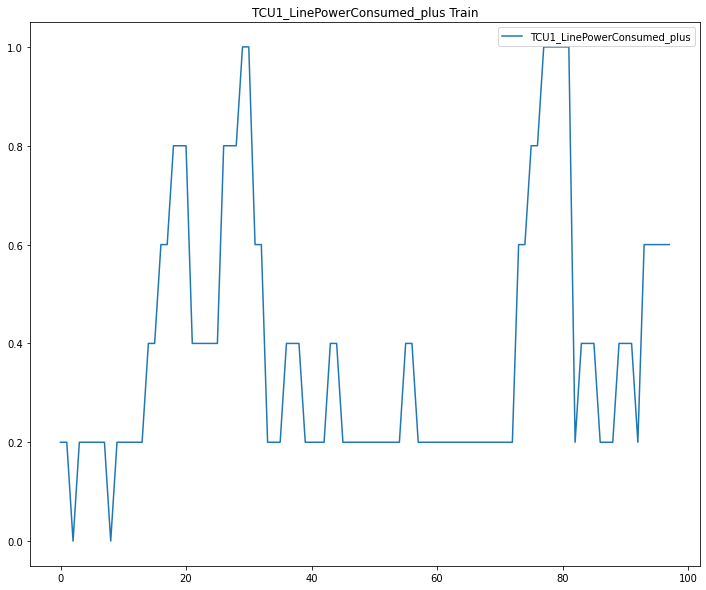

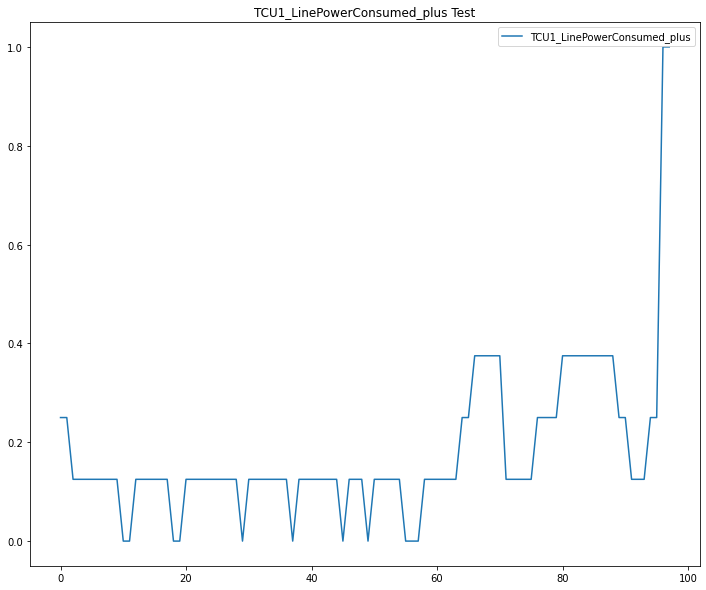

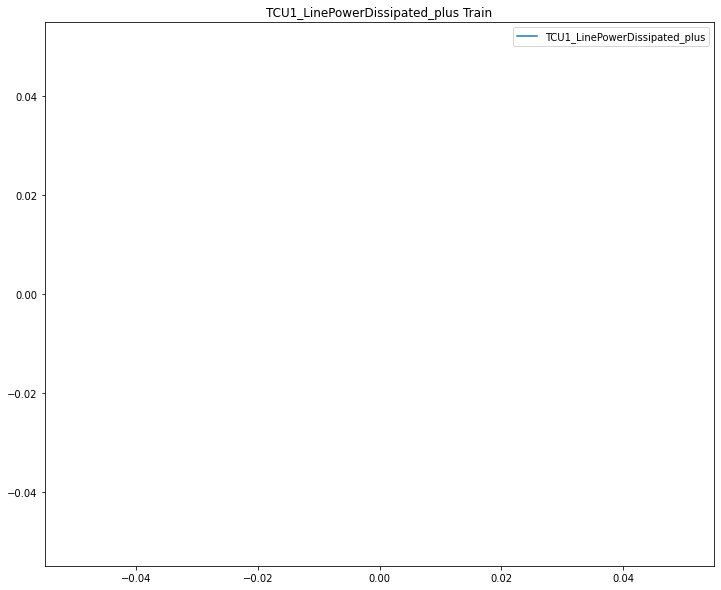

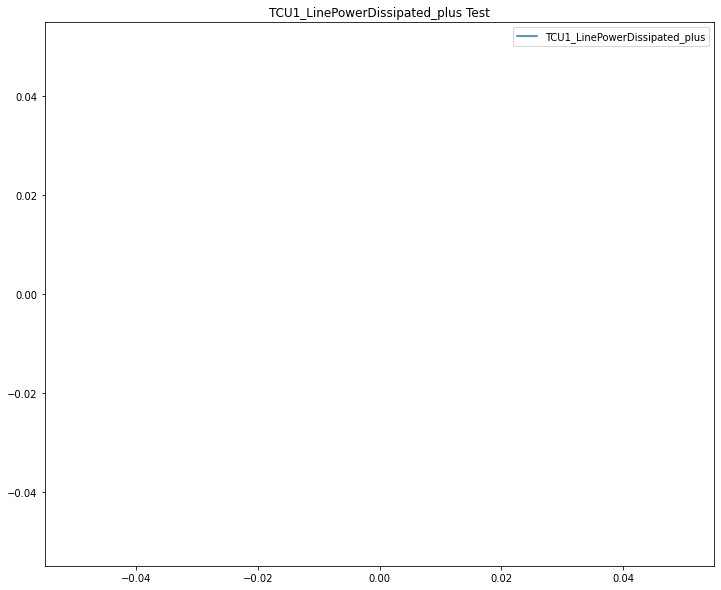

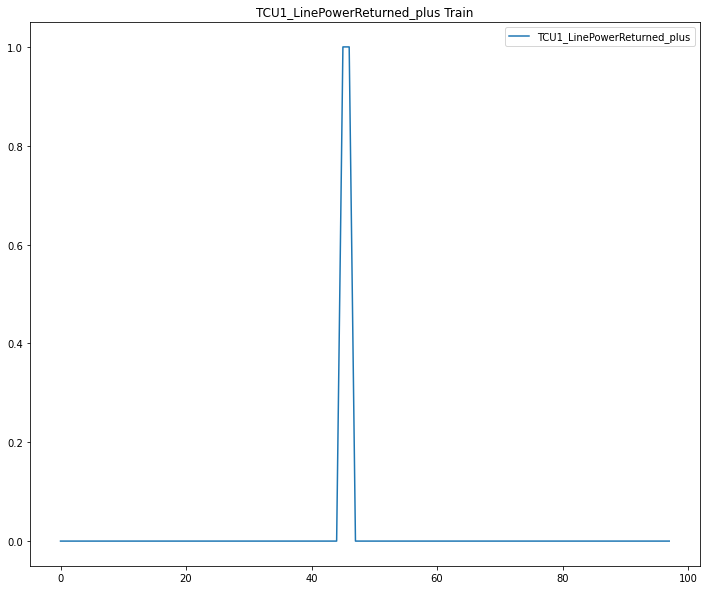

...

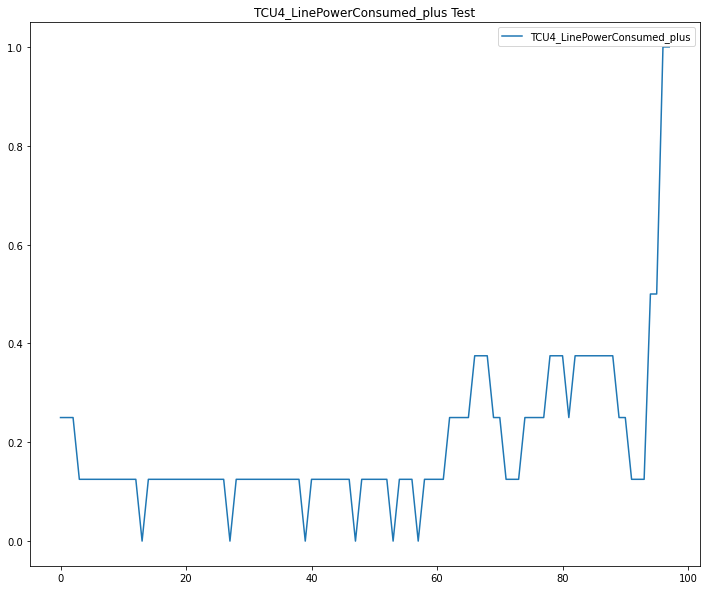

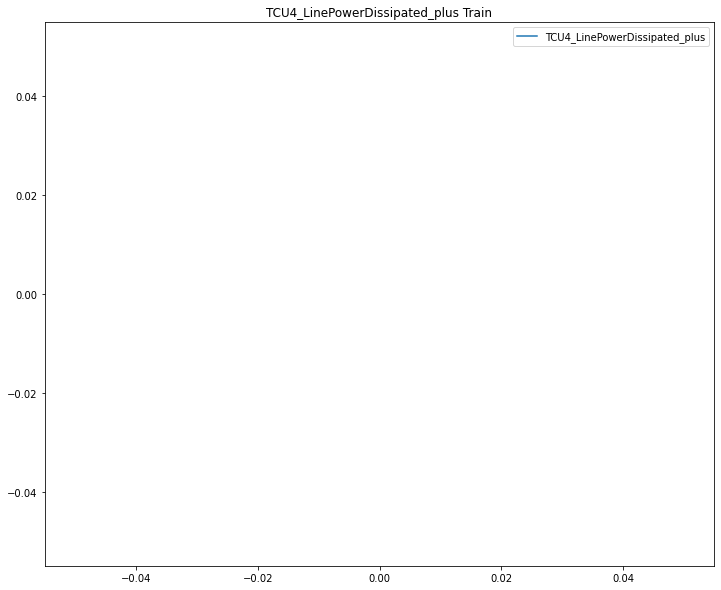

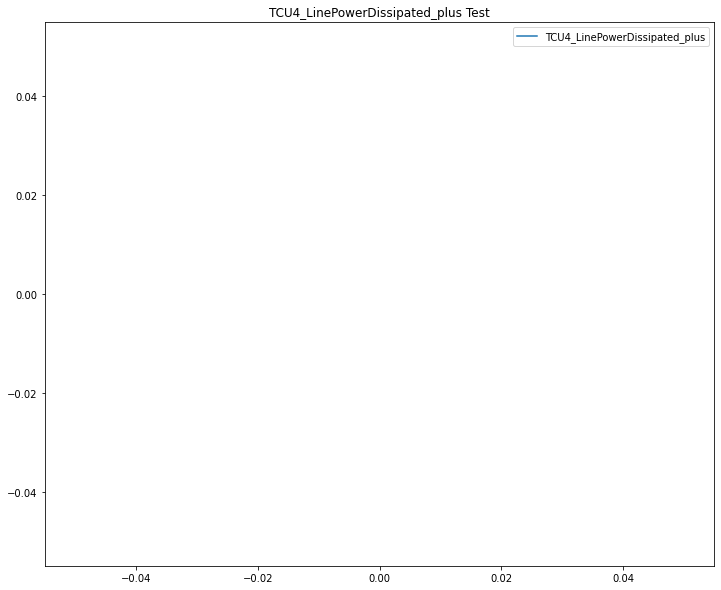

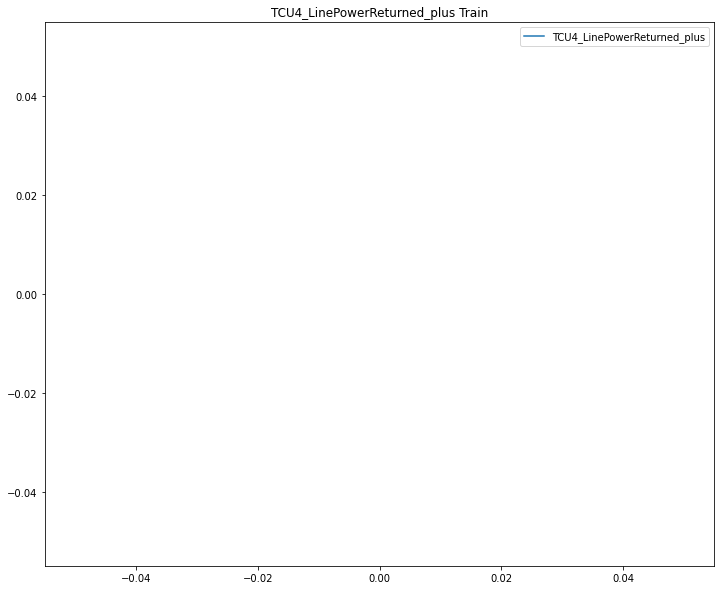

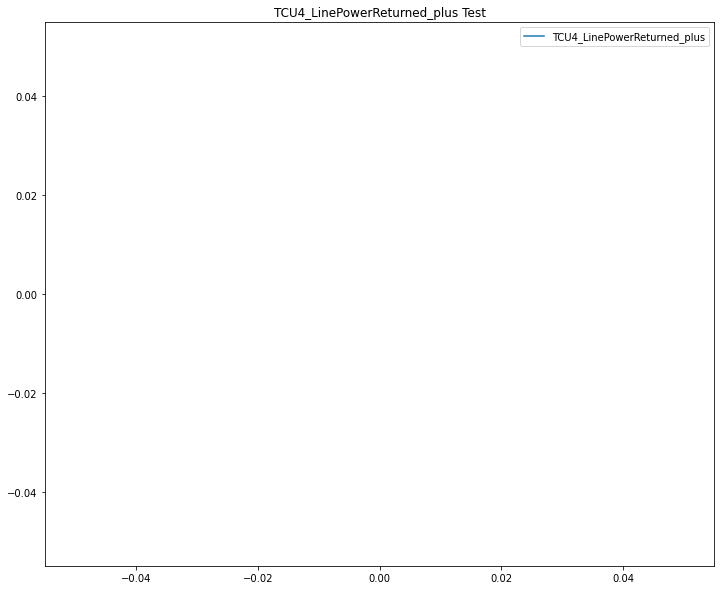

In [11]:
plot_percent = 0.1
for target in variables_objetivo:
    visualization.plot_one_series(df['train'][target], 
                                  target, 
                                   title=target + ' Train',
                                   plot_percent=plot_percent,
                                   normalize = True)
    
    if 'val' in df:
        visualization.plot_one_series(df['val'][target], 
                                      target, 
                                       title=target + ' Val',
                                       plot_percent=plot_percent,
                                       normalize = True)

    visualization.plot_one_series(df['test'][target], 
                                  target, 
                                   title=target + ' Test',
                                   plot_percent=plot_percent,
                                   normalize = True)

# Partimos datasets

In [12]:
print (variables_objetivo)
print (df['train'].columns)
print (len(df['train'].columns))

['TCU1_LinePowerConsumed_plus', 'TCU1_LinePowerDissipated_plus', 'TCU1_LinePowerReturned_plus', 'TCU2_LinePowerConsumed_plus', 'TCU2_LinePowerDissipated_plus', 'TCU2_LinePowerReturned_plus', 'TCU3_LinePowerConsumed_plus', 'TCU3_LinePowerDissipated_plus', 'TCU3_LinePowerReturned_plus', 'TCU4_LinePowerConsumed_plus', 'TCU4_LinePowerDissipated_plus', 'TCU4_LinePowerReturned_plus']
Index(['ut', 'TCU1_LinePowerConsumed', 'TCU1_LinePowerDissipated',
       'TCU1_LinePowerReturned', 'TCU2_LinePowerConsumed',
       'TCU2_LinePowerDissipated', 'TCU2_LinePowerReturned',
       'TCU3_LinePowerConsumed', 'TCU3_LinePowerDissipated',
       'TCU3_LinePowerReturned',
       ...
       'TCU1_LinePowerReturned_plus', 'TCU2_LinePowerConsumed_plus',
       'TCU2_LinePowerDissipated_plus', 'TCU2_LinePowerReturned_plus',
       'TCU3_LinePowerConsumed_plus', 'TCU3_LinePowerDissipated_plus',
       'TCU3_LinePowerReturned_plus', 'TCU4_LinePowerConsumed_plus',
       'TCU4_LinePowerDissipated_plus', 'TCU4_L

In [13]:
import os


def create_train_info_dict(path, params,target,kfold):
    filename_template = create_filename_template(path, params,target,kfold)
    train_info_dict={}
    train_info_dict['target']=target
    train_info_dict['params']=params
    train_info_dict['model']=filename_template+'.h5'
    train_info_dict['plot_diff']=filename_template+'-diff.jpeg'
    train_info_dict['plot_diff_abs']=filename_template+'-diff-abs.jpeg'
    train_info_dict['plot_pred_real']=filename_template+'-pred_real.jpeg'
    train_info_dict['plot_real_pred']=filename_template+'-real_pred.jpeg'
    train_info_dict['plot_pred']=filename_template+'-pred.jpeg'
    train_info_dict['plot_real']=filename_template+'-_real.jpeg'
    train_info_dict['train_info']=create_filename_template(path, params,target,kfold,True)+'.pickle'
    return train_info_dict
    
def create_plots(preds, y_test, target,train_info_dict,kfold, plot_percent=None ):
    visualization.plot_one_series(preds, 
                                  'preds', 
                                   title=target,
                                   plot_percent=plot_percent,
                                   normalize = False,
                                   filename=train_info_dict['plot_pred'])
    
    visualization.plot_one_series(y_test, 
                                  'y_test', 
                                  title=target,
                                  plot_percent=plot_percent,
                                  normalize = False,
                                  filename=train_info_dict['plot_real'])
    
    visualization.plot_two_series(y_test,
                                  preds,
                                  "real", 
                                  "pred",
                                  title=target + 'real-pred',
                                  plot_percent=plot_percent,
                                  normalize = False,
                                  filename=train_info_dict['plot_real_pred'])

    visualization.plot_two_series(preds,
                                  y_test,
                                  "pred",
                                  "real", 
                                  title=target+' pred-real',
                                  plot_percent=plot_percent,
                                  normalize = False,
                                  filename=train_info_dict['plot_pred_real'])

    
    visualization.plot_differences(preds, 
                                   y_test, 
                                   title=target,
                                   plot_percent=plot_percent,
                                   normalize = False,
                                   filename= train_info_dict['plot_diff'])

    visualization.plot_differences(preds, 
                                   y_test, 
                                   title=target + ' Abs', 
                                   absolute=True,
                                   plot_percent=plot_percent,
                                   filename= train_info_dict['plot_diff_abs'])

    

def quick_analysis(preds, y_test):
    # compute the difference between the *predicted* target and the
    # *actual* target, then compute the percentage difference and
    # the absolute percentage difference


    diff = preds - y_test
    percentDiff = (diff / (y_test+0.0000000001)) * 100
    absPercentDiff = np.abs(percentDiff)
    # compute the mean and standard deviation of the absolute percentage
    # difference
    mean = np.mean(absPercentDiff)
    std = np.std(absPercentDiff)

    #print("{} - avg: {}, std: {}".format(target, df['test'][target].mean(),df['test'][target].std()))
    print("{} - avg: {}, std: {}".format(target, np.mean(y_test),np.std(y_test)))
    print("Absolut Percent Difference - mean: {:.2f}%, std: {:.2f}%".format(mean, std))

    

In [14]:
def scale_targets(targets, train,test, val=None):
    scale_dict={}
    for target in targets:
        scale_dict[target] = train[target].max()
        train[target] /= scale_dict[target]
        test[target] /= scale_dict[target]
        if val is not None:
            val[target] /= scale_dict[target]
    return scale_dict,train,test,val
    

In [15]:
# Calculamos que columnas tienen valores continuos
continuous_list = models.continous_column_detector(df['train'].drop(conf_dict['ignore_columns']+variables_objetivo+variables_objetivo_current,axis=1))


# Reescalamos los valores continuos entre 0 y 1
df['train'],df['test'],_=models.scaling_attributes(continuous_list, df['train'],df['test'])                

scale_dict,df['train'],df['test'], _ =scale_targets(variables_objetivo+variables_objetivo_current, df['train'],df['test'])

# Creamos un directorio donde vamos a guardar toda la informacion
utils.create_dir(store_model_path)                



 [Wed, 21 Apr 2021 22:46:16] ERROR [utils.py.create_dir:15] Creation of the directory /home/maguelo/Workspace/cafcoding/notebook/models-ml-total/ failed


/home/maguelo/VirtualEnvs/cafcoding/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:400: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/home/maguelo/VirtualEnvs/cafcoding/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:401: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


In [16]:
continuous_list

['TCU1_DCBusVoltage',
 'TCU2_DCBusVoltage',
 'TCU3_DCBusVoltage',
 'TCU4_DCBusVoltage',
 'TCU1_CatenaryVoltage',
 'TCU2_CatenaryVoltage',
 'TCU3_CatenaryVoltage',
 'TCU4_CatenaryVoltage',
 'ER_TotKm',
 'PLC_TRACTION_BRAKE_COMMAND',
 'PLC_Speed',
 'PLC_TempExt',
 'PLC_MassM1',
 'PLC_MassM2',
 'PLC_MassR1',
 'PLC_MassR2',
 'PLC_VLinea_M1',
 'PLC_VLinea_M2',
 'ER_EUIdSenal1',
 'ER_EUIdSenal2',
 'ER_EUIdSenal3',
 'ER_EUIdSenal4',
 'ER_EUIdSenal5',
 'ER_EUIdSenal6',
 'ER_EUIdSenal7',
 'PLC_MASTER_CONTROLLER_POS',
 'SI_GPS_Speed',
 'precipitacion_pluviometro_acu',
 'hri',
 'fr_wind',
 'lat_wind',
 'altitude',
 'slope',
 'distance',
 'percent_slope',
 'TCU1_Axle1Speed_abs',
 'TCU1_Axle2Speed_abs',
 'TCU1_ElecEffApp_abs',
 'TCU2_Axle1Speed_abs',
 'TCU2_Axle2Speed_abs',
 'TCU2_ElecEffApp_abs',
 'TCU3_Axle1Speed_abs',
 'TCU3_Axle2Speed_abs',
 'TCU3_ElecEffApp_abs',
 'TCU4_Axle1Speed_abs',
 'TCU4_Axle2Speed_abs',
 'TCU4_ElecEffApp_abs',
 'TCU1_LinePowerConsumed_1',
 'TCU1_LinePowerDissipated_1',


In [17]:
discard_columns = ['ER_EUIdSenal1',
                   'ER_EUIdSenal2',
                   'ER_EUIdSenal3','ER_EUIdSenal4','ER_EUIdSenal5','ER_EUIdSenal6','ER_EUIdSenal7','ER_EUIdSenal8',
                   'EPAC1_WSP_Acting_1','EPAC1_WSP_Acting_dif','EPAC2_WSP_Acting_1','EPAC2_WSP_Acting_dif',
                    'PLC_Speed_1',
                    'PLC_Speed_dif',
                    'PLC_TRACTION_BRAKE_COMMAND_1',
                    'PLC_TRACTION_BRAKE_COMMAND_dif',
                    'TCU1_Axle1Speed_abs_1',
                    'TCU1_Axle1Speed_abs_dif',
                    'TCU1_Axle2Speed_abs_1',
                    'TCU1_Axle2Speed_abs_dif',
                    'TCU1_DCBusVoltage_1',
                    'TCU1_DCBusVoltage_dif',
                    'TCU1_ElecEffApp_abs_1',
                    'TCU1_ElecEffApp_abs_dif',
                    'TCU1_LinePowerConsumed_1',
                    'TCU1_LinePowerConsumed_dif',
                    'TCU1_LinePowerDissipated_1',
                    'TCU1_LinePowerDissipated_dif',
                    'TCU1_LinePowerReturned_1',
                    'TCU1_LinePowerReturned_dif',
                    'TCU2_Axle1Speed_abs_1',
                    'TCU2_Axle1Speed_abs_dif',
                    'TCU2_Axle2Speed_abs_1',
                    'TCU2_Axle2Speed_abs_dif',
                    'TCU2_DCBusVoltage_1',
                    'TCU2_DCBusVoltage_dif',
                    'TCU2_ElecEffApp_abs_1',
                    'TCU2_ElecEffApp_abs_dif',
                    'TCU2_LinePowerConsumed_1',
                    'TCU2_LinePowerConsumed_dif',
                    'TCU2_LinePowerDissipated_1',
                    'TCU2_LinePowerDissipated_dif',
                    'TCU2_LinePowerReturned_1',
                    'TCU2_LinePowerReturned_dif',
                    'TCU3_Axle1Speed_abs_1',
                    'TCU3_Axle1Speed_abs_dif',
                    'TCU3_Axle2Speed_abs_1',
                    'TCU3_Axle2Speed_abs_dif',
                    'TCU3_DCBusVoltage_1',
                    'TCU3_DCBusVoltage_dif',
                    'TCU3_ElecEffApp_abs_1',
                    'TCU3_ElecEffApp_abs_dif',
                    'TCU3_LinePowerConsumed_1',
                    'TCU3_LinePowerConsumed_dif',
                    'TCU3_LinePowerDissipated_1',
                    'TCU3_LinePowerDissipated_dif',
                    'TCU3_LinePowerReturned_1',
                    'TCU3_LinePowerReturned_dif',
                    'TCU4_Axle1Speed_abs_1',
                    'TCU4_Axle1Speed_abs_dif',
                    'TCU4_Axle2Speed_abs_1',
                    'TCU4_Axle2Speed_abs_dif',
                    'TCU4_DCBusVoltage_1',
                    'TCU4_DCBusVoltage_dif',
                    'TCU4_ElecEffApp_abs_1',
                    'TCU4_ElecEffApp_abs_dif',
                    'TCU4_LinePowerConsumed_1',
                    'TCU4_LinePowerConsumed_dif',
                    'TCU4_LinePowerDissipated_1',
                    'TCU4_LinePowerDissipated_dif',
                    'TCU4_LinePowerReturned_1',
                    'TCU4_LinePowerReturned_dif',
                    'slope',
                    'ER_TotKm','PLC_MASTER_CONTROLLER_POS','SI_GPS_Speed','distance','altitude',
                    'lat_wind',
                    'AutoEficient','ManeuverMode','ImpSpeedMode','ManEficient',
                  'TCU1_LinePowerConsumed',

'TCU1_LinePowerDissipated',

'TCU1_LinePowerReturned',
'TCU2_LinePowerConsumed',

'TCU2_LinePowerDissipated',

'TCU2_LinePowerReturned',
'TCU3_LinePowerConsumed',

'TCU3_LinePowerDissipated',

'TCU3_LinePowerReturned',
'TCU4_LinePowerConsumed',

'TCU4_LinePowerDissipated',

'TCU4_LinePowerReturned',
                  
                  
'Coupled', 'EPAC1_WSP_Acting', 'EPAC2_WSP_Acting', 'Manual', 'PLC_DS_CAB1', 'PLC_DS_CAB2', 'PLC_MassM1', 
'PLC_MassM2', 'PLC_MassR1', 'PLC_MassR2', 'PLC_Speed', 'PLC_TRACTION_BRAKE_COMMAND', 'PLC_TempExt', 'PLC_VLinea_M1', 
'PLC_VLinea_M2',  'fr_wind', 'hri', 'percent_slope', 
'plc_mcp_braking_effort_requested', 'plc_mcp_coasting_requested', 'plc_mcp_error_unknown_requested',
'plc_mcp_propulsion_effort_requested', 'plc_mcp_urgency_brake_requested', 'precipitacion_pluviometro_acu']

# Temporal
# 'Coupled', 'EPAC1_WSP_Acting', 'EPAC2_WSP_Acting', 'Manual', 'PLC_DS_CAB1', 'PLC_DS_CAB2', 'PLC_MassM1', 
# 'PLC_MassM2', 'PLC_MassR1', 'PLC_MassR2', 'PLC_Speed', 'PLC_TRACTION_BRAKE_COMMAND', 'PLC_TempExt', 'PLC_VLinea_M1', 
# 'PLC_VLinea_M2', 'TCU1_CatenaryVoltage', 'TCU1_DCBusVoltage', 
# 'TCU1_ElecEffApp_abs', 'TCU2_CatenaryVoltage', 'TCU2_DCBusVoltage', 'TCU2_ElecEffApp_abs','TCU3_CatenaryVoltage',
# 'TCU3_DCBusVoltage', 'TCU3_ElecEffApp_abs', 
# 'TCU4_CatenaryVoltage', 'TCU4_DCBusVoltage', 'TCU4_ElecEffApp_abs', 'fr_wind', 'hri', 'percent_slope', 
# 'plc_mcp_braking_effort_requested', 'plc_mcp_coasting_requested', 'plc_mcp_error_unknown_requested',
# 'plc_mcp_propulsion_effort_requested', 'plc_mcp_urgency_brake_requested', 'precipitacion_pluviometro_acu']


features=sorted(df['train'].columns)
for col in features:
    if col in discard_columns:
        continue
    print (col)
    
#'TCU1_Axle1Speed_abs', 'TCU1_Axle2Speed_abs''TCU2_Axle1Speed_abs', 'TCU2_Axle2Speed_abs' 'TCU3_Axle1Speed_abs', 'TCU3_Axle2Speed_abs', 'TCU4_Axle1Speed_abs', 'TCU4_Axle2Speed_abs', 

TCU1_Axle1Speed_abs
TCU1_Axle2Speed_abs
TCU1_CatenaryVoltage
TCU1_DCBusVoltage
TCU1_ElecEffApp_abs
TCU1_LinePowerConsumed_plus
TCU1_LinePowerDissipated_plus
TCU1_LinePowerReturned_plus
TCU2_Axle1Speed_abs
TCU2_Axle2Speed_abs
TCU2_CatenaryVoltage
TCU2_DCBusVoltage
TCU2_ElecEffApp_abs
TCU2_LinePowerConsumed_plus
TCU2_LinePowerDissipated_plus
TCU2_LinePowerReturned_plus
TCU3_Axle1Speed_abs
TCU3_Axle2Speed_abs
TCU3_CatenaryVoltage
TCU3_DCBusVoltage
TCU3_ElecEffApp_abs
TCU3_LinePowerConsumed_plus
TCU3_LinePowerDissipated_plus
TCU3_LinePowerReturned_plus
TCU4_Axle1Speed_abs
TCU4_Axle2Speed_abs
TCU4_CatenaryVoltage
TCU4_DCBusVoltage
TCU4_ElecEffApp_abs
TCU4_LinePowerConsumed_plus
TCU4_LinePowerDissipated_plus
TCU4_LinePowerReturned_plus
date_day
ts_date
ut


In [18]:
from sklearn.model_selection import cross_val_score
# function to get cross validation scores
def get_cv_scores(model,X_train, y_train):
    scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')
    print('CV Mean: ', np.mean(scores))
    print('STD: ', np.std(scores))
    print('\n')
    return np.mean(scores)

In [19]:
for col in df['train'].columns:

    print(df['train'][col].describe().T)
    print()


count    988.0
mean     906.0
std        0.0
min      906.0
25%      906.0
50%      906.0
75%      906.0
max      906.0
Name: ut, dtype: float64

count    988.000000
mean       0.081715
std        0.160096
min        0.000000
25%        0.028566
50%        0.057132
75%        0.057132
max        1.000000
Name: TCU1_LinePowerConsumed, dtype: float64

count    988.000000
mean       0.021845
std        0.112465
min        0.000000
25%        0.000000
50%        0.000000
75%        0.000000
max        1.000000
Name: TCU1_LinePowerDissipated, dtype: float64

count    988.000000
mean       0.031239
std        0.120746
min        0.000000
25%        0.000000
50%        0.000000
75%        0.000000
max        1.000000
Name: TCU1_LinePowerReturned, dtype: float64

count    988.000000
mean       0.078998
std        0.161128
min        0.000000
25%        0.028566
50%        0.028566
75%        0.057132
max        1.000000
Name: TCU2_LinePowerConsumed, dtype: float64

count    988.000000
mean    

In [20]:
features

['AutoEficient',
 'Coupled',
 'EPAC1_WSP_Acting',
 'EPAC1_WSP_Acting_1',
 'EPAC1_WSP_Acting_dif',
 'EPAC2_WSP_Acting',
 'EPAC2_WSP_Acting_1',
 'EPAC2_WSP_Acting_dif',
 'ER_EUIdSenal1',
 'ER_EUIdSenal2',
 'ER_EUIdSenal3',
 'ER_EUIdSenal4',
 'ER_EUIdSenal5',
 'ER_EUIdSenal6',
 'ER_EUIdSenal7',
 'ER_EUIdSenal8',
 'ER_TotKm',
 'ImpSpeedMode',
 'ManEficient',
 'ManeuverMode',
 'Manual',
 'PLC_DS_CAB1',
 'PLC_DS_CAB2',
 'PLC_MASTER_CONTROLLER_POS',
 'PLC_MassM1',
 'PLC_MassM2',
 'PLC_MassR1',
 'PLC_MassR2',
 'PLC_Speed',
 'PLC_Speed_1',
 'PLC_Speed_dif',
 'PLC_TRACTION_BRAKE_COMMAND',
 'PLC_TRACTION_BRAKE_COMMAND_1',
 'PLC_TRACTION_BRAKE_COMMAND_dif',
 'PLC_TempExt',
 'PLC_VLinea_M1',
 'PLC_VLinea_M2',
 'SI_GPS_Speed',
 'TCU1_Axle1Speed_abs',
 'TCU1_Axle1Speed_abs_1',
 'TCU1_Axle1Speed_abs_dif',
 'TCU1_Axle2Speed_abs',
 'TCU1_Axle2Speed_abs_1',
 'TCU1_Axle2Speed_abs_dif',
 'TCU1_CatenaryVoltage',
 'TCU1_DCBusVoltage',
 'TCU1_DCBusVoltage_1',
 'TCU1_DCBusVoltage_dif',
 'TCU1_ElecEffApp_abs',


# Regresion Lineal

In [21]:
def create_filename_template(path,params,target,kfold, score=False):
    filename = ['modelLR']
    if score:
        filename += ['S{}']
    filename += ['T'+target]
    filename += ['KF'+str(kfold)]
    filename = "-".join(filename)
    filename = os.path.join(path, filename)
    return filename

TCU1_LinePowerConsumed_plus
Fold : 0/3
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 217284286251.29%, std: 654457004202.58%
CV Mean:  -11.37959072703471
STD:  20.95140684227862




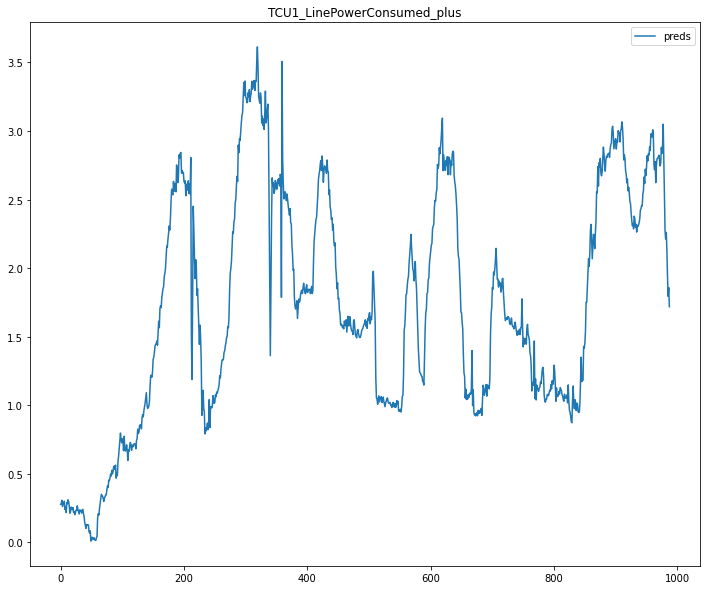

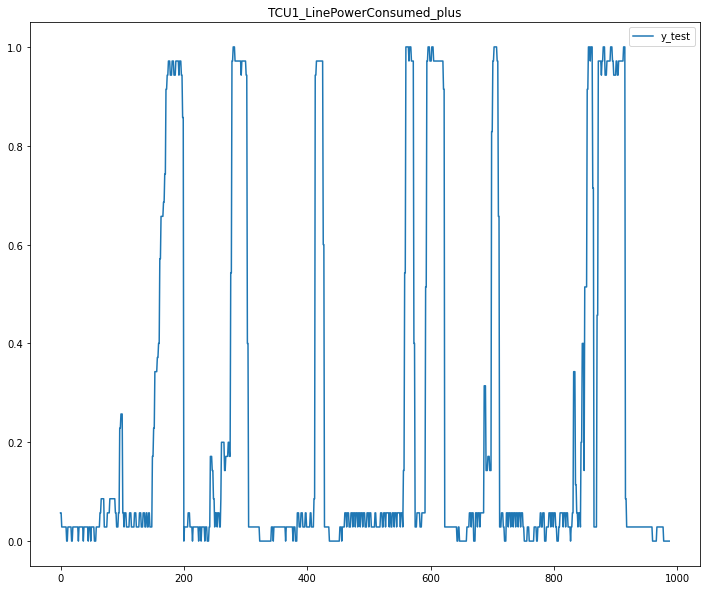

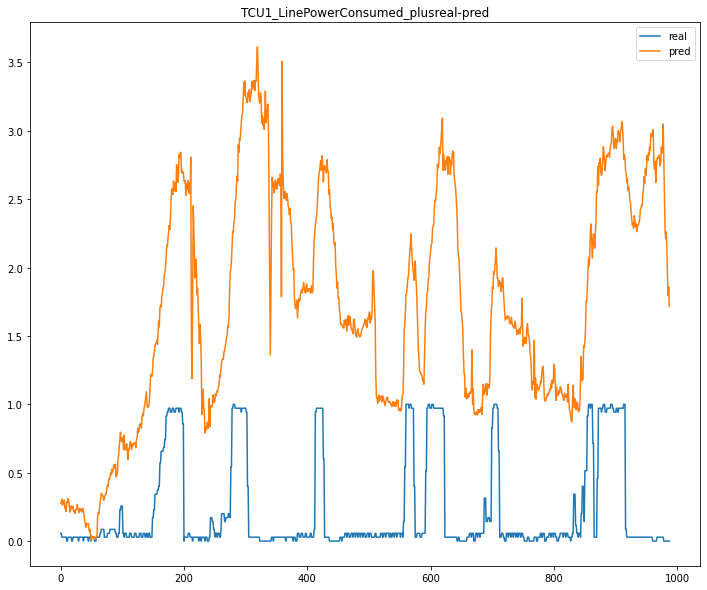

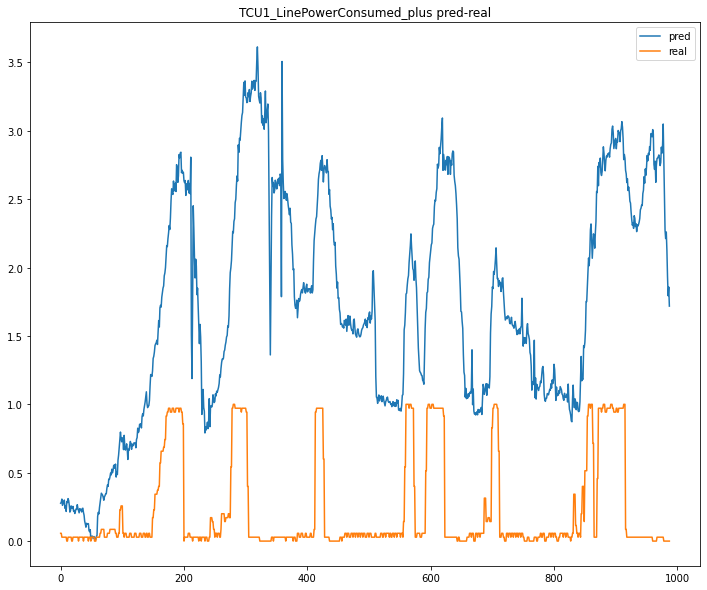

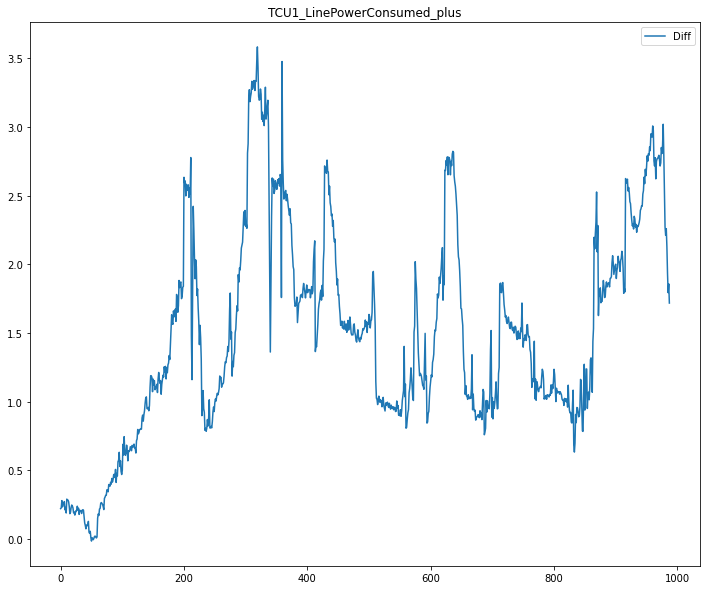

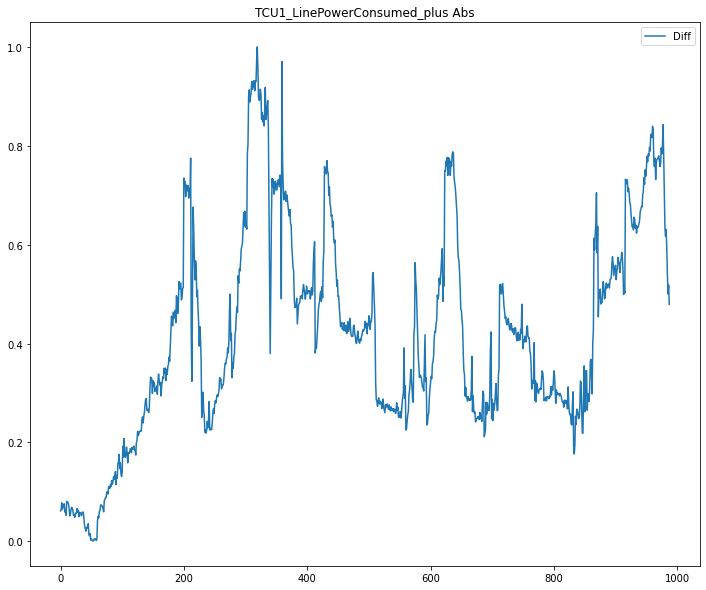

Fold : 1/3
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 226868614796.83%, std: 682143715251.42%
CV Mean:  -3.3705120162448496
STD:  4.7033548919831025




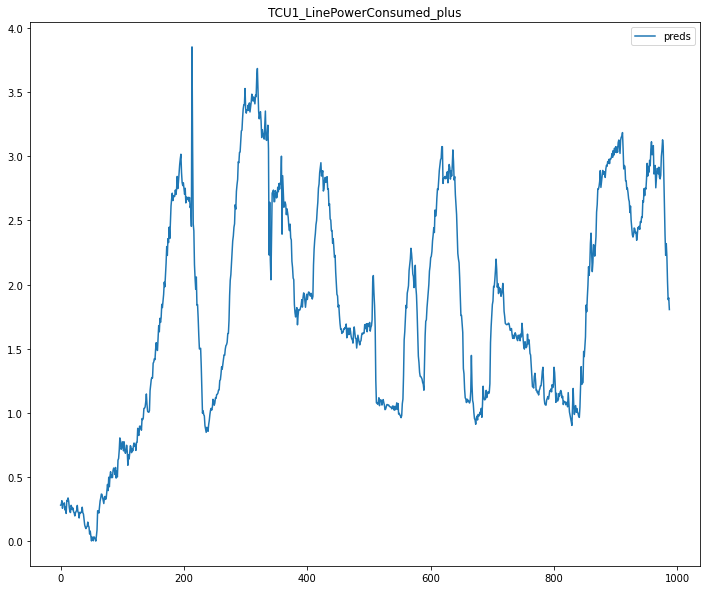

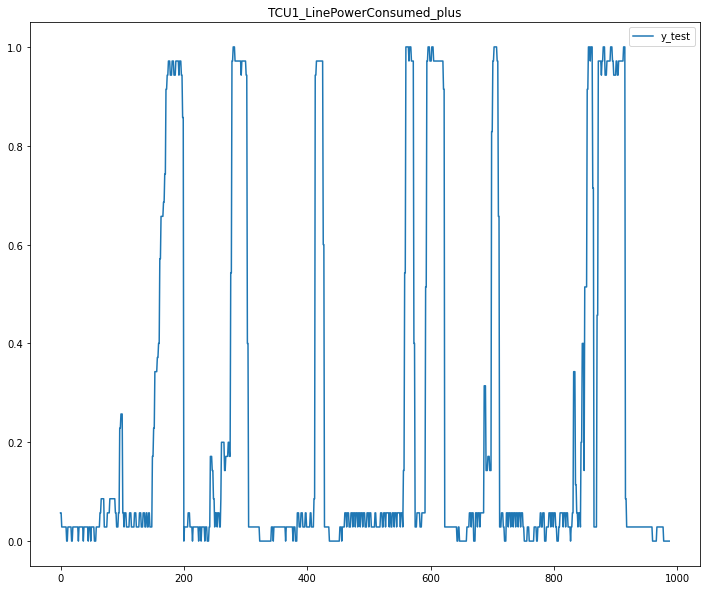

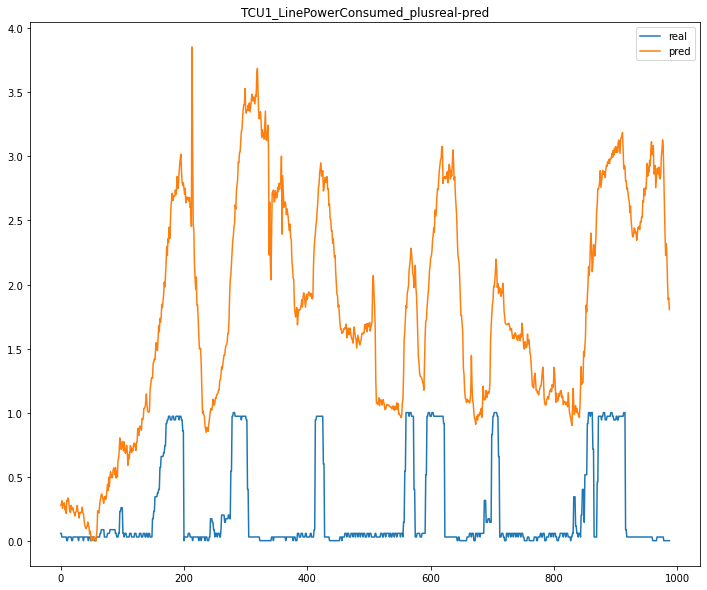

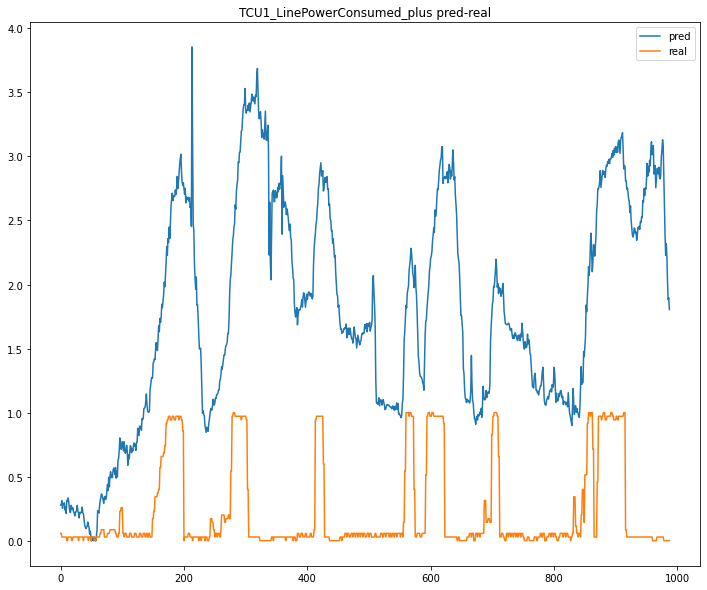

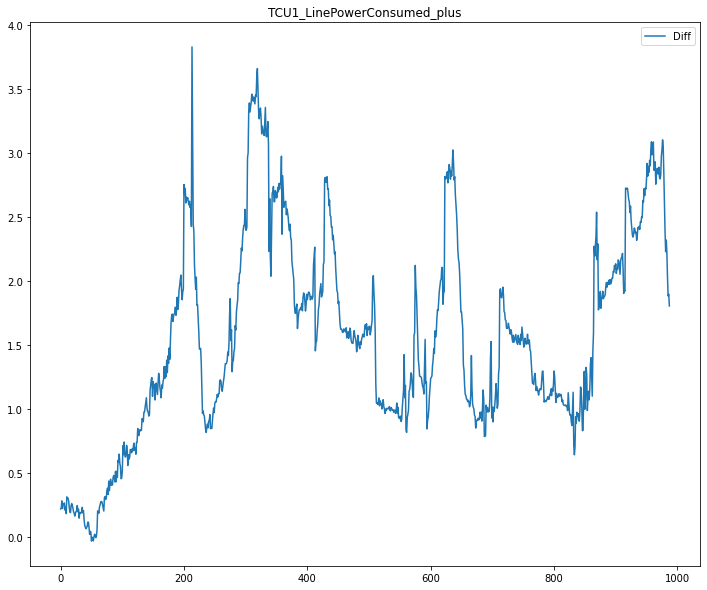

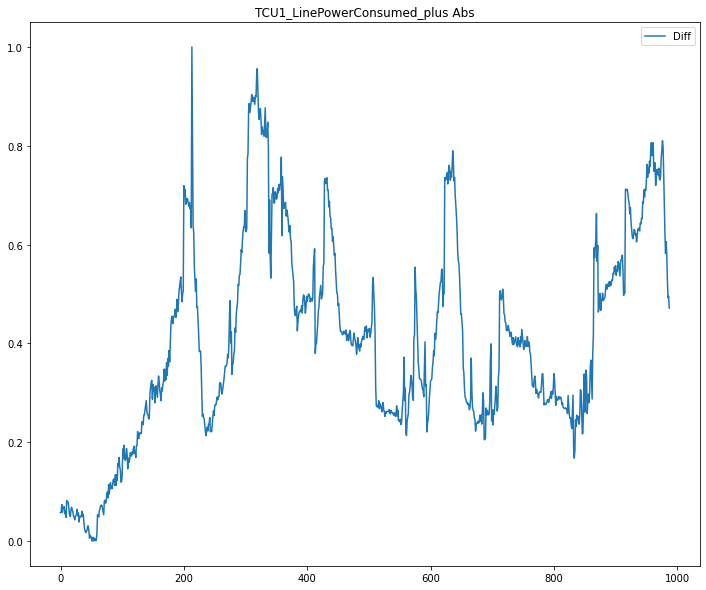

Fold : 2/3
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 291517392793.75%, std: 879368176369.37%
CV Mean:  -1.6452048968801258
STD:  2.2117180342009966




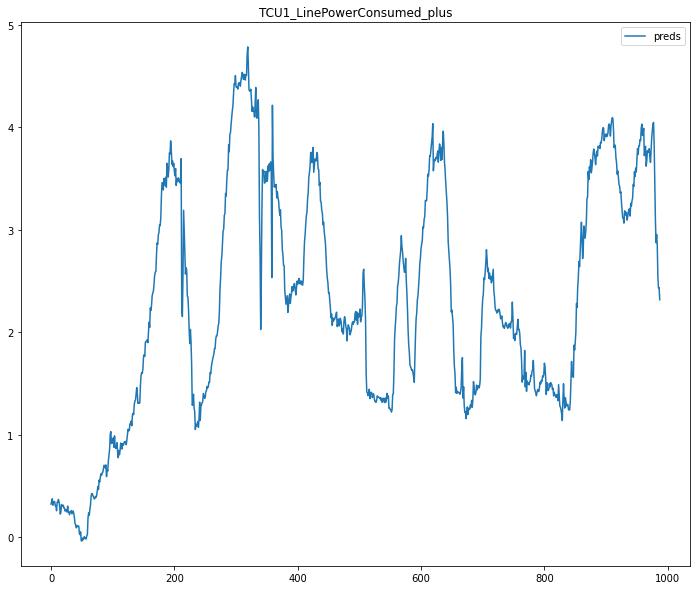

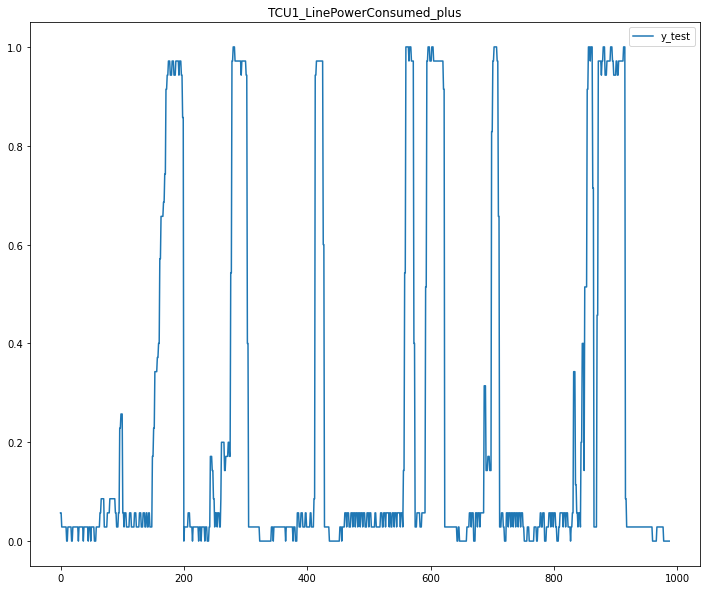

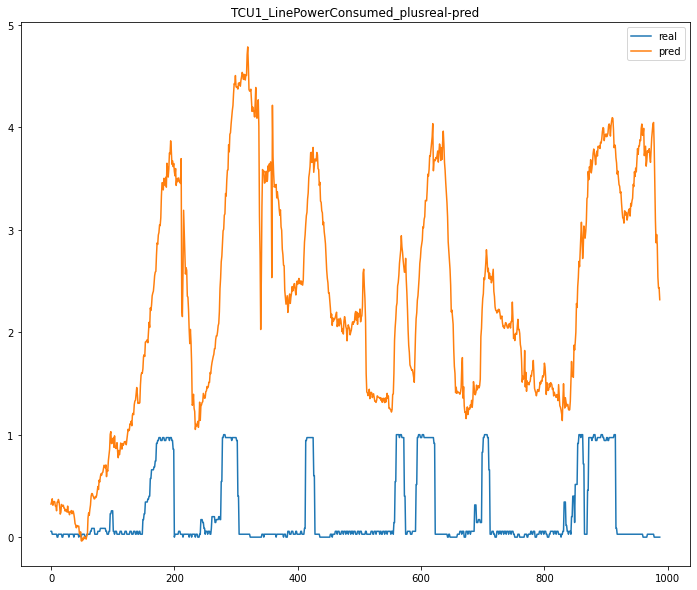

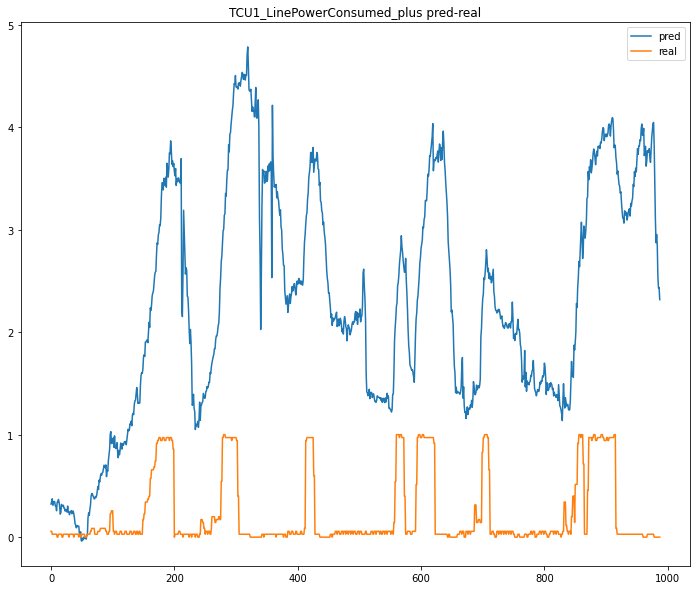

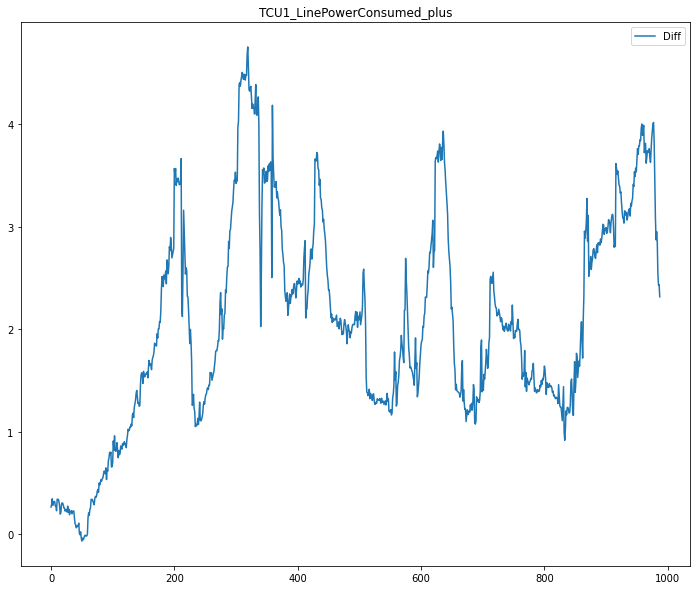

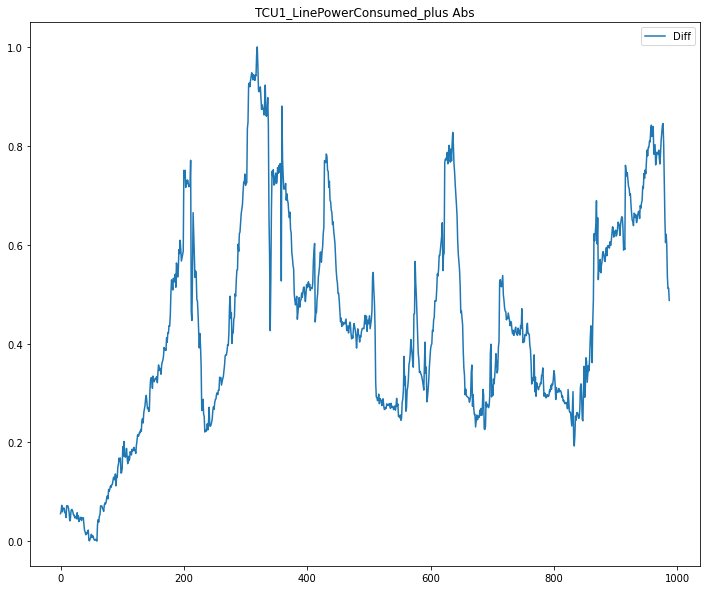

In [22]:
# from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import MeanAbsolutePercentageError
from sklearn.model_selection import TimeSeriesSplit, KFold, GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from keras.models import load_model

import numpy as np 

import random 

N_KFOLD=3
PLOT_PERCENT =None

result_list={}


#tscv = TimeSeriesSplit(n_splits=model_conf['n_kfold'])
tscv = KFold(n_splits=N_KFOLD,shuffle=True,random_state=42)
cont =0
for target in variables_objetivo[:1]:
    print (f'{target}')
    ignore_columns = list(set(conf_dict['ignore_columns'] + variables_objetivo +discard_columns + variables_objetivo_current)) 

    for kfold, (train_index, val_index) in enumerate(tscv.split(df['train'])):

        print (f'Fold : {kfold}/{N_KFOLD}')
#             if kfold > 0:
#                 continue

        X_train, y_train,features = models.prepare_dataset(df['train'], ignore_columns,target, kfold=train_index[:30000])
        X_val, y_val,_ = models.prepare_dataset(df['train'], ignore_columns,target, kfold=val_index[:30000])
        X_test, y_test,_ = models.prepare_dataset(df['test'][:10000], ignore_columns,target)



        rl = LinearRegression(n_jobs=-1)

        rl.fit(X_train, y_train)
        preds = rl.predict(X_test)

        quick_analysis(preds, y_test)
        scores = get_cv_scores(rl,X_train, y_train)

        train_info_dict = create_train_info_dict(store_model_path, [],target,'{}-{}'.format(str(cont),str(kfold)))
        train_info_dict['etl_version']=etl_step.ETL_VERSION
        train_info_dict['regresor']='rl'
        train_info_dict['features']=features
        train_info_dict['score']=scores
        train_info_dict['params']={}

        create_plots(preds, y_test, target,train_info_dict,'{}-{}'.format(str(cont),str(kfold)) ,plot_percent=PLOT_PERCENT)


        joblib.dump(rl, train_info_dict['model'])

        with open(train_info_dict['train_info'].format(scores),'wb') as f:
            pickle.dump( train_info_dict,f)
        result_list[target]=(scores,train_info_dict['train_info'].format(scores))
        cont+=1


In [23]:
result_filename = 'resultsRL_'+etl_step.ETL_VERSION+'_'+utils.get_timestamp()+'.pickle'

with open(result_filename,'wb') as f:
    pickle.dump( result_list,f)

# SVM

In [24]:
def create_params_list_svm(params_dict):
    list_params = []
    for kernel in params_dict['kernel']:
        print (kernel)
        for c in params_dict['C']:
            for coef0 in params_dict['coef0']:
                for gamma in params_dict['gamma']:
                    params={'kernel':kernel,
                            'C':c,
                            'coef0':coef0,
                             'gamma':gamma}
                    if 'poly' in kernel:
                        for degree in params_dict['degree']:
                            params={'kernel':kernel,
                                    'C':c,
                                    'coef0':coef0,
                                    'gamma':gamma,
                                    'degree':degree}
                            list_params.append(params)
                    else:
                        params={'kernel':kernel,
                                'C':c,
                                'coef0':coef0,
                                'gamma':gamma,
                                'degree':3}
                        list_params.append(params)
    return list_params

def create_filename_template(path,params,target,kfold, score=False):
    filename = ['modelSVM']
    if score:
        filename += ['S{}']
    filename += ['T'+target]
    filename += ['KF'+str(kfold)]
    filename += ['K'+str(params['kernel'])]
    filename += ['C'+str(params['C'])]
    filename += ['D'+str(params.get('degree',None))]
    filename += ['C0'+str(params['coef0'])]
    filename += ['G'+str(params['gamma'])]
    filename = "-".join(filename)
    filename = os.path.join(path, filename)
    return filename

linear
poly
rbf
sigmoid
TCU1_LinePowerConsumed_plus
0 / 10
{'kernel': 'linear', 'C': 1, 'coef0': 10, 'gamma': 'scale', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 13057944221.30%, std: 38971243937.73%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2220113305943046
STD:  1.6514540351502245




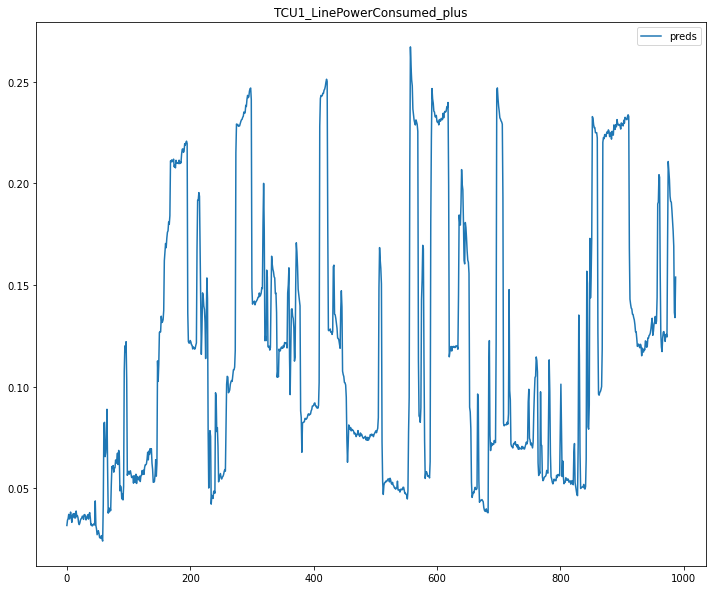

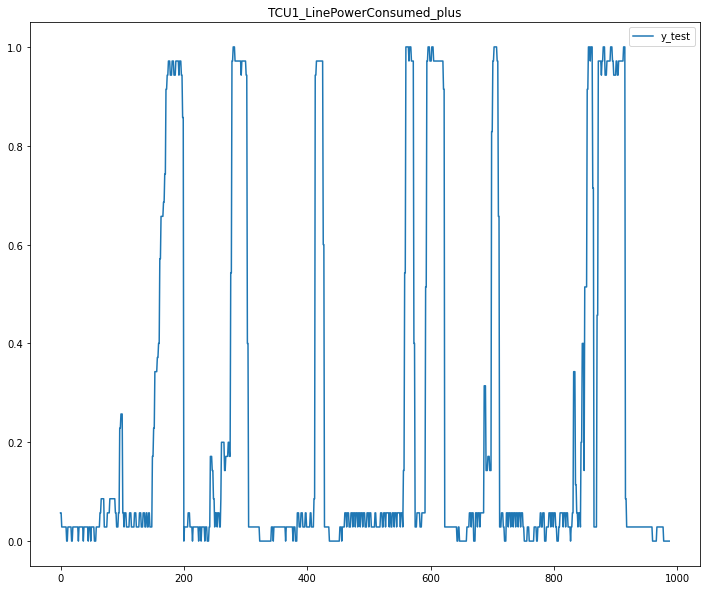

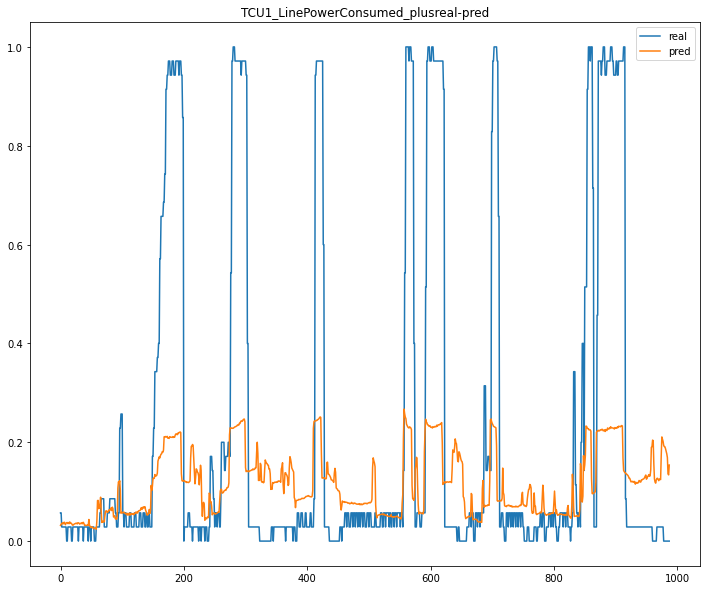

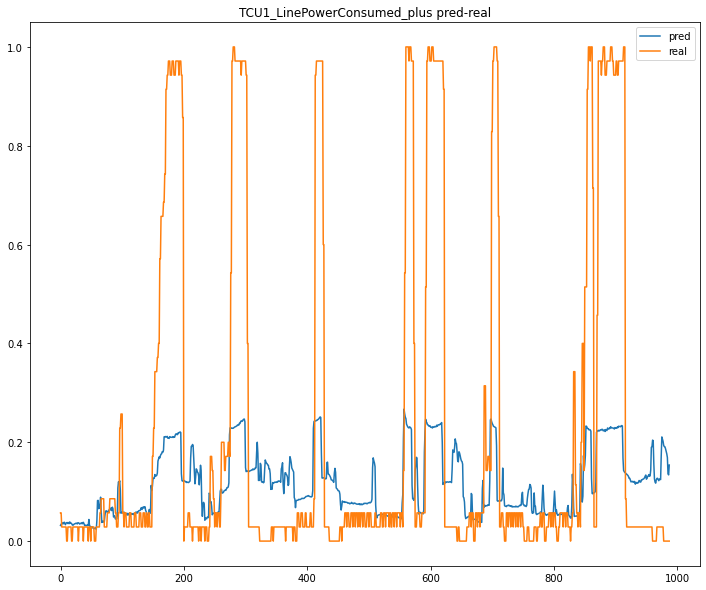

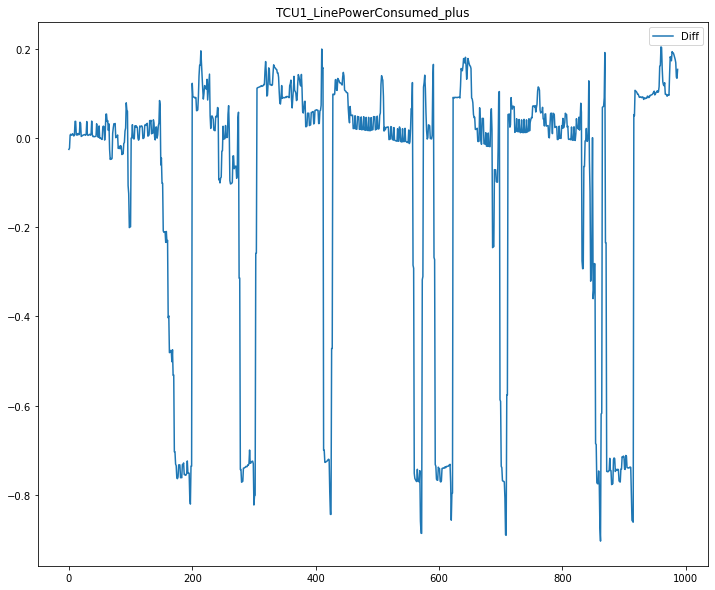

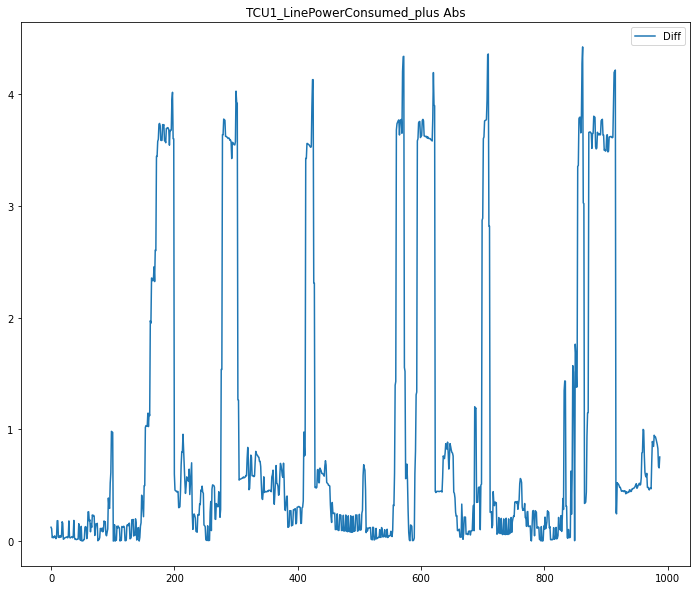

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12759708764.41%, std: 38861790079.06%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2414470517043577
STD:  1.56267699122586




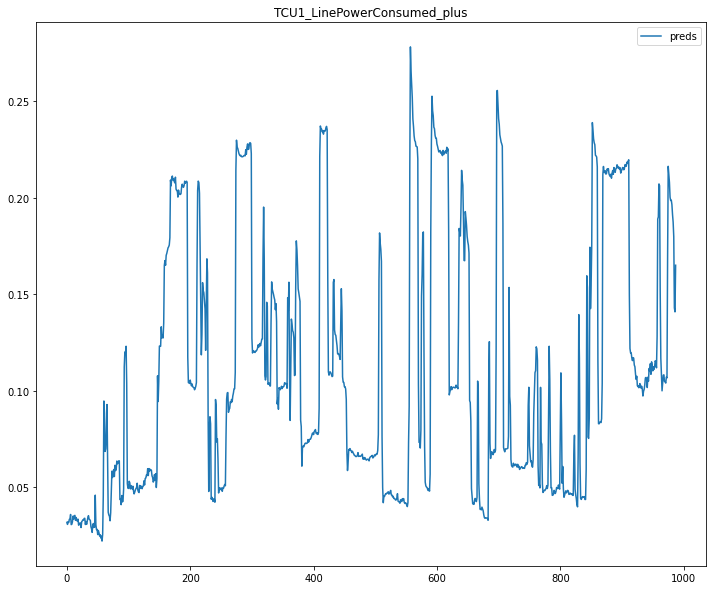

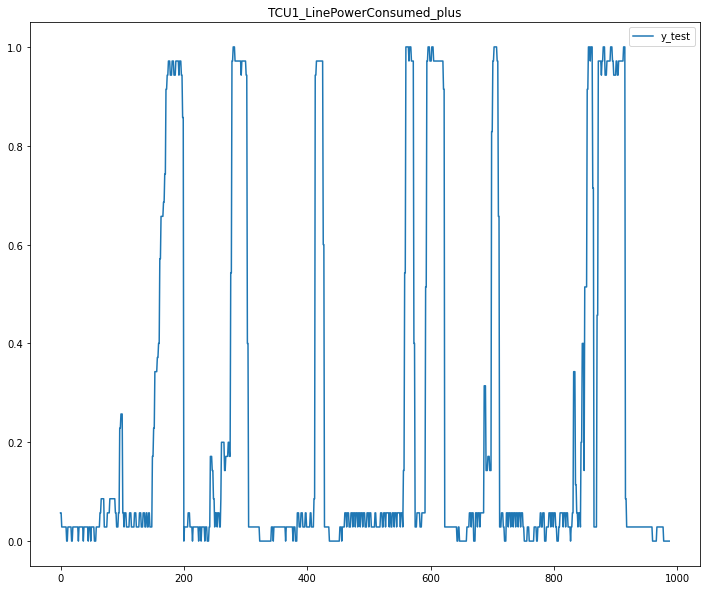

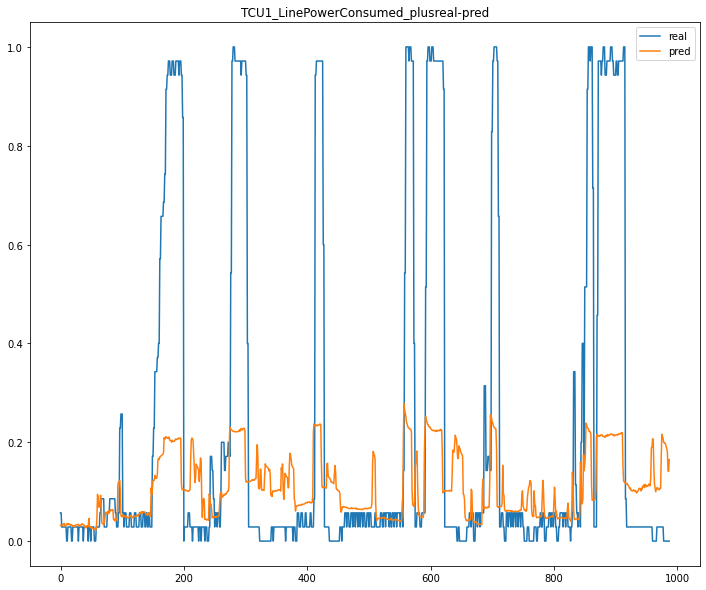

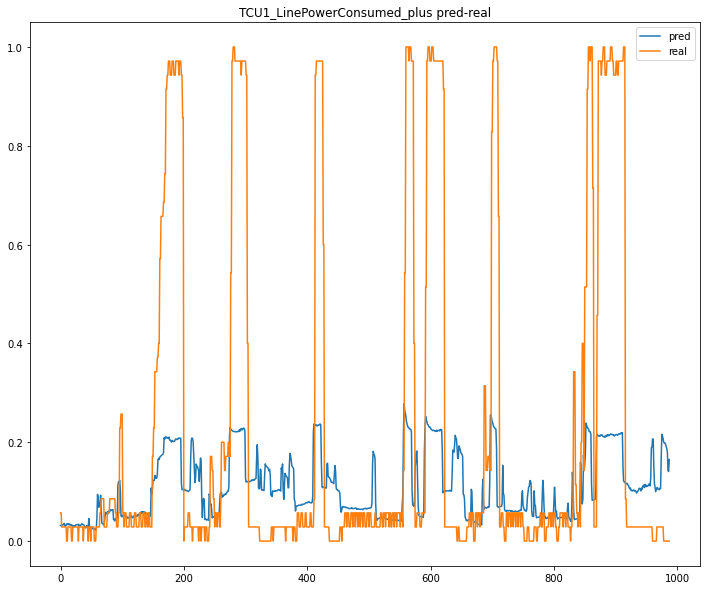

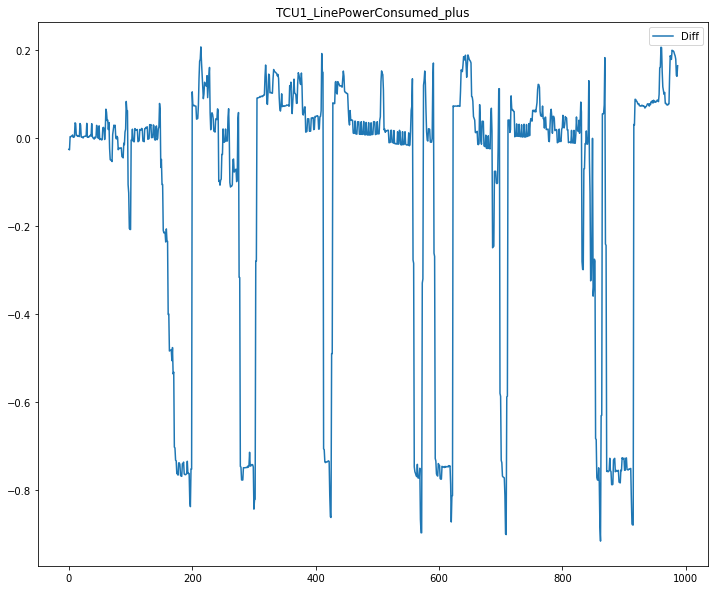

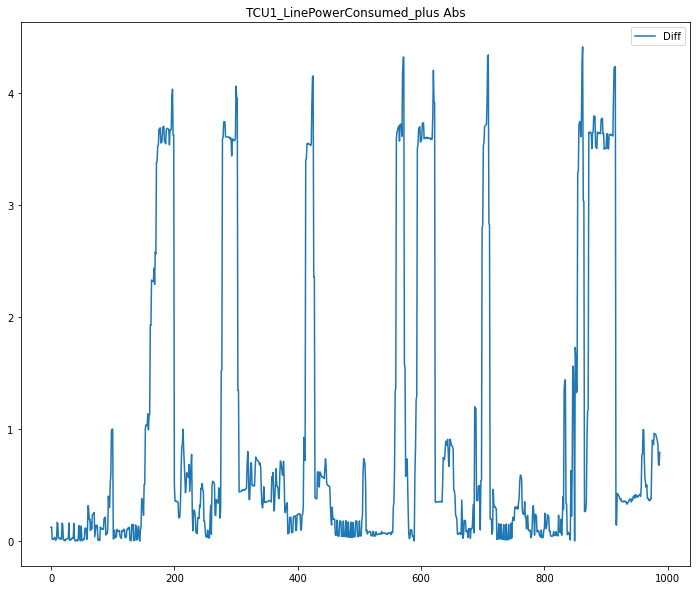

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11072636990.34%, std: 30936505744.07%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.6752717867357182
STD:  1.0862393733511577




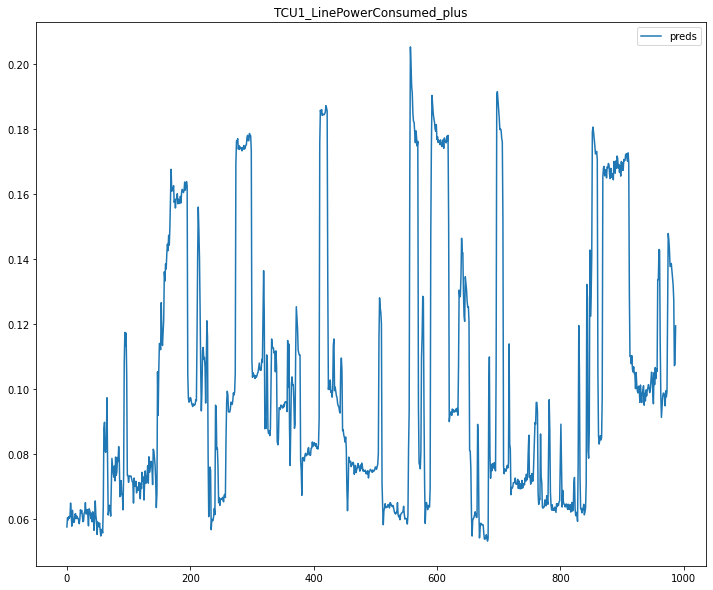

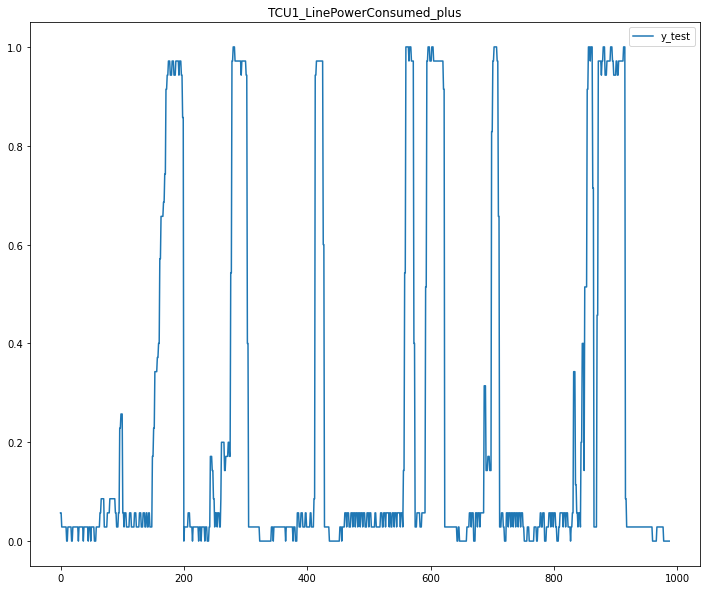

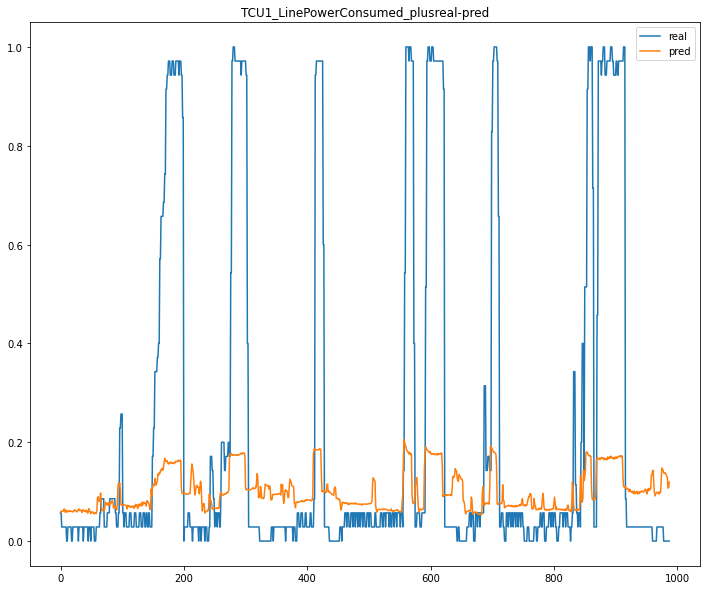

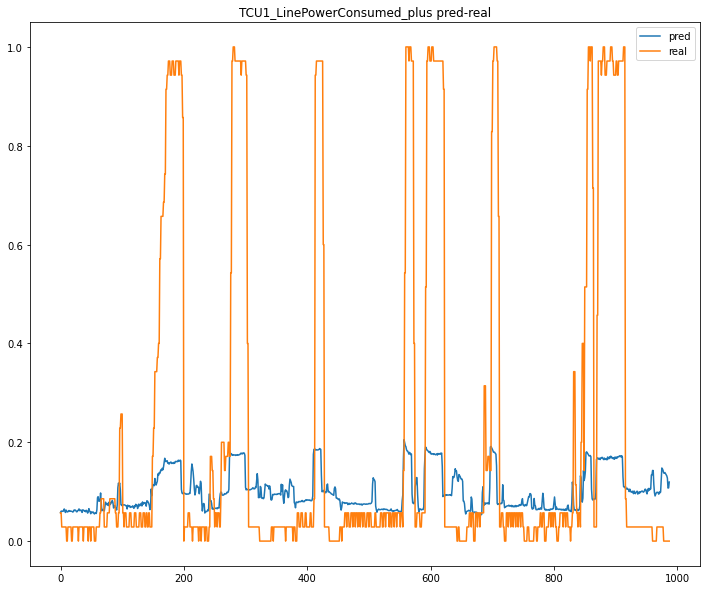

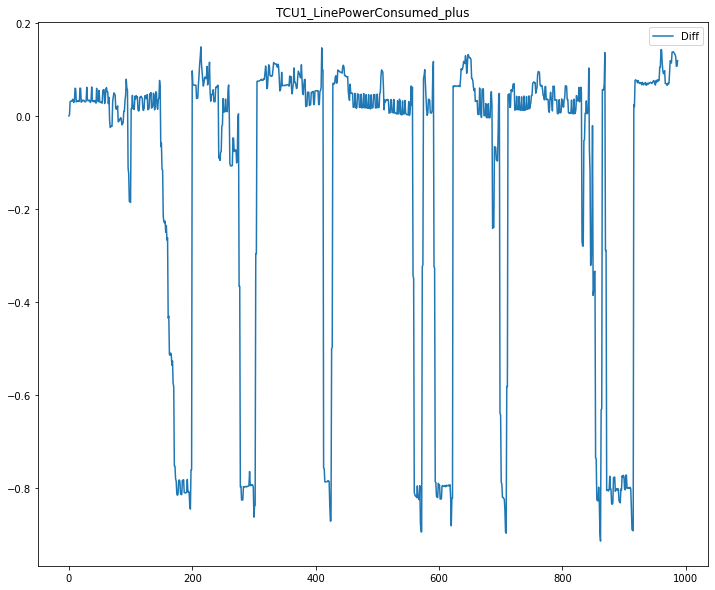

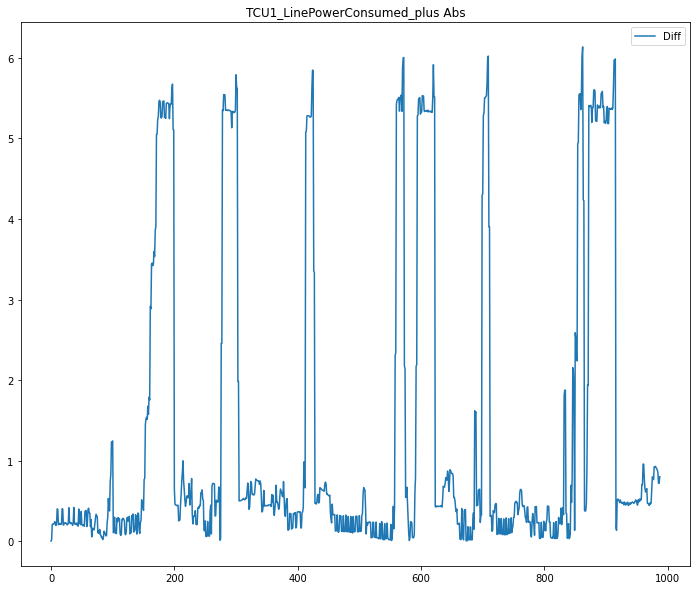

1 / 10
{'kernel': 'linear', 'C': 1, 'coef0': 0.01, 'gamma': 'scale', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 13057944221.30%, std: 38971243937.73%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2220113305943046
STD:  1.6514540351502245




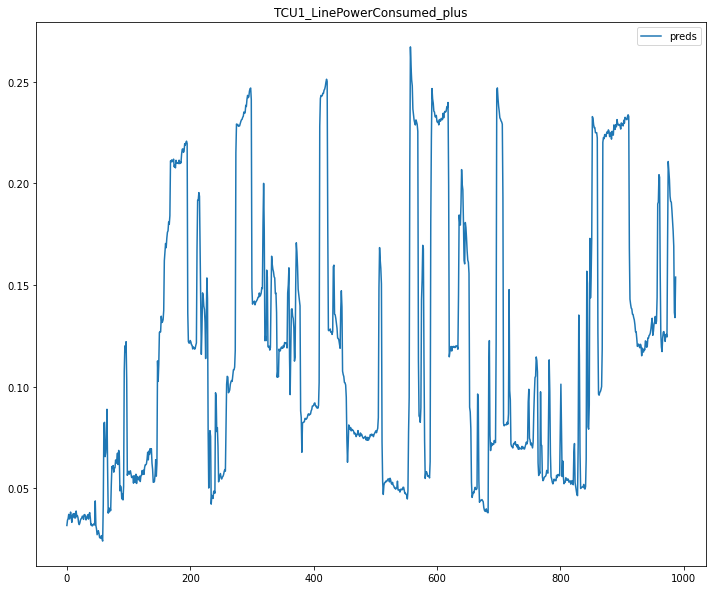

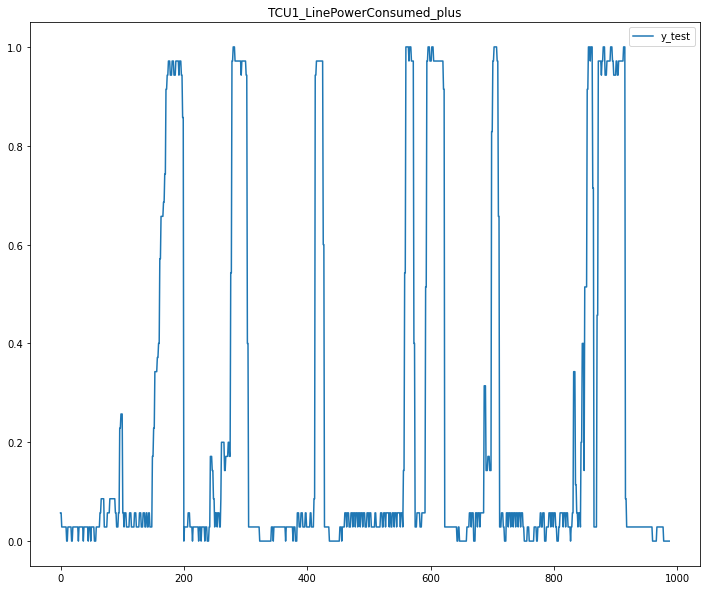

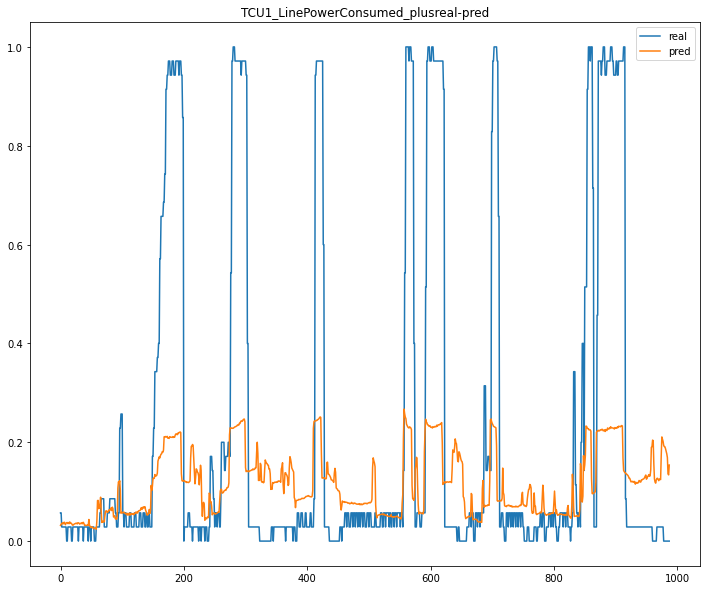

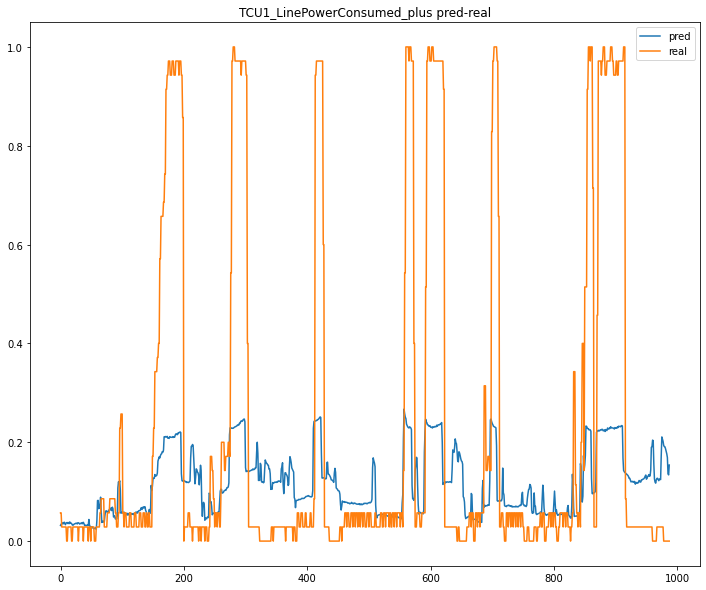

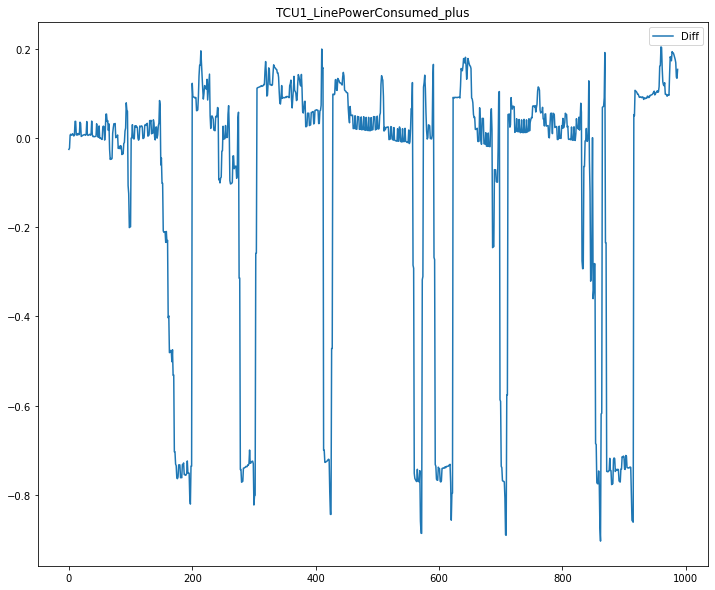

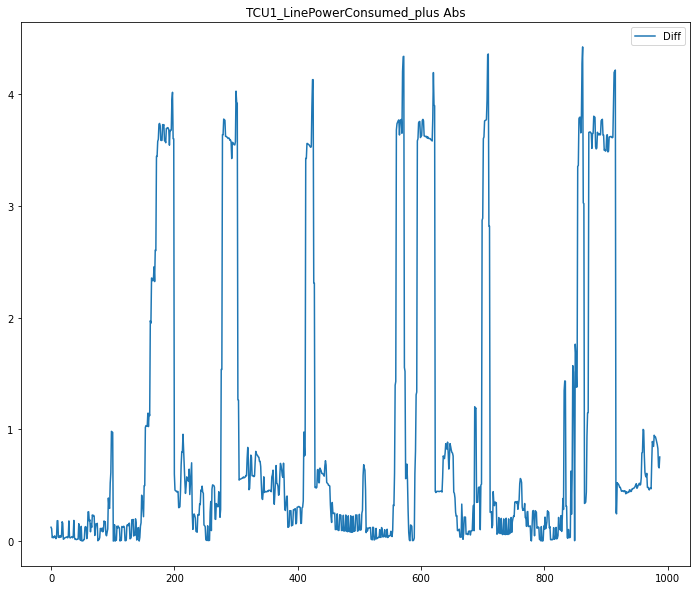

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12759708764.41%, std: 38861790079.06%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2414470517043577
STD:  1.56267699122586




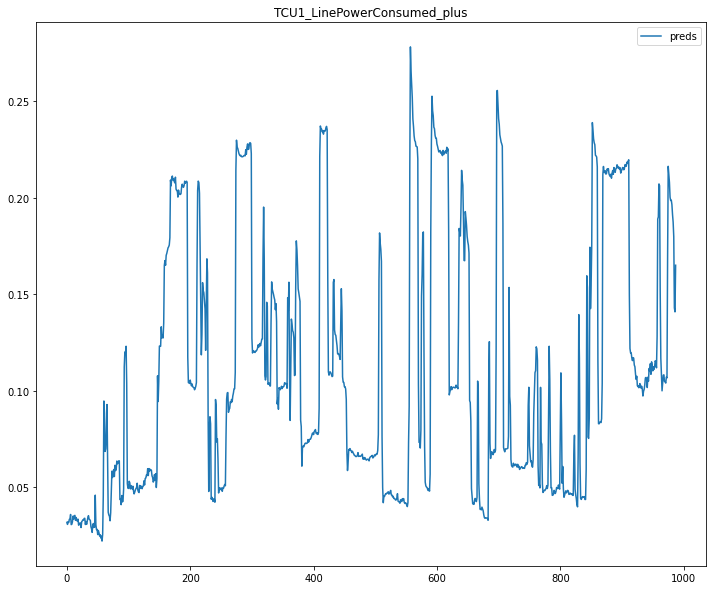

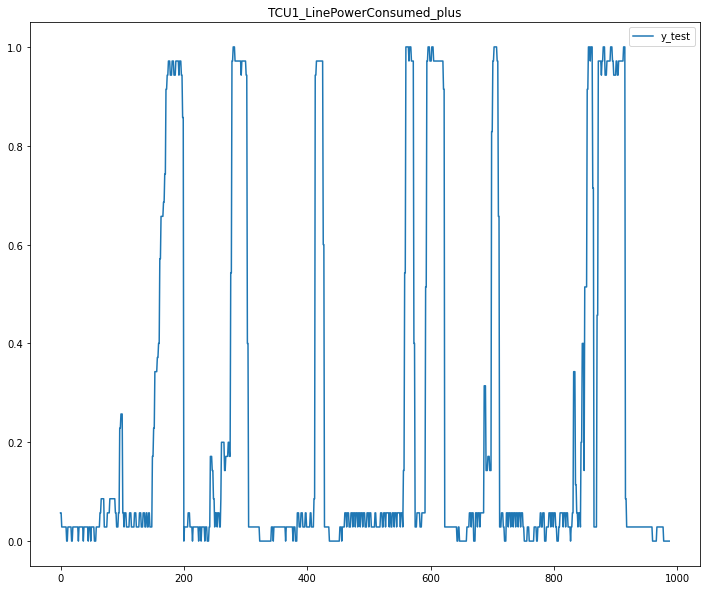

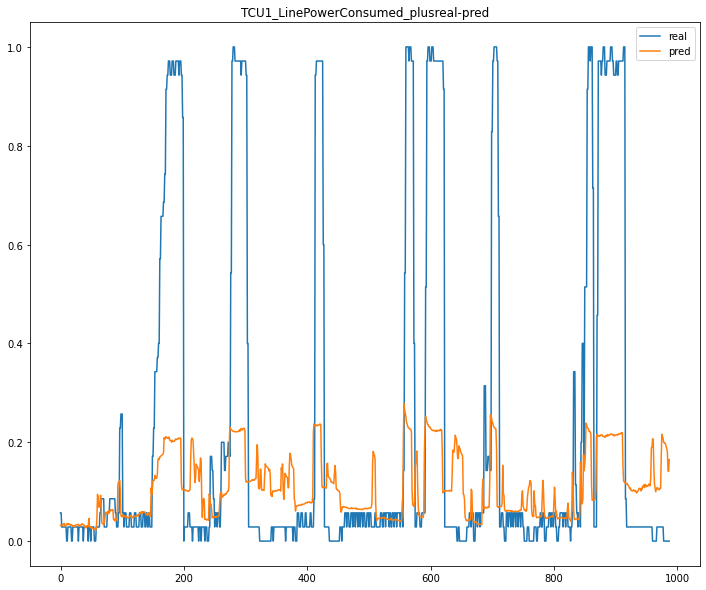

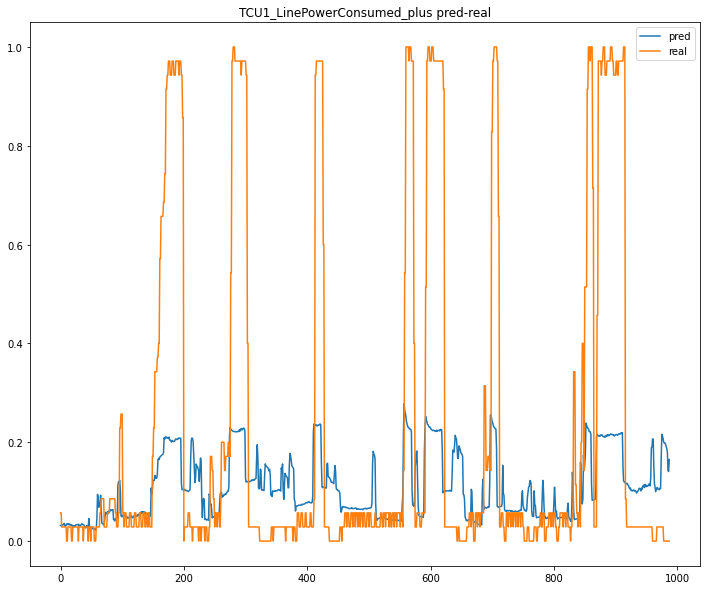

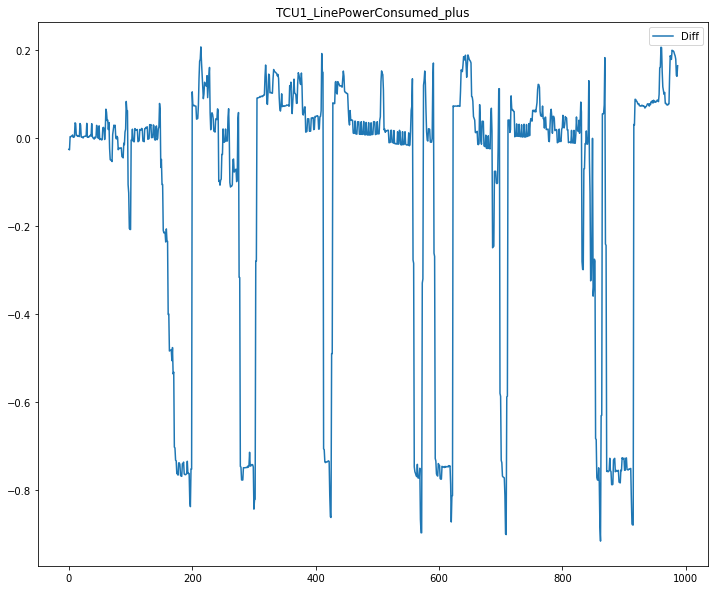

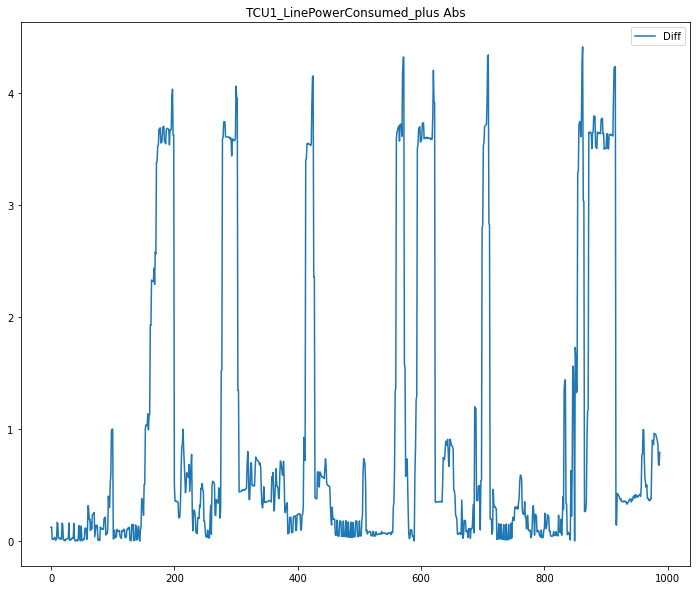

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11072636990.34%, std: 30936505744.07%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.6752717867357182
STD:  1.0862393733511577




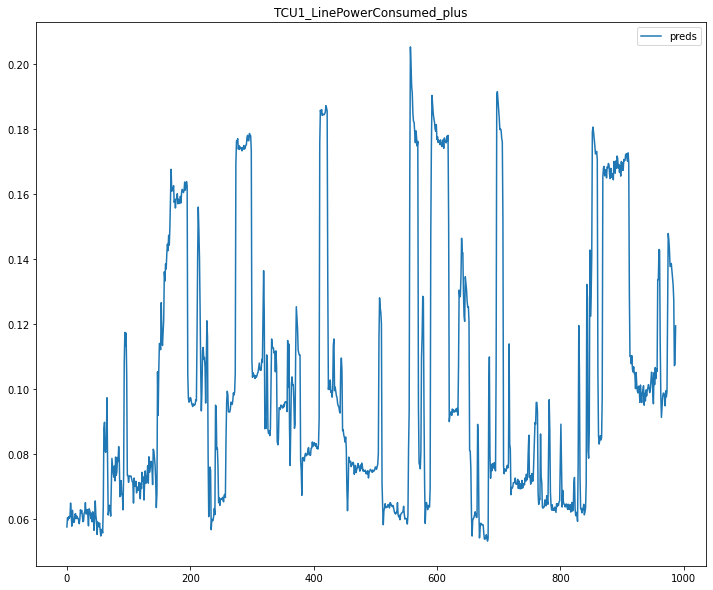

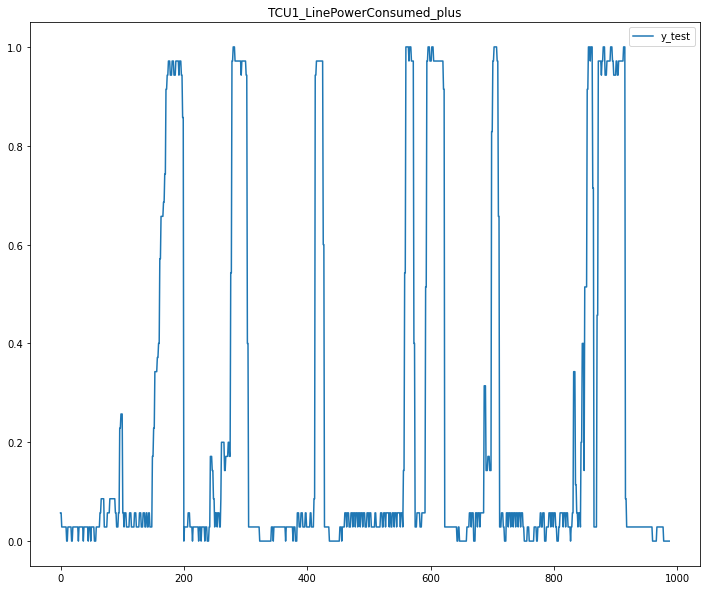

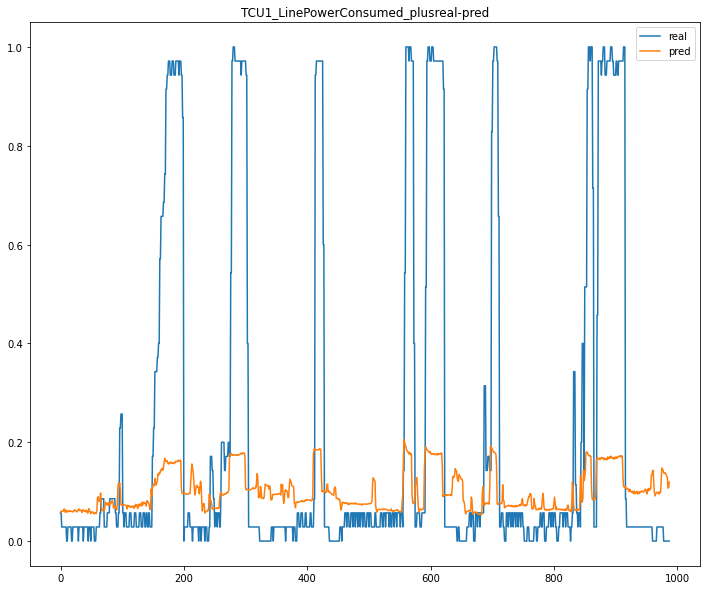

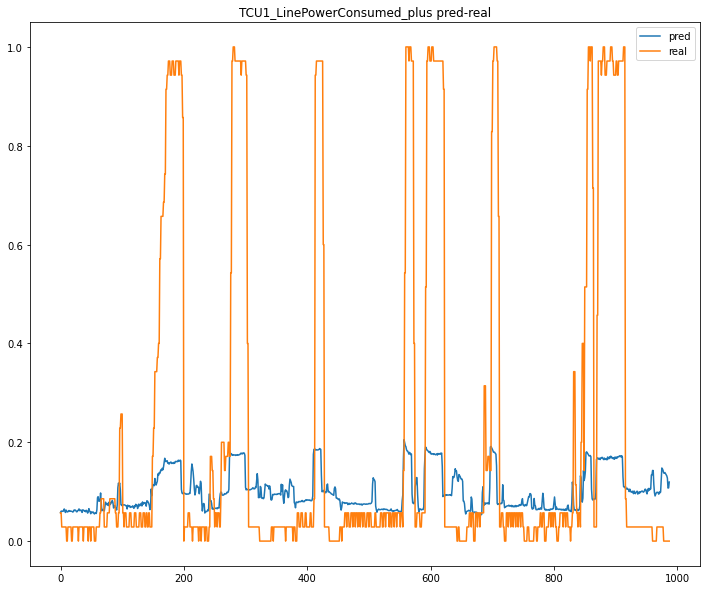

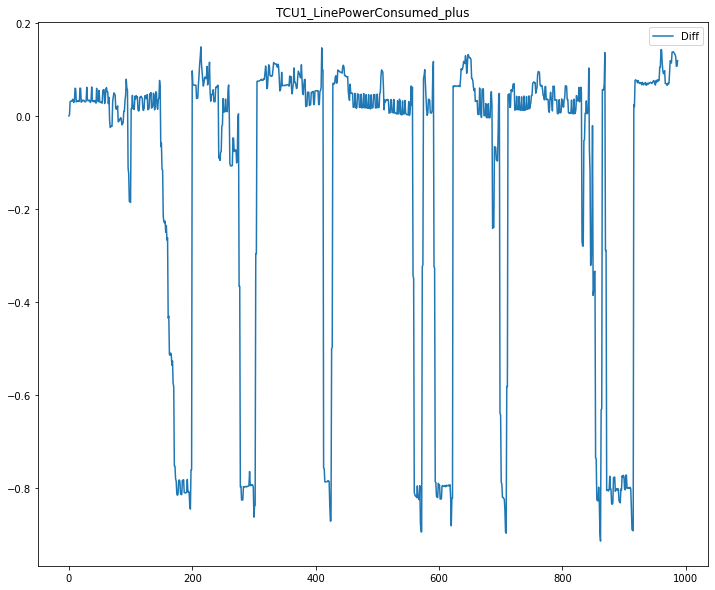

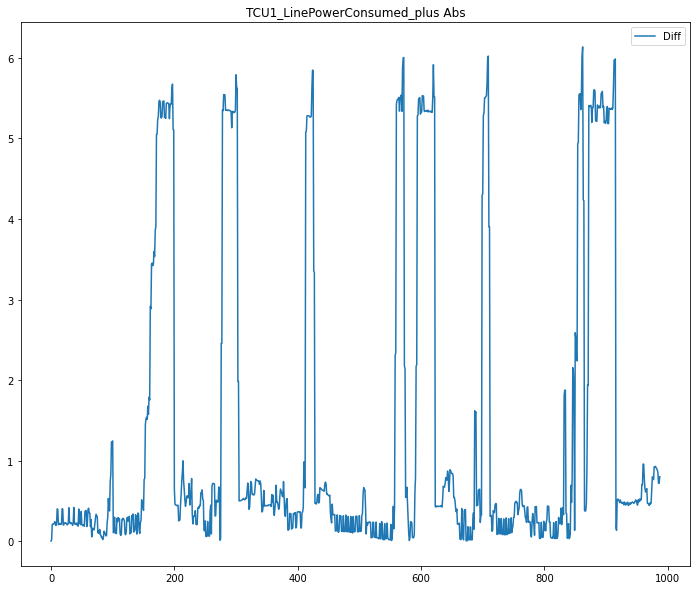

2 / 10
{'kernel': 'linear', 'C': 1, 'coef0': 0.5, 'gamma': 'auto', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 13057944221.30%, std: 38971243937.73%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2220113305943046
STD:  1.6514540351502245




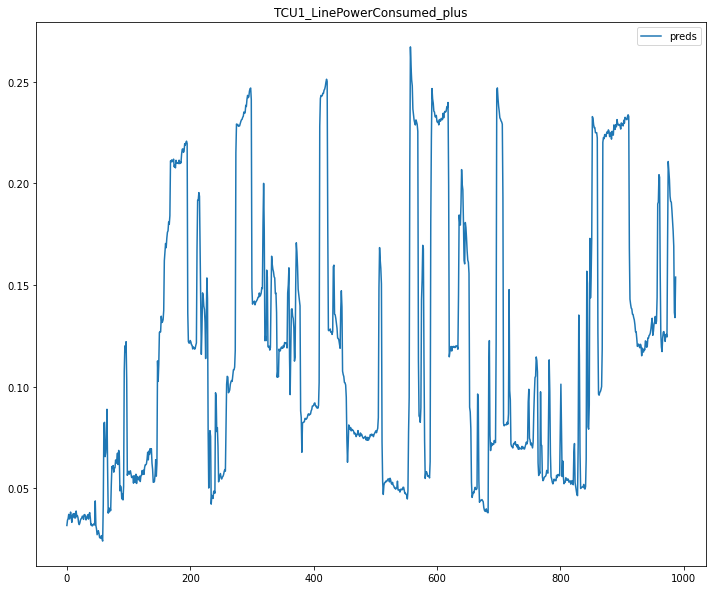

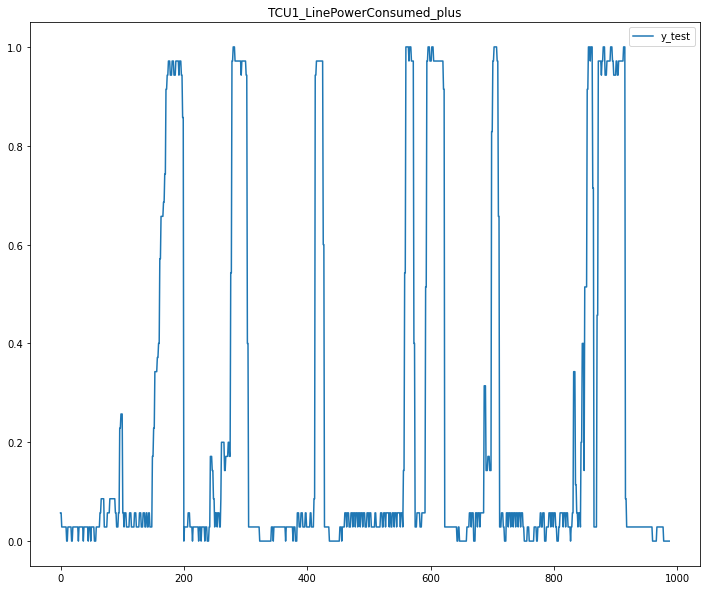

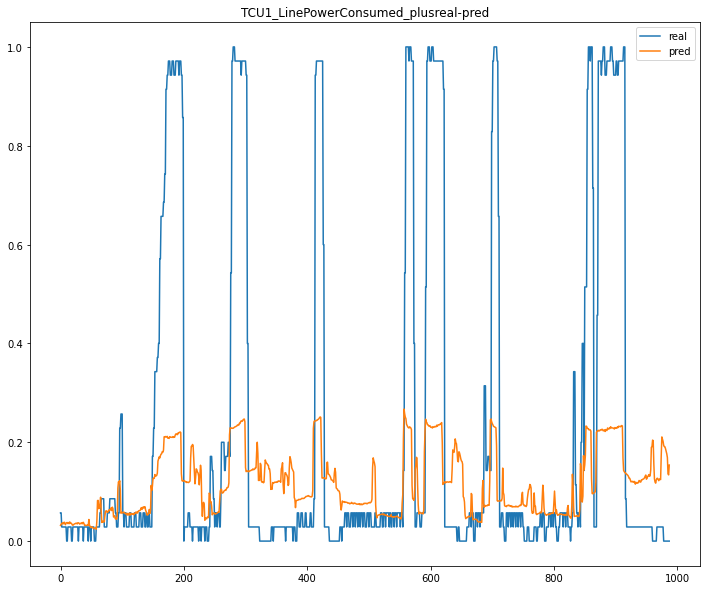

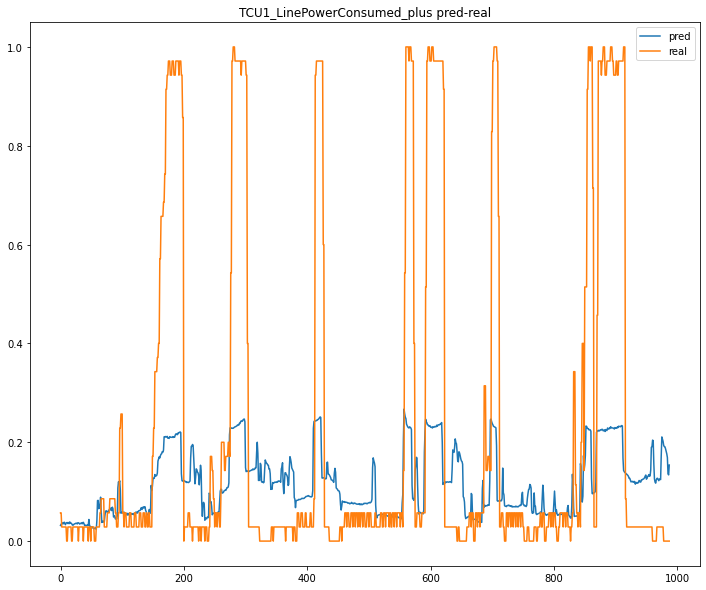

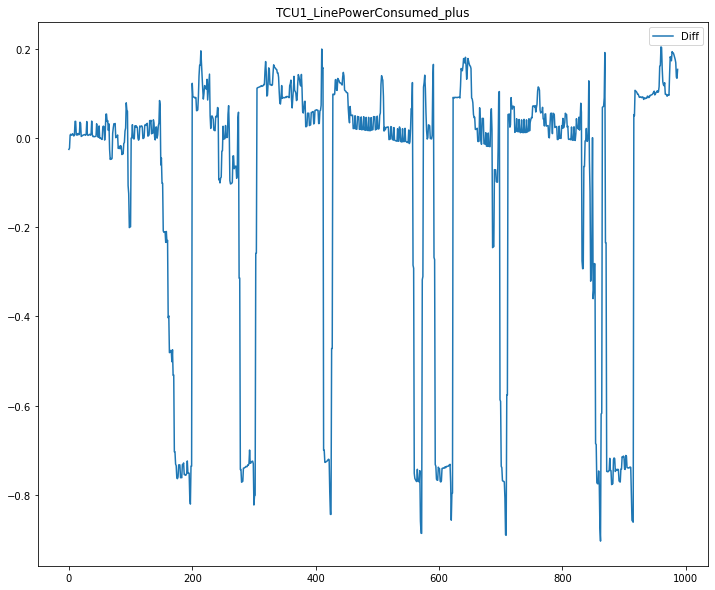

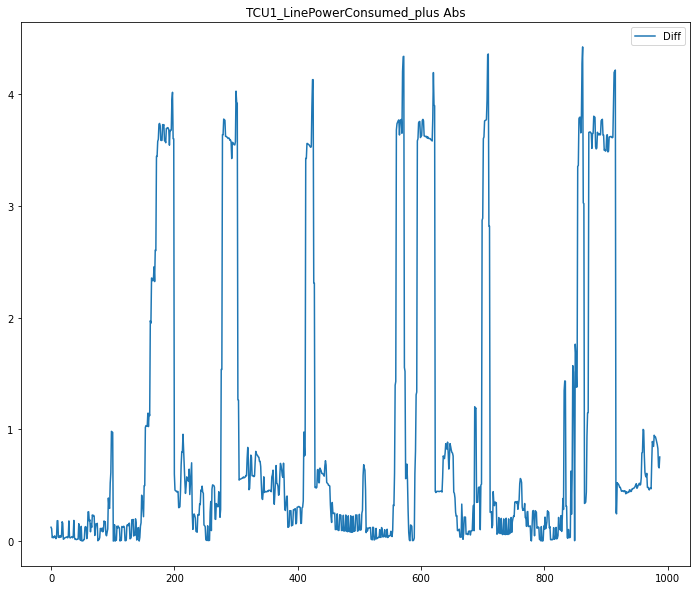

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12759708764.41%, std: 38861790079.06%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2414470517043577
STD:  1.56267699122586




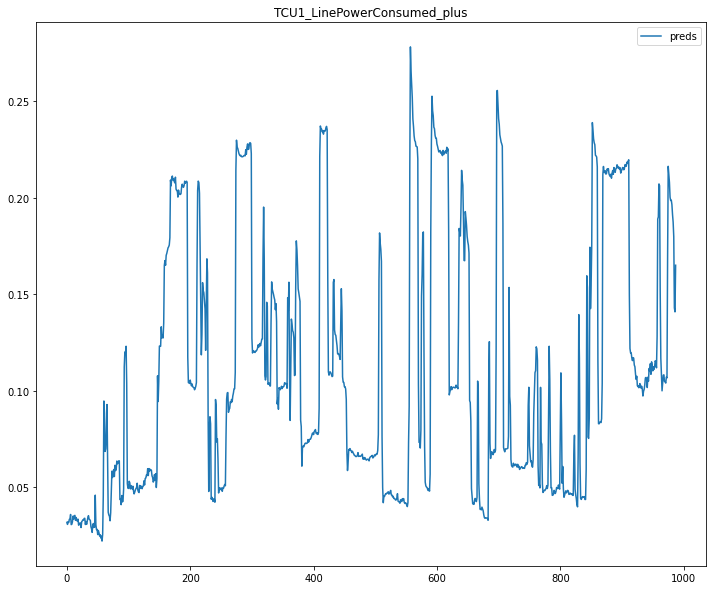

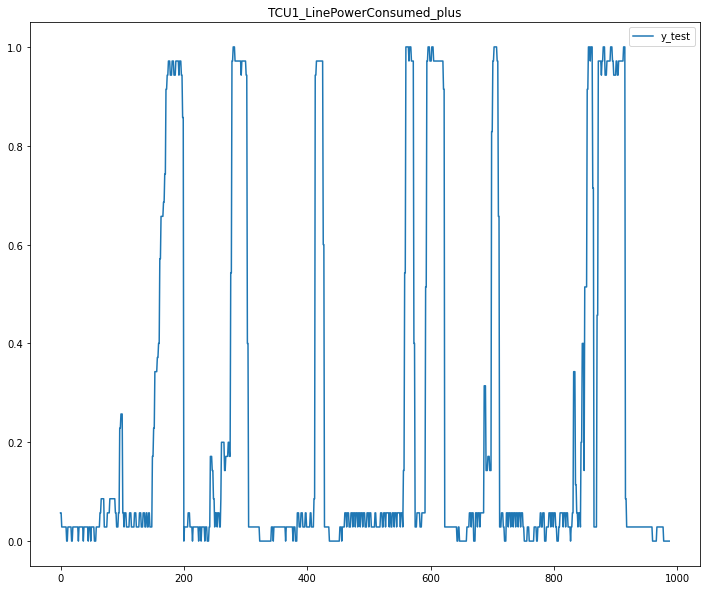

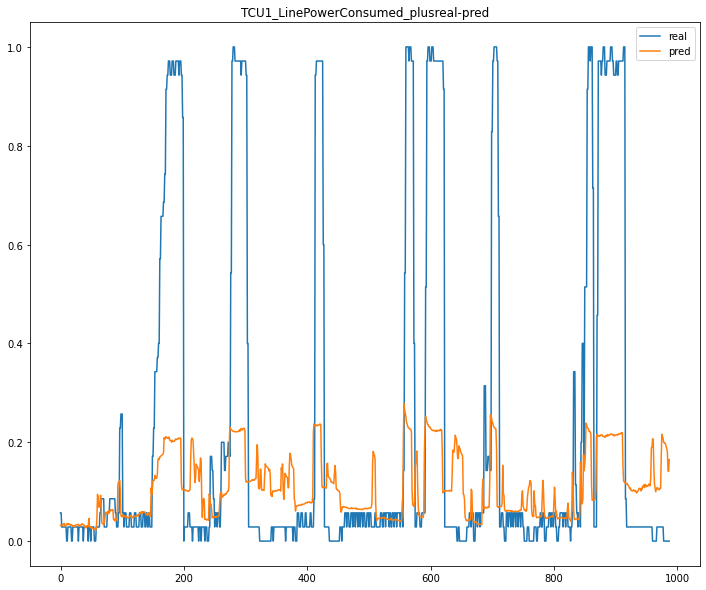

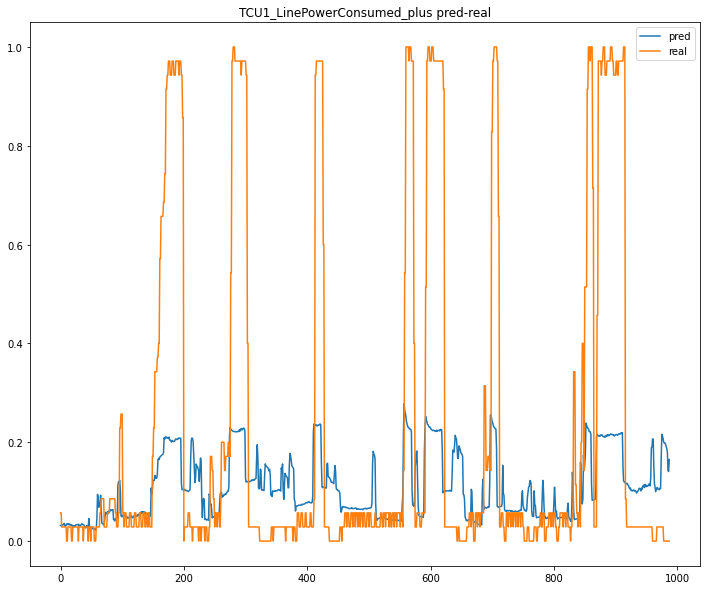

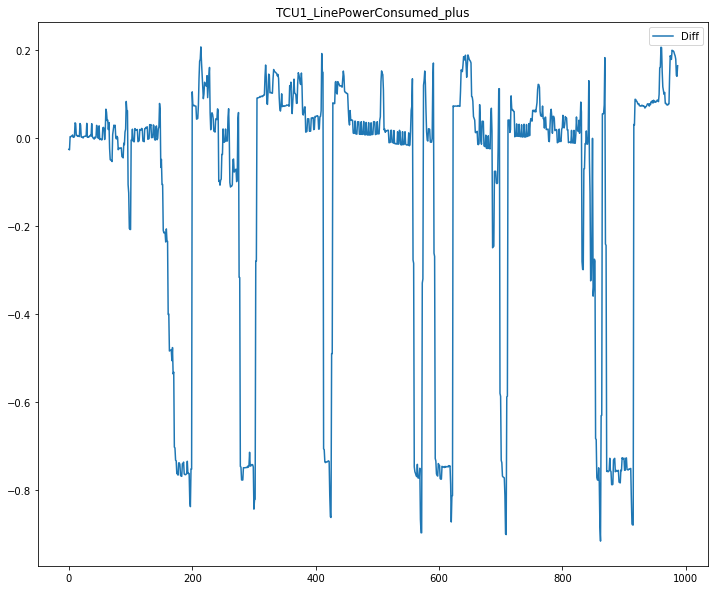

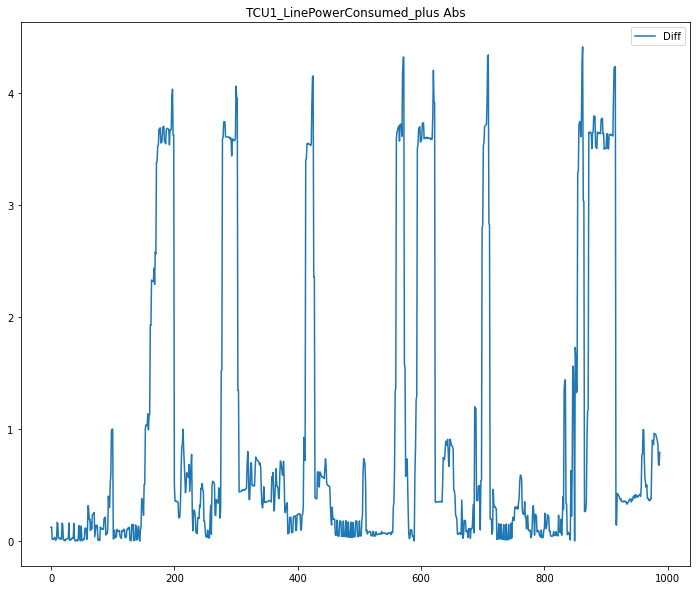

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11072636990.34%, std: 30936505744.07%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.6752717867357182
STD:  1.0862393733511577




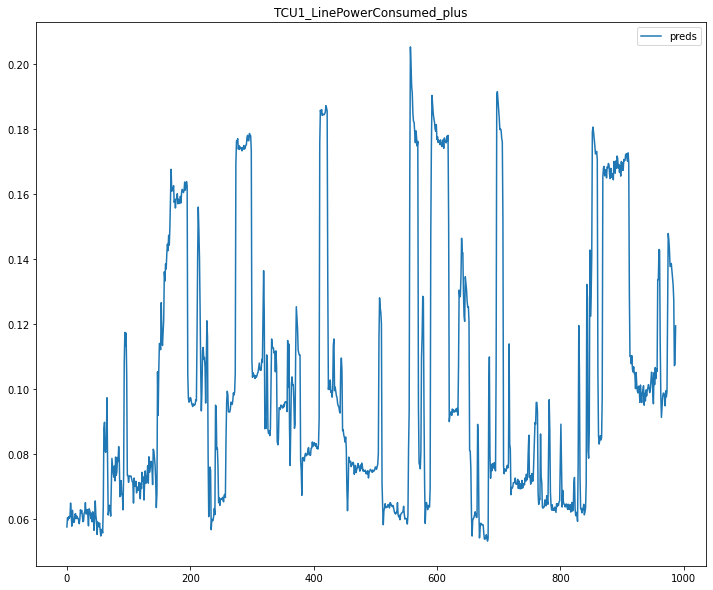

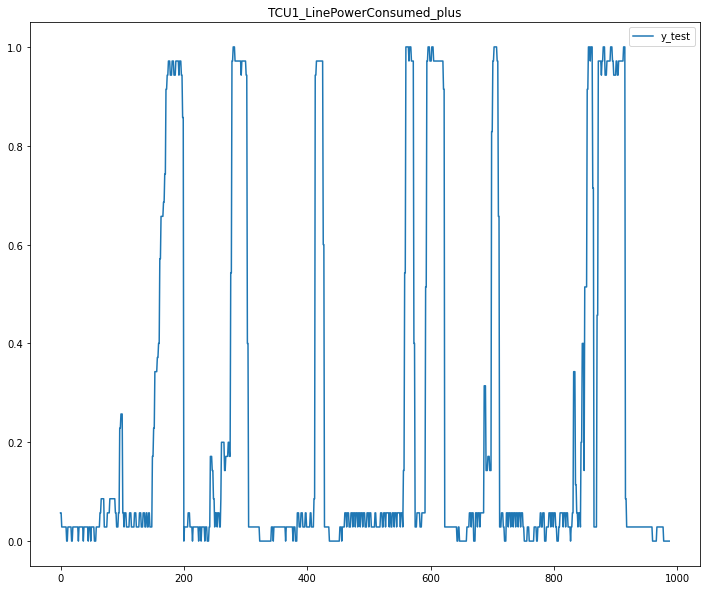

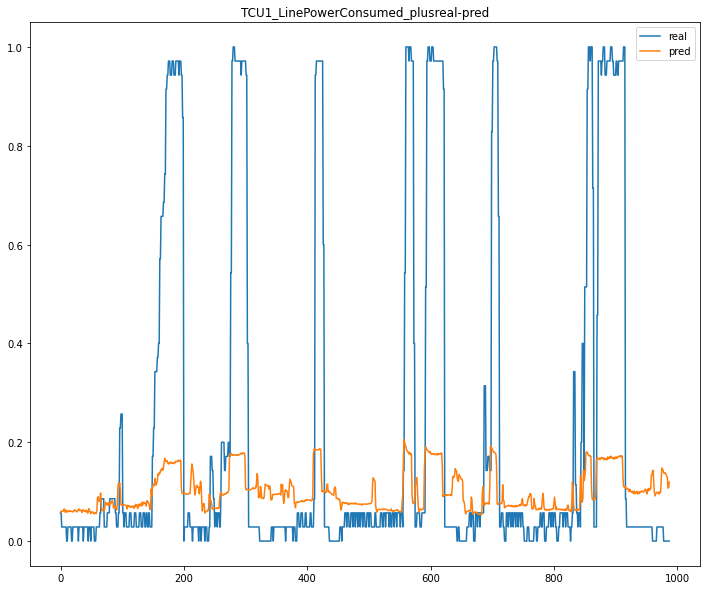

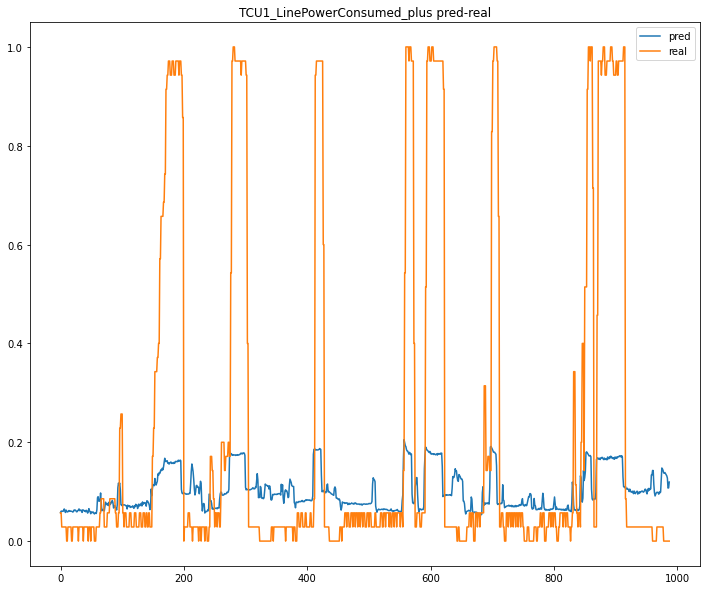

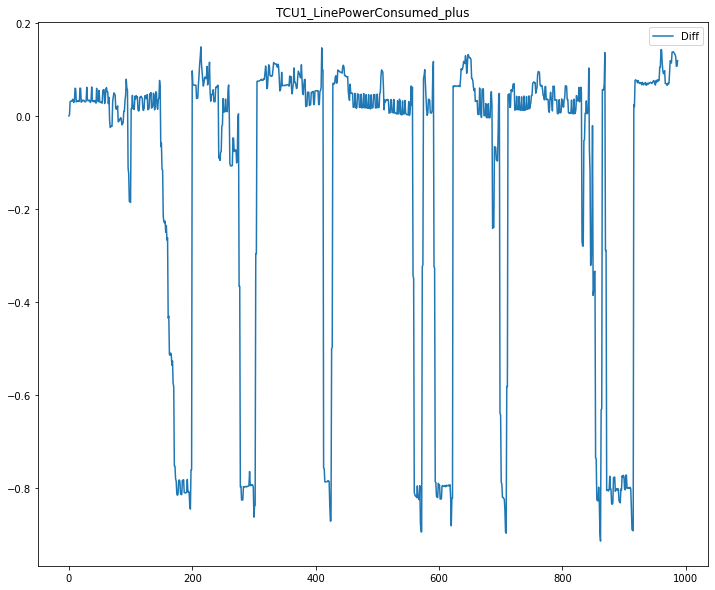

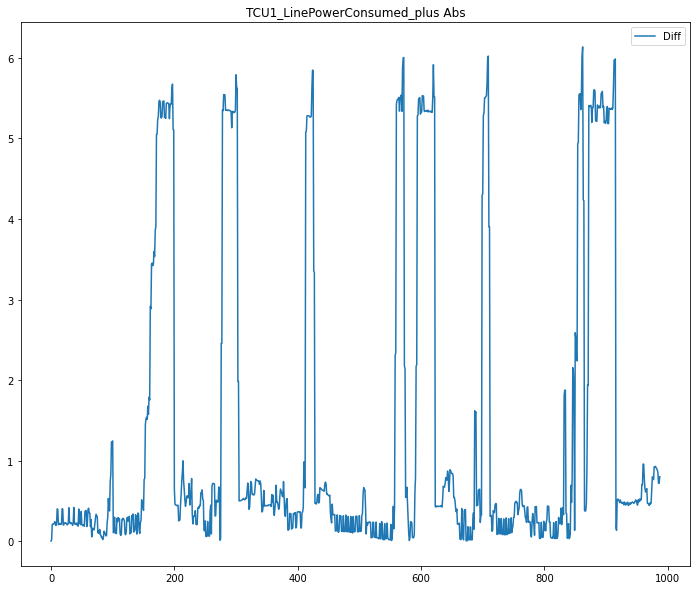

3 / 10
{'kernel': 'linear', 'C': 5, 'coef0': 10, 'gamma': 'auto', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14459783314.77%, std: 43144173423.44%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.35740249452793
STD:  1.811165855369843




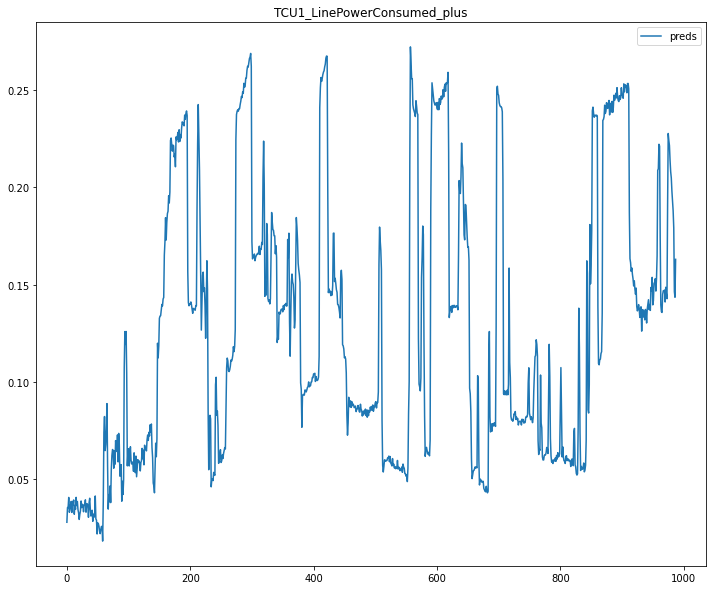

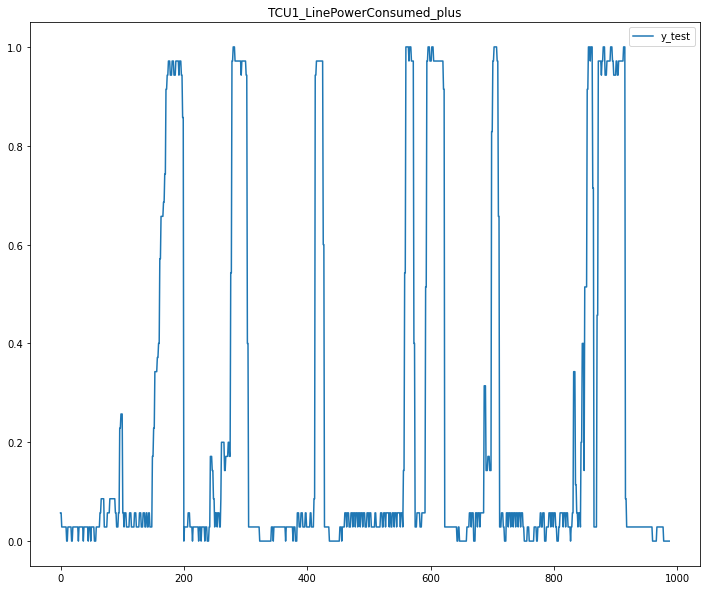

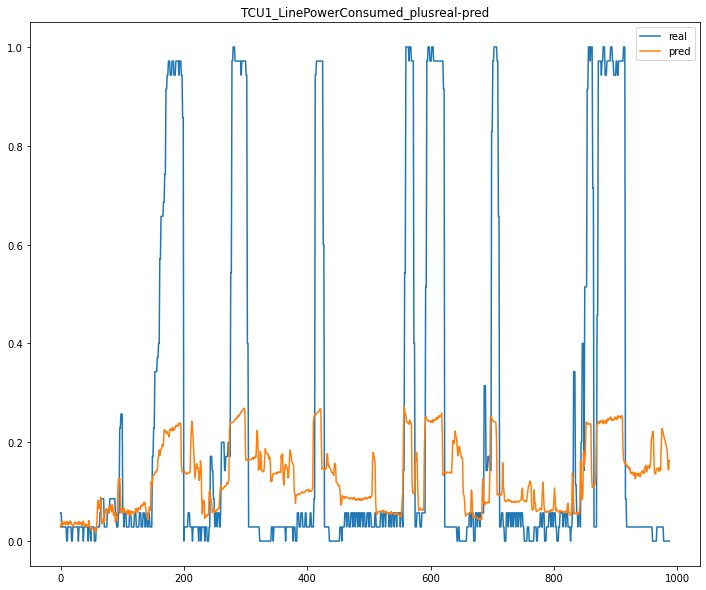

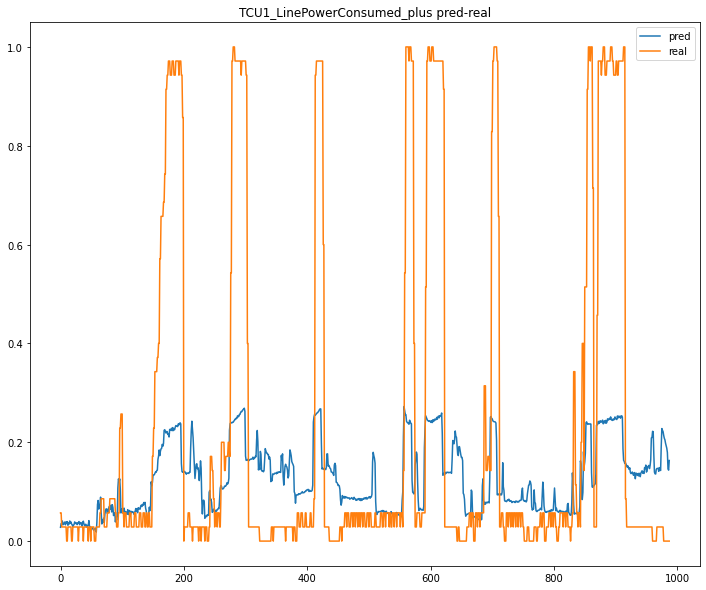

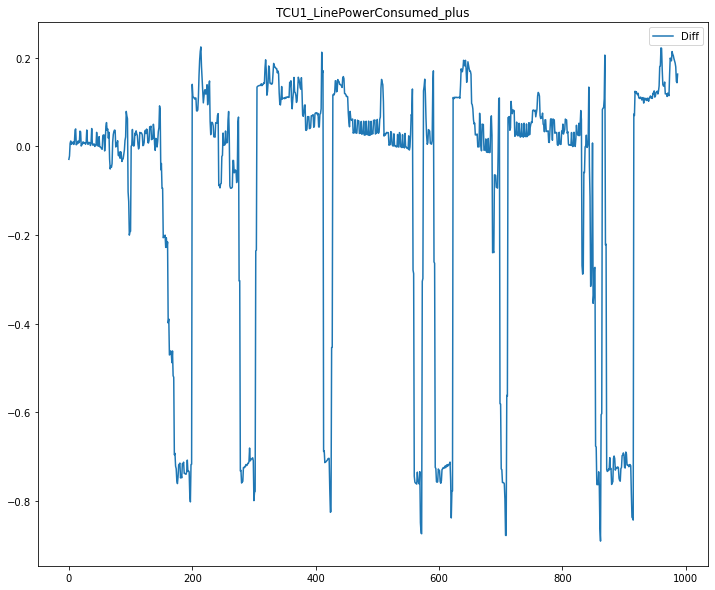

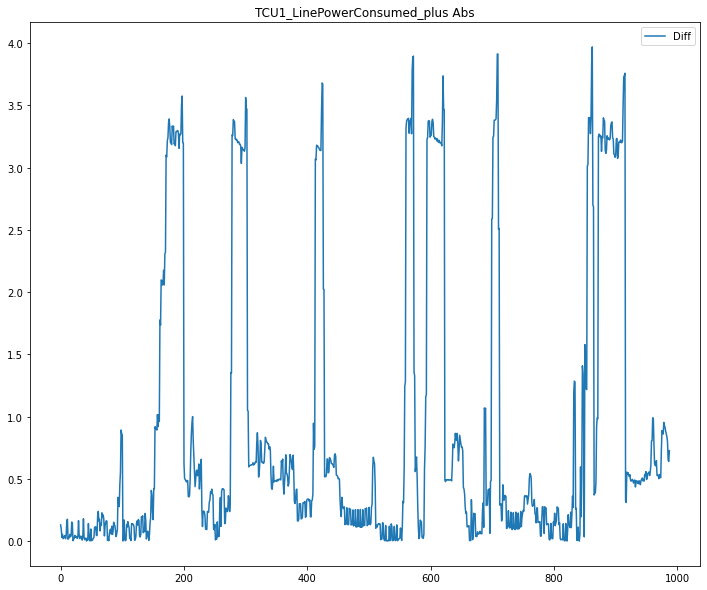

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14409321653.58%, std: 43682198309.48%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.255533126545516
STD:  1.5822212958771442




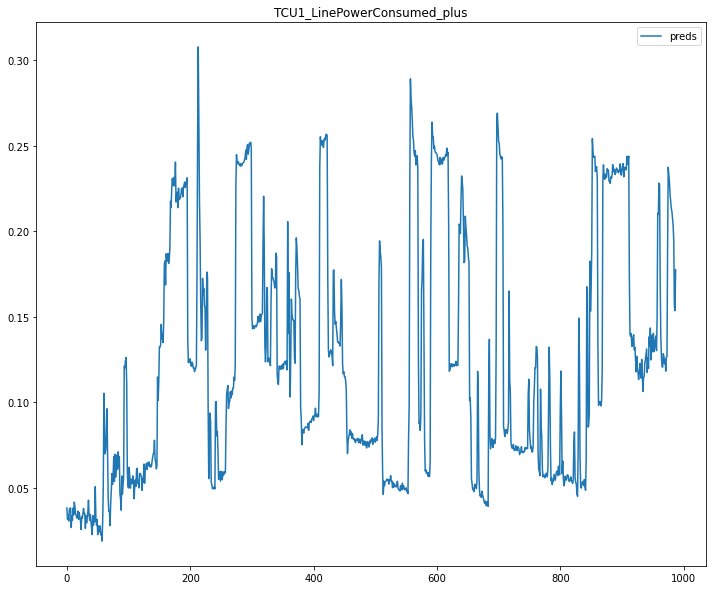

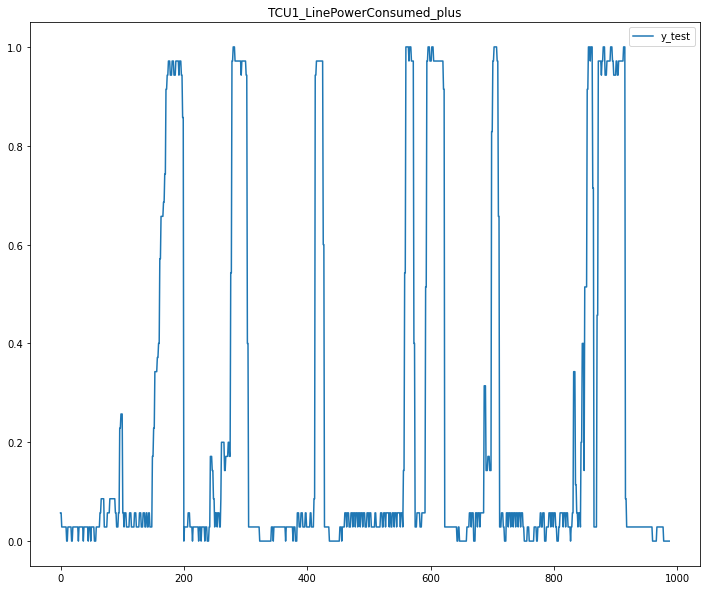

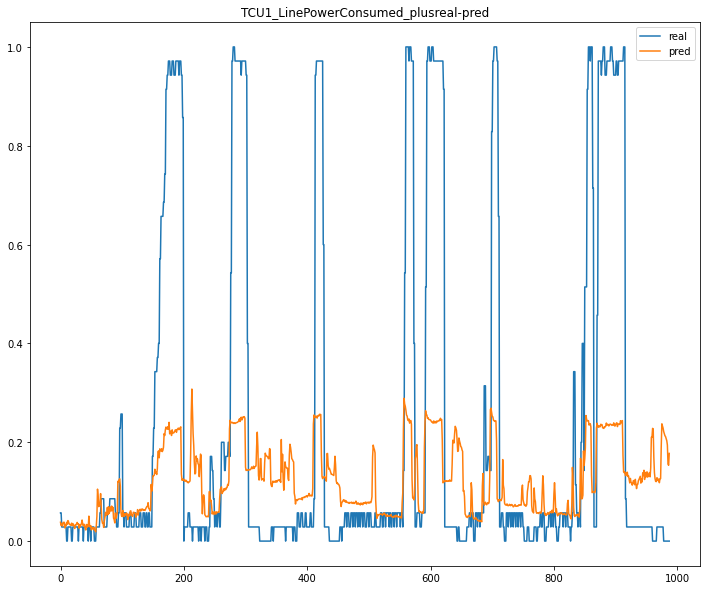

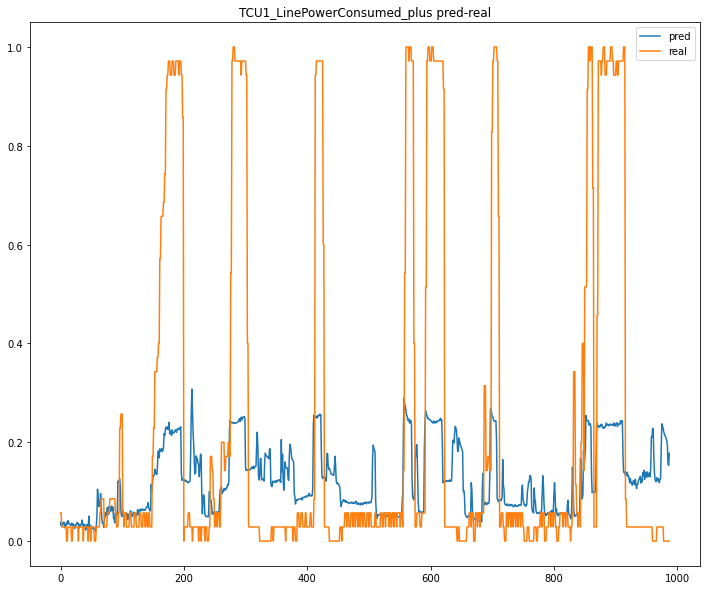

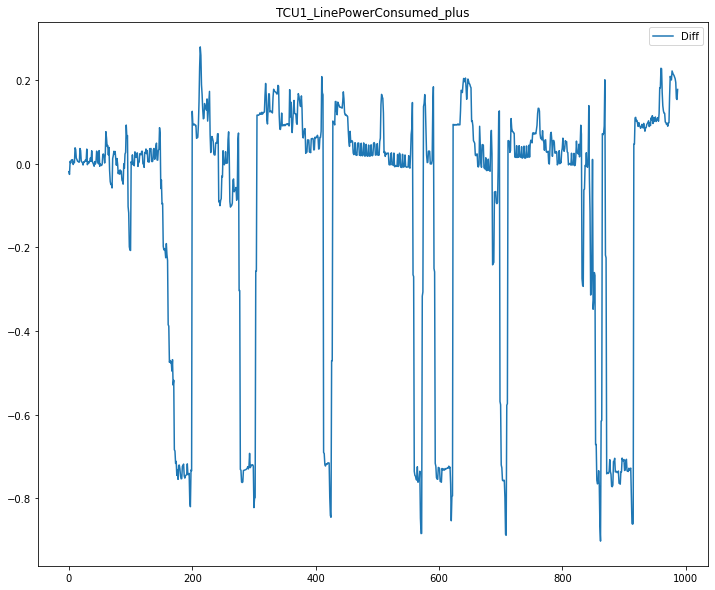

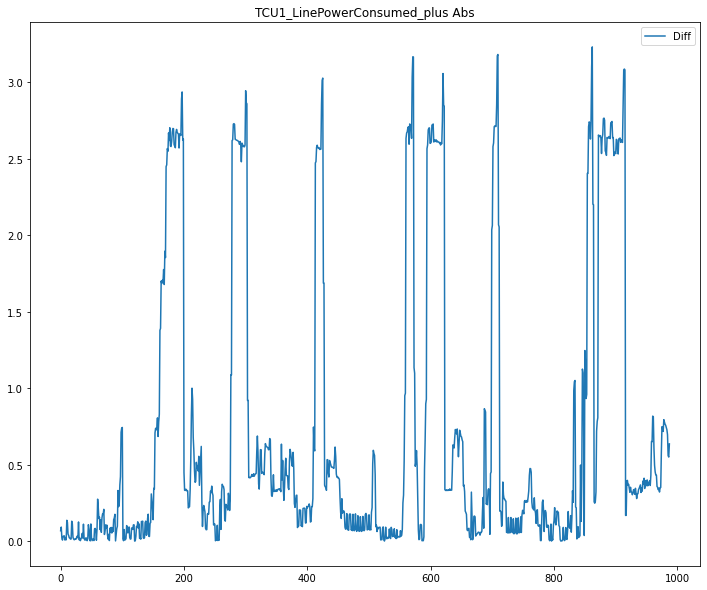

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11943914142.51%, std: 33695218644.38%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.7442766095040572
STD:  1.1626018618639218




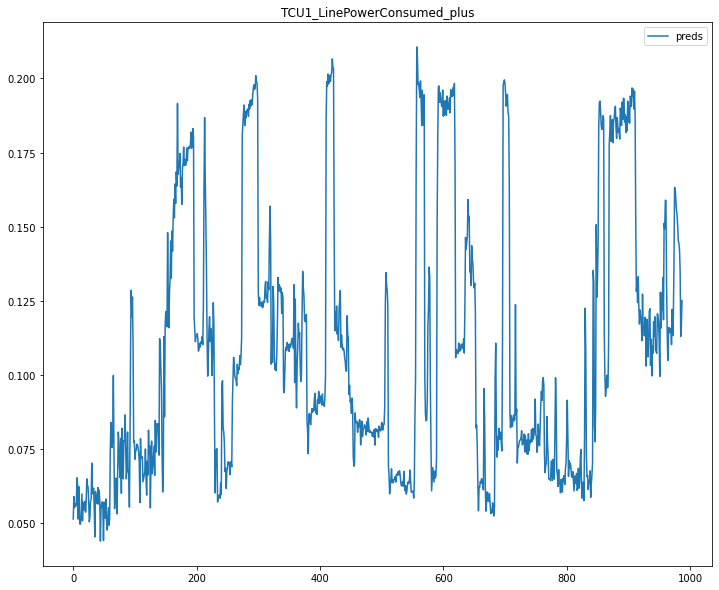

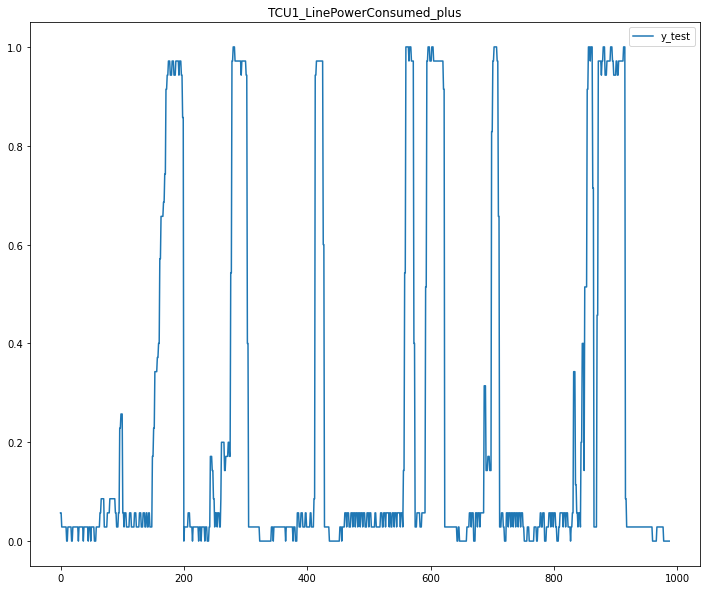

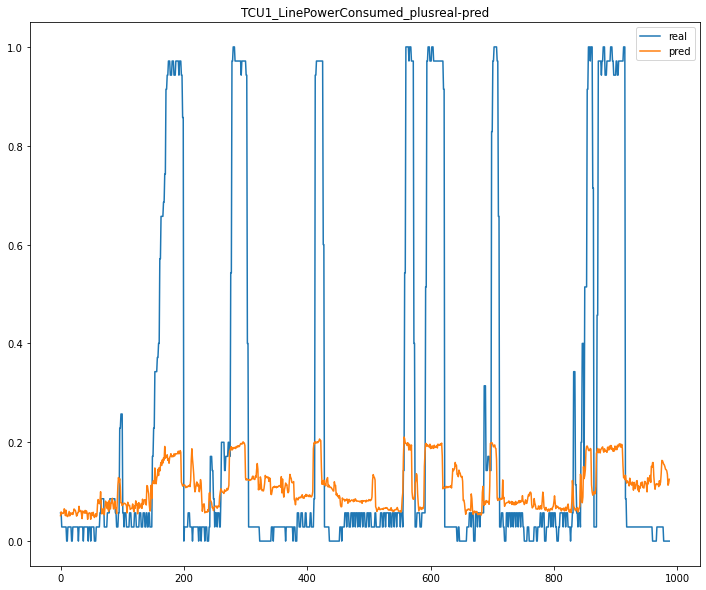

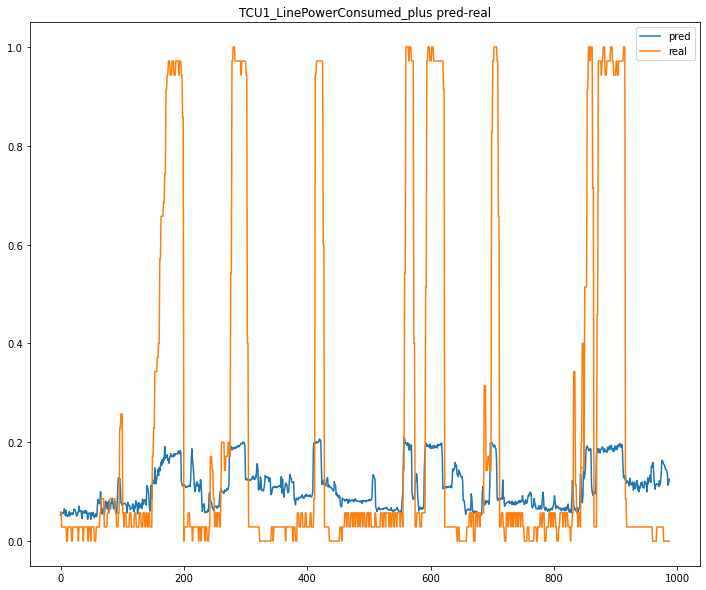

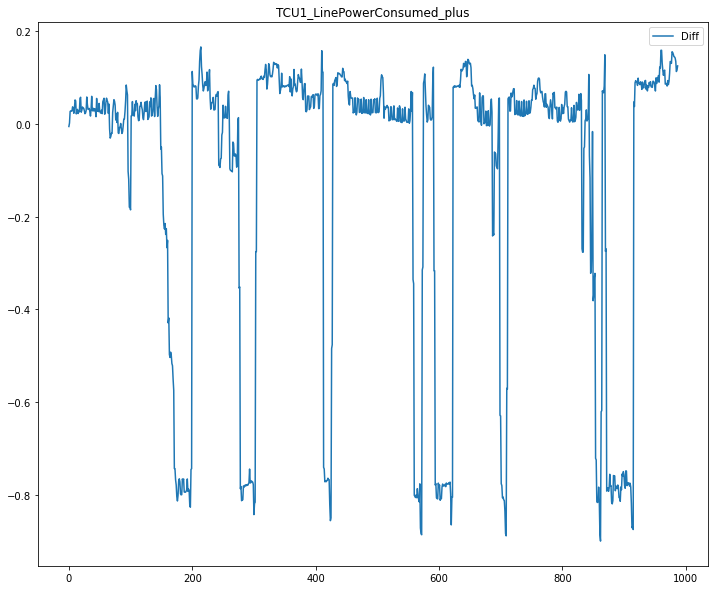

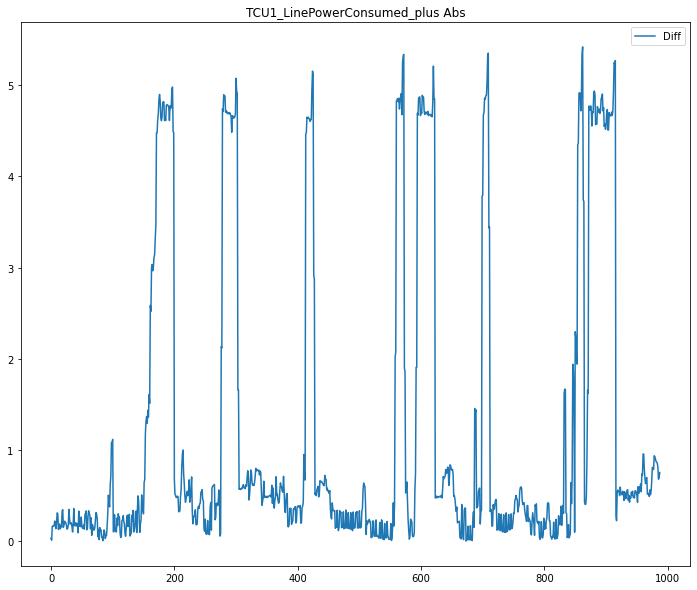

4 / 10
{'kernel': 'linear', 'C': 1, 'coef0': 0.5, 'gamma': 'scale', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 13057944221.30%, std: 38971243937.73%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2220113305943046
STD:  1.6514540351502245




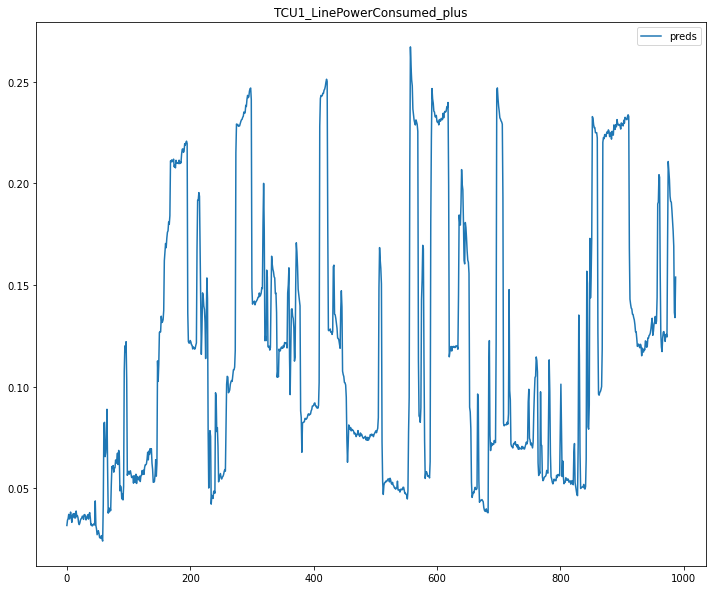

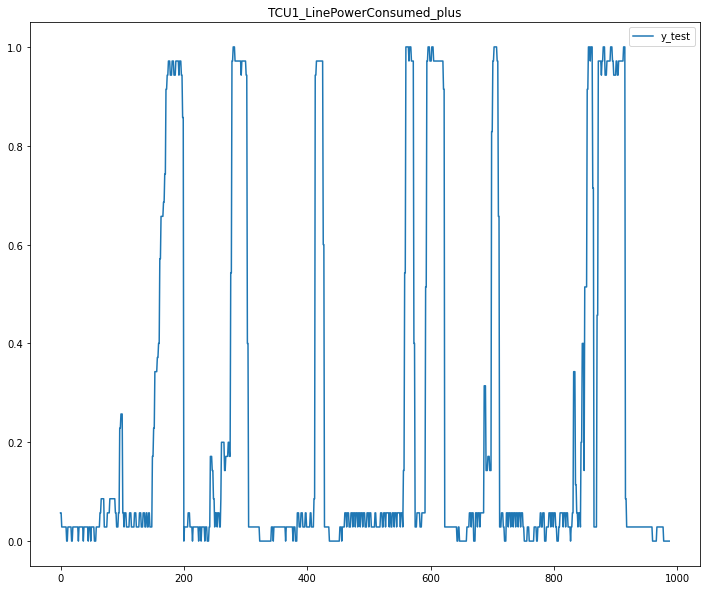

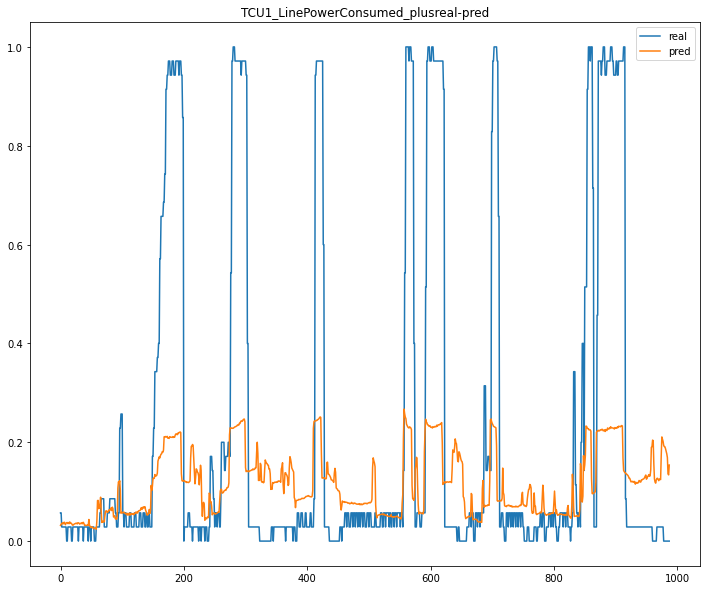

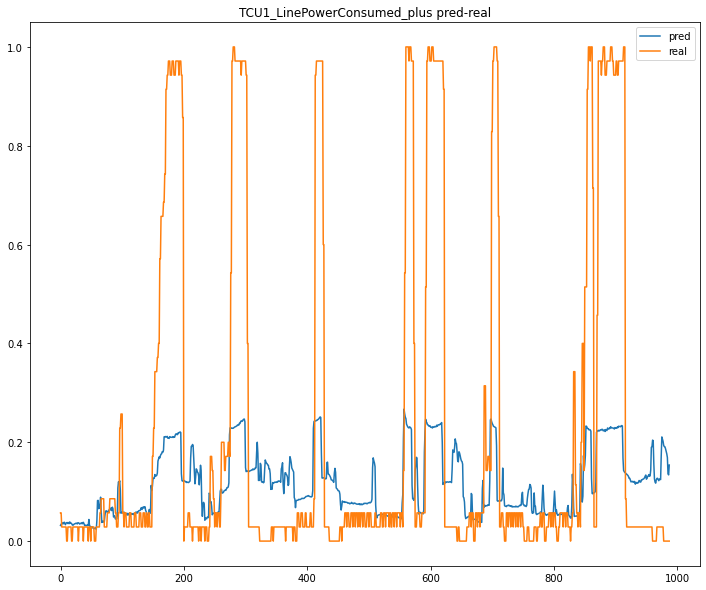

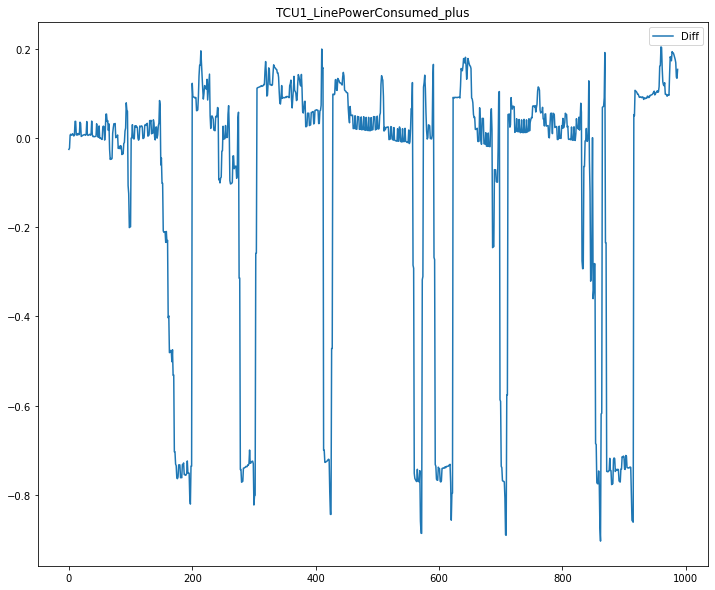

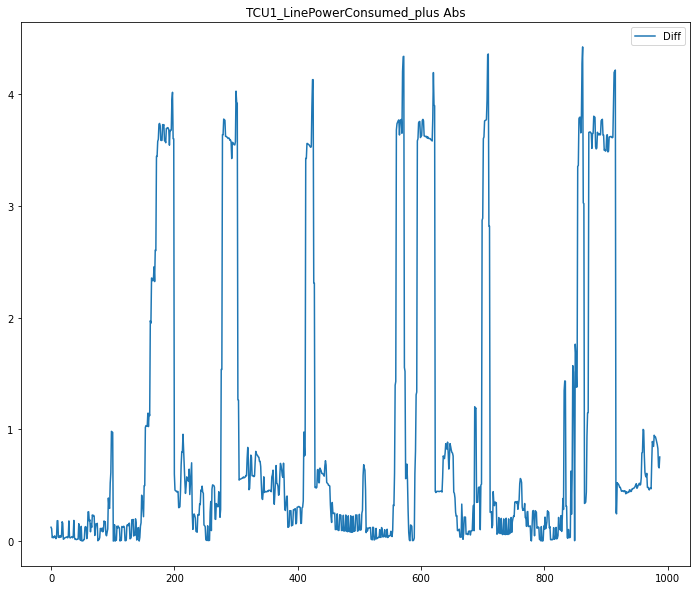

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12759708764.41%, std: 38861790079.06%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2414470517043577
STD:  1.56267699122586




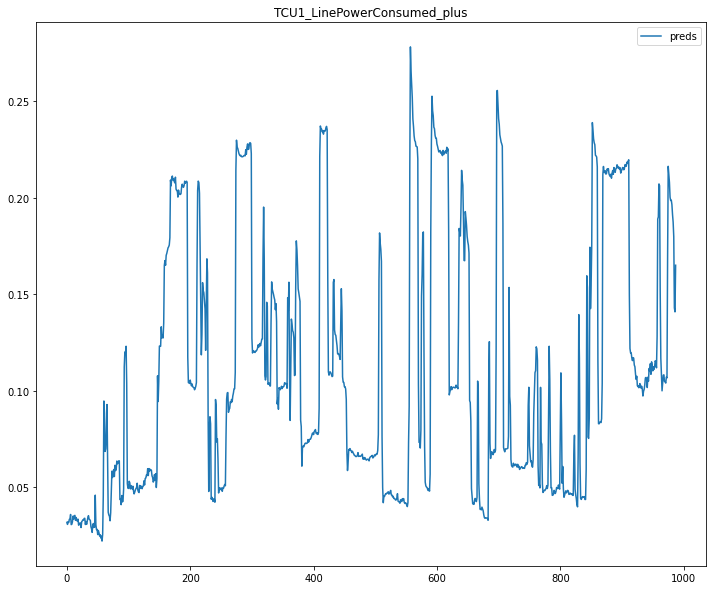

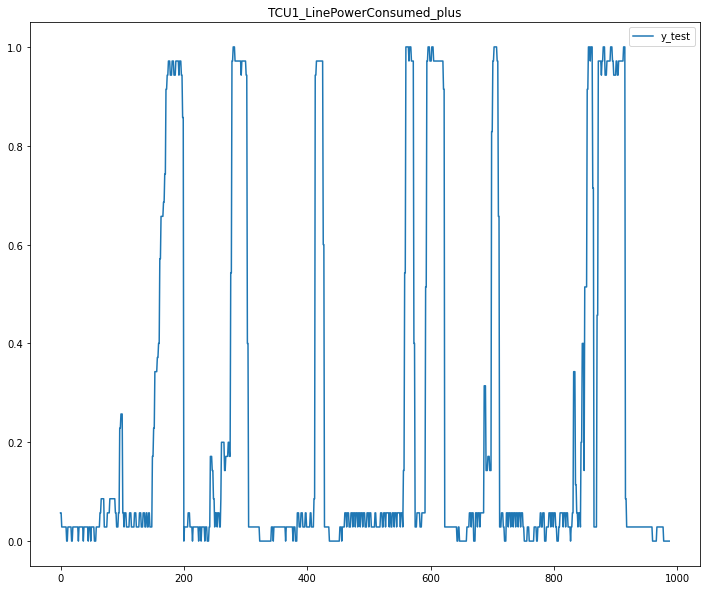

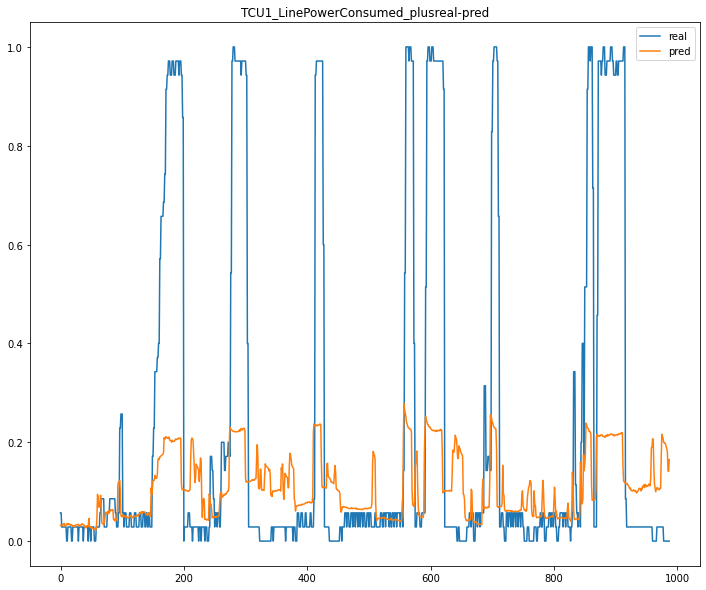

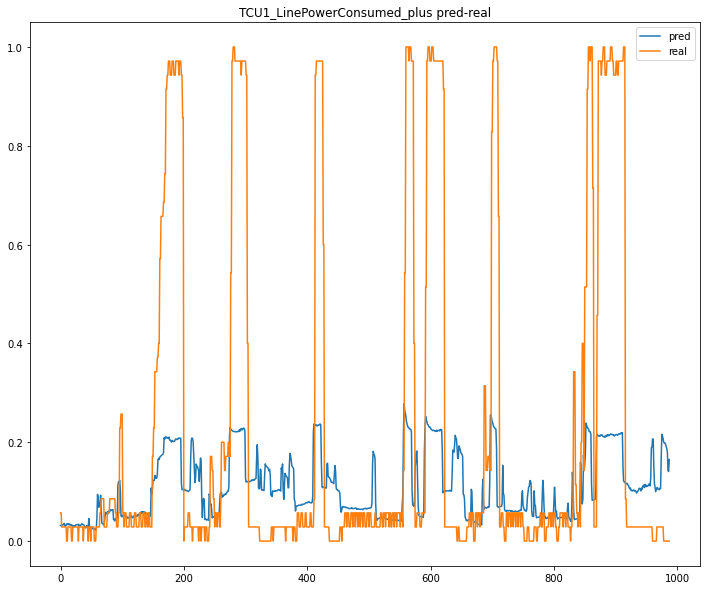

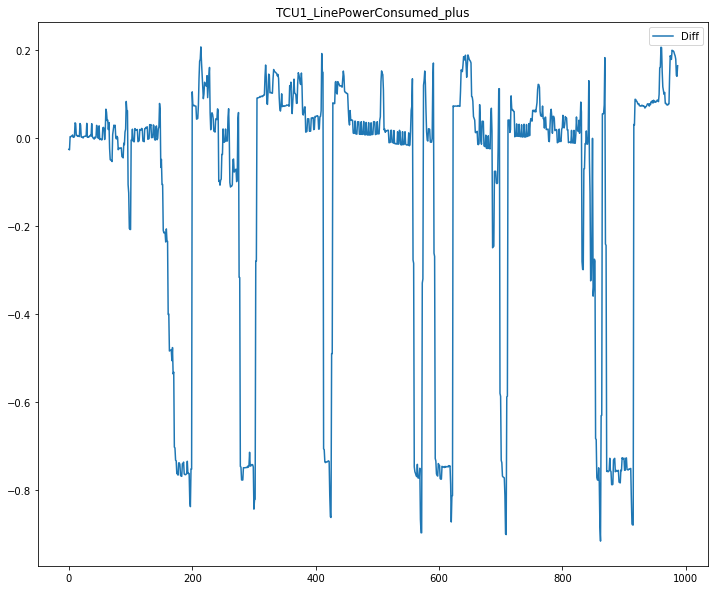

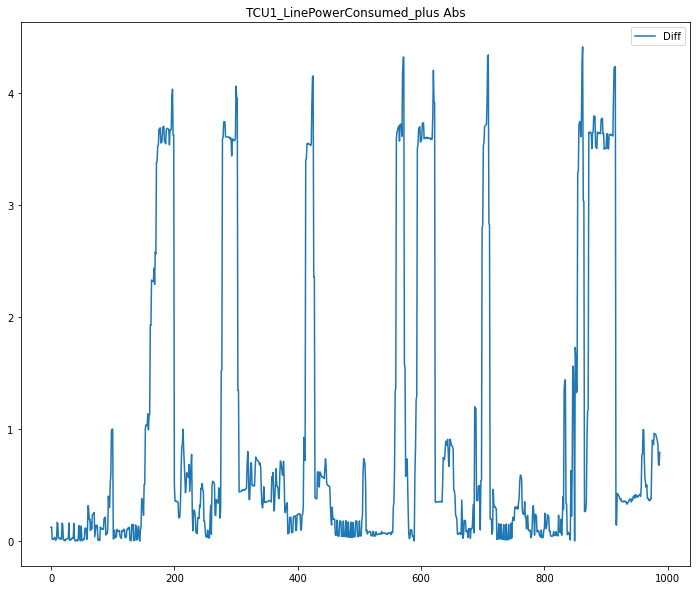

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11072636990.34%, std: 30936505744.07%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.6752717867357182
STD:  1.0862393733511577




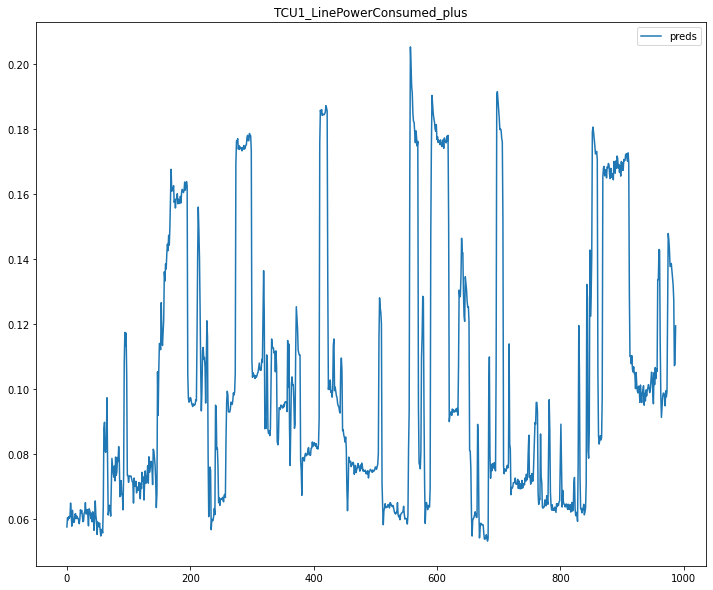

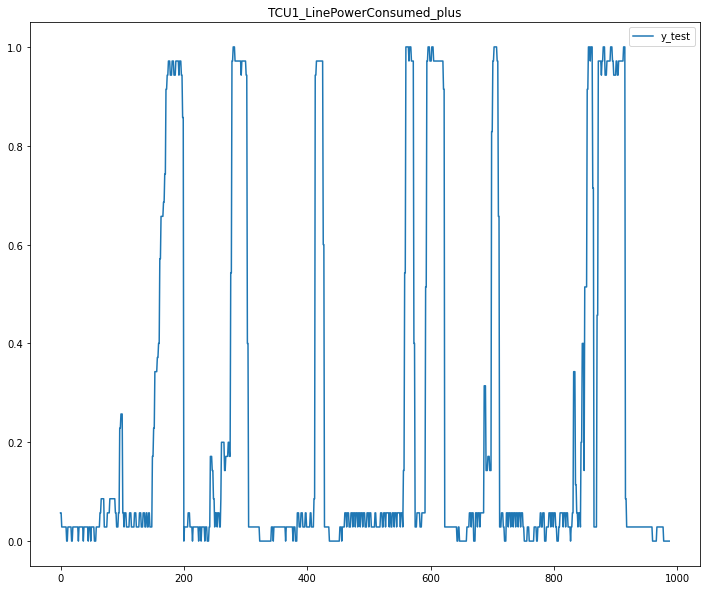

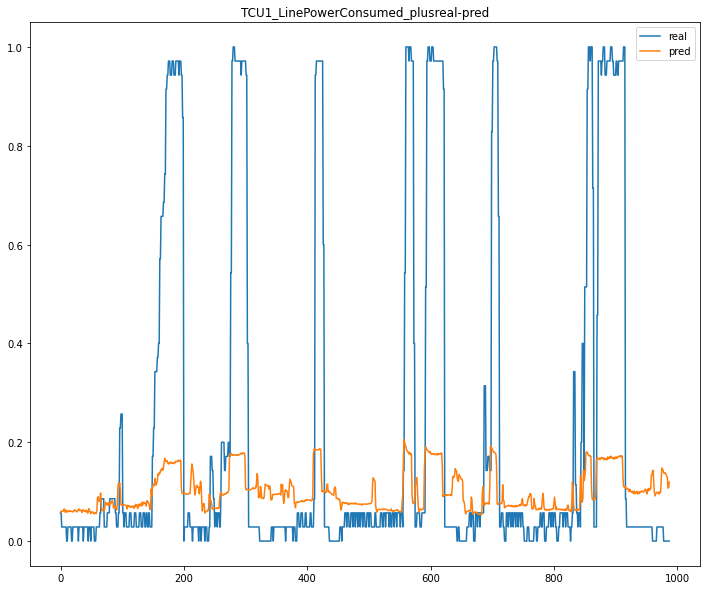

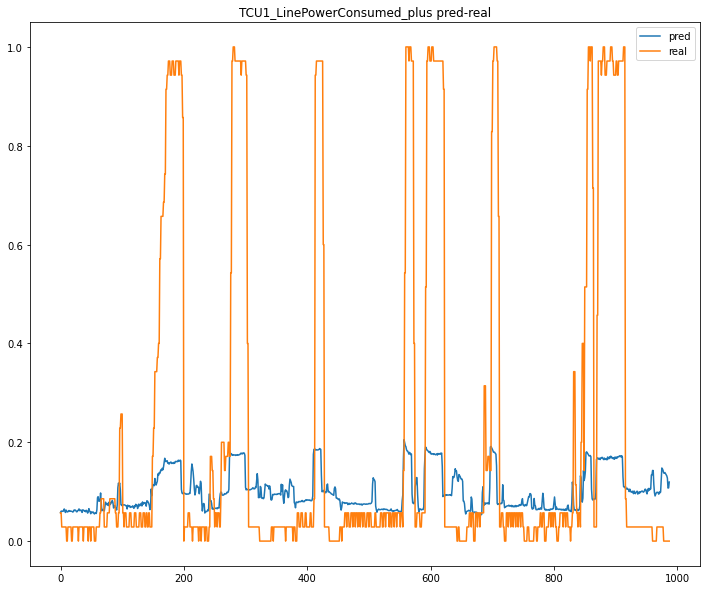

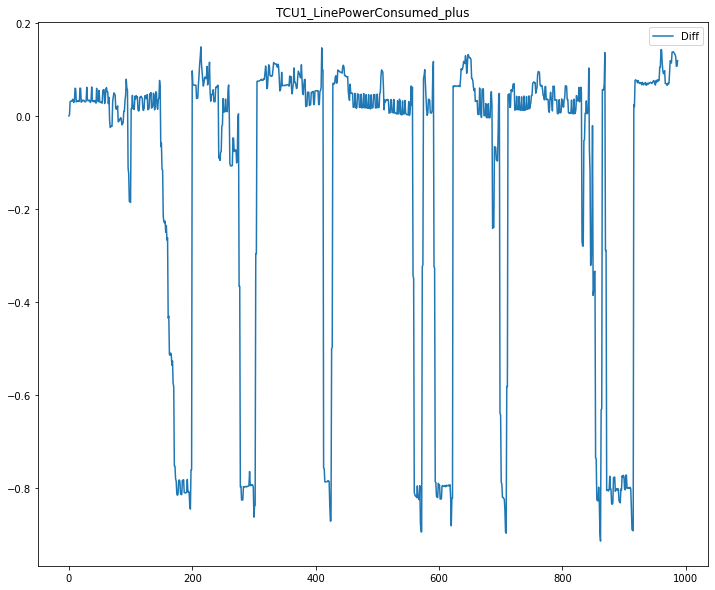

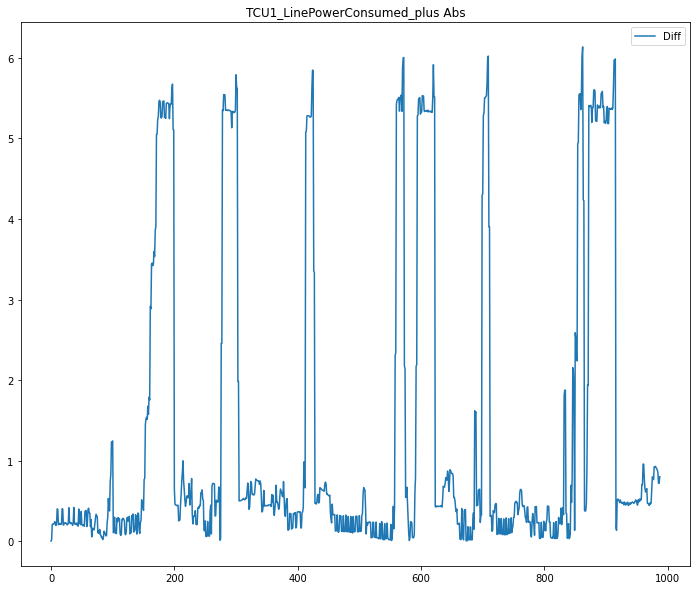

5 / 10
{'kernel': 'linear', 'C': 5, 'coef0': 10, 'gamma': 'scale', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14459783314.77%, std: 43144173423.44%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.35740249452793
STD:  1.811165855369843




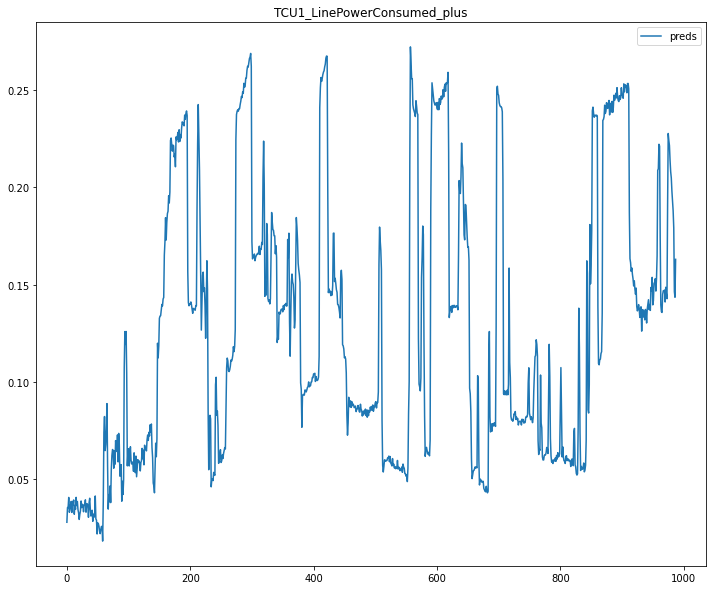

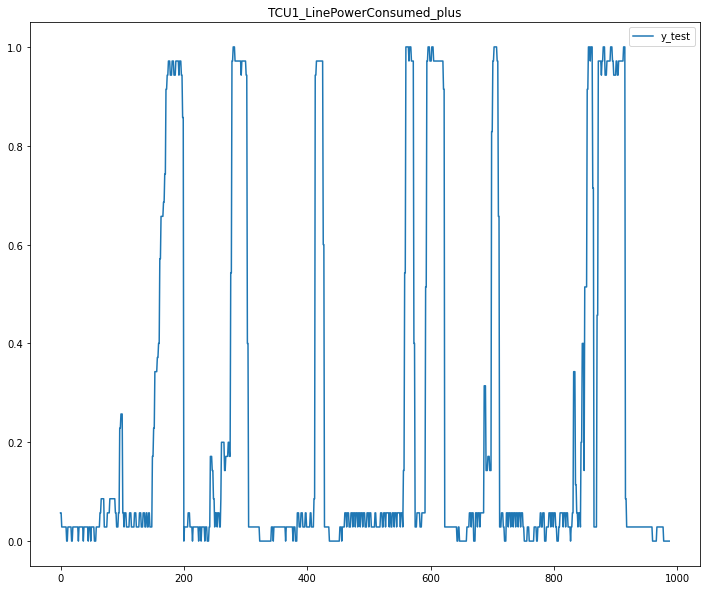

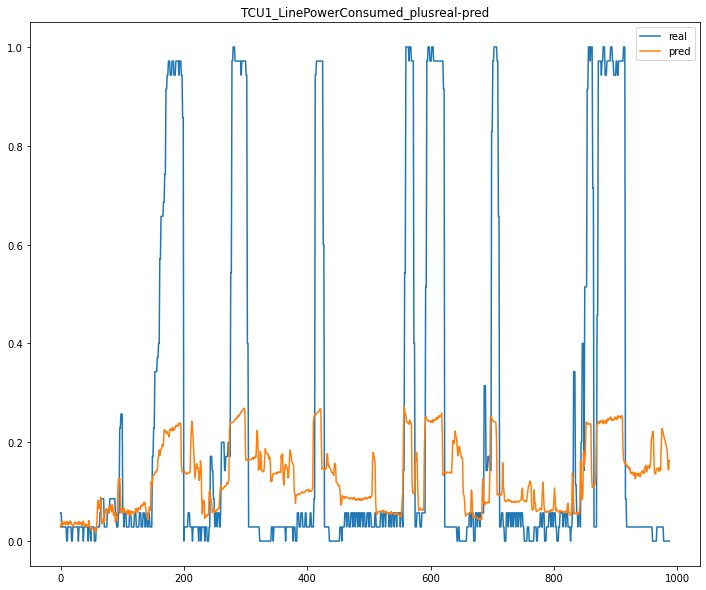

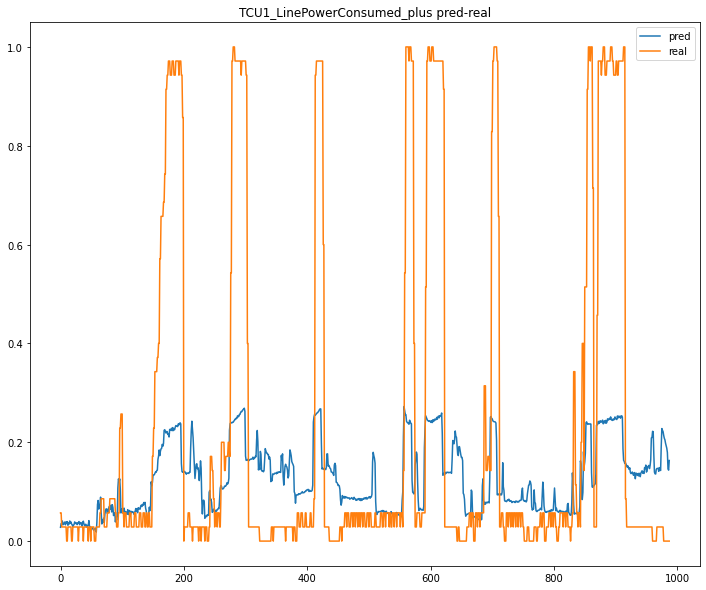

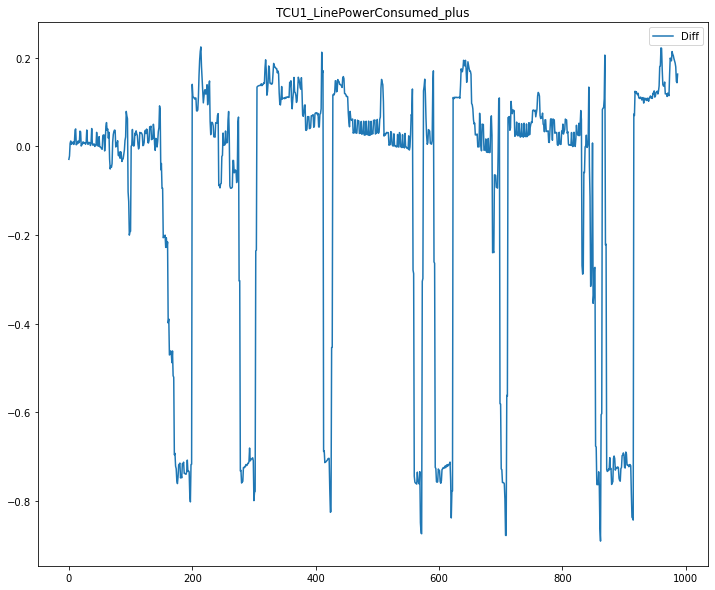

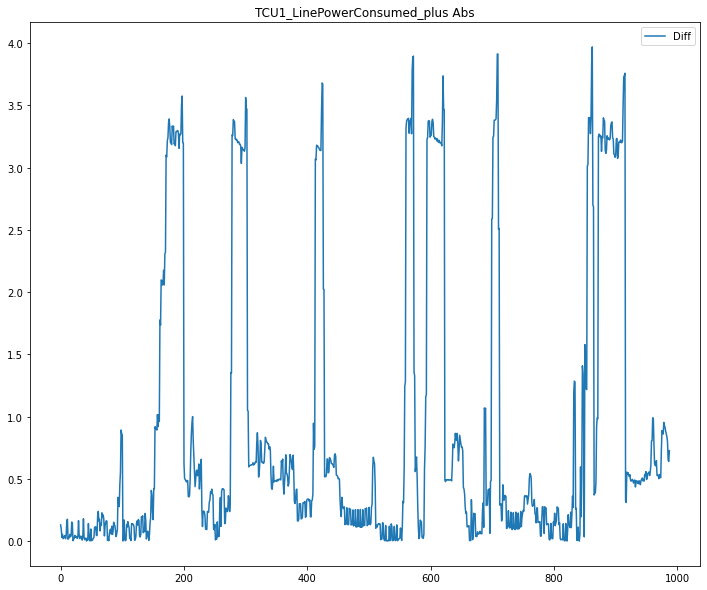

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14409321653.58%, std: 43682198309.48%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.255533126545516
STD:  1.5822212958771442




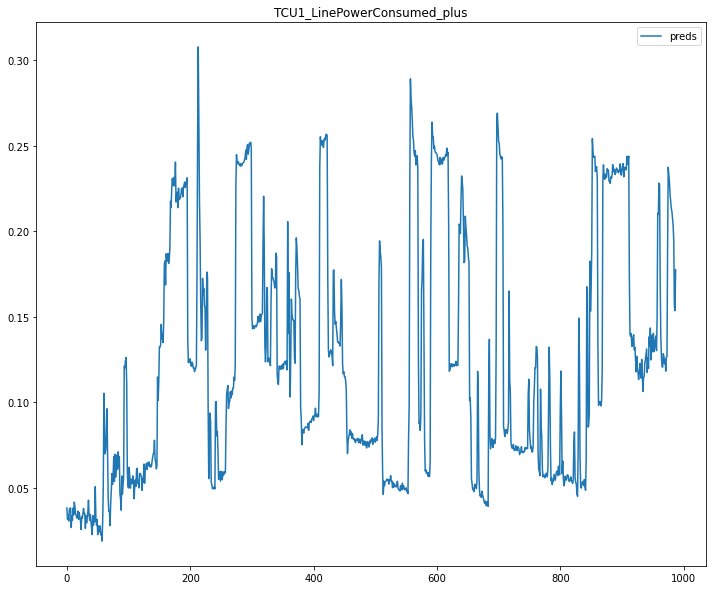

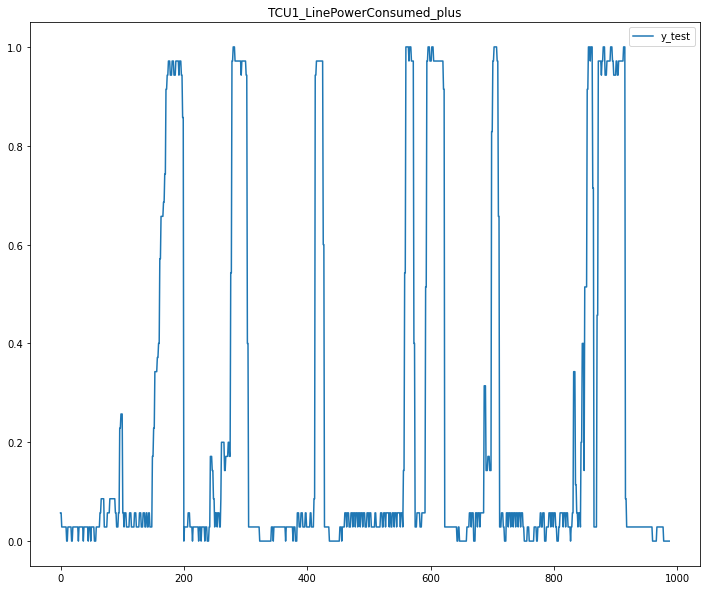

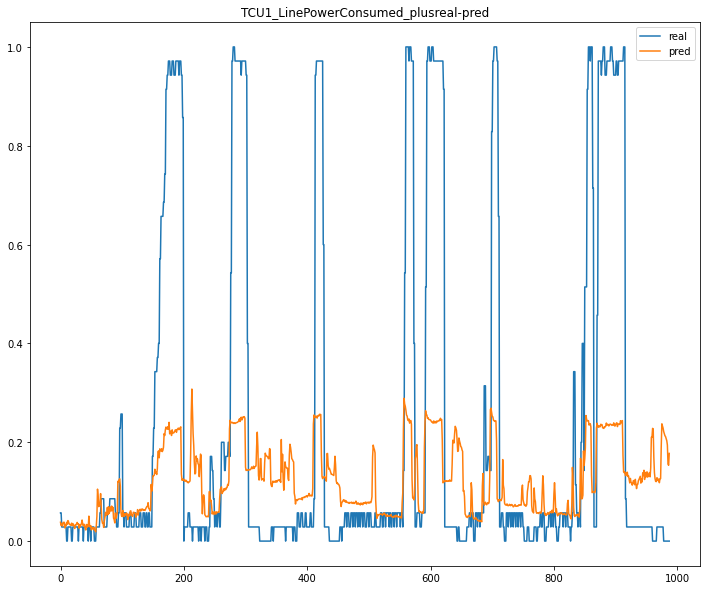

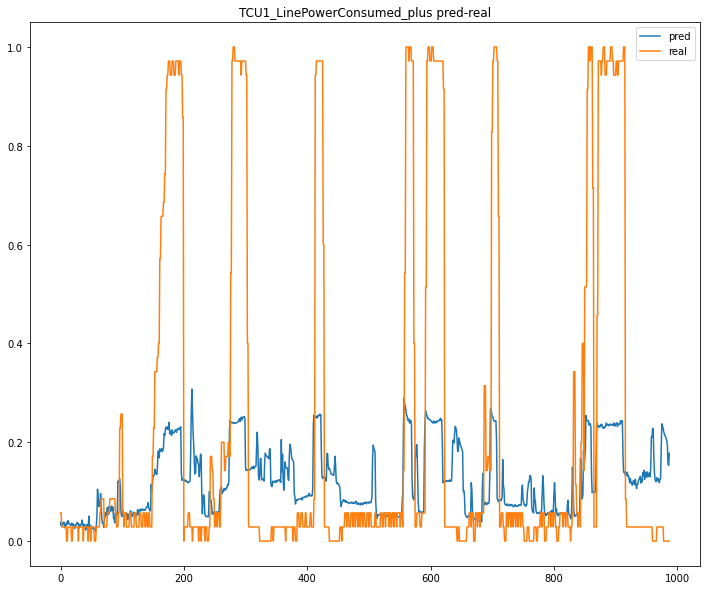

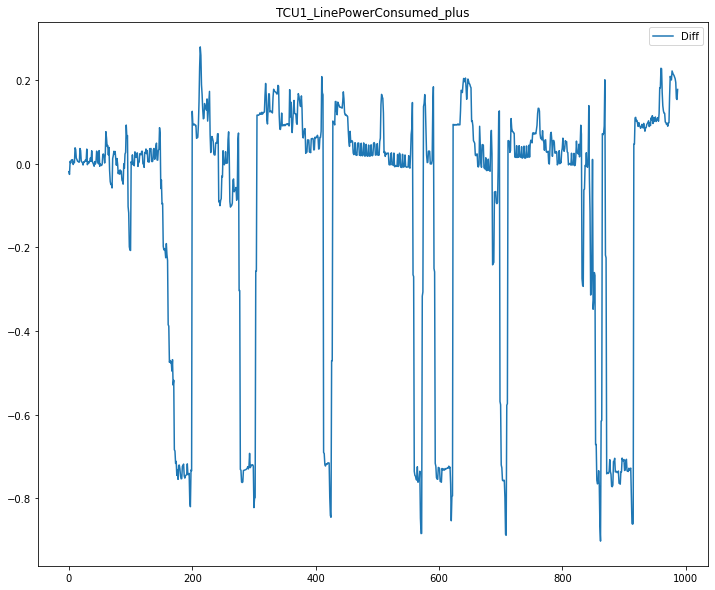

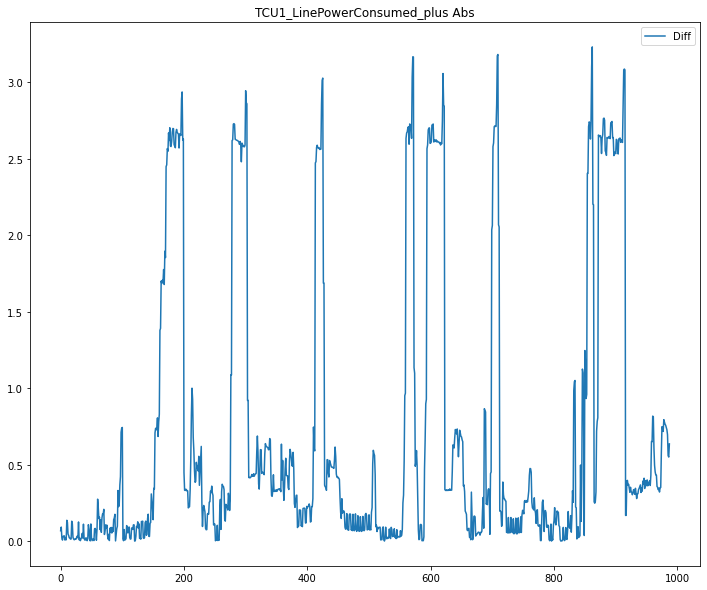

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11943914142.51%, std: 33695218644.38%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.7442766095040572
STD:  1.1626018618639218




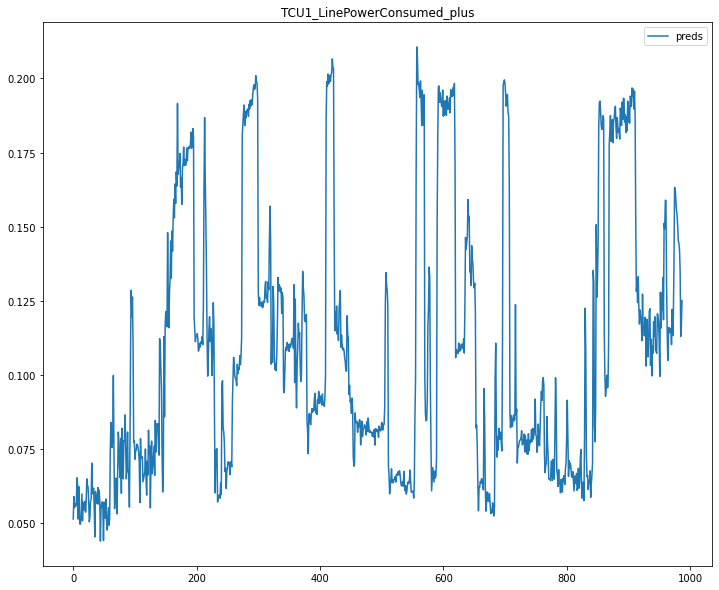

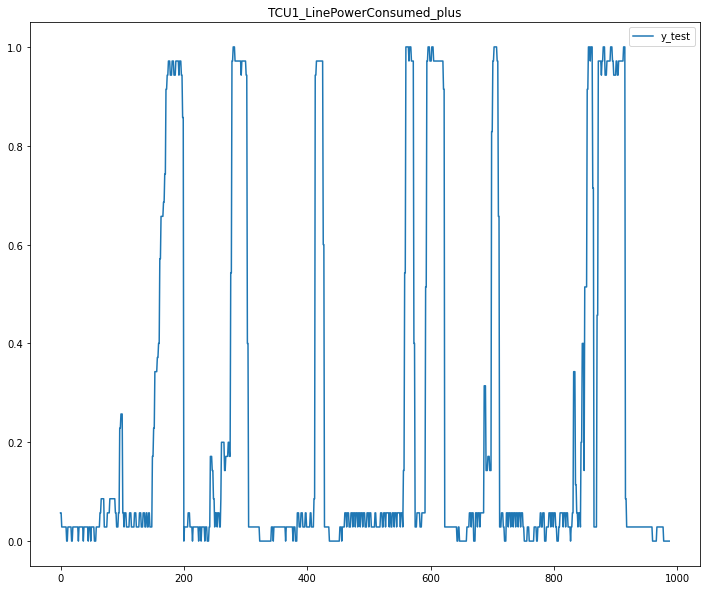

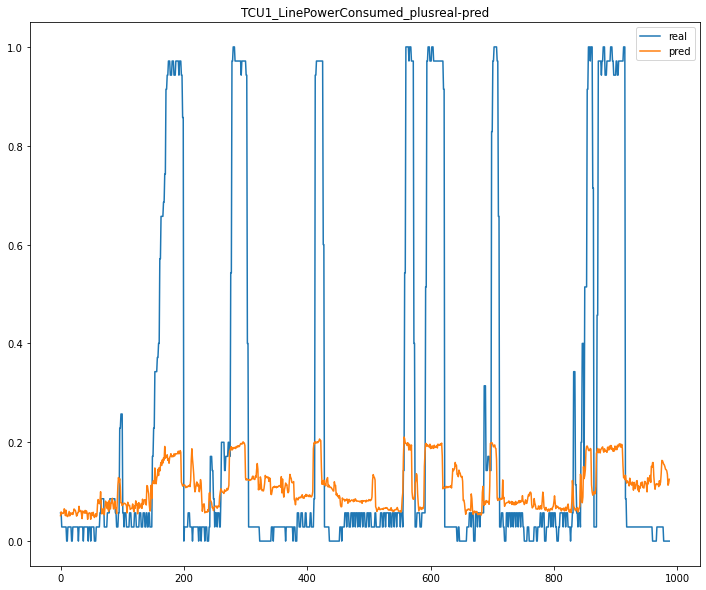

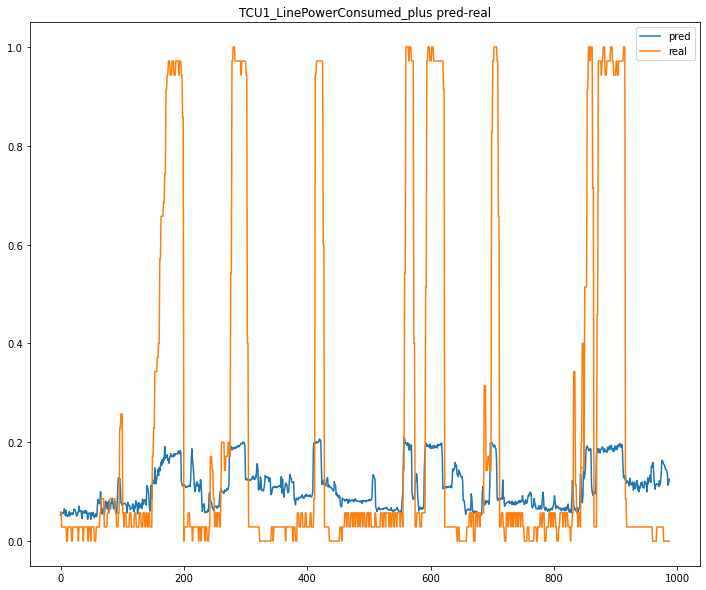

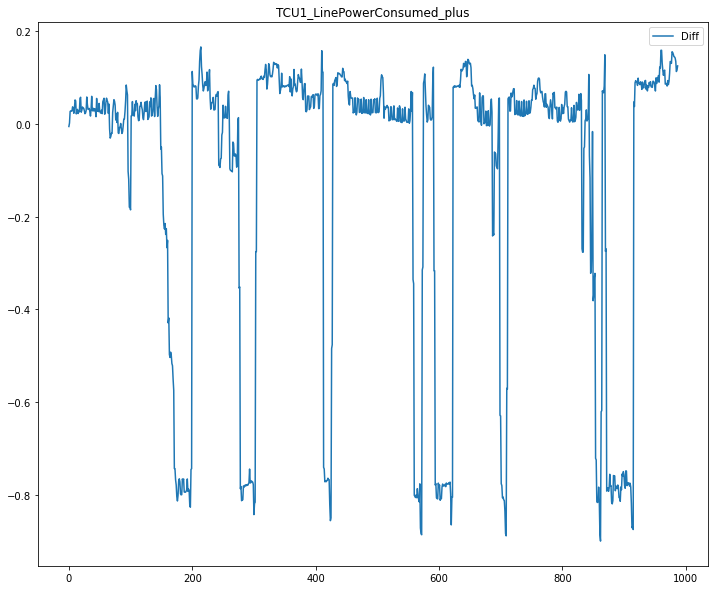

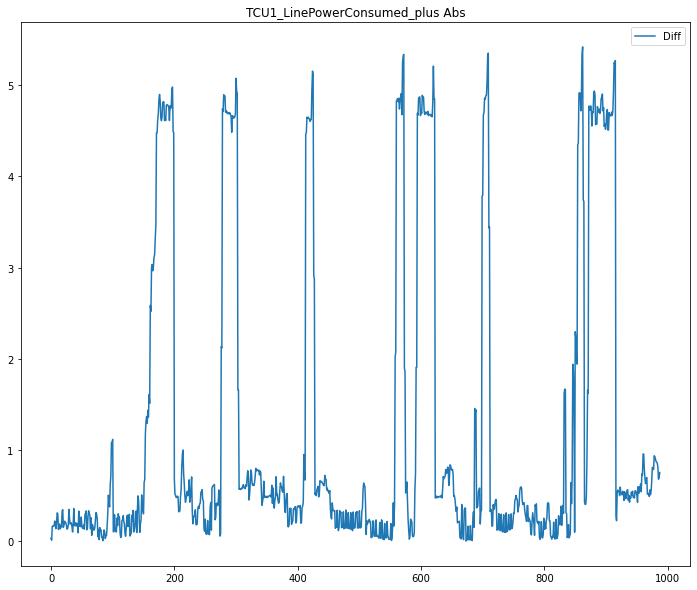

6 / 10
{'kernel': 'linear', 'C': 5, 'coef0': 0.01, 'gamma': 'scale', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14459783314.77%, std: 43144173423.44%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.35740249452793
STD:  1.811165855369843




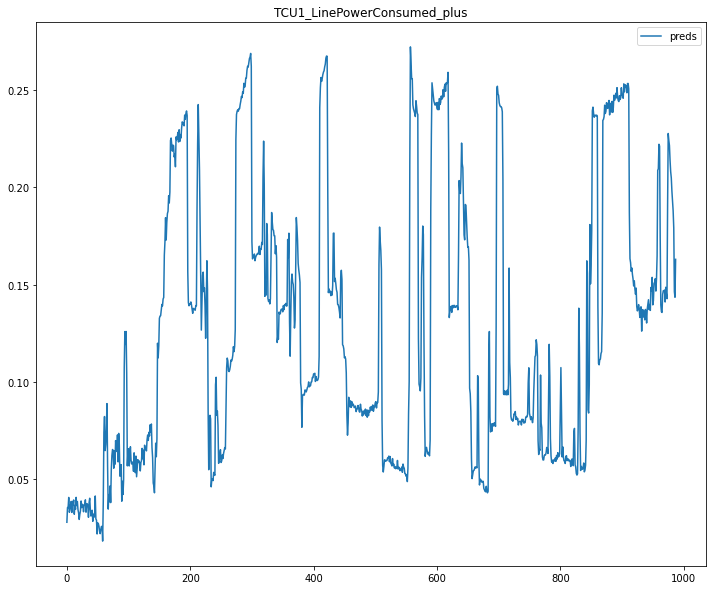

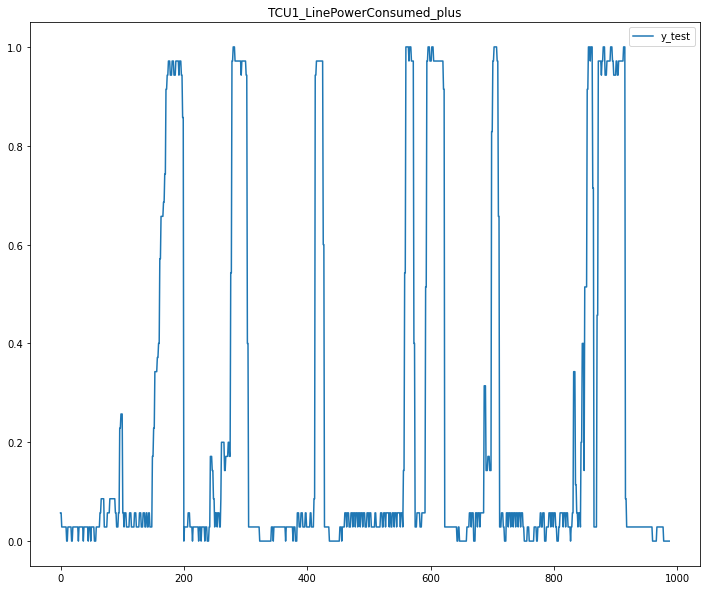

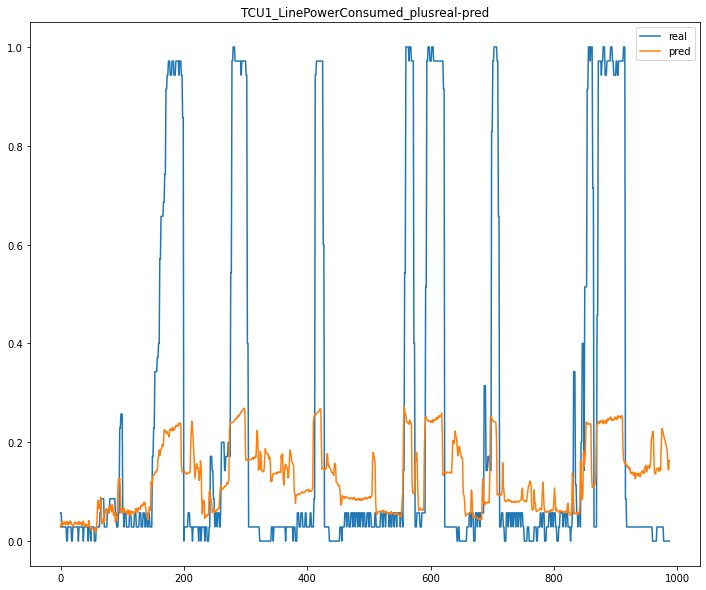

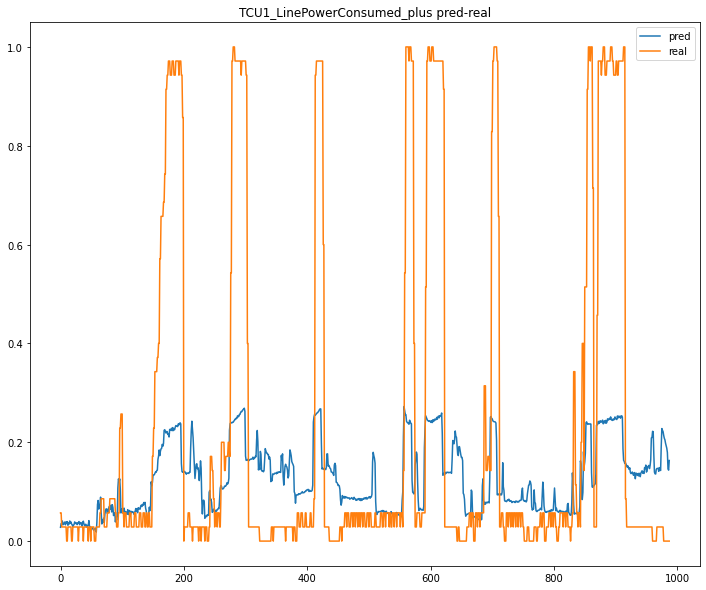

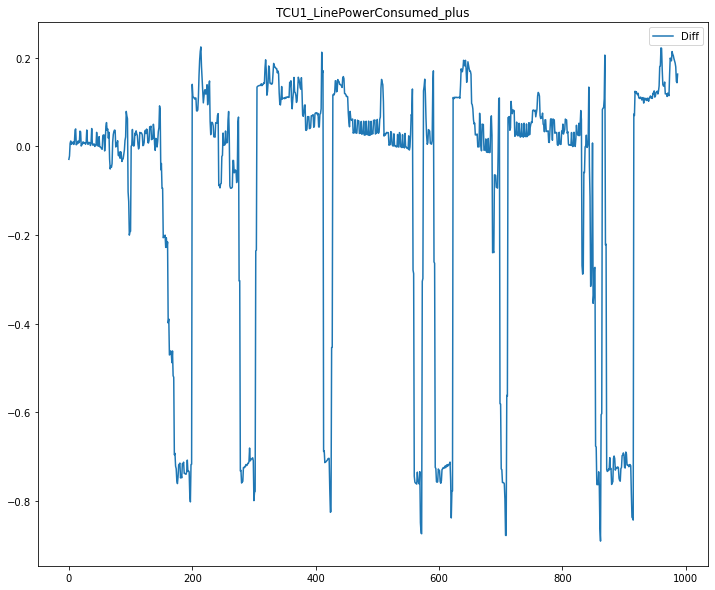

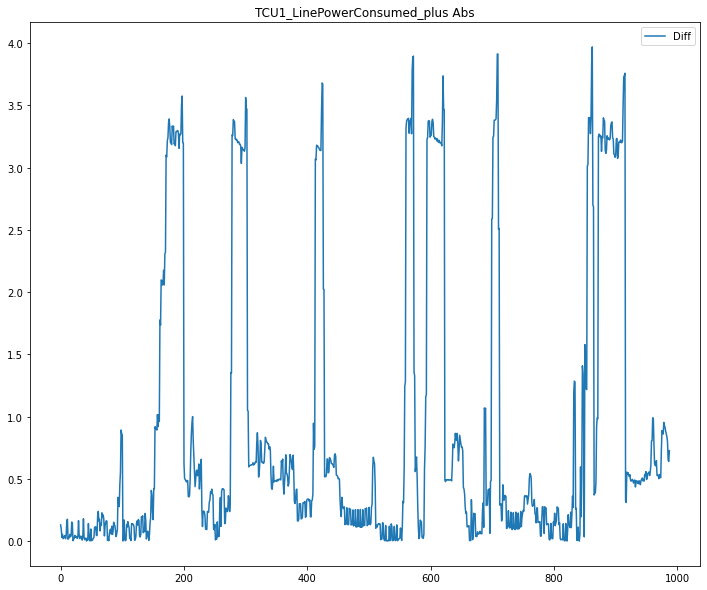

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14409321653.58%, std: 43682198309.48%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.255533126545516
STD:  1.5822212958771442




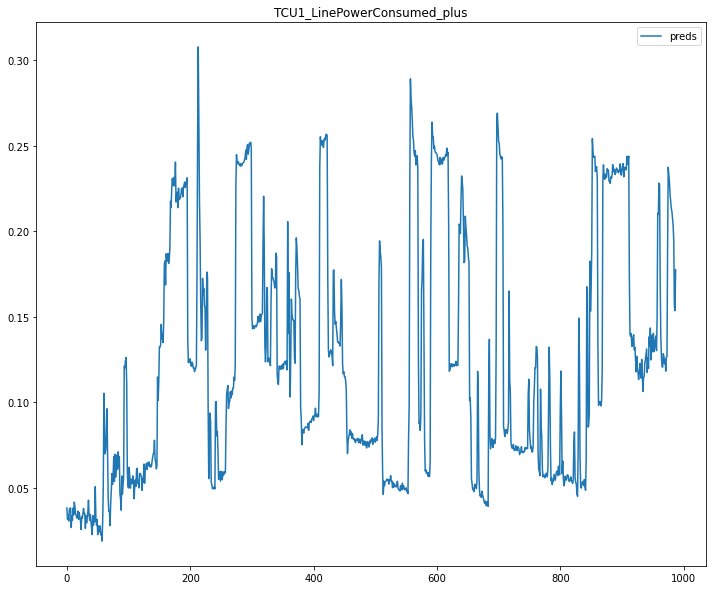

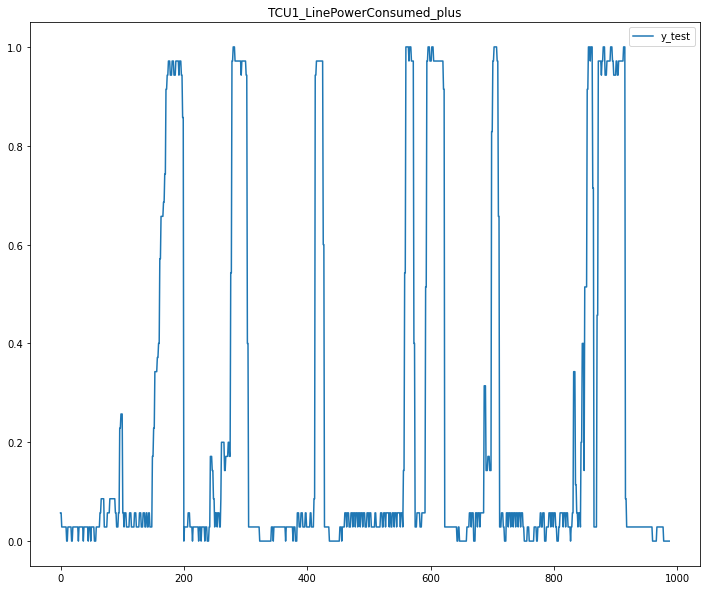

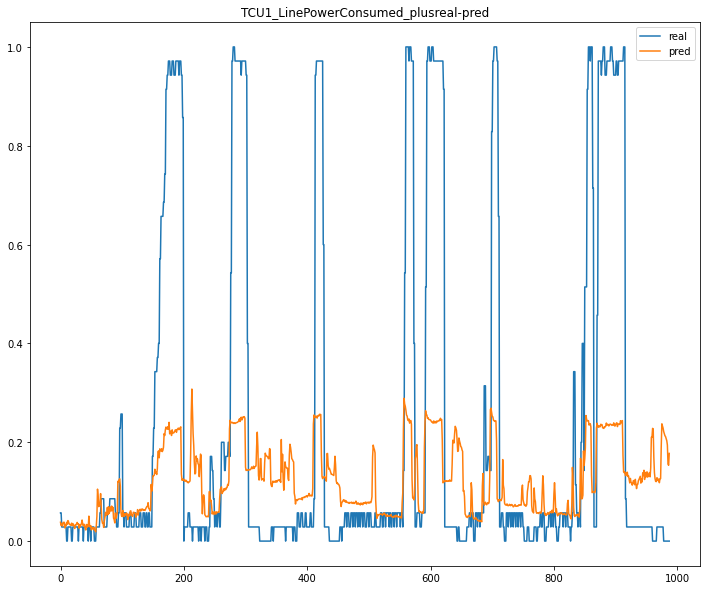

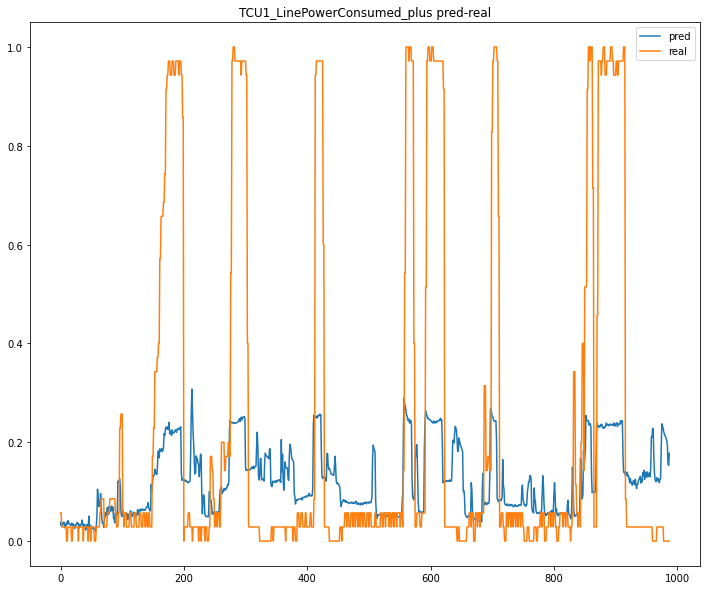

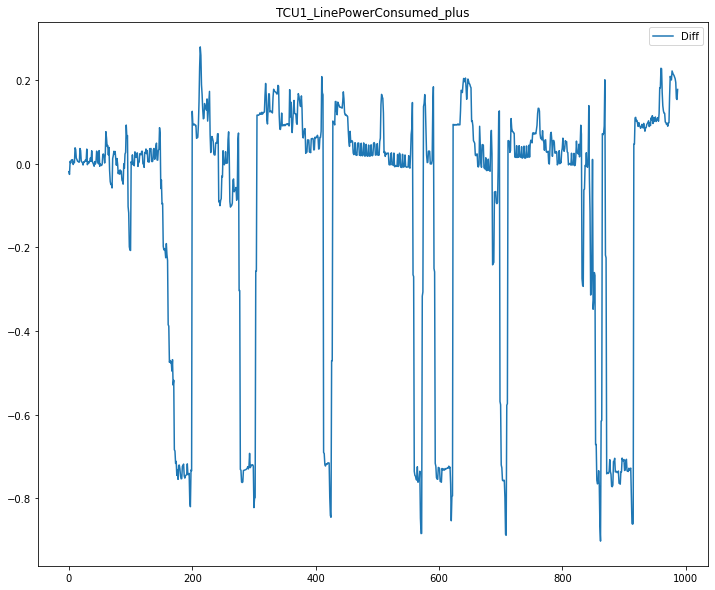

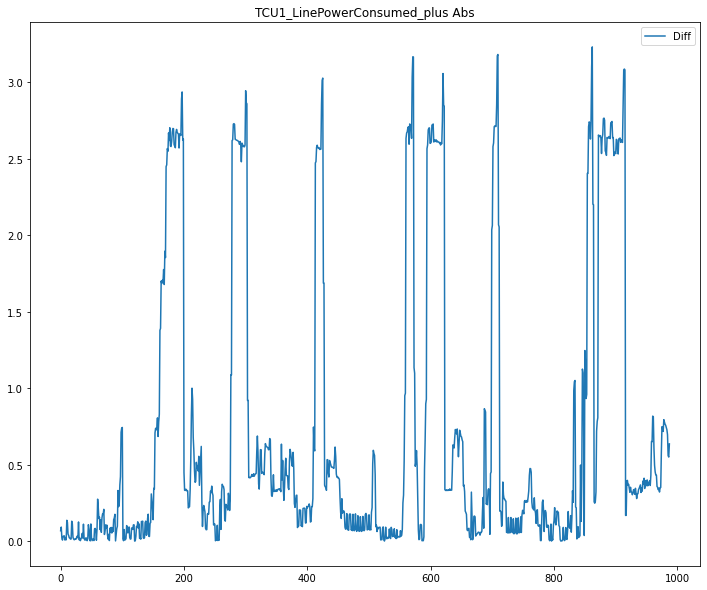

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11943914142.51%, std: 33695218644.38%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.7442766095040572
STD:  1.1626018618639218




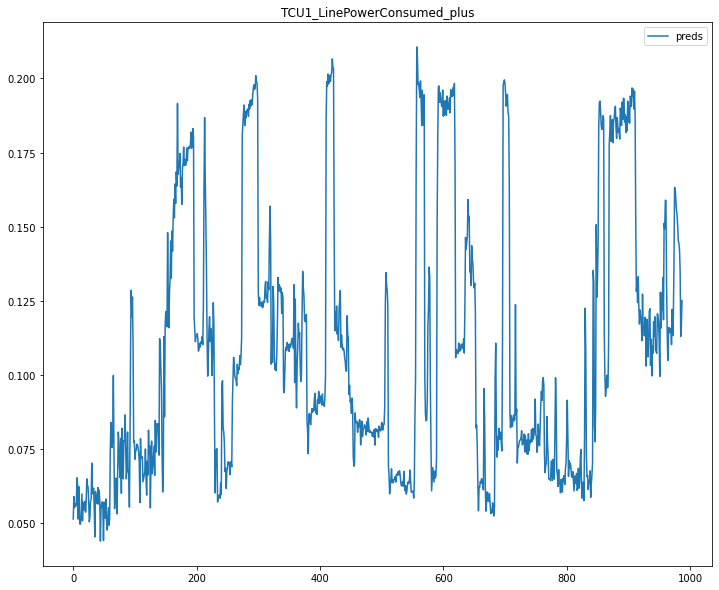

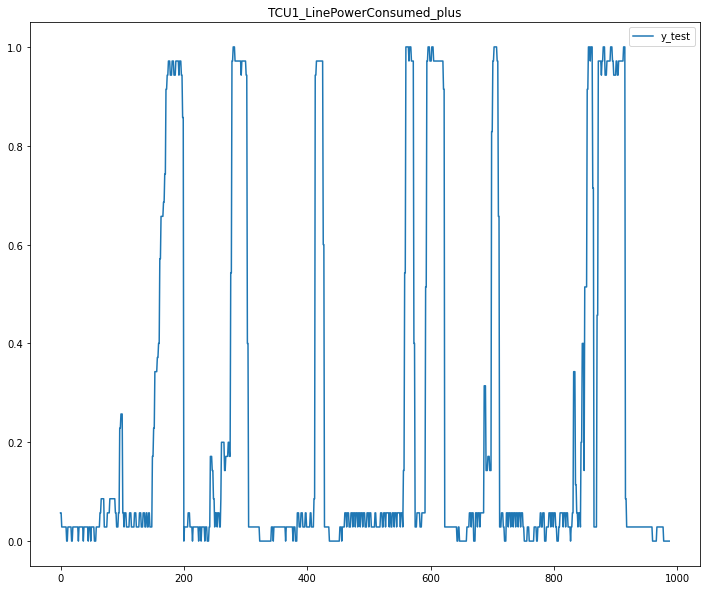

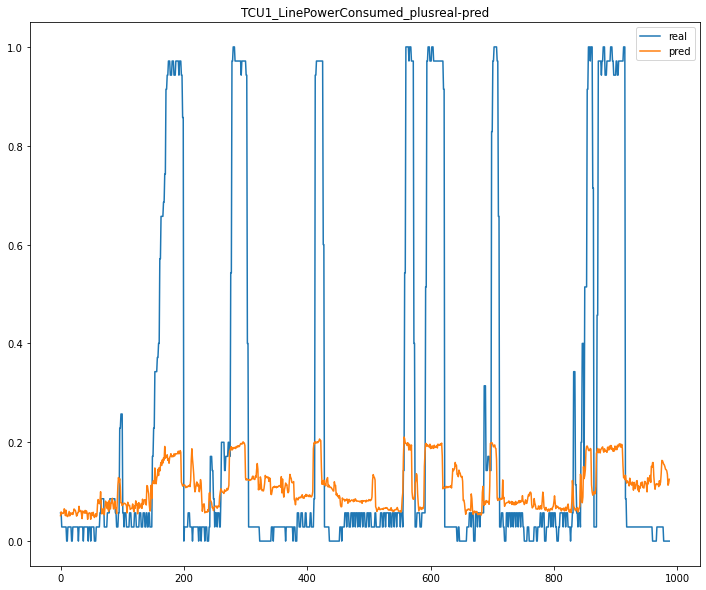

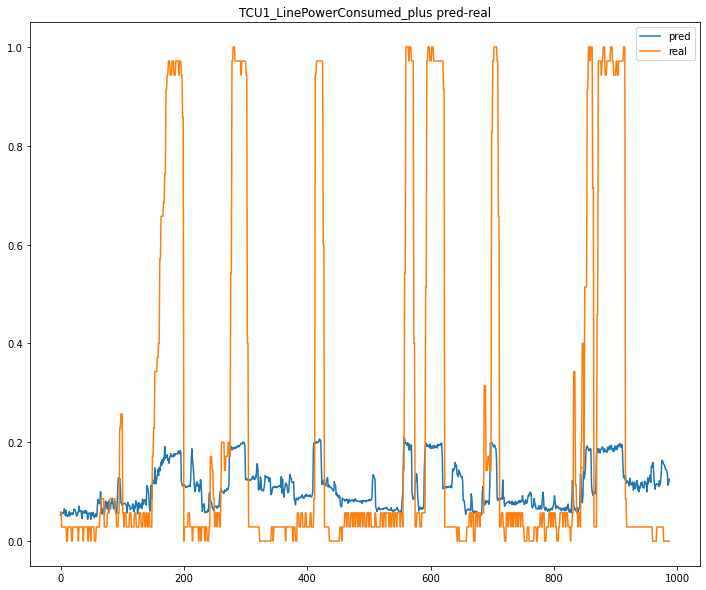

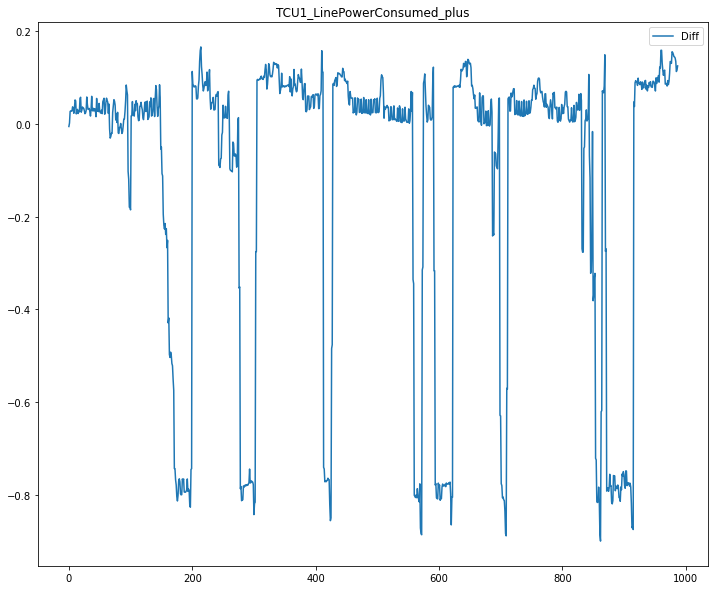

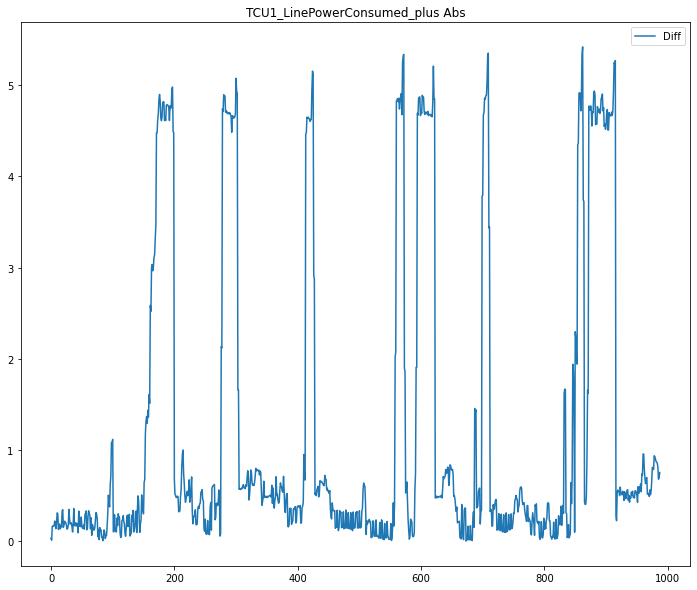

7 / 10
{'kernel': 'linear', 'C': 1, 'coef0': 0.01, 'gamma': 'auto', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 13057944221.30%, std: 38971243937.73%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2220113305943046
STD:  1.6514540351502245




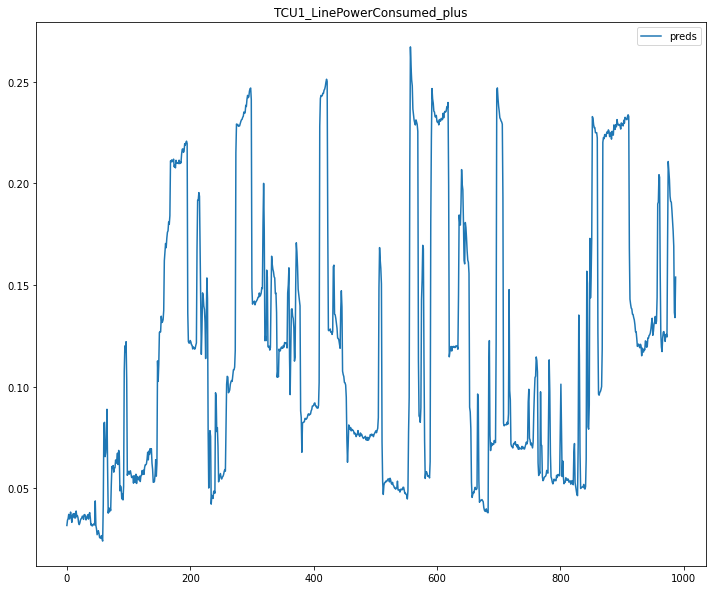

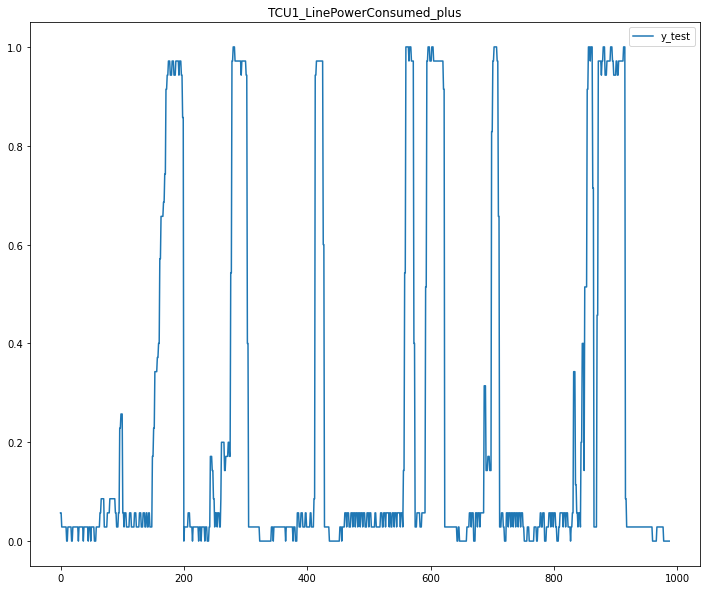

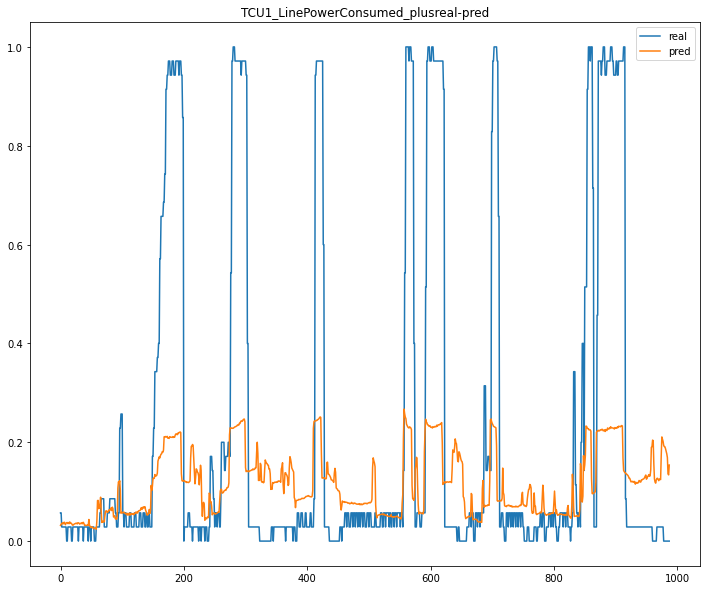

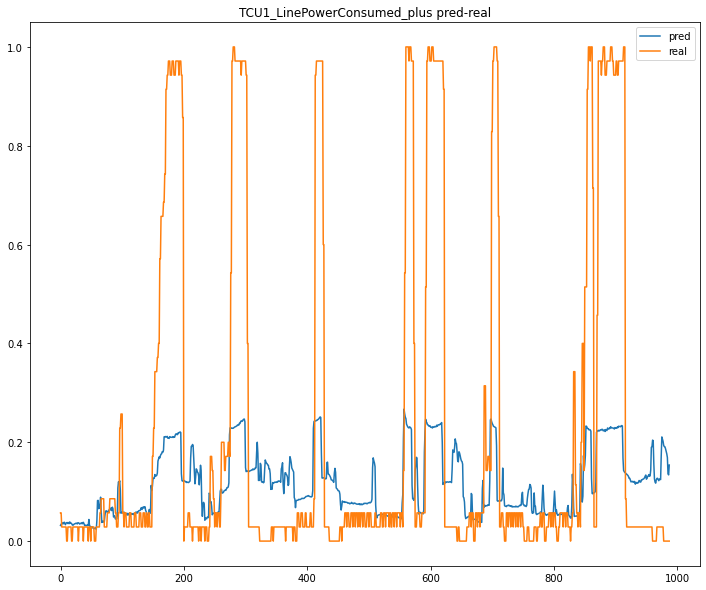

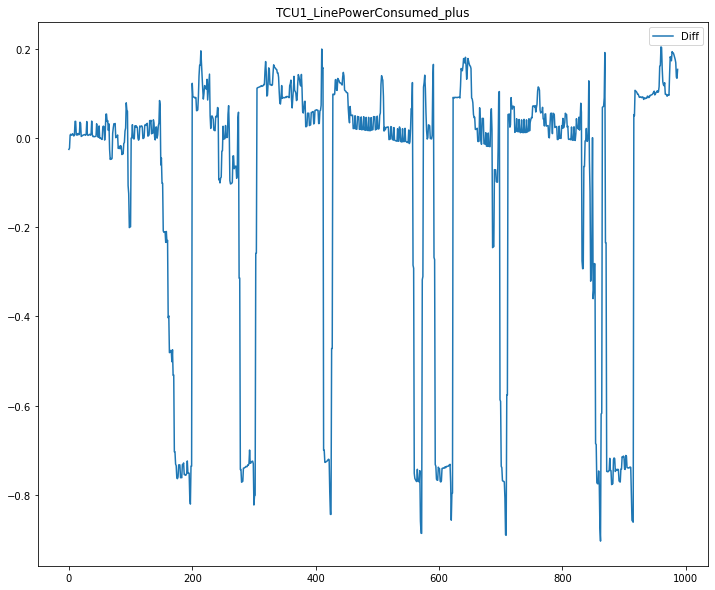

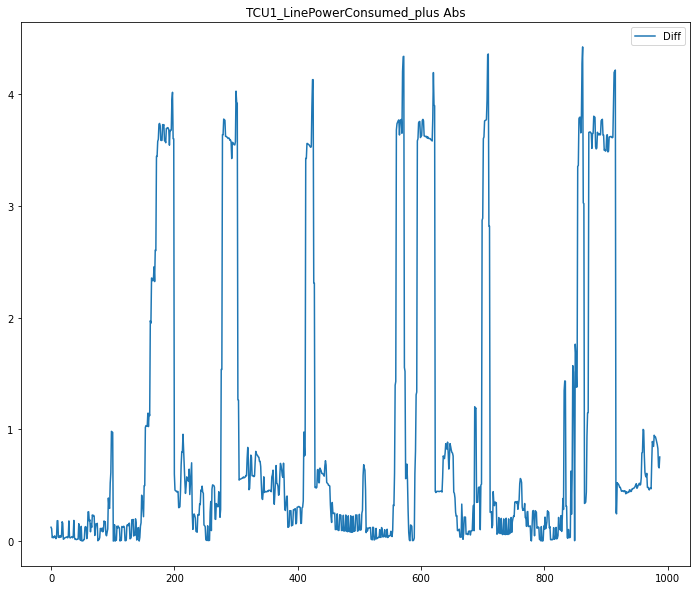

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12759708764.41%, std: 38861790079.06%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2414470517043577
STD:  1.56267699122586




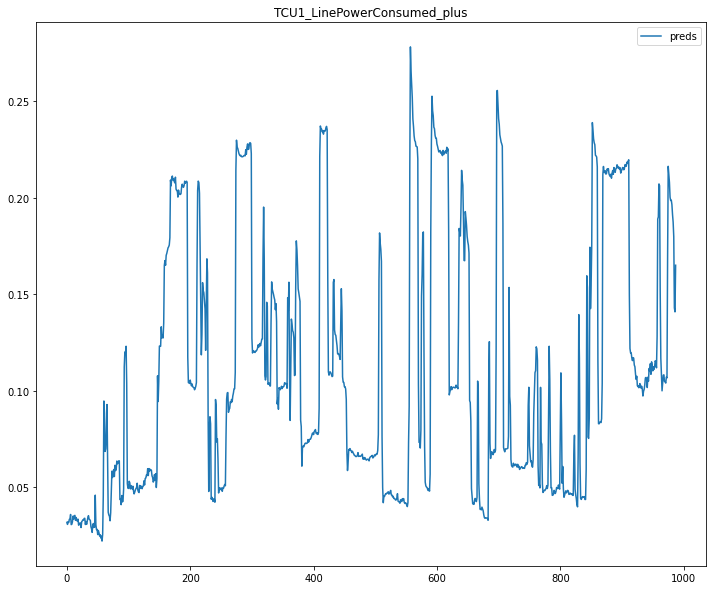

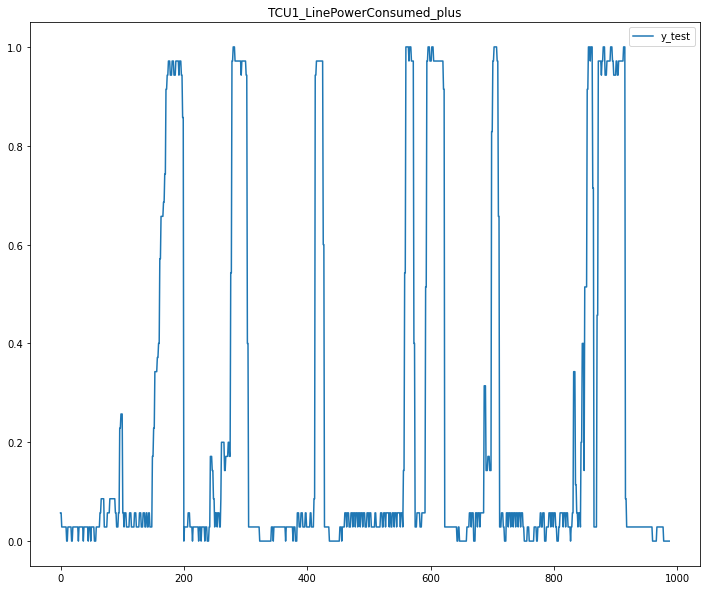

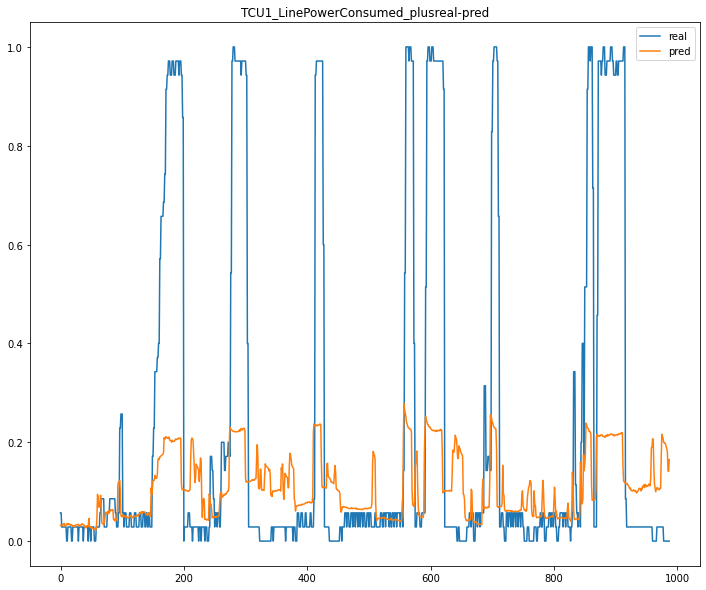

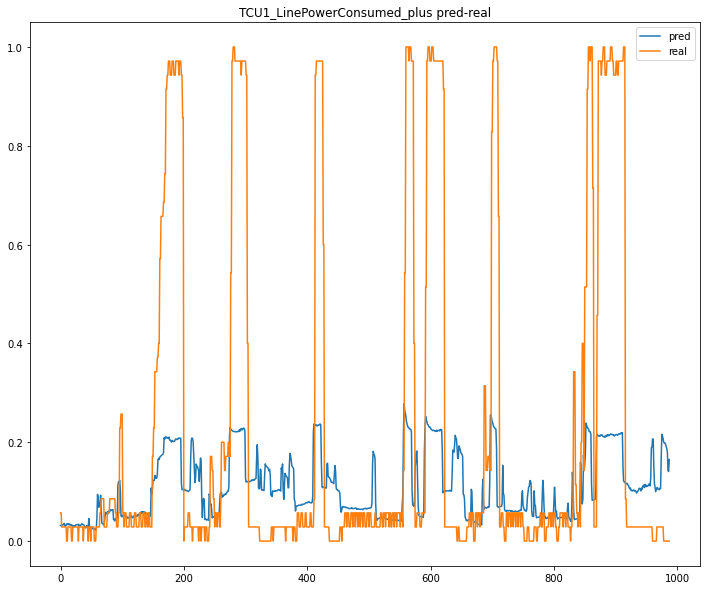

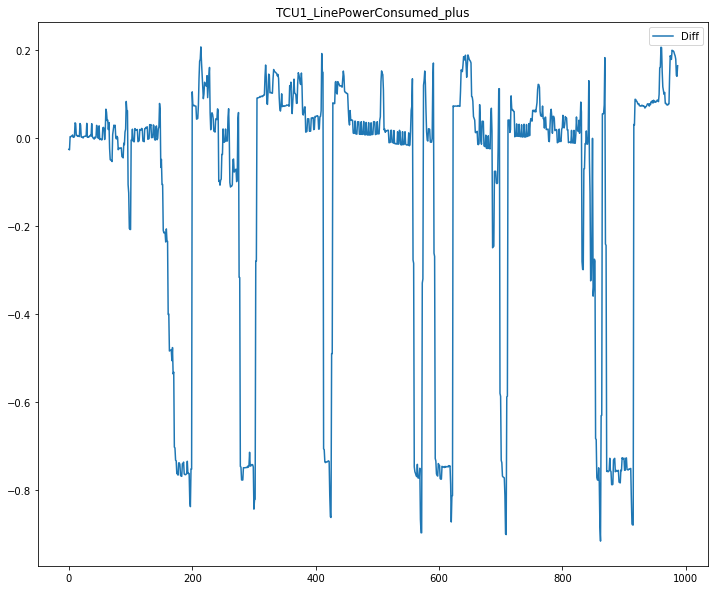

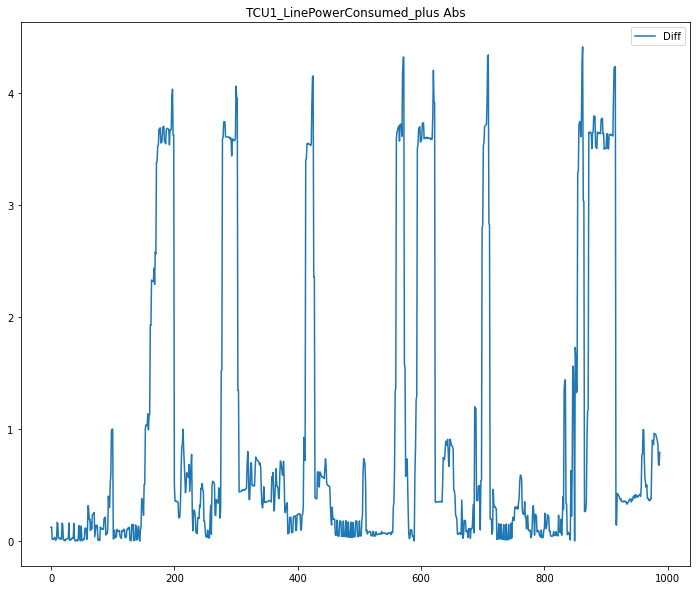

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11072636990.34%, std: 30936505744.07%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.6752717867357182
STD:  1.0862393733511577




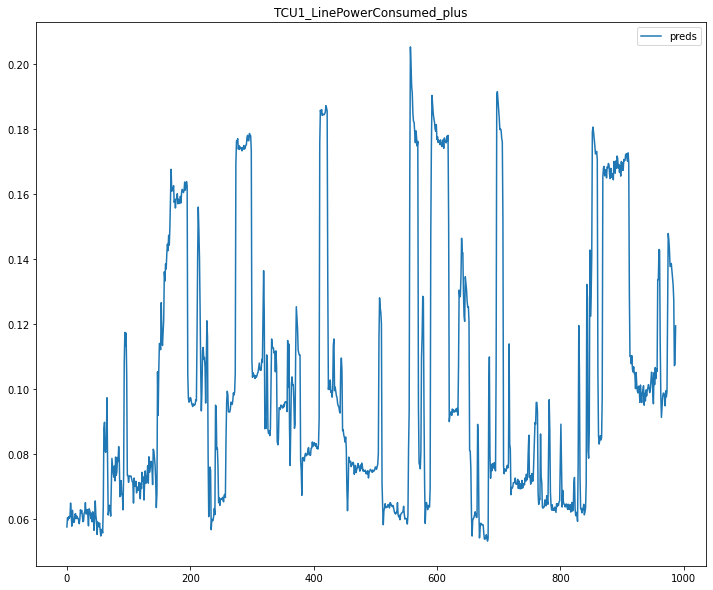

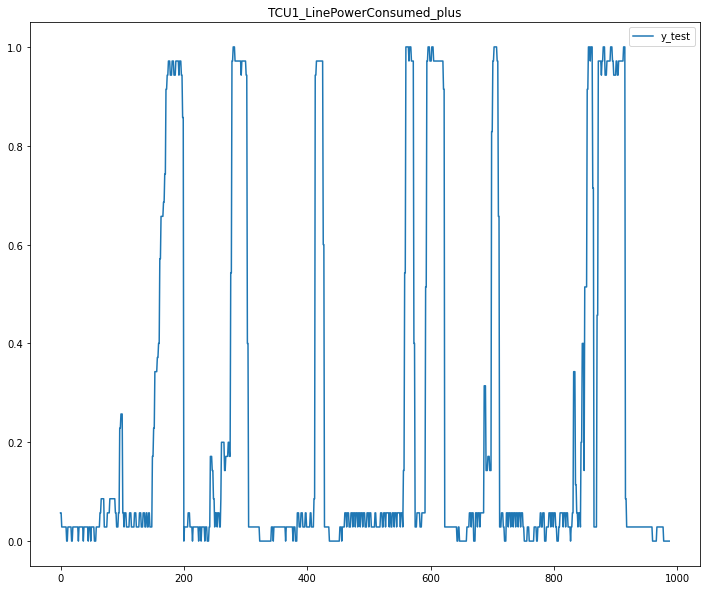

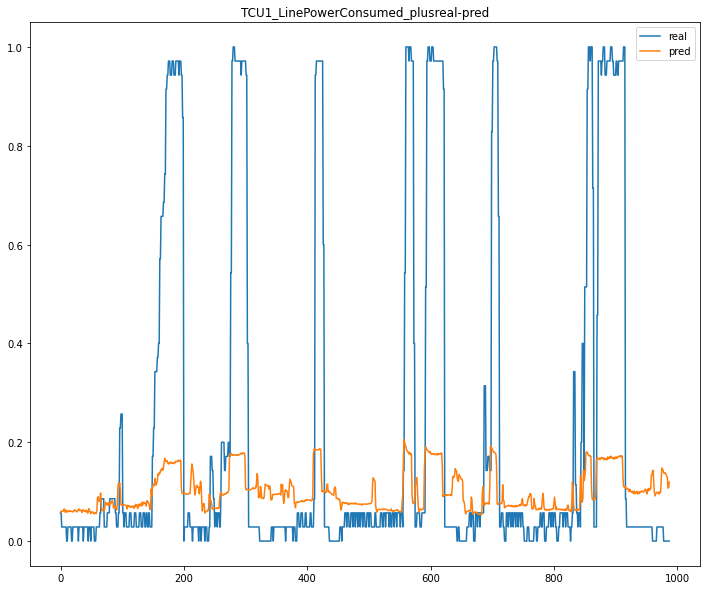

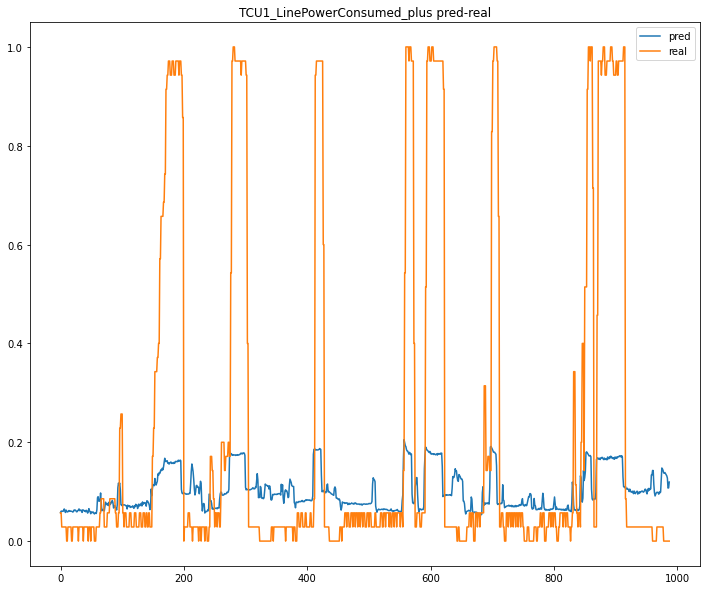

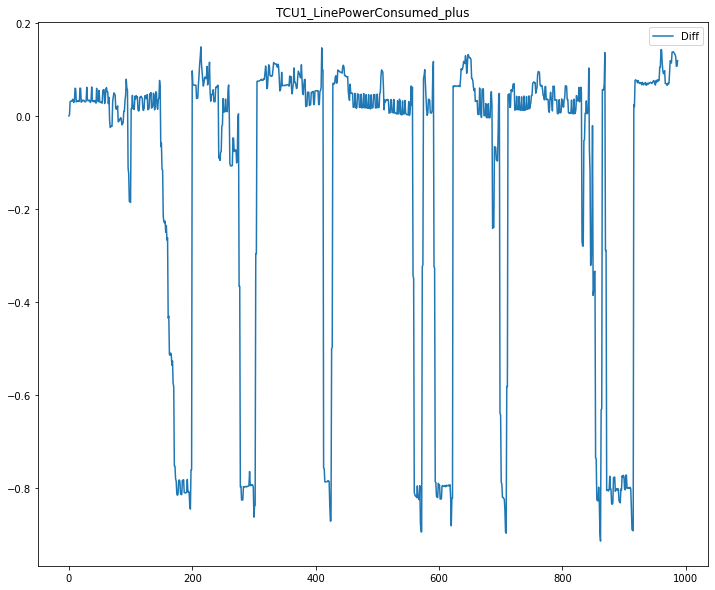

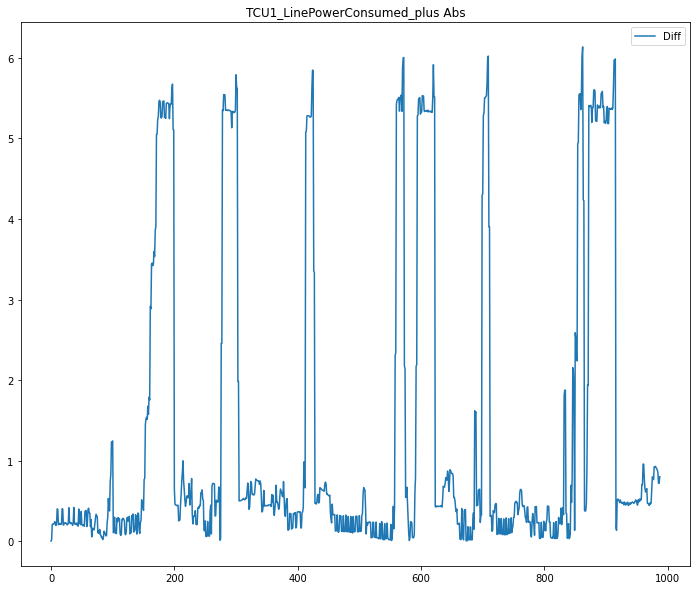

8 / 10
{'kernel': 'linear', 'C': 1, 'coef0': 10, 'gamma': 'auto', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 13057944221.30%, std: 38971243937.73%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2220113305943046
STD:  1.6514540351502245




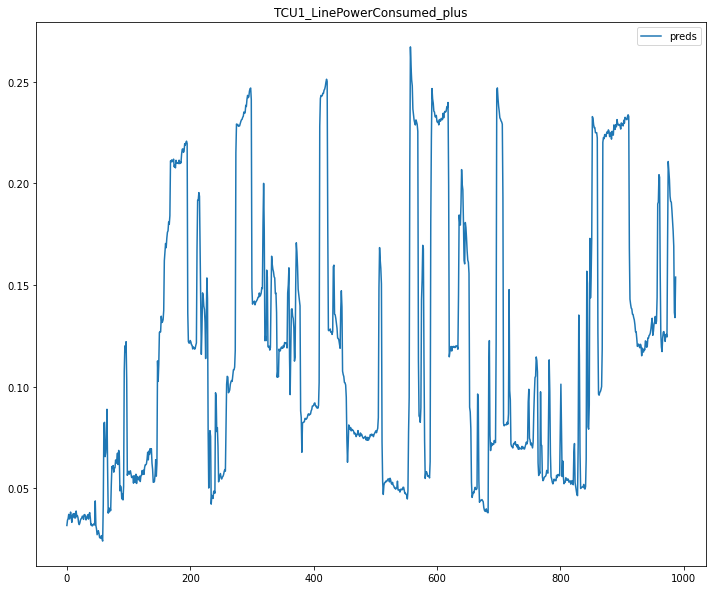

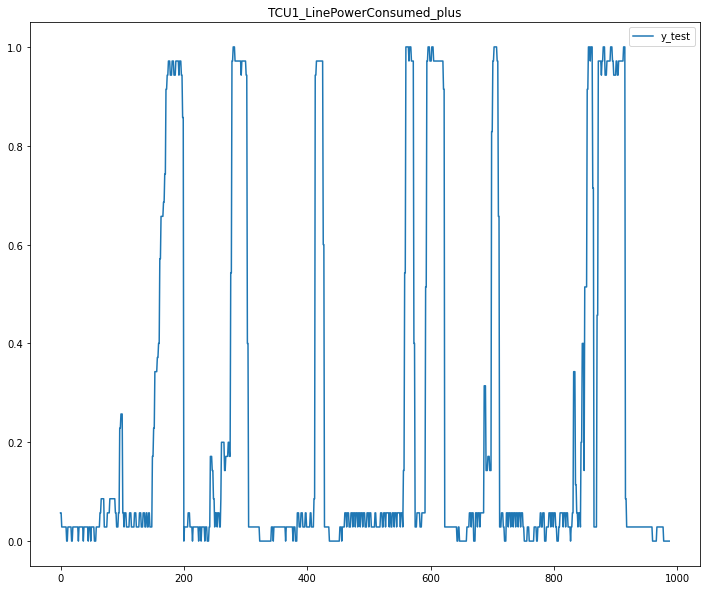

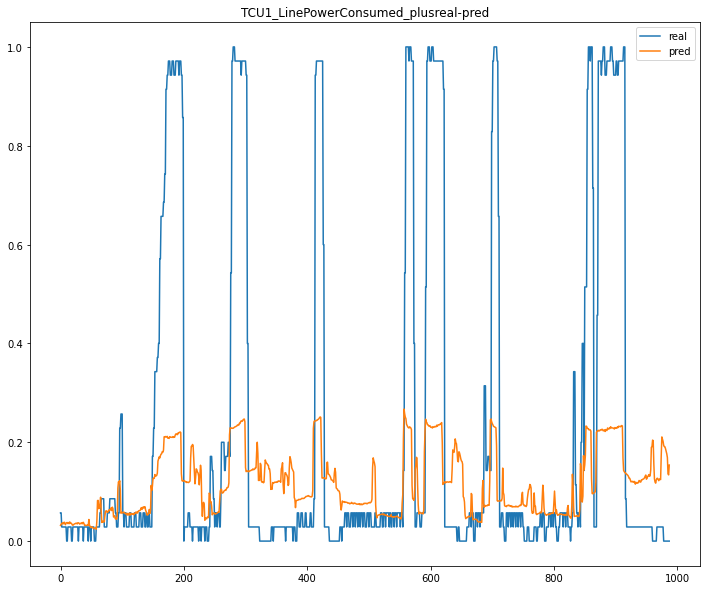

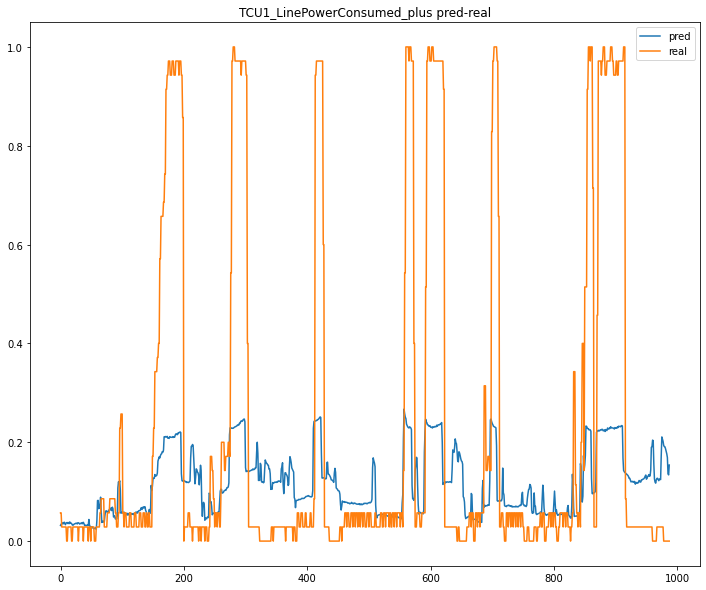

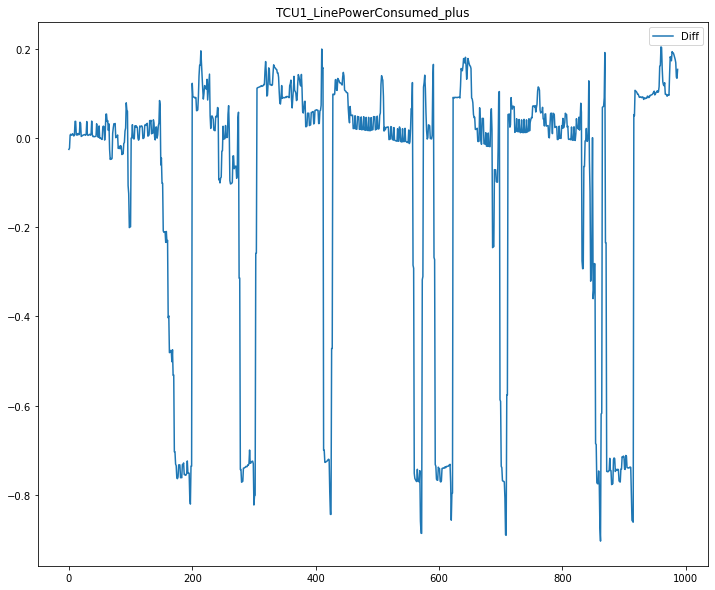

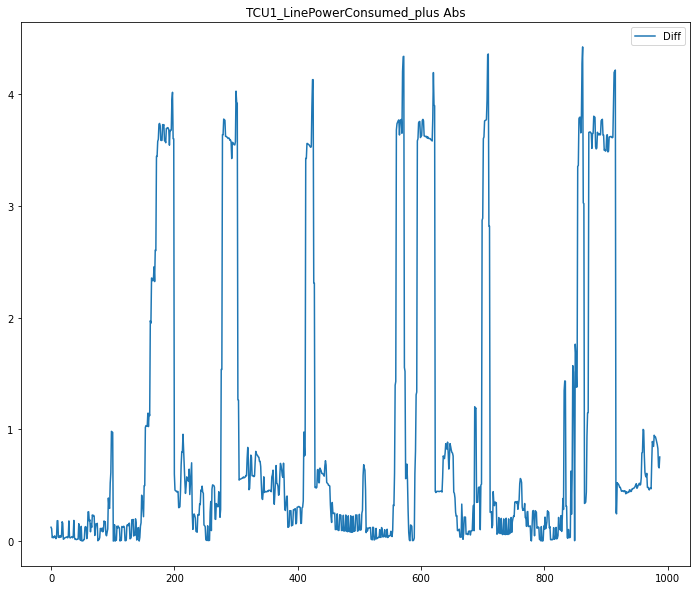

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12759708764.41%, std: 38861790079.06%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.2414470517043577
STD:  1.56267699122586




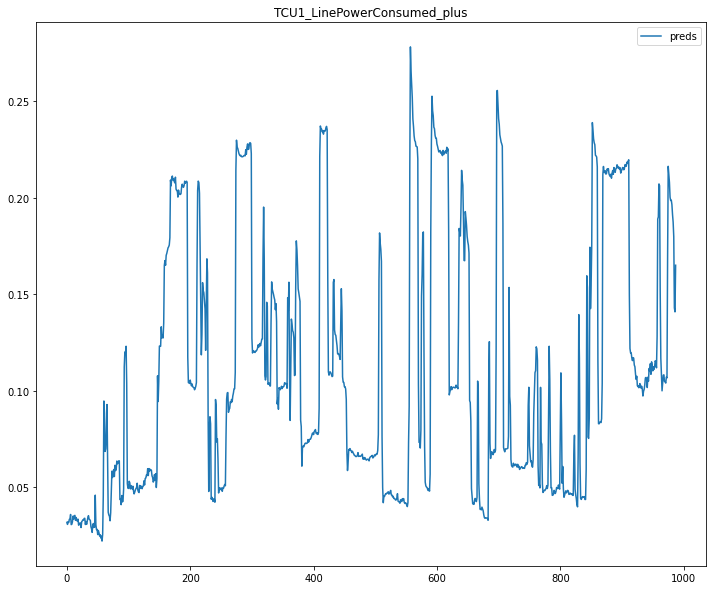

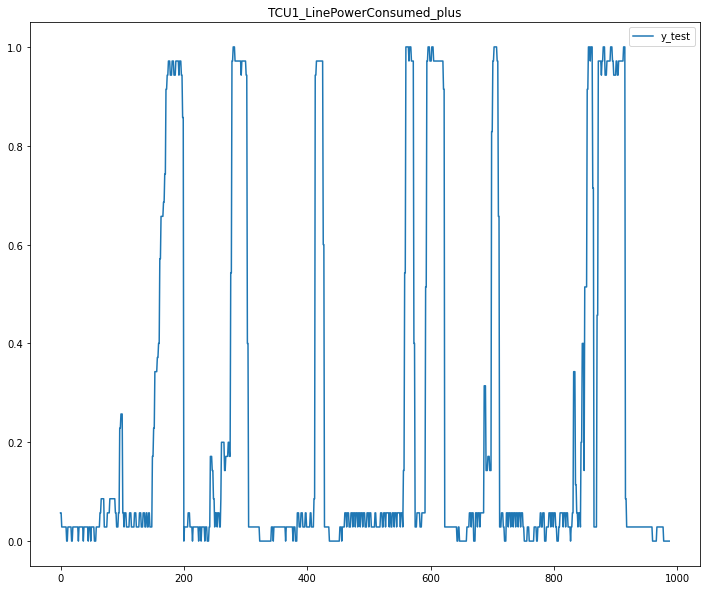

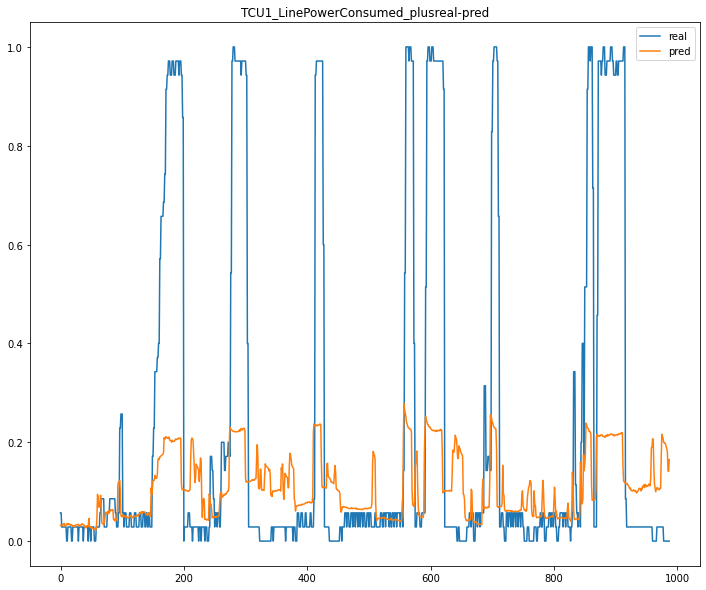

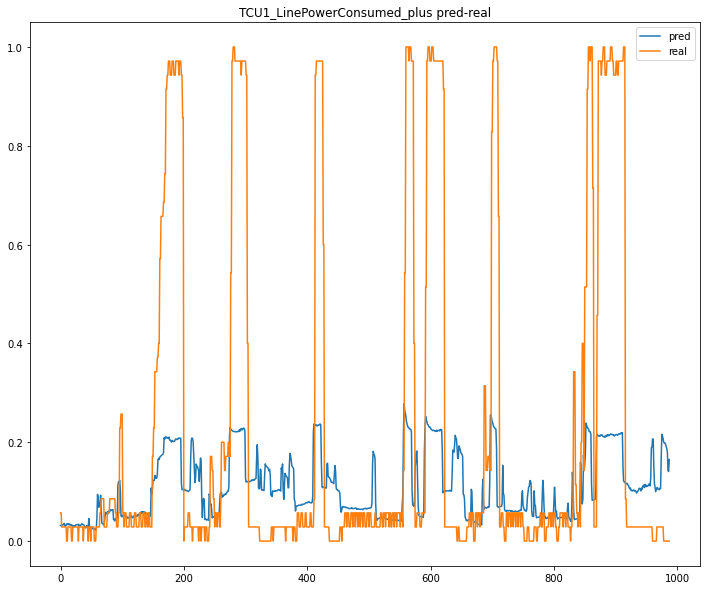

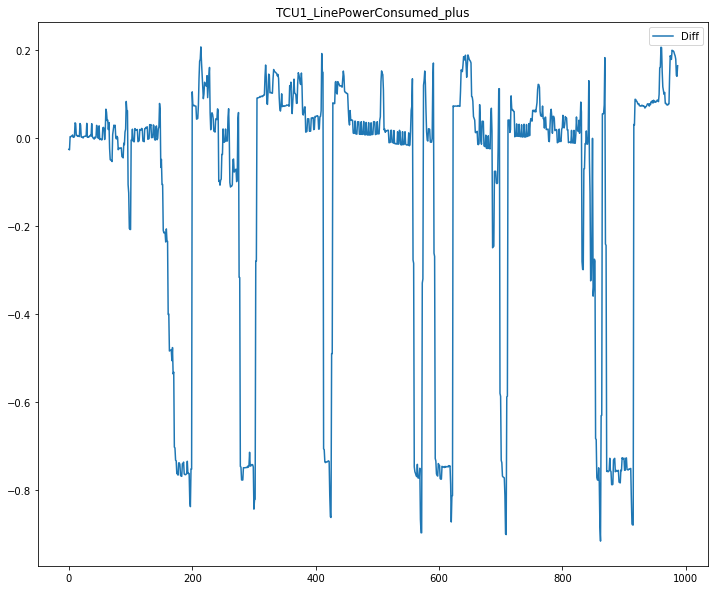

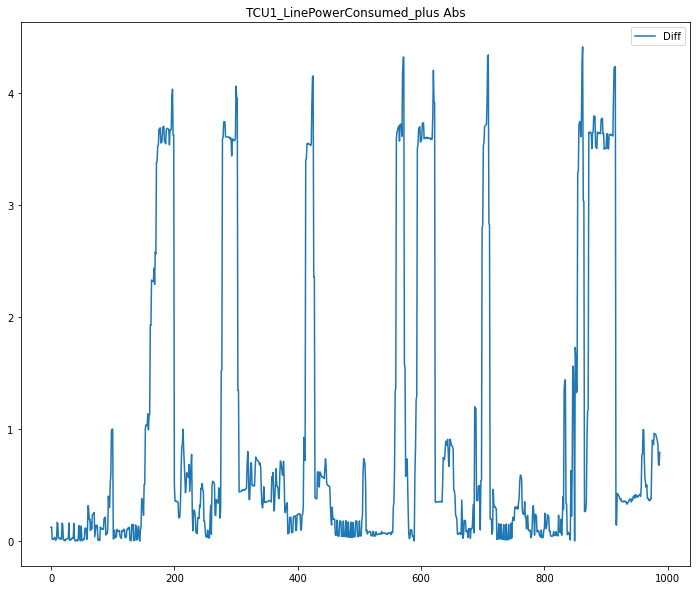

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11072636990.34%, std: 30936505744.07%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.6752717867357182
STD:  1.0862393733511577




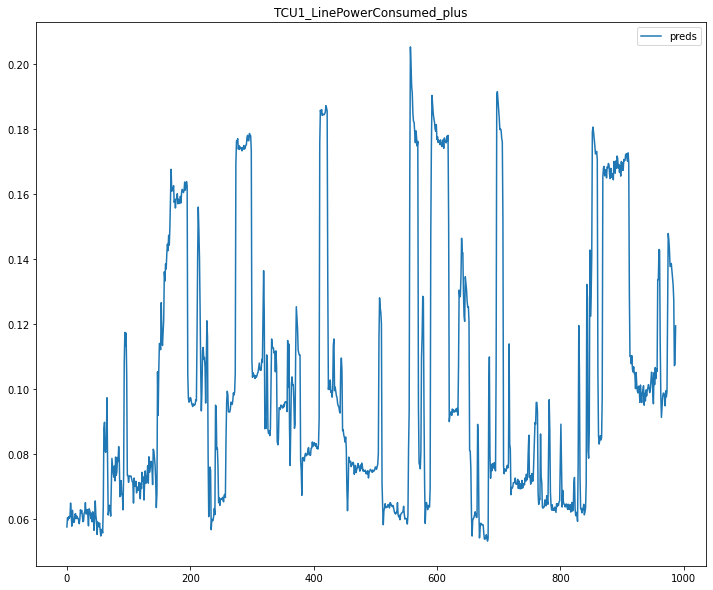

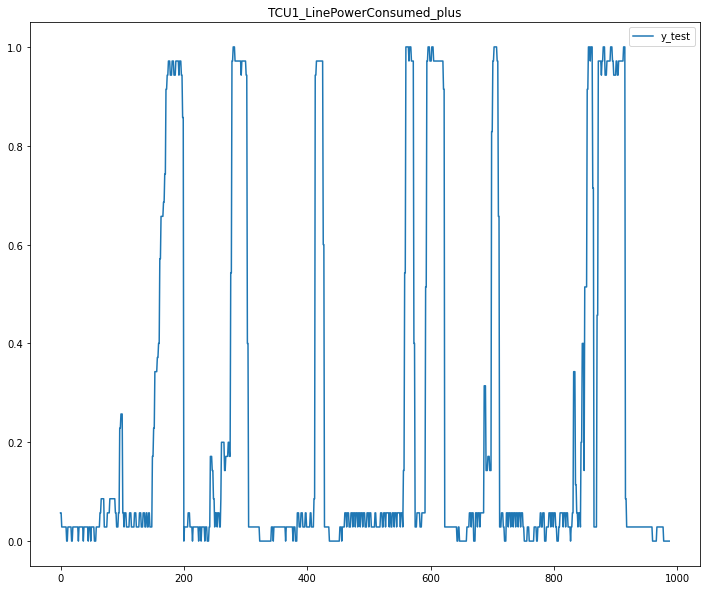

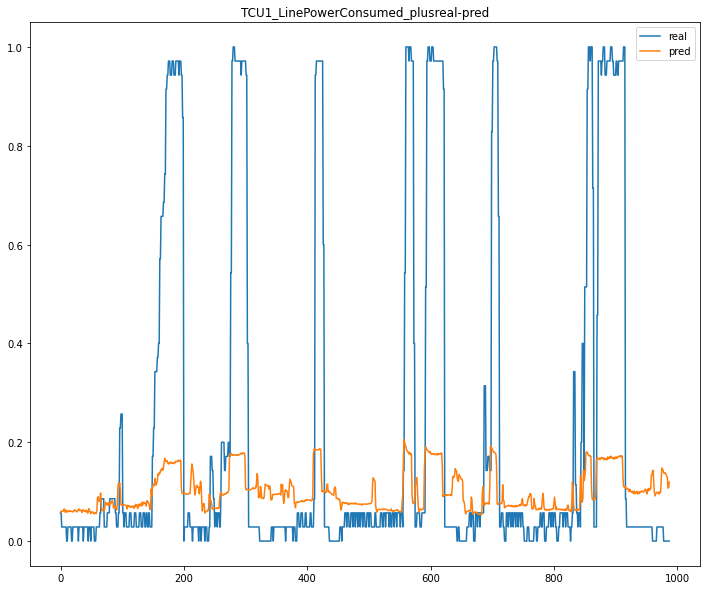

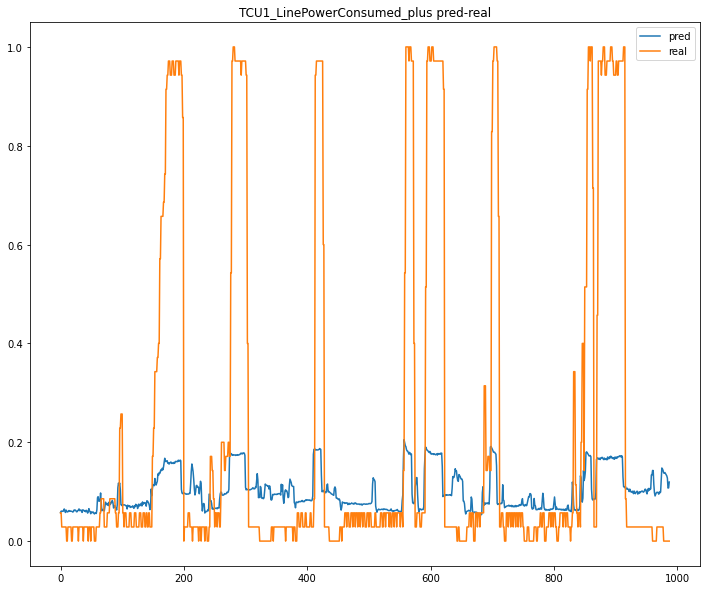

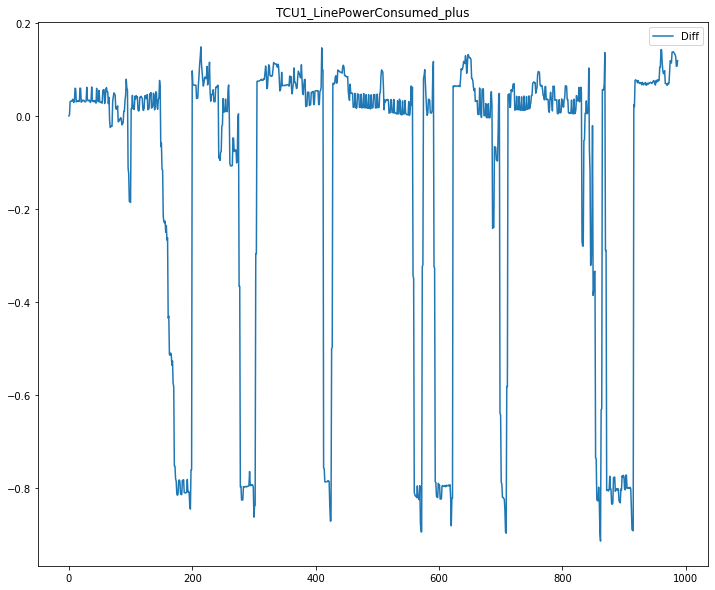

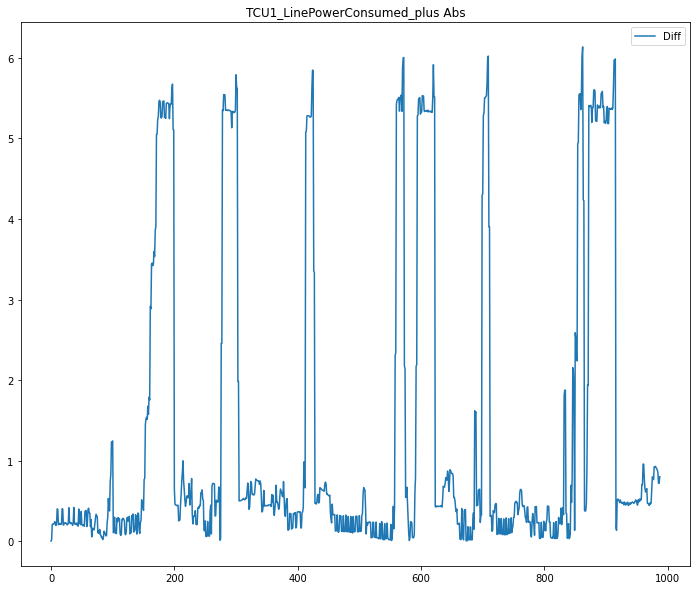

9 / 10
{'kernel': 'linear', 'C': 5, 'coef0': 0.01, 'gamma': 'auto', 'degree': 3}
Fold : 0/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14459783314.77%, std: 43144173423.44%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.35740249452793
STD:  1.811165855369843




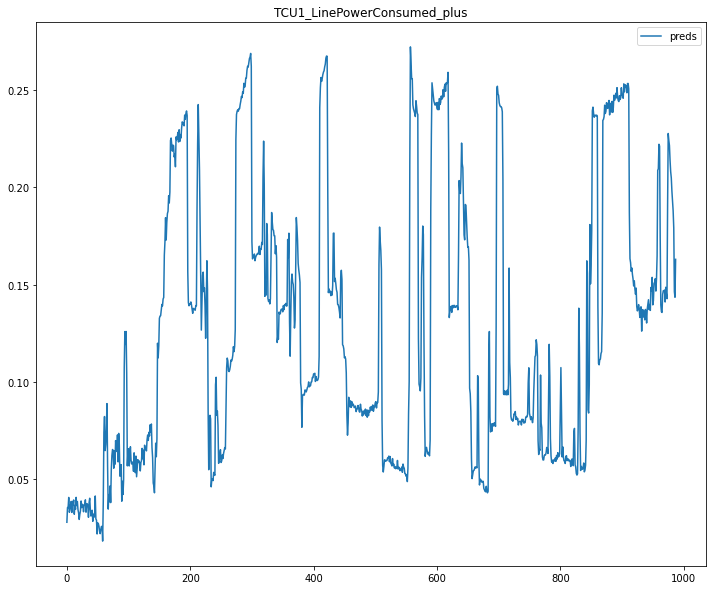

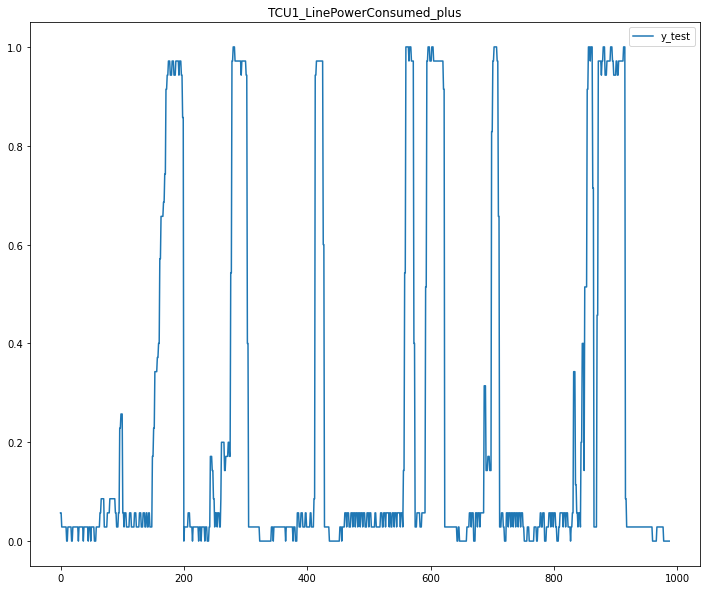

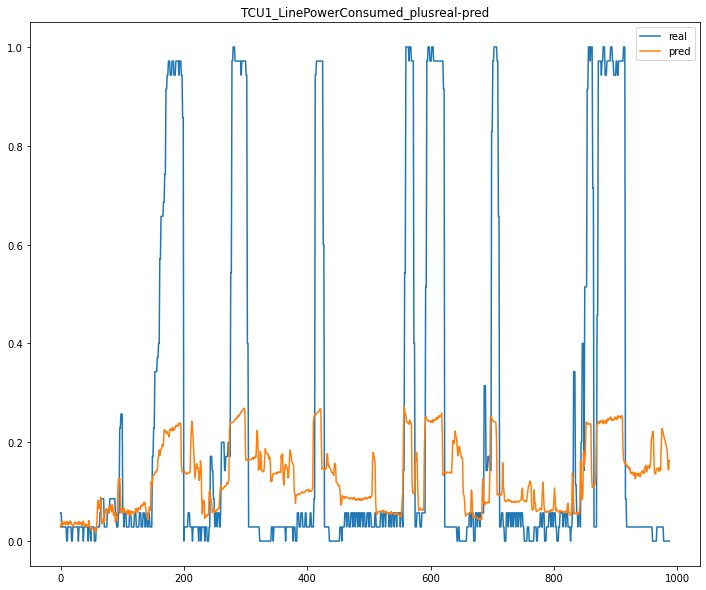

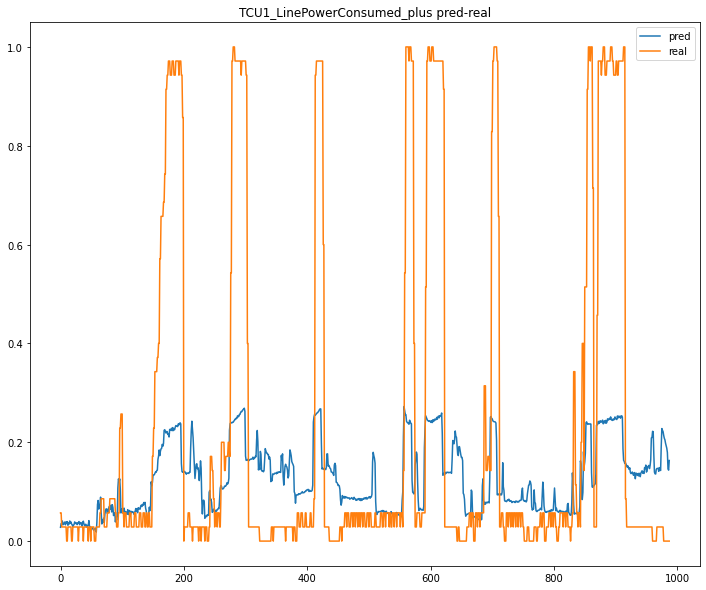

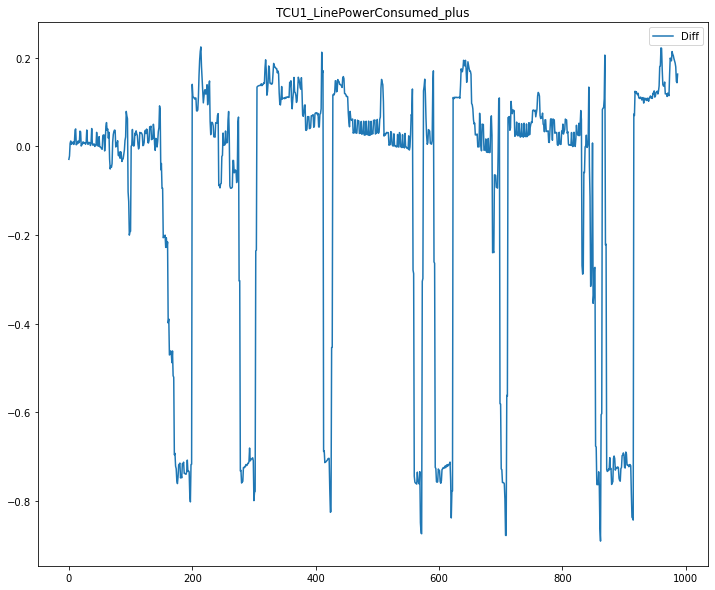

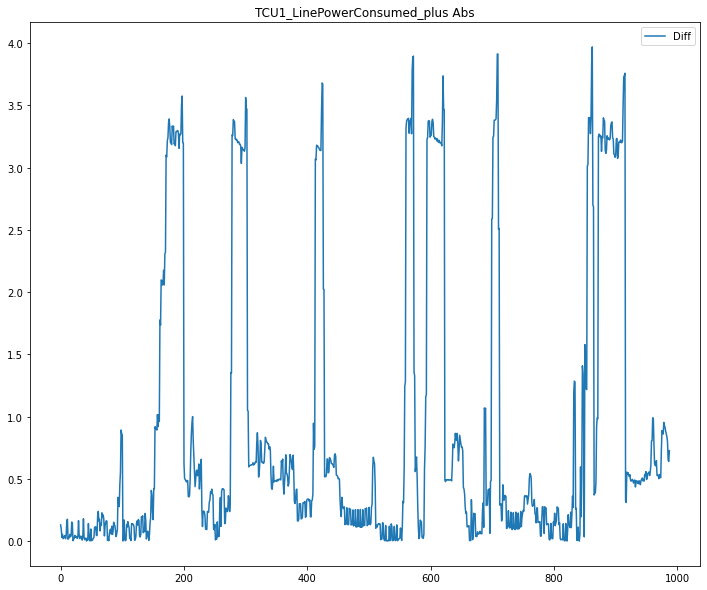

Fold : 1/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 14409321653.58%, std: 43682198309.48%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -1.255533126545516
STD:  1.5822212958771442




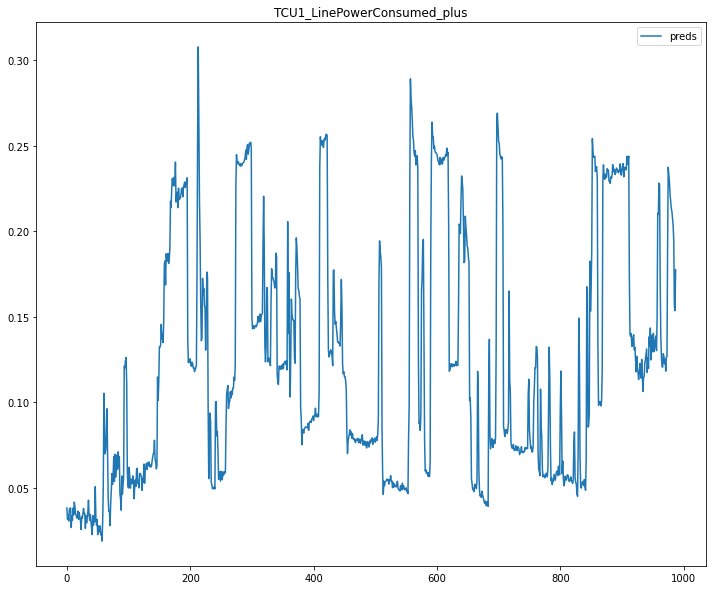

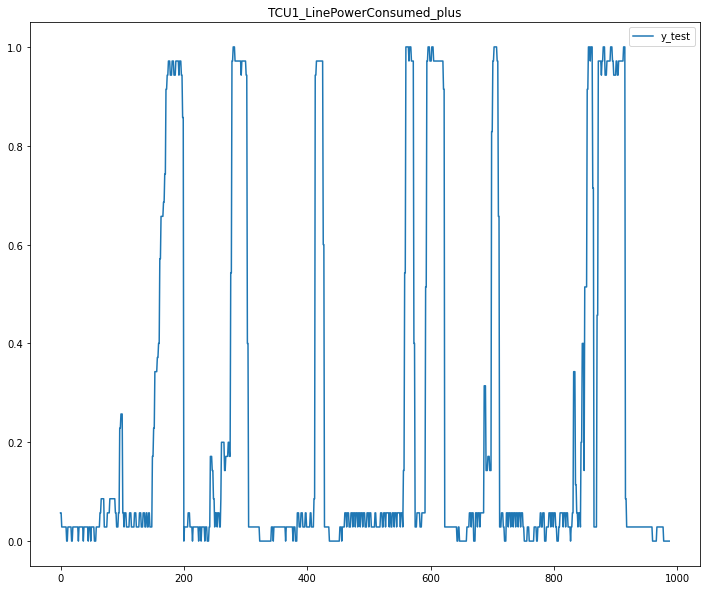

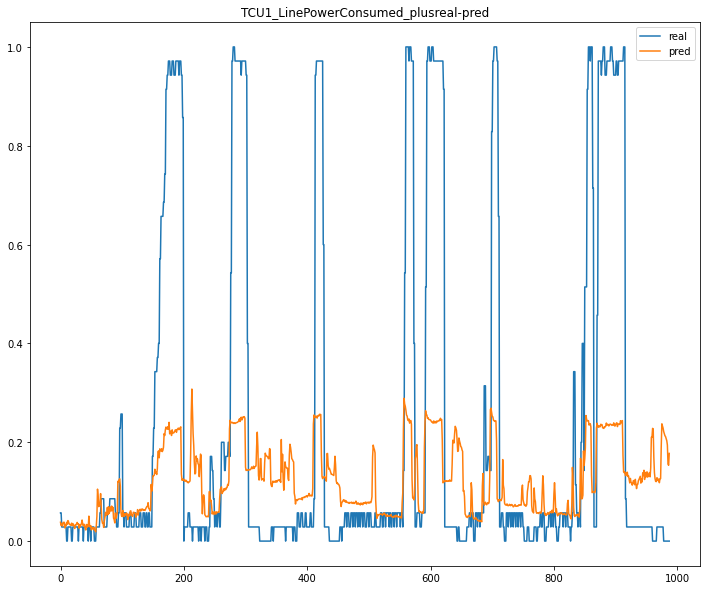

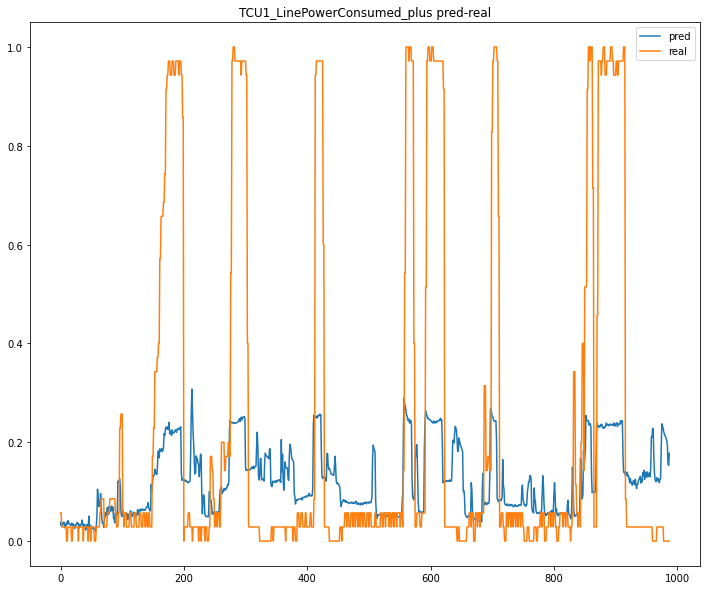

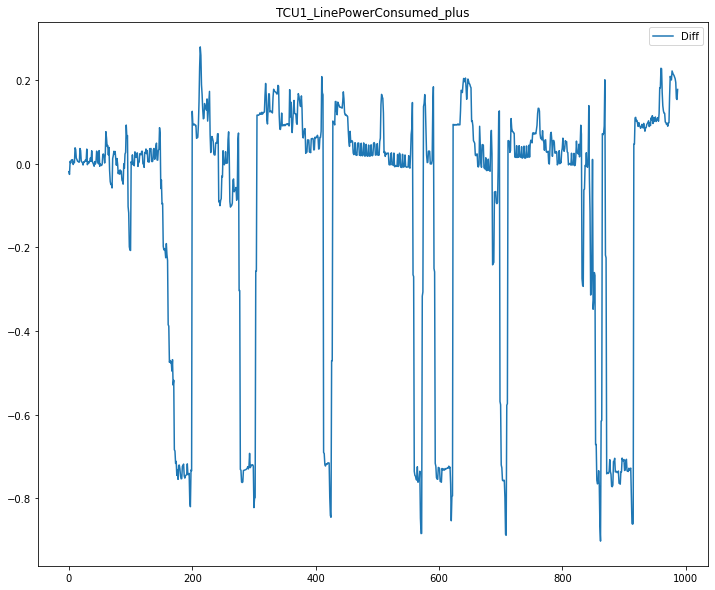

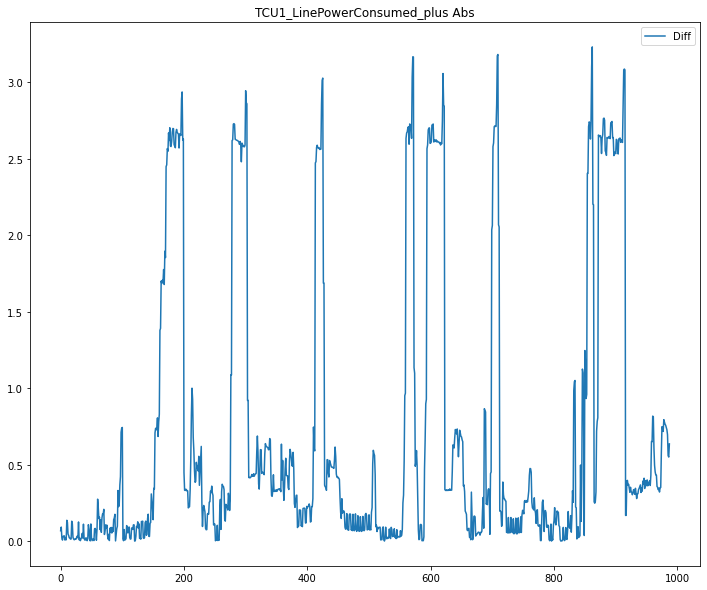

Fold : 2/3
[LibSVM]TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 11943914142.51%, std: 33695218644.38%
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]CV Mean:  -0.7442766095040572
STD:  1.1626018618639218




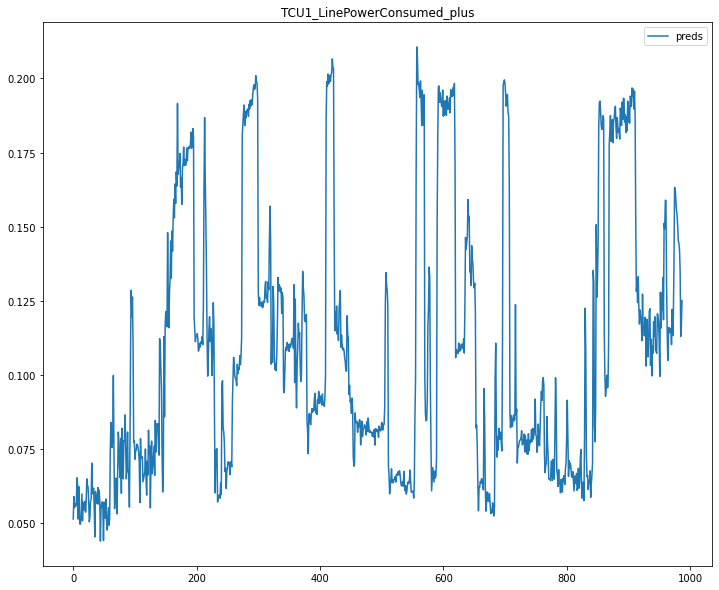

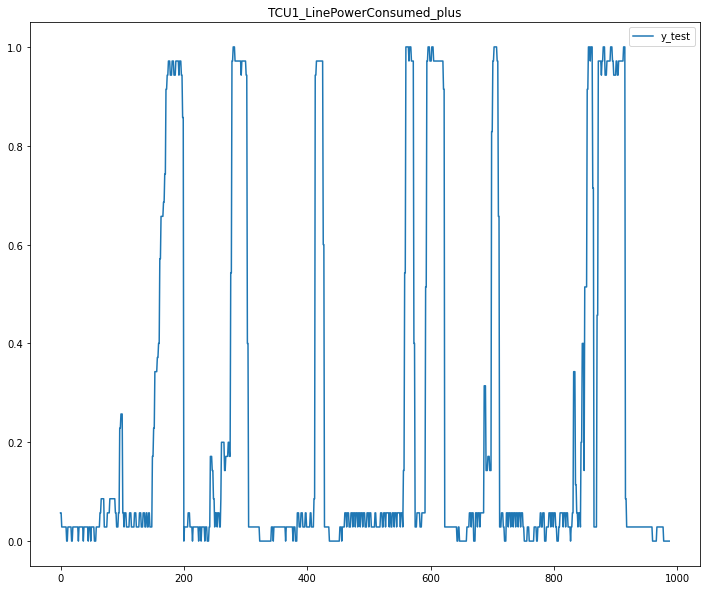

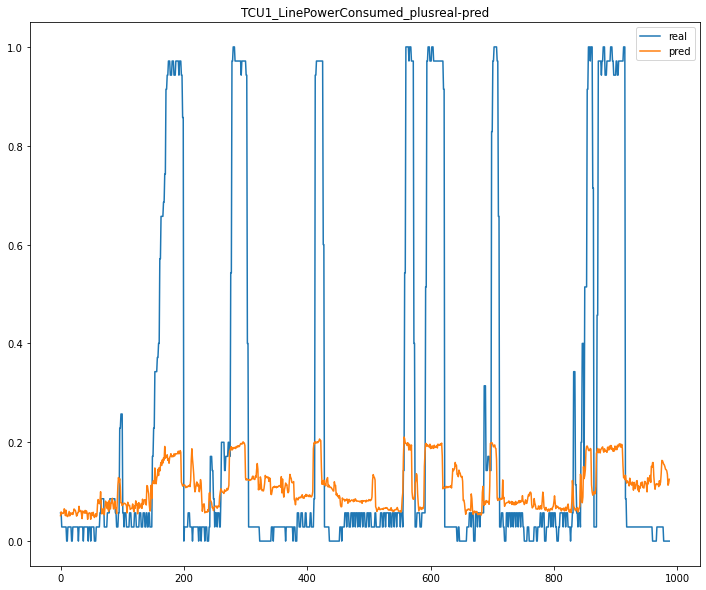

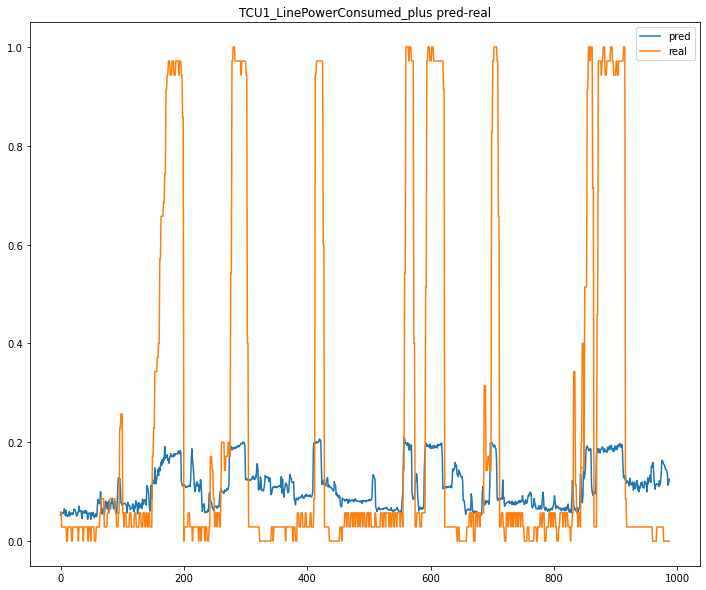

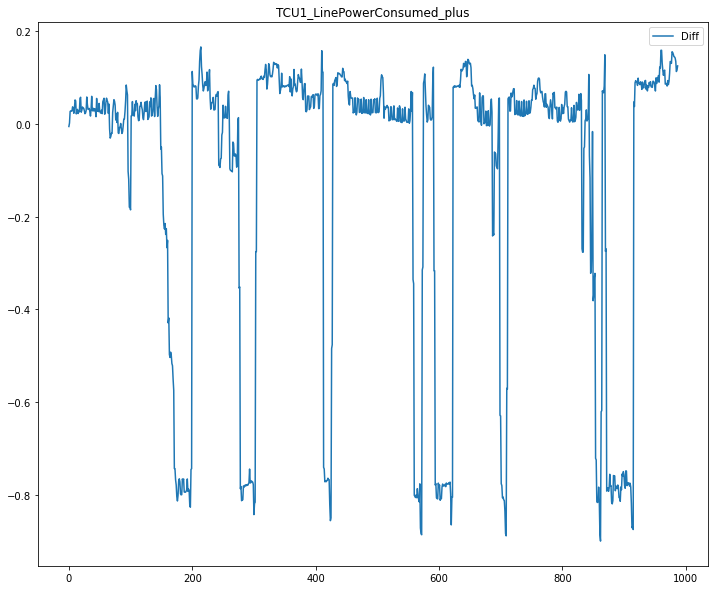

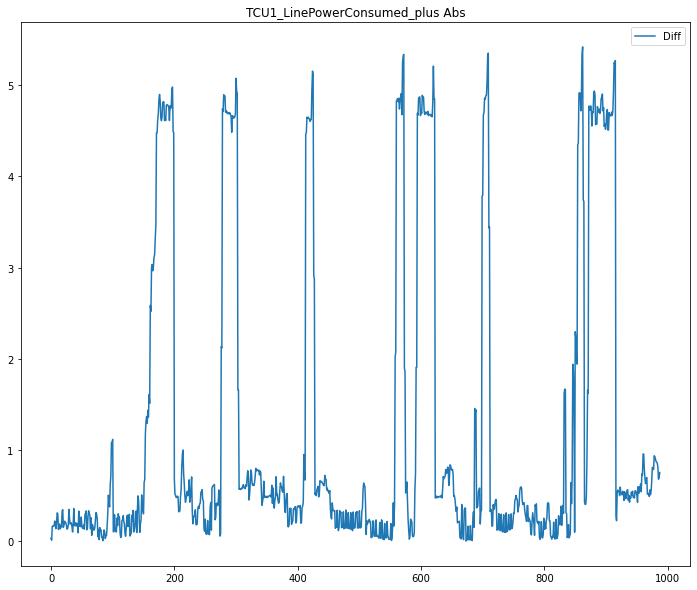

In [25]:
# from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import MeanAbsolutePercentageError
from sklearn.model_selection import TimeSeriesSplit, KFold, GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.svm import SVR
from keras.models import load_model

import numpy as np 

import random 

N_KFOLD=3
PLOT_PERCENT =None

result_list={}

params_dict = {'kernel' : ('linear', 'poly', 'rbf', 'sigmoid'),
             'C' : [1,5,10],
             'degree' : [3,8],
             'coef0' : [0.01,10,0.5],
             'gamma' : ('auto','scale')}
list_params = create_params_list_svm(params_dict)[:10]
random.shuffle(list_params)

#tscv = TimeSeriesSplit(n_splits=model_conf['n_kfold'])
tscv = KFold(n_splits=N_KFOLD,shuffle=True,random_state=42)
cont =0
for target in variables_objetivo[:1]:
    print (f'{target}')

    for i,params in enumerate(list_params):
        print (i,"/",len(list_params))
        print (params)
        ignore_columns = list(set(conf_dict['ignore_columns'] + variables_objetivo +discard_columns + variables_objetivo_current)) 
        
        for kfold, (train_index, val_index) in enumerate(tscv.split(df['train'])):

            print (f'Fold : {kfold}/{N_KFOLD}')
#             if kfold > 0:
#                 continue

            X_train, y_train,features = models.prepare_dataset(df['train'], ignore_columns,target, kfold=train_index[:30000])
            X_val, y_val,_ = models.prepare_dataset(df['train'], ignore_columns,target, kfold=val_index[:30000])
            X_test, y_test,_ = models.prepare_dataset(df['test'][:10000], ignore_columns,target)



            svr = SVR(kernel=params['kernel'],
                           degree=params['degree'],
                           gamma=params['gamma'],
                           coef0=params['coef0'],
                           C=params['C'],
                           verbose=True, 
                           max_iter=1000000000
                          )

#            grids = GridSearchCV(modelsvr,params,cv=3, n_jobs = -1, verbose = 2)

            svr.fit(X_train, y_train)
            preds = svr.predict(X_test)

            quick_analysis(preds, y_test)
            scores = get_cv_scores(svr,X_train, y_train)
            
            train_info_dict = create_train_info_dict(store_model_path, params,target,'{}-{}'.format(str(cont),str(kfold)))
            train_info_dict['etl_version']=etl_step.ETL_VERSION
            train_info_dict['regresor']='svr'
            train_info_dict['features']=features
            train_info_dict['score']=scores
            train_info_dict['params']=params

            create_plots(preds, y_test, target,train_info_dict,'{}-{}'.format(str(cont),str(kfold)) ,plot_percent=PLOT_PERCENT)


            joblib.dump(svr, train_info_dict['model'])

            with open(train_info_dict['train_info'].format(scores),'wb') as f:
                pickle.dump( train_info_dict,f)
            result_list[target]=(scores,train_info_dict['train_info'].format(scores))
        cont+=1


In [26]:
result_filename = 'resultsSVM_'+etl_step.ETL_VERSION+'_'+utils.get_timestamp()+'.pickle'

with open(result_filename,'wb') as f:
    pickle.dump( result_list,f)

# Random Forest Regressor

In [27]:
def create_params_list_rfr(params_dict):
    list_params = []
    for max_depth in params_dict['max_depth']:
        for min_samples_leaf in params_dict['min_samples_leaf']:
            for min_samples_split in params_dict['min_samples_split']:
                    for n_estimators in params_dict['n_estimators']:
                        params={'max_depth':max_depth,
                                'min_samples_leaf':min_samples_leaf,
                                'n_estimators':n_estimators,
                                'min_samples_split':min_samples_split}
                        list_params.append(params)
    return list_params

def create_filename_template(path,params,target,kfold, score=False):
    filename = ['modelRFR']
    if score:
        filename += ['S{}']
    filename += ['T'+target]
    filename += ['KF'+str(kfold)]
    filename += ['MD'+str(params['max_depth'])]
    filename += ['MSL'+str(params['min_samples_leaf'])]
    filename += ['NE'+str(params['n_estimators'])]
    filename += ['MSS'+str(params['min_samples_split'])]
    filename = "-".join(filename)
    filename = os.path.join(path, filename)
    return filename

TCU1_LinePowerConsumed_plus
0 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 1000, 'min_samples_split': 2}
Fold : 0/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s


building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000

building tree 4 of 1000building tree 5 of 1000
building tree 6 of 1000
building tree 7 of 1000

building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000
building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000
building tree 15 of 1000
building tree 16 of 1000
building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000building tree 21 of 1000

building tree 22 of 1000
building tree 23 of 1000
building tree 24 of 1000building tree 25 of 1000

building tree 26 of 1000
building tree 27 of 1000
building tree 28 of 1000
building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000
building tree 32 of 1000
building tree 33 of 1000
building tree 34 of 1000
building tree 35 of 1000
building tree 36 of 1000
building tree 37 of 1000
building tree 38 of 1000
building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 289 of 1000
building tree 290 of 1000
building tree 291 of 1000building tree 292 of 1000

building tree 293 of 1000
building tree 294 of 1000
building tree 295 of 1000
building tree 296 of 1000building tree 297 of 1000

building tree 298 of 1000building tree 299 of 1000

building tree 300 of 1000
building tree 301 of 1000building tree 302 of 1000

building tree 303 of 1000
building tree 304 of 1000
building tree 305 of 1000
building tree 306 of 1000
building tree 307 of 1000building tree 308 of 1000
building tree 309 of 1000

building tree 310 of 1000building tree 311 of 1000building tree 312 of 1000
building tree 313 of 1000


building tree 314 of 1000
building tree 315 of 1000
building tree 316 of 1000
building tree 317 of 1000building tree 318 of 1000

building tree 319 of 1000
building tree 320 of 1000
building tree 321 of 1000building tree 322 of 1000

building tree 323 of 1000building tree 324 of 1000

building tree 325 of 1000
building tree 326 of 1000building tree

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 452 of 1000building tree 453 of 1000

building tree 454 of 1000
building tree 455 of 1000
building tree 456 of 1000
building tree 457 of 1000
building tree 458 of 1000
building tree 459 of 1000building tree 460 of 1000

building tree 461 of 1000building tree 462 of 1000

building tree 463 of 1000
building tree 464 of 1000
building tree 465 of 1000
building tree 466 of 1000
building tree 467 of 1000
building tree 468 of 1000
building tree 469 of 1000
building tree 470 of 1000
building tree 471 of 1000
building tree 472 of 1000
building tree 473 of 1000
building tree 474 of 1000
building tree 475 of 1000
building tree 476 of 1000
building tree 477 of 1000
building tree 478 of 1000building tree 479 of 1000

building tree 480 of 1000building tree 481 of 1000

building tree 482 of 1000
building tree 483 of 1000
building tree 484 of 1000
building tree 485 of 1000
building tree 486 of 1000
building tree 487 of 1000
building tree 488 of 1000
building tree 489 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.9s


building tree 764 of 1000building tree 765 of 1000

building tree 766 of 1000
building tree 767 of 1000
building tree 768 of 1000
building tree 769 of 1000
building tree 770 of 1000
building tree 771 of 1000building tree 772 of 1000

building tree 773 of 1000building tree 774 of 1000

building tree 775 of 1000
building tree 776 of 1000
building tree 777 of 1000
building tree 778 of 1000
building tree 779 of 1000building tree 780 of 1000
building tree 781 of 1000

building tree 782 of 1000
building tree 783 of 1000
building tree 784 of 1000
building tree 785 of 1000building tree 786 of 1000

building tree 787 of 1000
building tree 788 of 1000building tree 789 of 1000

building tree 790 of 1000
building tree 791 of 1000
building tree 792 of 1000
building tree 793 of 1000
building tree 794 of 1000building tree 795 of 1000

building tree 796 of 1000
building tree 797 of 1000building tree 798 of 1000

building tree 799 of 1000
building tree 800 of 1000
building tree 801 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.2s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6383027000.42%, std: 19820766145.52%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 806 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    2.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -2.0235336875254015
STD:  3.797177536859214




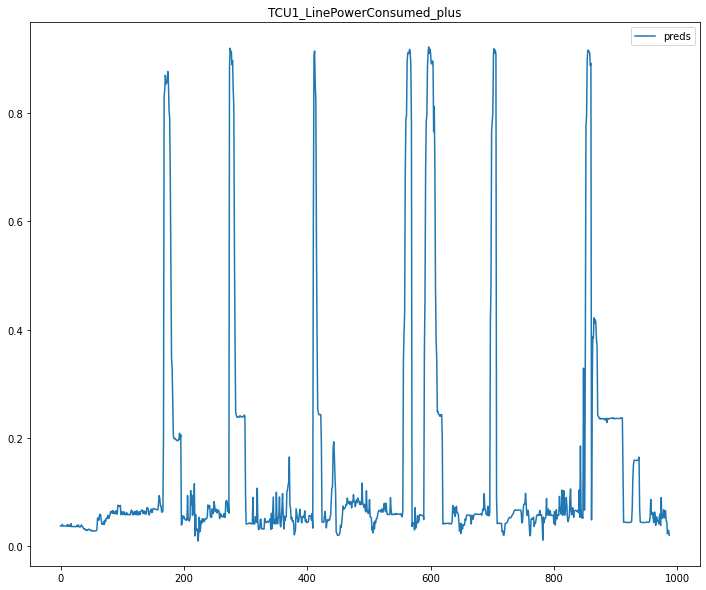

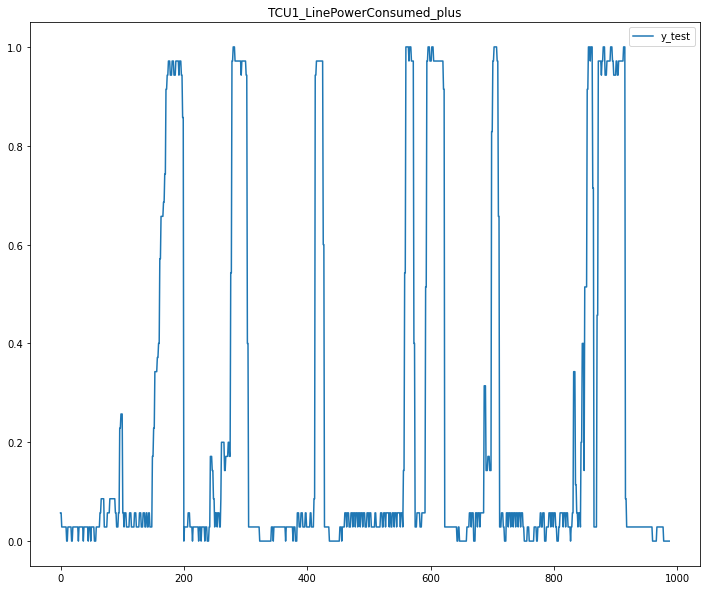

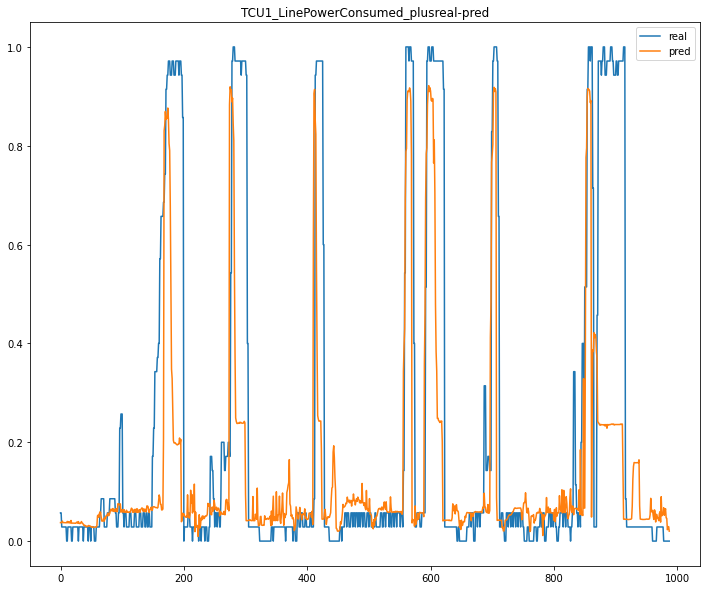

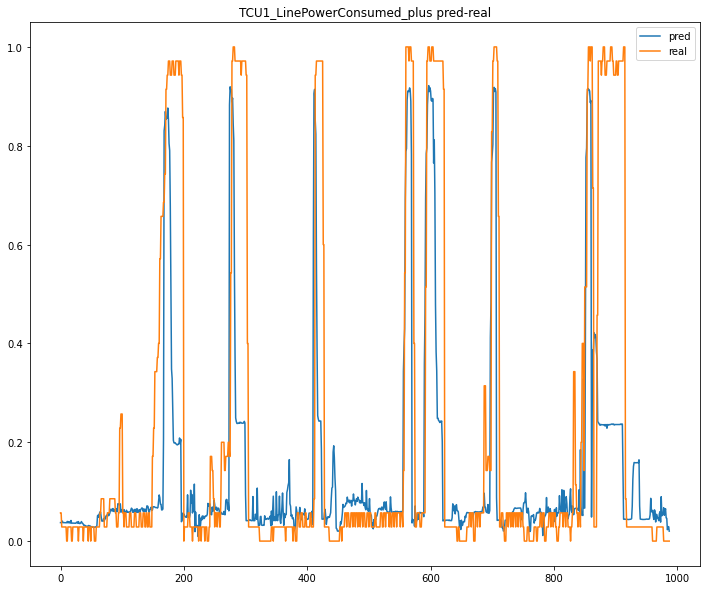

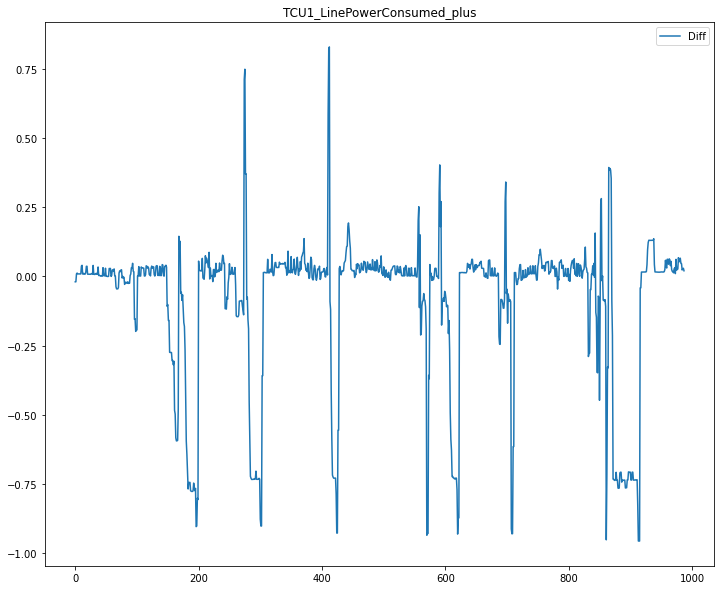

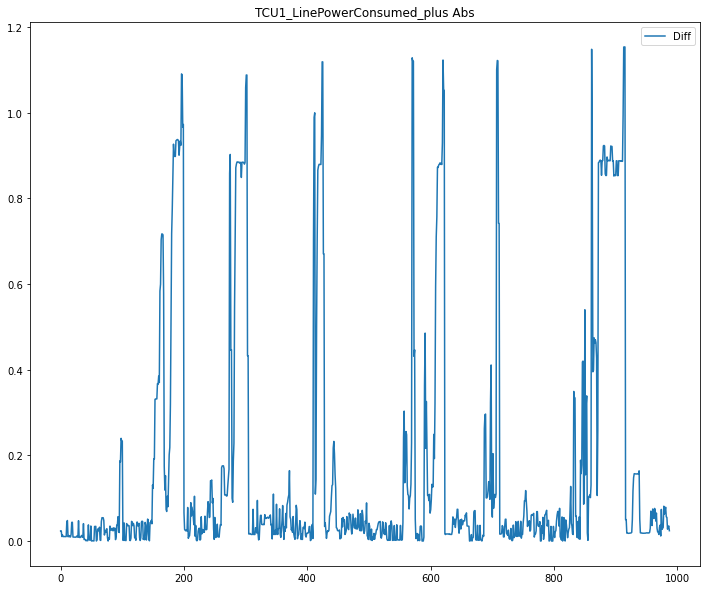

Fold : 1/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 1 of 1000
building tree 2 of 1000
building tree 3 of 1000
building tree 4 of 1000
building tree 5 of 1000
building tree 6 of 1000building tree 7 of 1000
building tree 8 of 1000

building tree 9 of 1000
building tree 10 of 1000building tree 11 of 1000

building tree 12 of 1000
building tree 13 of 1000building tree 14 of 1000

building tree 15 of 1000
building tree 16 of 1000
building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000
building tree 21 of 1000
building tree 22 of 1000building tree 23 of 1000building tree 24 of 1000


building tree 25 of 1000
building tree 26 of 1000
building tree 27 of 1000
building tree 28 of 1000
building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000
building tree 32 of 1000
building tree 33 of 1000
building tree 34 of 1000
building tree 35 of 1000building tree 36 of 1000

building tree 37 of 1000
building tree 38 of 1000
building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.4s


building tree 477 of 1000
building tree 478 of 1000building tree 479 of 1000

building tree 480 of 1000
building tree 481 of 1000
building tree 482 of 1000
building tree 483 of 1000
building tree 484 of 1000building tree 485 of 1000building tree 486 of 1000

building tree 487 of 1000

building tree 488 of 1000building tree 489 of 1000

building tree 490 of 1000
building tree 491 of 1000building tree 492 of 1000building tree 493 of 1000


building tree 494 of 1000
building tree 495 of 1000
building tree 496 of 1000
building tree 497 of 1000
building tree 498 of 1000
building tree 499 of 1000
building tree 500 of 1000
building tree 501 of 1000
building tree 502 of 1000
building tree 503 of 1000
building tree 504 of 1000building tree 505 of 1000

building tree 506 of 1000
building tree 507 of 1000
building tree 508 of 1000
building tree 509 of 1000
building tree 510 of 1000
building tree 511 of 1000
building tree 512 of 1000
building tree 513 of 1000
building tree 514 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s



building tree 796 of 1000building tree 797 of 1000

building tree 798 of 1000
building tree 799 of 1000
building tree 800 of 1000
building tree 801 of 1000building tree 802 of 1000

building tree 803 of 1000
building tree 804 of 1000
building tree 805 of 1000
building tree 806 of 1000
building tree 807 of 1000building tree 808 of 1000

building tree 809 of 1000
building tree 810 of 1000
building tree 811 of 1000
building tree 812 of 1000
building tree 813 of 1000building tree 814 of 1000

building tree 815 of 1000
building tree 816 of 1000
building tree 817 of 1000
building tree 818 of 1000
building tree 819 of 1000
building tree 820 of 1000
building tree 821 of 1000
building tree 822 of 1000building tree 823 of 1000
building tree 824 of 1000

building tree 825 of 1000
building tree 826 of 1000
building tree 827 of 1000
building tree 828 of 1000
building tree 829 of 1000
building tree 830 of 1000
building tree 831 of 1000building tree 832 of 1000

building tree 833 of 1000
building tr

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6193841877.04%, std: 21122771861.51%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 985 out of 1000 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | el

CV Mean:  -3.1694980729769826
STD:  5.361510333561




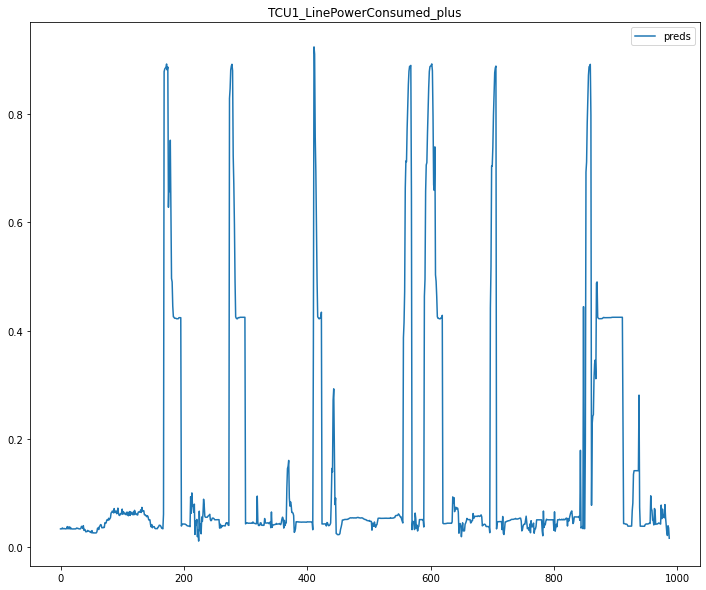

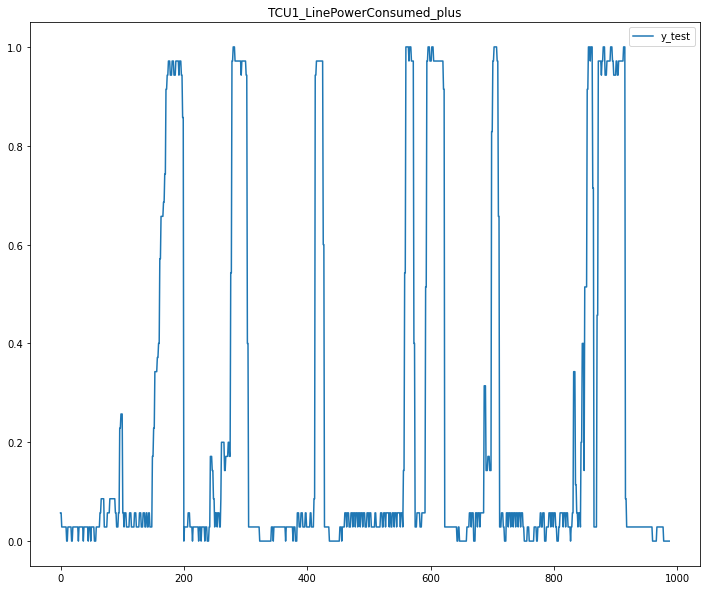

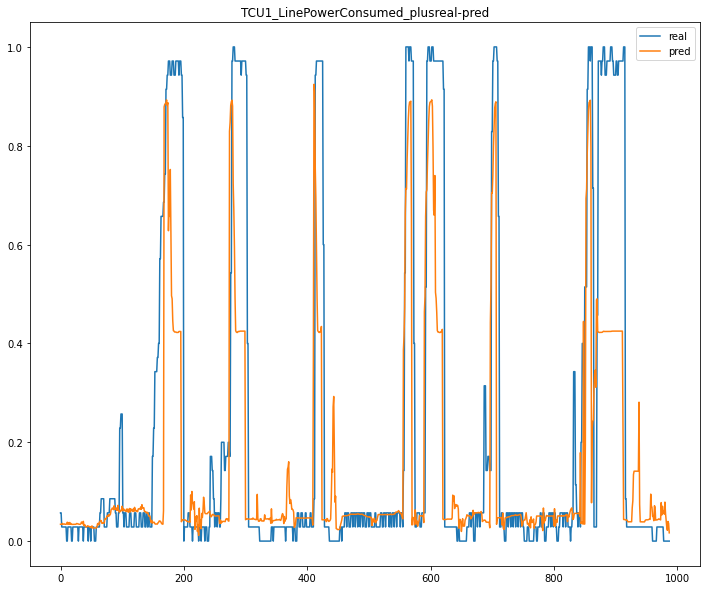

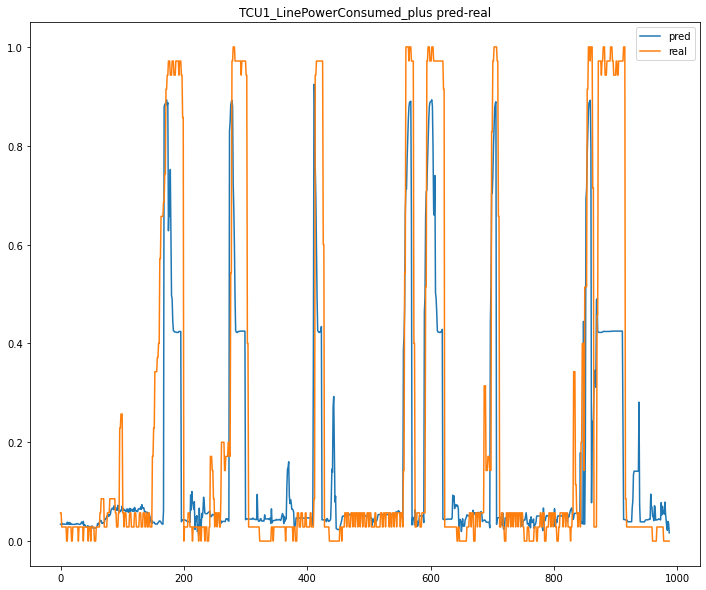

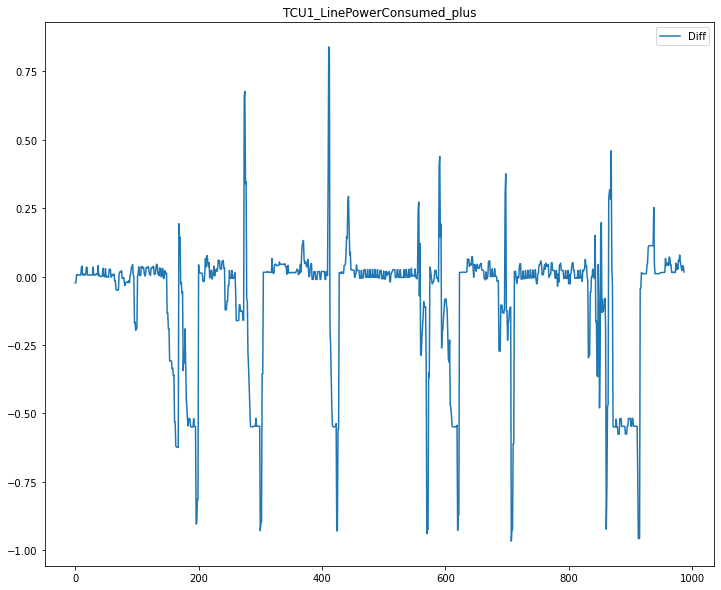

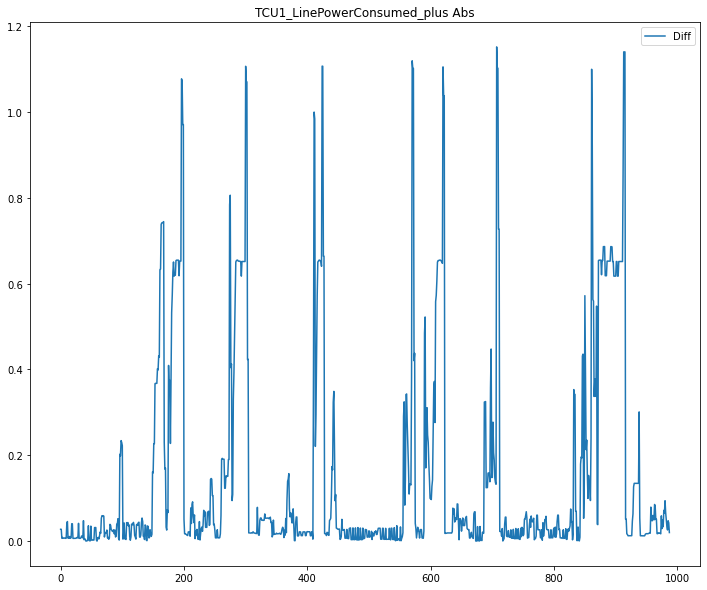

Fold : 2/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000building tree 4 of 1000

building tree 5 of 1000building tree 6 of 1000


building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000building tree 10 of 1000

building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000building tree 14 of 1000
building tree 15 of 1000
building tree 16 of 1000

building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000
building tree 21 of 1000
building tree 22 of 1000
building tree 23 of 1000
building tree 24 of 1000
building tree 25 of 1000
building tree 26 of 1000building tree 27 of 1000
building tree 28 of 1000

building tree 29 of 1000building tree 30 of 1000

building tree 31 of 1000building tree 32 of 1000

building tree 33 of 1000
building tree 34 of 1000building tree 35 of 1000

building tree 36 of 1000
building tree 37 of 1000
building tree 38 of 1000
building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s




building tree 306 of 1000
building tree 307 of 1000
building tree 308 of 1000
building tree 309 of 1000
building tree 310 of 1000building tree 311 of 1000building tree 312 of 1000


building tree 313 of 1000
building tree 314 of 1000building tree 315 of 1000building tree 316 of 1000


building tree 317 of 1000
building tree 318 of 1000building tree 319 of 1000

building tree 320 of 1000
building tree 321 of 1000
building tree 322 of 1000
building tree 323 of 1000
building tree 324 of 1000
building tree 325 of 1000
building tree 326 of 1000
building tree 327 of 1000
building tree 328 of 1000
building tree 329 of 1000building tree 330 of 1000

building tree 331 of 1000building tree 332 of 1000

building tree 333 of 1000
building tree 334 of 1000
building tree 335 of 1000building tree 336 of 1000
building tree 337 of 1000

building tree 338 of 1000
building tree 339 of 1000
building tree 340 of 1000building tree 341 of 1000
building tree 342 of 1000
building tree 343 of 1000

building t

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 457 of 1000
building tree 458 of 1000
building tree 459 of 1000
building tree 460 of 1000
building tree 461 of 1000
building tree 462 of 1000building tree 463 of 1000

building tree 464 of 1000building tree 465 of 1000

building tree 466 of 1000
building tree 467 of 1000
building tree 468 of 1000
building tree 469 of 1000
building tree 470 of 1000building tree 471 of 1000

building tree 472 of 1000building tree 473 of 1000building tree 474 of 1000


building tree 475 of 1000
building tree 476 of 1000
building tree 477 of 1000
building tree 478 of 1000
building tree 479 of 1000building tree 480 of 1000

building tree 481 of 1000
building tree 482 of 1000
building tree 483 of 1000
building tree 484 of 1000building tree 485 of 1000

building tree 486 of 1000
building tree 487 of 1000
building tree 488 of 1000
building tree 489 of 1000
building tree 490 of 1000
building tree 491 of 1000
building tree 492 of 1000
building tree 493 of 1000
building tree 494 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s


building tree 770 of 1000
building tree 771 of 1000
building tree 772 of 1000
building tree 773 of 1000building tree 774 of 1000
building tree 775 of 1000
building tree 776 of 1000

building tree 777 of 1000
building tree 778 of 1000
building tree 779 of 1000building tree 780 of 1000

building tree 781 of 1000building tree 782 of 1000

building tree 783 of 1000building tree 784 of 1000

building tree 785 of 1000
building tree 786 of 1000
building tree 787 of 1000
building tree 788 of 1000
building tree 789 of 1000
building tree 790 of 1000
building tree 791 of 1000
building tree 792 of 1000
building tree 793 of 1000
building tree 794 of 1000
building tree 795 of 1000building tree 796 of 1000

building tree 797 of 1000
building tree 798 of 1000
building tree 799 of 1000
building tree 800 of 1000
building tree 801 of 1000
building tree 802 of 1000
building tree 803 of 1000
building tree 804 of 1000
building tree 805 of 1000
building tree 806 of 1000
building tree 807 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5464014440.35%, std: 17525286994.86%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -2.6648982354512243
STD:  4.220469473331903




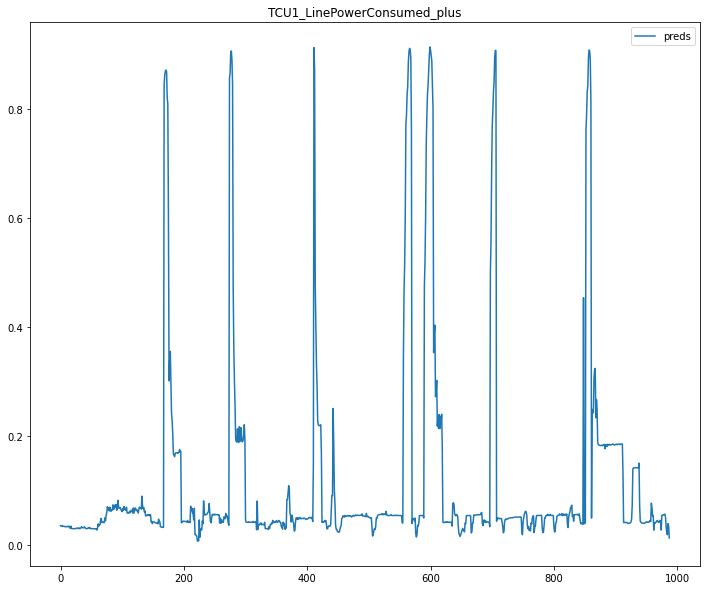

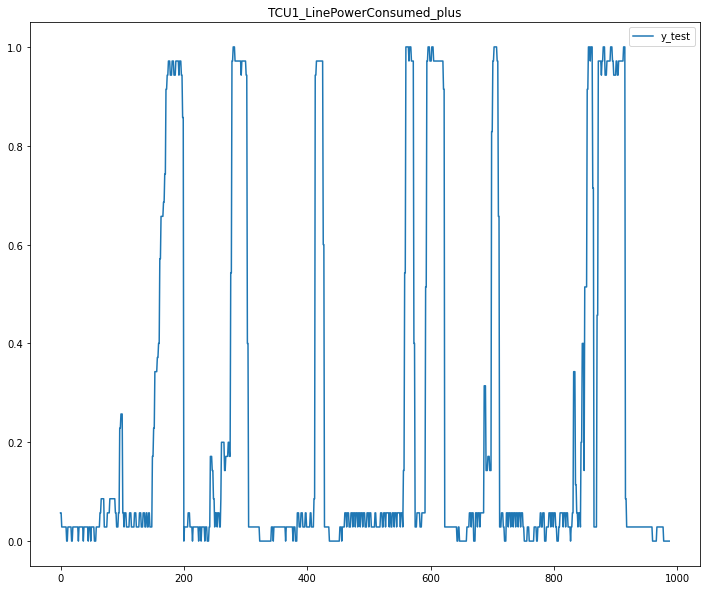

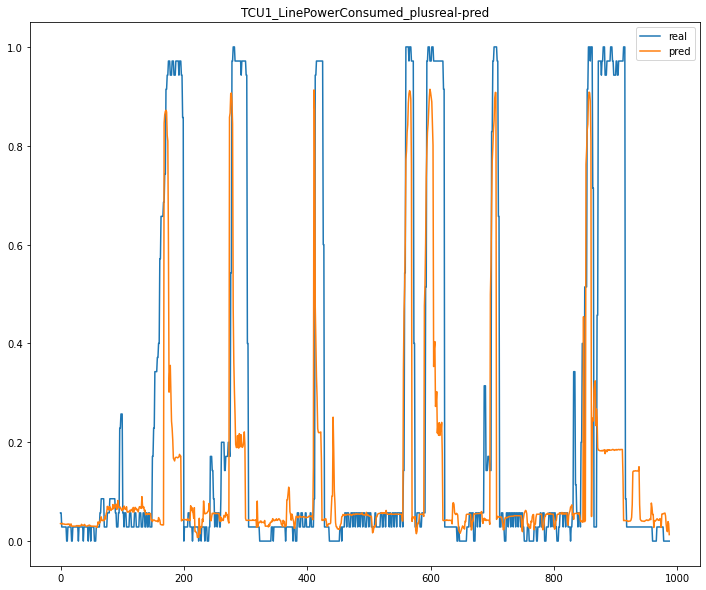

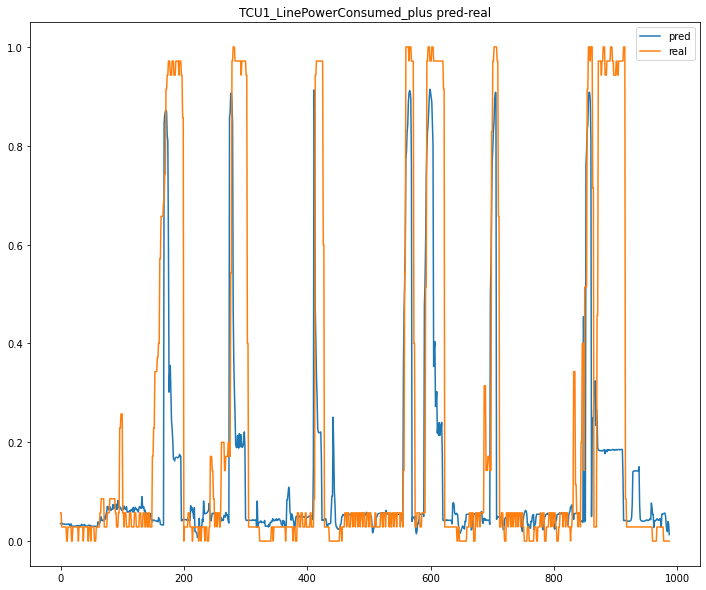

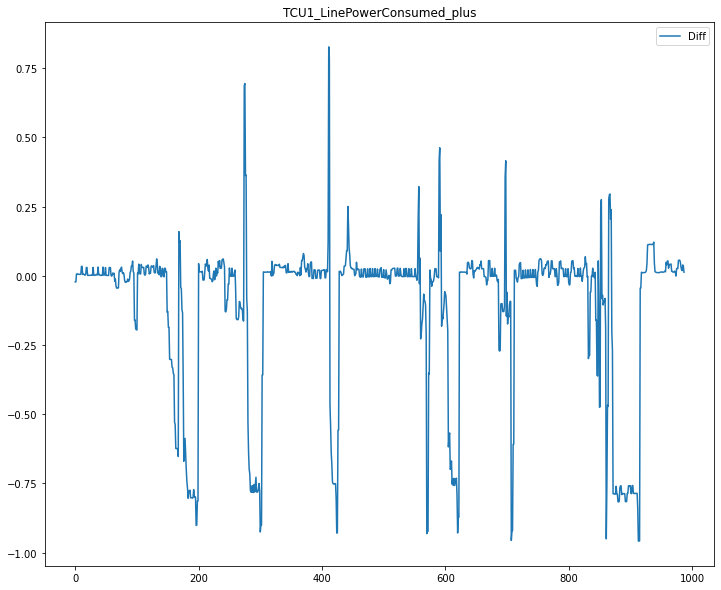

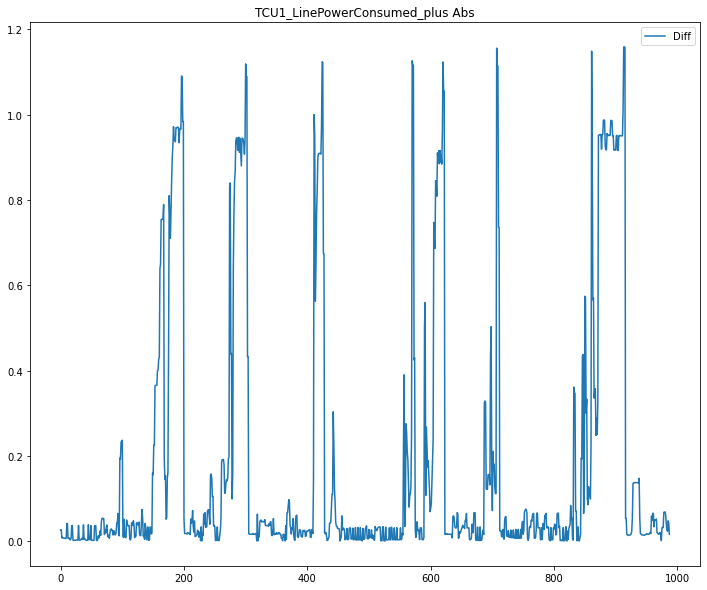

1 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 100, 'min_samples_split': 10}
Fold : 0/3
building tree 1 of 100
building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100building tree 13 of 100

building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100building tree 18 of 100

building tree 19 of 100
building tree 20 of 100
building tree 21 of 100building tree 22 of 100

building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100building tree 32 of 100

building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100building tree 38 o

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s



building tree 90 of 100

building tree 91 of 100
building tree 92 of 100
building tree 93 of 100
building tree 94 of 100
building tree 95 of 100
building tree 96 of 100
building tree 97 of 100
building tree 98 of 100building tree 99 of 100

building tree 100 of 100
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 7598166218.26%, std: 25225543259.89%


[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jo

CV Mean:  -4.528797650191951
STD:  8.262113021696006




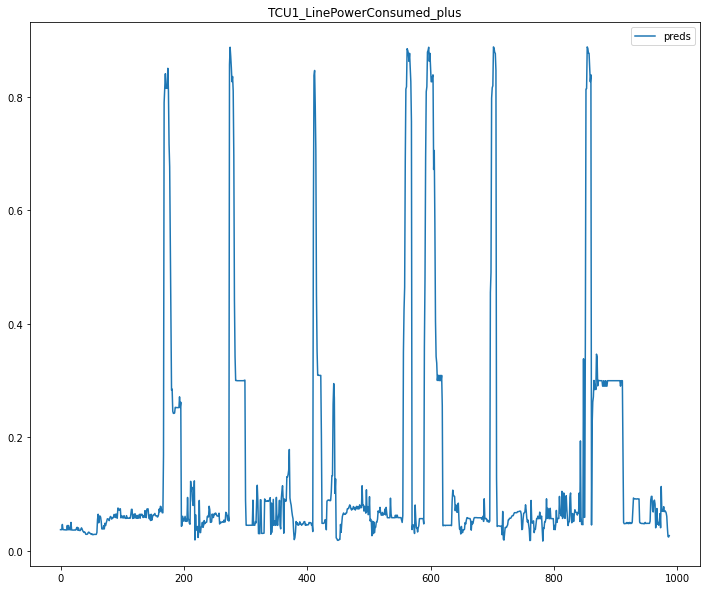

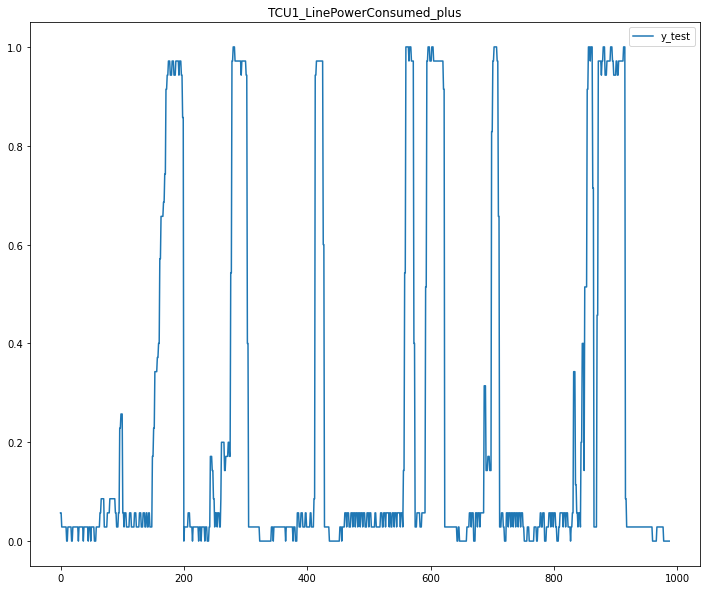

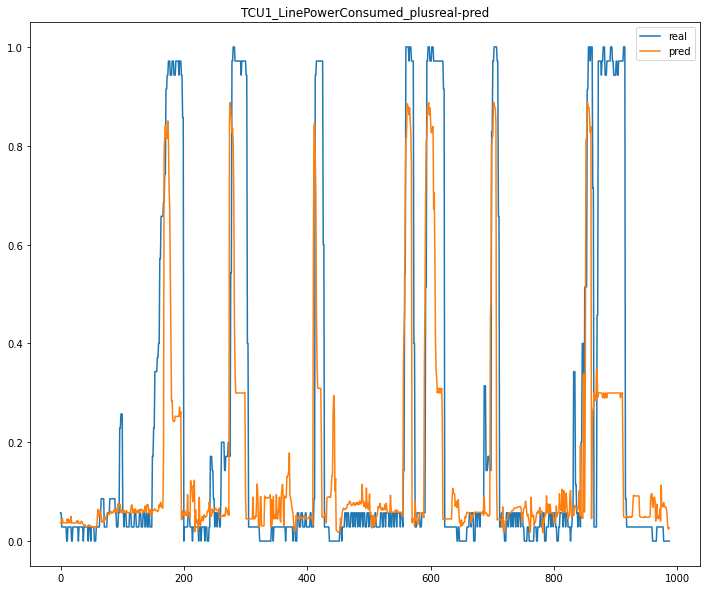

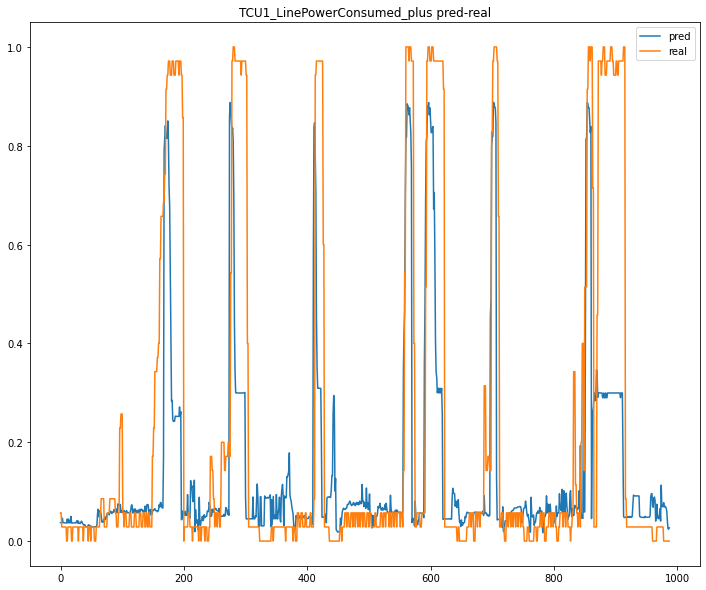

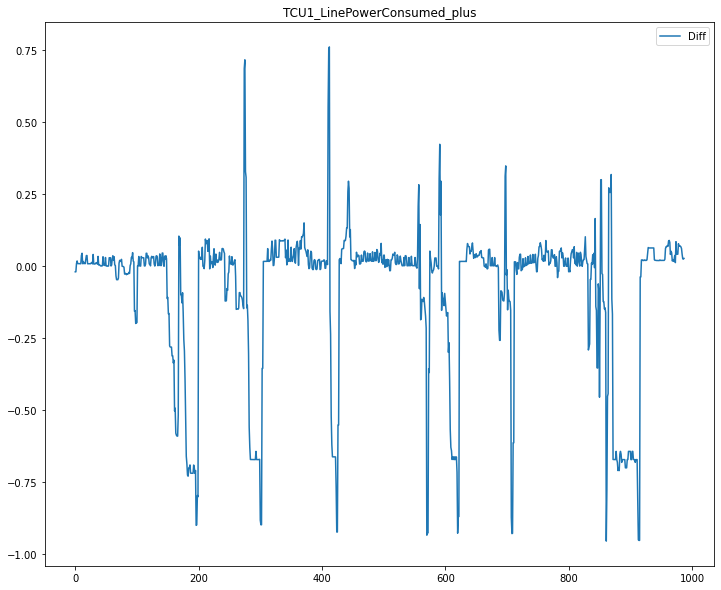

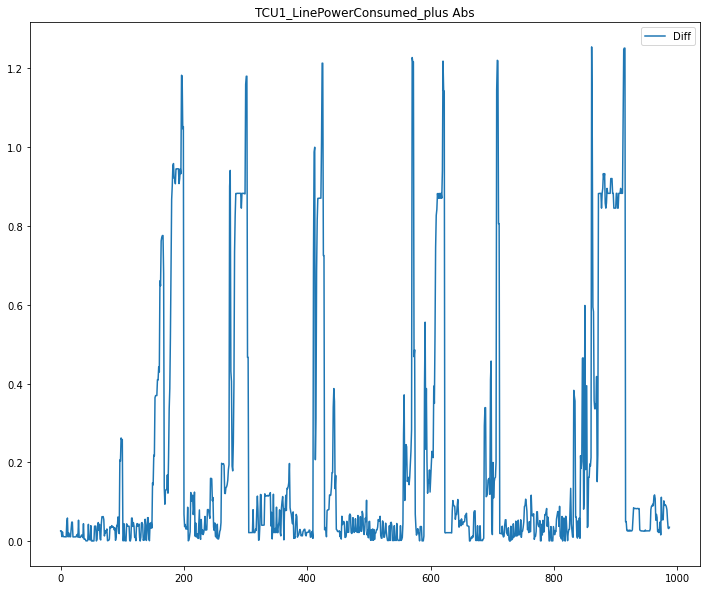

Fold : 1/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100
building tree 4 of 100
building tree 5 of 100

building tree 6 of 100building tree 7 of 100building tree 8 of 100


building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100building tree 14 of 100

building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100building tree 23 of 100

building tree 24 of 100
building tree 25 of 100
building tree 26 of 100building tree 27 of 100

building tree 28 of 100
building tree 29 of 100building tree 30 of 100

building tree 31 of 100building tree 32 of 100

building tree 33 of 100building tree 34 of 100

building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100building tree 39 of 100

building tree 40 of 100
building tree 41 of 100
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 7296281830.32%, std: 23562627753.34%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Pa

CV Mean:  -3.7514732649240843
STD:  6.620117308406368




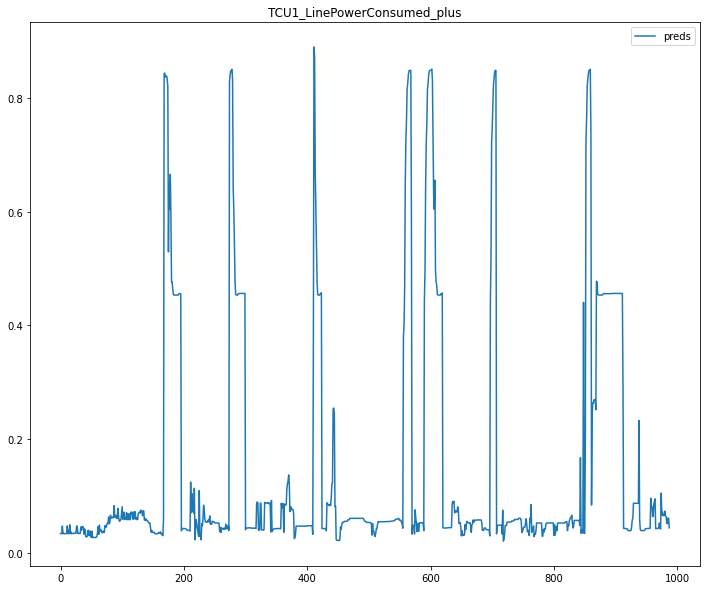

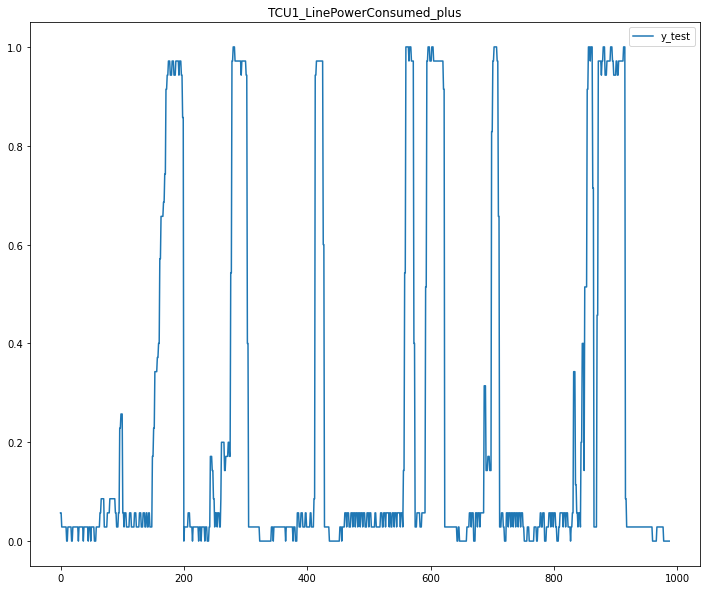

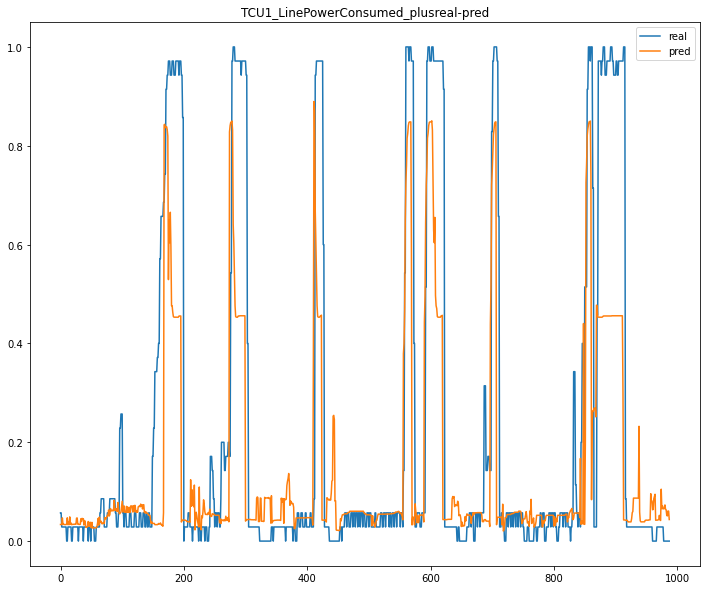

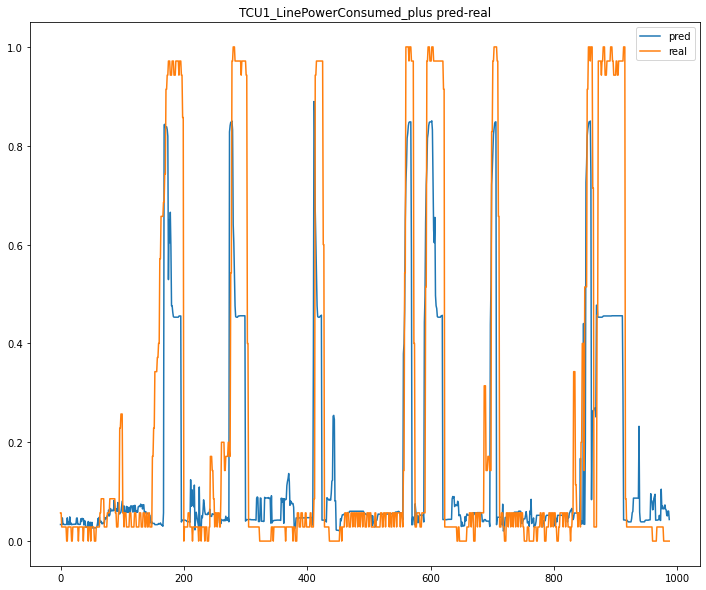

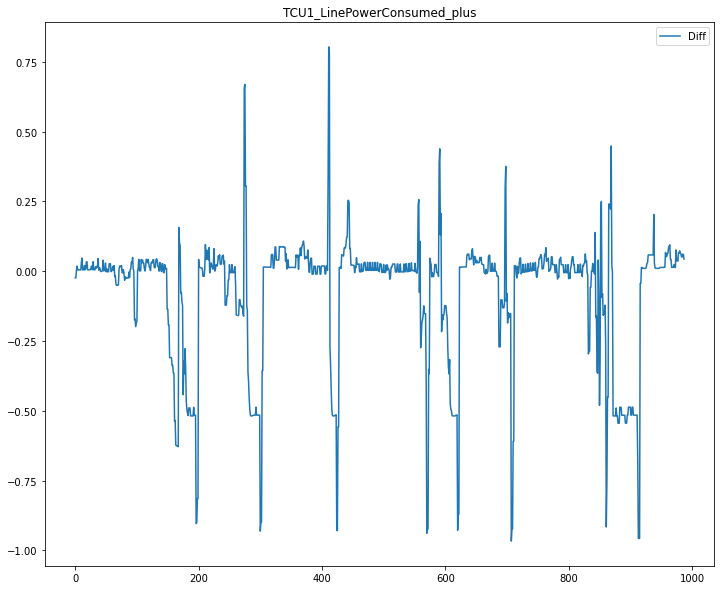

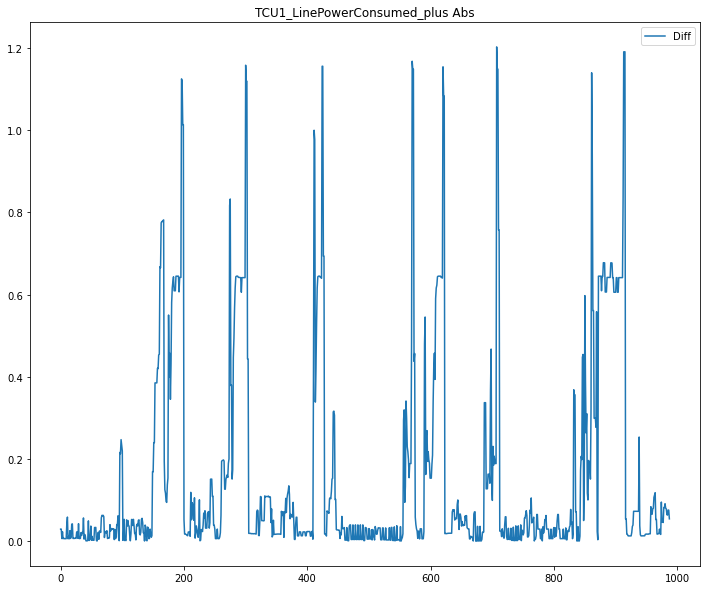

Fold : 2/3
building tree 1 of 100building tree 2 of 100

building tree 3 of 100
building tree 4 of 100building tree 5 of 100
building tree 6 of 100

building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100building tree 11 of 100

building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100building tree 20 of 100

building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100building tree 29 of 100

building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 of 100building tree 39 of 100

building tree 40 of 100
building tree 41 of 100
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


building tree 100 of 100
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5872091245.71%, std: 20288012085.86%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Pa

CV Mean:  -5.587211017920478
STD:  9.997007941834928




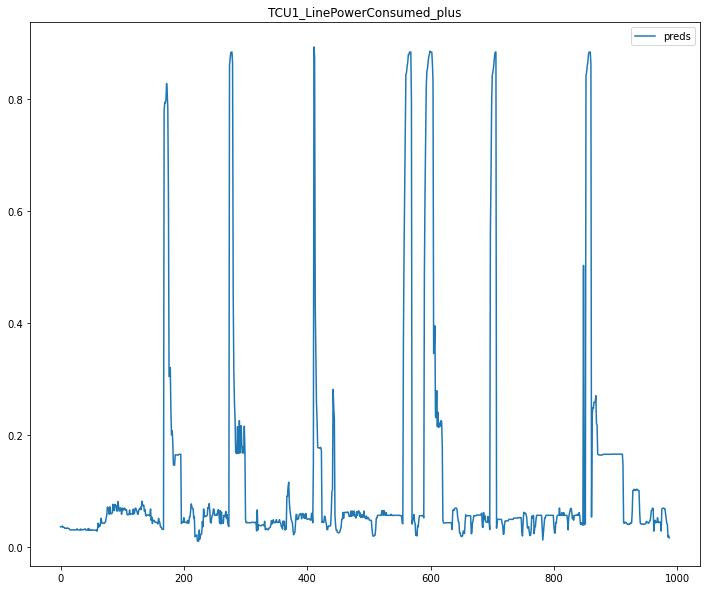

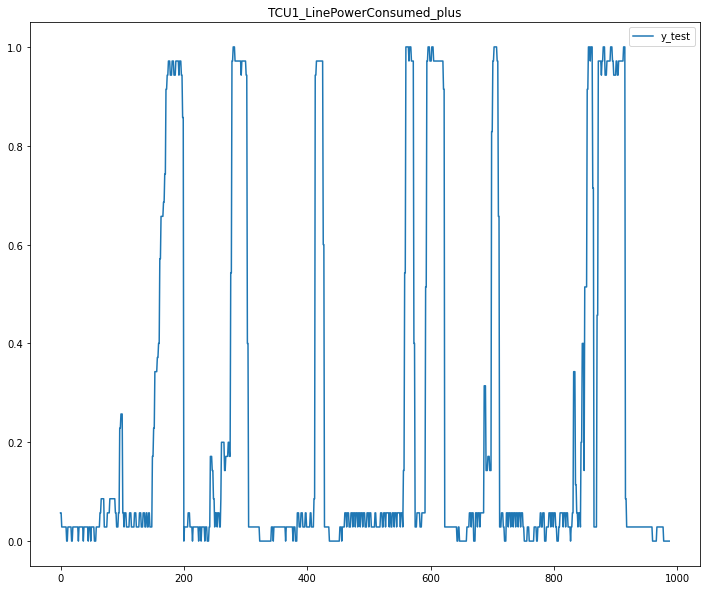

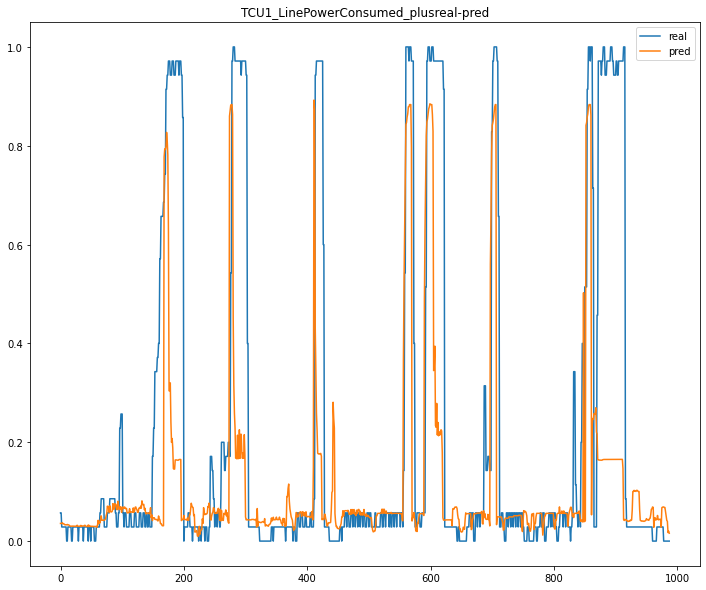

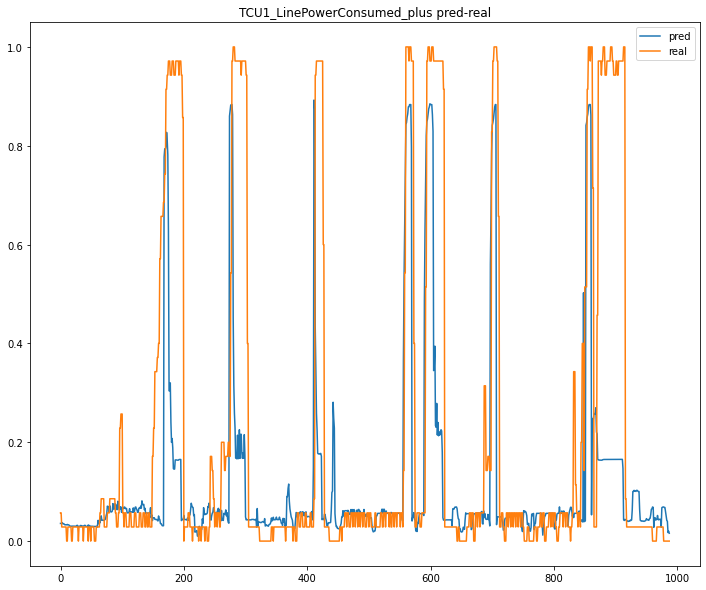

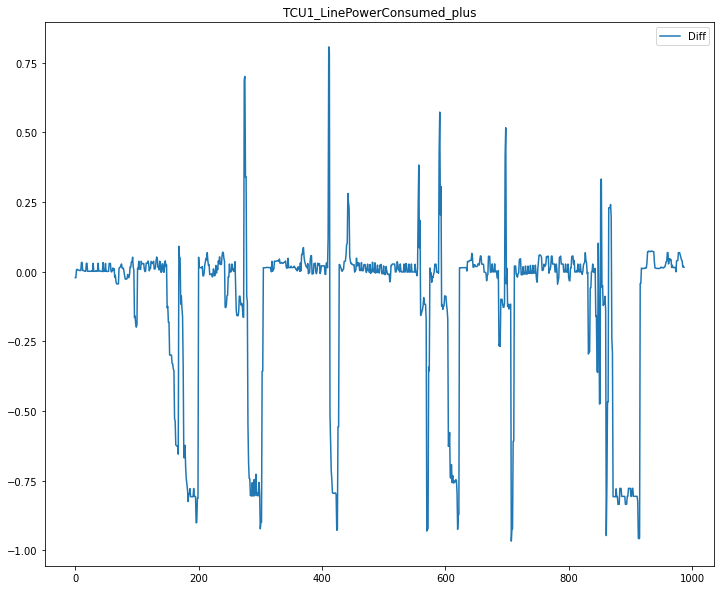

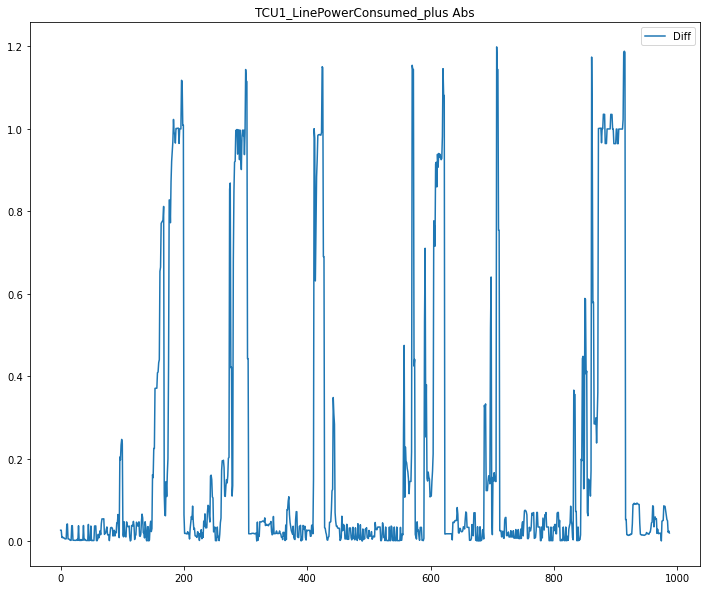

2 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 1000, 'min_samples_split': 20}
Fold : 0/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 1 of 1000
building tree 2 of 1000
building tree 3 of 1000
building tree 4 of 1000
building tree 5 of 1000building tree 6 of 1000

building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000
building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000
building tree 15 of 1000
building tree 16 of 1000
building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000building tree 20 of 1000

building tree 21 of 1000building tree 22 of 1000
building tree 23 of 1000

building tree 24 of 1000
building tree 25 of 1000
building tree 26 of 1000
building tree 27 of 1000
building tree 28 of 1000
building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000
building tree 32 of 1000
building tree 33 of 1000
building tree 34 of 1000building tree 35 of 1000

building tree 36 of 1000
building tree 37 of 1000
building tree 38 of 1000
building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 155 of 1000building tree 156 of 1000

building tree 157 of 1000
building tree 158 of 1000
building tree 159 of 1000
building tree 160 of 1000
building tree 161 of 1000building tree 162 of 1000

building tree 163 of 1000
building tree 164 of 1000
building tree 165 of 1000
building tree 166 of 1000
building tree 167 of 1000
building tree 168 of 1000
building tree 169 of 1000
building tree 170 of 1000
building tree 171 of 1000
building tree 172 of 1000
building tree 173 of 1000
building tree 174 of 1000
building tree 175 of 1000
building tree 176 of 1000building tree 177 of 1000
building tree 178 of 1000

building tree 179 of 1000
building tree 180 of 1000
building tree 181 of 1000
building tree 182 of 1000
building tree 183 of 1000
building tree 184 of 1000
building tree 185 of 1000
building tree 186 of 1000
building tree 187 of 1000
building tree 188 of 1000
building tree 189 of 1000
building tree 190 of 1000
building tree 191 of 1000
building tree 192 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 479 of 1000
building tree 480 of 1000
building tree 481 of 1000
building tree 482 of 1000building tree 483 of 1000

building tree 484 of 1000
building tree 485 of 1000
building tree 486 of 1000
building tree 487 of 1000
building tree 488 of 1000
building tree 489 of 1000
building tree 490 of 1000
building tree 491 of 1000
building tree 492 of 1000
building tree 493 of 1000
building tree 494 of 1000
building tree 495 of 1000
building tree 496 of 1000
building tree 497 of 1000building tree 498 of 1000

building tree 499 of 1000building tree 500 of 1000

building tree 501 of 1000building tree 502 of 1000

building tree 503 of 1000building tree 504 of 1000

building tree 505 of 1000
building tree 506 of 1000
building tree 507 of 1000
building tree 508 of 1000
building tree 509 of 1000
building tree 510 of 1000
building tree 511 of 1000
building tree 512 of 1000building tree 513 of 1000

building tree 514 of 1000
building tree 515 of 1000
building tree 516 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s



building tree 788 of 1000
building tree 789 of 1000
building tree 790 of 1000
building tree 791 of 1000
building tree 792 of 1000building tree 793 of 1000

building tree 794 of 1000
building tree 795 of 1000building tree 796 of 1000

building tree 797 of 1000
building tree 798 of 1000
building tree 799 of 1000
building tree 800 of 1000building tree 801 of 1000building tree 802 of 1000


building tree 803 of 1000
building tree 804 of 1000
building tree 805 of 1000
building tree 806 of 1000
building tree 807 of 1000
building tree 808 of 1000
building tree 809 of 1000
building tree 810 of 1000
building tree 811 of 1000
building tree 812 of 1000
building tree 813 of 1000
building tree 814 of 1000
building tree 815 of 1000building tree 816 of 1000

building tree 817 of 1000
building tree 818 of 1000
building tree 819 of 1000
building tree 820 of 1000
building tree 821 of 1000
building tree 822 of 1000
building tree 823 of 1000
building tree 824 of 1000building tree 825 of 1000

building tr

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 10182232862.79%, std: 33868385953.55%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 985 out of 1000 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | el

CV Mean:  -5.684389797743613
STD:  10.255284844284535




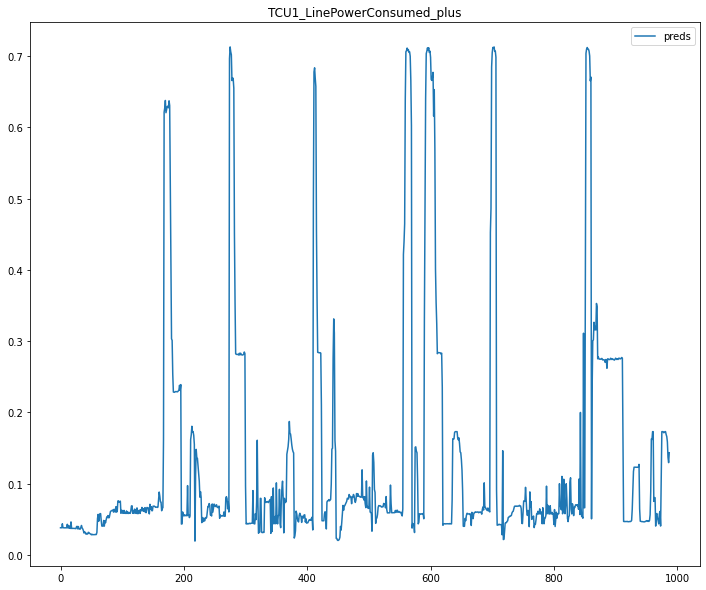

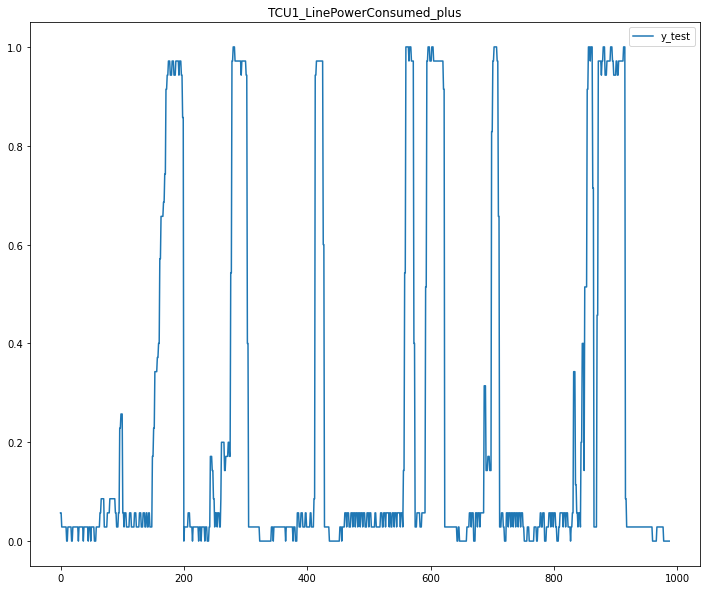

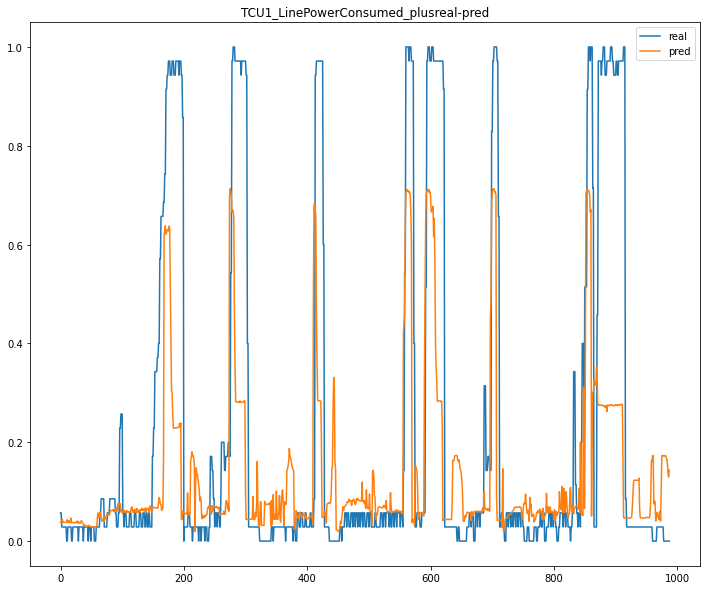

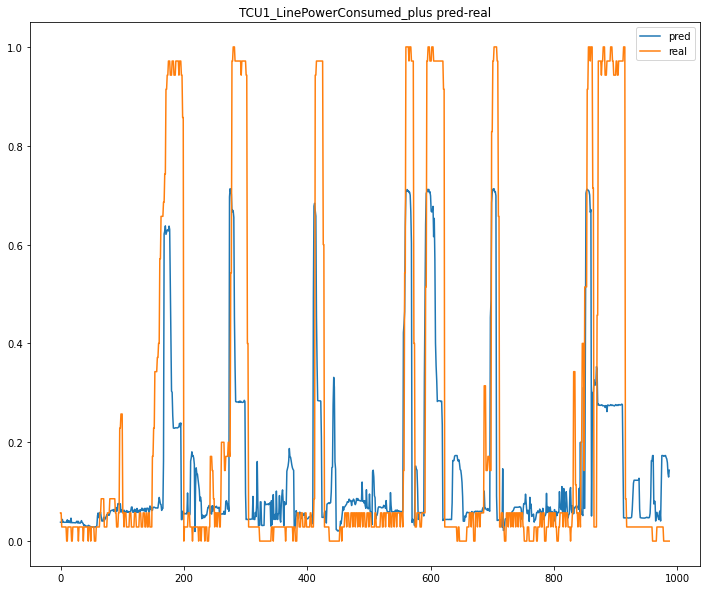

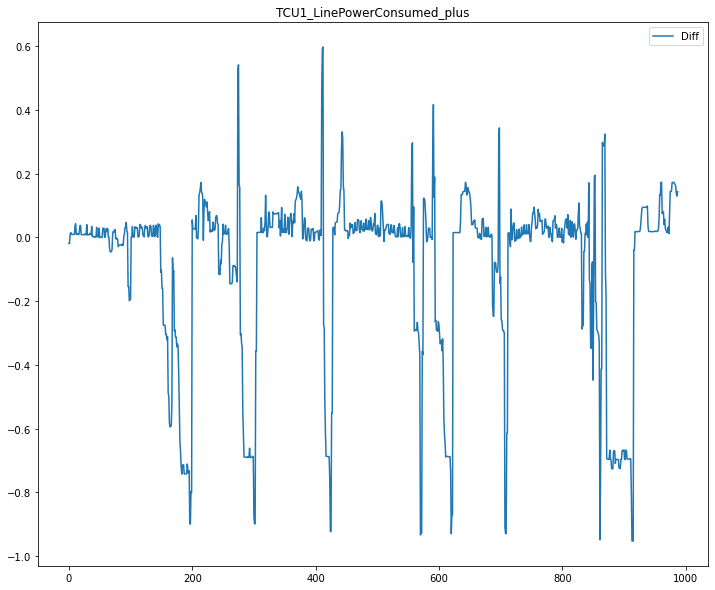

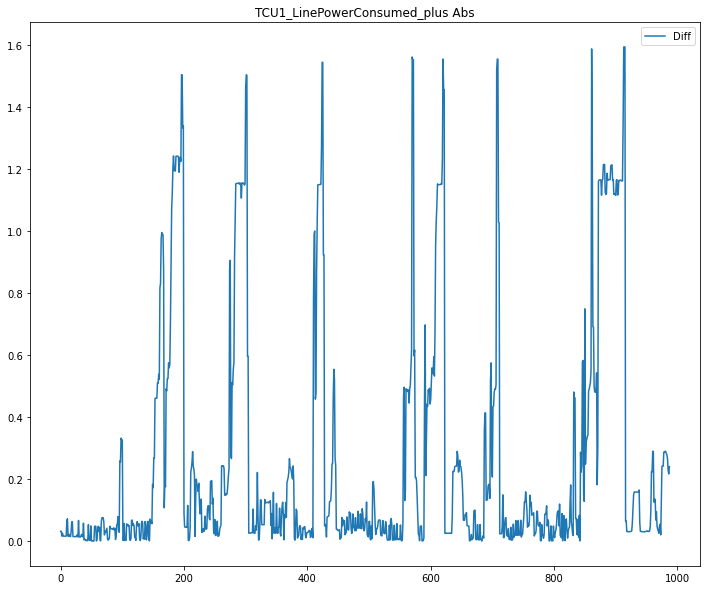

Fold : 1/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000

building tree 4 of 1000
building tree 5 of 1000
building tree 6 of 1000
building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000
building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000
building tree 15 of 1000building tree 16 of 1000

building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000
building tree 21 of 1000building tree 22 of 1000

building tree 23 of 1000
building tree 24 of 1000
building tree 25 of 1000building tree 26 of 1000

building tree 27 of 1000
building tree 28 of 1000building tree 29 of 1000building tree 30 of 1000


building tree 31 of 1000
building tree 32 of 1000
building tree 33 of 1000
building tree 34 of 1000
building tree 35 of 1000
building tree 36 of 1000
building tree 37 of 1000
building tree 38 of 1000
building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 155 of 1000building tree 156 of 1000building tree 157 of 1000


building tree 158 of 1000
building tree 159 of 1000
building tree 160 of 1000
building tree 161 of 1000
building tree 162 of 1000
building tree 163 of 1000
building tree 164 of 1000
building tree 165 of 1000
building tree 166 of 1000
building tree 167 of 1000
building tree 168 of 1000
building tree 169 of 1000building tree 170 of 1000

building tree 171 of 1000
building tree 172 of 1000
building tree 173 of 1000building tree 174 of 1000

building tree 175 of 1000
building tree 176 of 1000
building tree 177 of 1000
building tree 178 of 1000
building tree 179 of 1000
building tree 180 of 1000
building tree 181 of 1000
building tree 182 of 1000
building tree 183 of 1000
building tree 184 of 1000
building tree 185 of 1000
building tree 186 of 1000
building tree 187 of 1000
building tree 188 of 1000building tree 189 of 1000

building tree 190 of 1000
building tree 191 of 1000
building tree 192 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 490 of 1000
building tree 491 of 1000
building tree 492 of 1000
building tree 493 of 1000building tree 494 of 1000
building tree 495 of 1000

building tree 496 of 1000
building tree 497 of 1000
building tree 498 of 1000
building tree 499 of 1000
building tree 500 of 1000building tree 501 of 1000building tree 502 of 1000

building tree 503 of 1000

building tree 504 of 1000
building tree 505 of 1000
building tree 506 of 1000
building tree 507 of 1000building tree 508 of 1000

building tree 509 of 1000building tree 510 of 1000

building tree 511 of 1000
building tree 512 of 1000
building tree 513 of 1000
building tree 514 of 1000
building tree 515 of 1000
building tree 516 of 1000
building tree 517 of 1000
building tree 518 of 1000
building tree 519 of 1000building tree 520 of 1000

building tree 521 of 1000
building tree 522 of 1000
building tree 523 of 1000building tree 524 of 1000

building tree 525 of 1000
building tree 526 of 1000
building tree 527 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s



building tree 800 of 1000
building tree 801 of 1000
building tree 802 of 1000
building tree 803 of 1000
building tree 804 of 1000building tree 805 of 1000
building tree 806 of 1000building tree 807 of 1000


building tree 808 of 1000
building tree 809 of 1000
building tree 810 of 1000
building tree 811 of 1000
building tree 812 of 1000
building tree 813 of 1000
building tree 814 of 1000
building tree 815 of 1000
building tree 816 of 1000building tree 817 of 1000

building tree 818 of 1000building tree 819 of 1000
building tree 820 of 1000
building tree 821 of 1000
building tree 822 of 1000

building tree 823 of 1000
building tree 824 of 1000building tree 825 of 1000

building tree 826 of 1000
building tree 827 of 1000building tree 828 of 1000

building tree 829 of 1000
building tree 830 of 1000building tree 831 of 1000

building tree 832 of 1000
building tree 833 of 1000
building tree 834 of 1000
building tree 835 of 1000
building tree 836 of 1000building tree 837 of 1000

building tr

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 9738122900.15%, std: 33260789026.92%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -3.963817987494673
STD:  6.050291263789705




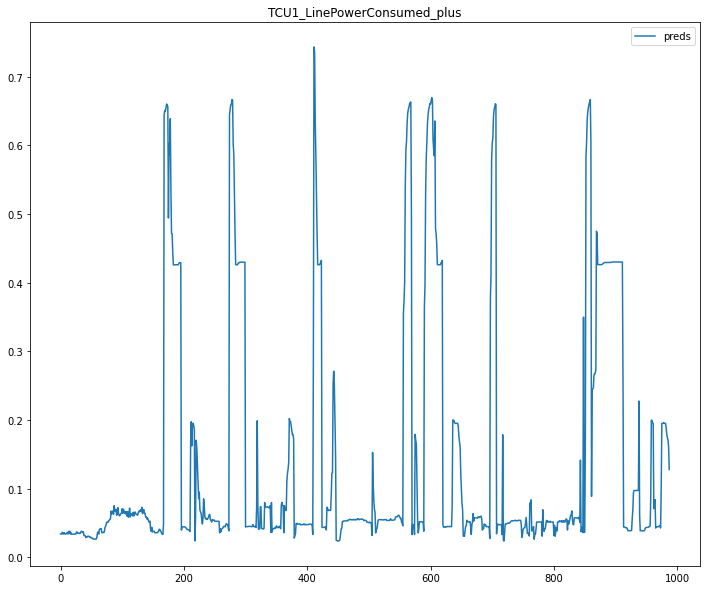

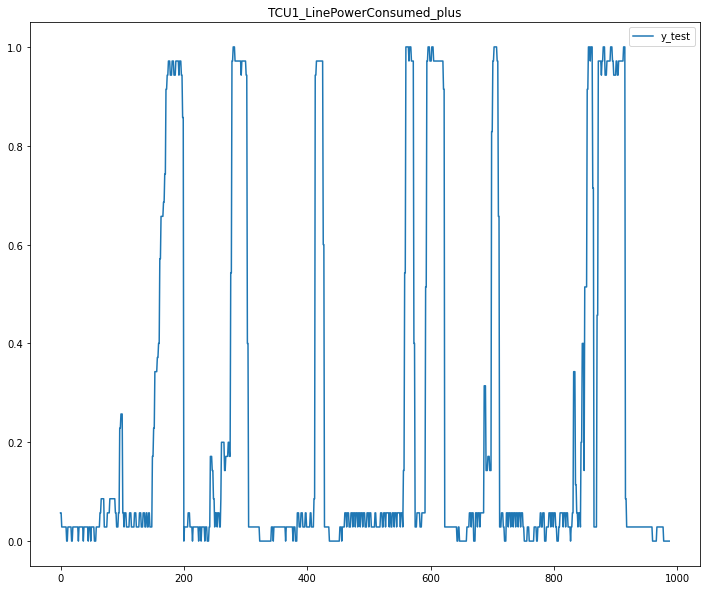

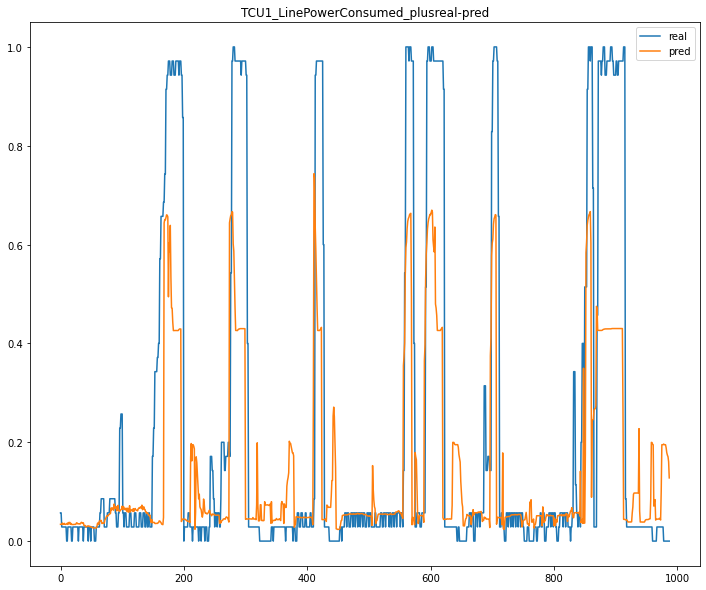

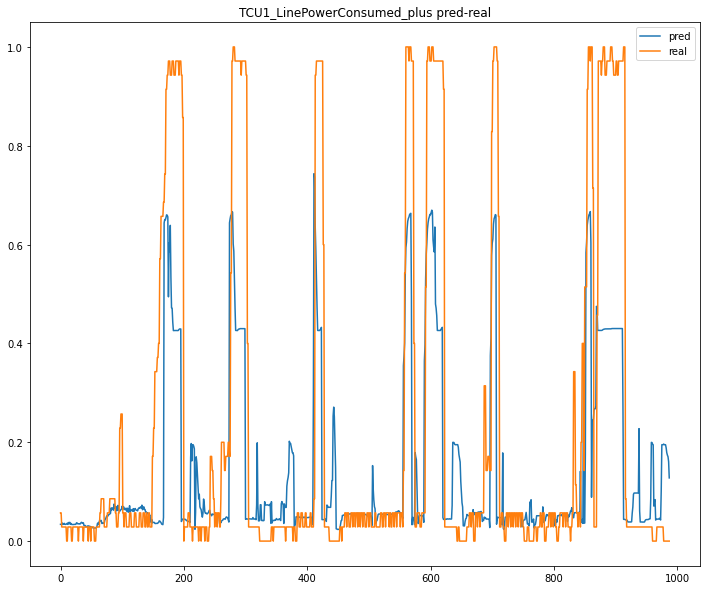

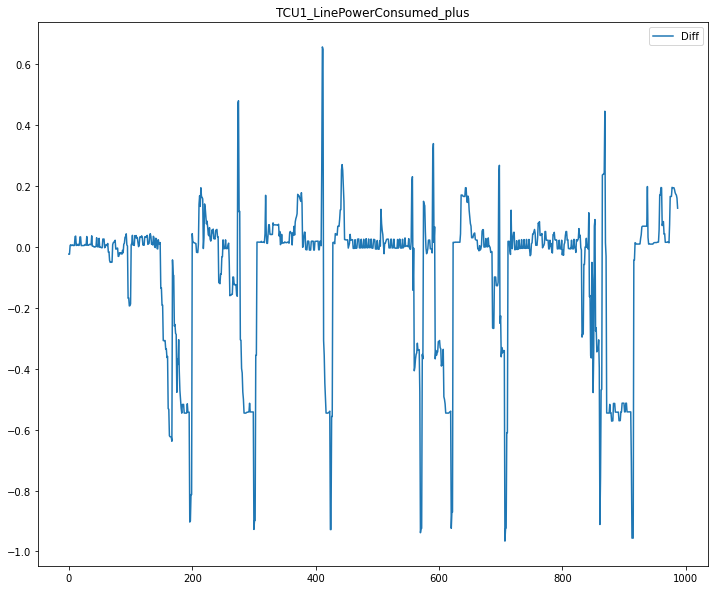

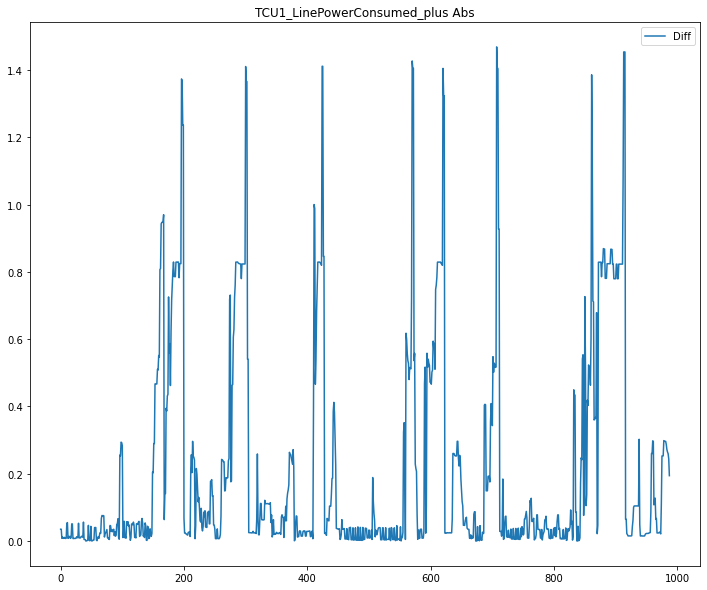

Fold : 2/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000
building tree 4 of 1000
building tree 5 of 1000
building tree 6 of 1000

building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000
building tree 11 of 1000building tree 12 of 1000

building tree 13 of 1000
building tree 14 of 1000
building tree 15 of 1000
building tree 16 of 1000
building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000
building tree 21 of 1000building tree 22 of 1000

building tree 23 of 1000building tree 24 of 1000

building tree 25 of 1000
building tree 26 of 1000
building tree 27 of 1000
building tree 28 of 1000
building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000building tree 32 of 1000

building tree 33 of 1000
building tree 34 of 1000
building tree 35 of 1000building tree 36 of 1000

building tree 37 of 1000
building tree 38 of 1000building tree 39 of 1000

building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 308 of 1000
building tree 309 of 1000
building tree 310 of 1000
building tree 311 of 1000
building tree 312 of 1000
building tree 313 of 1000
building tree 314 of 1000
building tree 315 of 1000building tree 316 of 1000

building tree 317 of 1000
building tree 318 of 1000
building tree 319 of 1000
building tree 320 of 1000
building tree 321 of 1000building tree 322 of 1000

building tree 323 of 1000building tree 324 of 1000
building tree 325 of 1000

building tree 326 of 1000
building tree 327 of 1000
building tree 328 of 1000
building tree 329 of 1000building tree 330 of 1000
building tree 331 of 1000building tree 332 of 1000


building tree 333 of 1000
building tree 334 of 1000
building tree 335 of 1000building tree 336 of 1000

building tree 337 of 1000
building tree 338 of 1000
building tree 339 of 1000building tree 340 of 1000
building tree 341 of 1000

building tree 342 of 1000
building tree 343 of 1000
building tree 344 of 1000
building tree 345 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 454 of 1000
building tree 455 of 1000building tree 456 of 1000

building tree 457 of 1000
building tree 458 of 1000building tree 459 of 1000

building tree 460 of 1000
building tree 461 of 1000
building tree 462 of 1000
building tree 463 of 1000
building tree 464 of 1000
building tree 465 of 1000building tree 466 of 1000

building tree 467 of 1000
building tree 468 of 1000
building tree 469 of 1000building tree 470 of 1000

building tree 471 of 1000
building tree 472 of 1000
building tree 473 of 1000
building tree 474 of 1000
building tree 475 of 1000
building tree 476 of 1000building tree 477 of 1000

building tree 478 of 1000
building tree 479 of 1000
building tree 480 of 1000building tree 481 of 1000

building tree 482 of 1000
building tree 483 of 1000building tree 484 of 1000

building tree 485 of 1000
building tree 486 of 1000building tree 487 of 1000

building tree 488 of 1000
building tree 489 of 1000
building tree 490 of 1000
building tree 491 of 1000building tree

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s



building tree 774 of 1000
building tree 775 of 1000
building tree 776 of 1000
building tree 777 of 1000
building tree 778 of 1000
building tree 779 of 1000
building tree 780 of 1000
building tree 781 of 1000
building tree 782 of 1000building tree 783 of 1000

building tree 784 of 1000
building tree 785 of 1000
building tree 786 of 1000building tree 787 of 1000

building tree 788 of 1000
building tree 789 of 1000building tree 790 of 1000

building tree 791 of 1000building tree 792 of 1000building tree 793 of 1000


building tree 794 of 1000
building tree 795 of 1000building tree 796 of 1000building tree 797 of 1000


building tree 798 of 1000
building tree 799 of 1000
building tree 800 of 1000
building tree 801 of 1000
building tree 802 of 1000building tree 803 of 1000building tree 804 of 1000


building tree 805 of 1000
building tree 806 of 1000building tree 807 of 1000

building tree 808 of 1000
building tree 809 of 1000
building tree 810 of 1000building tree 811 of 1000

building tr

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6345745388.45%, std: 20631746543.62%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -5.411056547068733
STD:  8.70745080600436




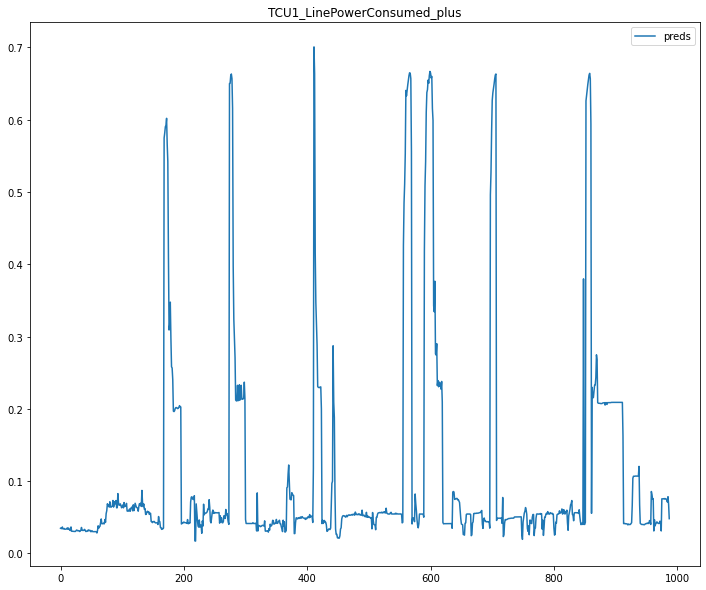

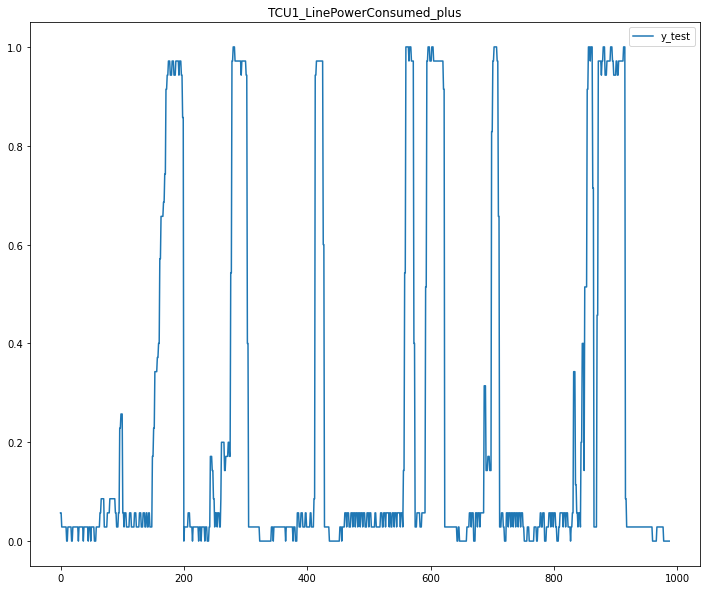

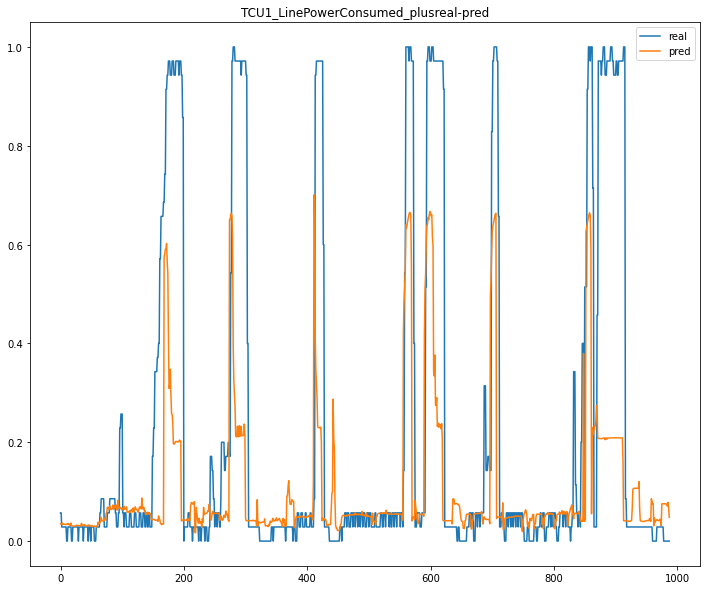

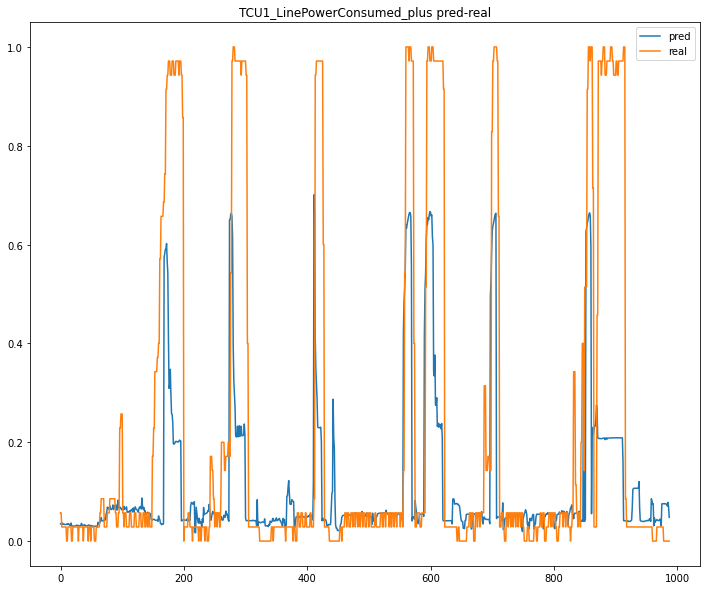

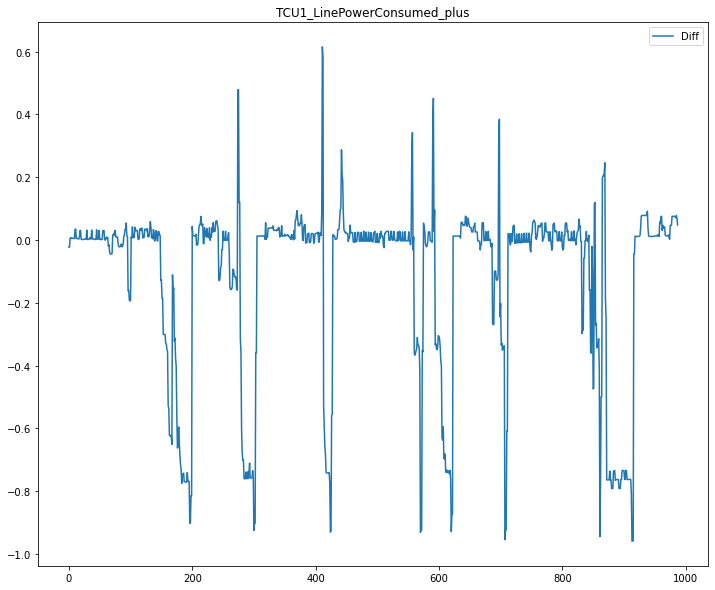

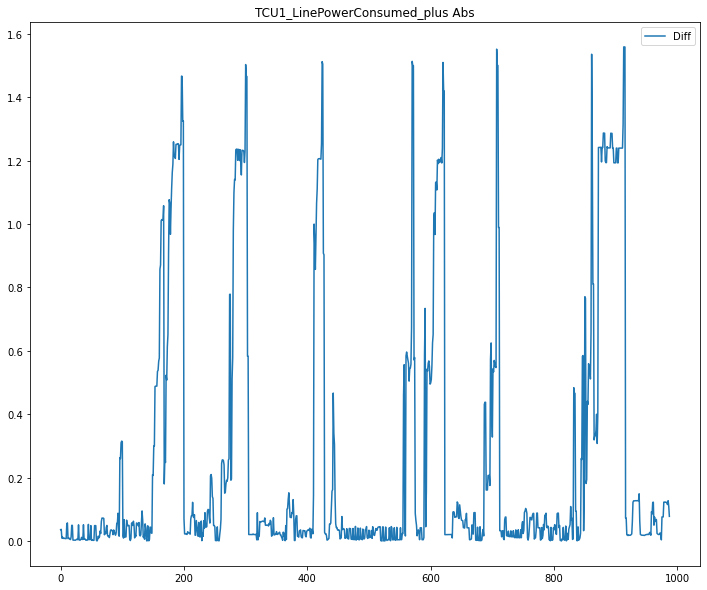

3 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 500, 'min_samples_split': 2}
Fold : 0/3
building tree 1 of 500
building tree 2 of 500building tree 3 of 500
building tree 4 of 500

building tree 5 of 500
building tree 6 of 500
building tree 7 of 500
building tree 8 of 500
building tree 9 of 500
building tree 10 of 500
building tree 11 of 500building tree 12 of 500
building tree 13 of 500

building tree 14 of 500
building tree 15 of 500
building tree 16 of 500
building tree 17 of 500building tree 18 of 500

building tree 19 of 500
building tree 20 of 500building tree 21 of 500
building tree 22 of 500
building tree 23 of 500

building tree 24 of 500
building tree 25 of 500
building tree 26 of 500
building tree 27 of 500
building tree 28 of 500
building tree 29 of 500building tree 30 of 500
building tree 31 of 500

building tree 32 of 500
building tree 33 of 500
building tree 34 of 500
building tree 35 of 500
building tree 36 of 500
building tree 37 of 500building tree 38 of

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 49 of 500
building tree 50 of 500
building tree 51 of 500
building tree 52 of 500
building tree 53 of 500building tree 54 of 500

building tree 55 of 500
building tree 56 of 500
building tree 57 of 500
building tree 58 of 500
building tree 59 of 500
building tree 60 of 500
building tree 61 of 500
building tree 62 of 500building tree 63 of 500

building tree 64 of 500
building tree 65 of 500
building tree 66 of 500
building tree 67 of 500
building tree 68 of 500
building tree 69 of 500
building tree 70 of 500
building tree 71 of 500building tree 72 of 500

building tree 73 of 500
building tree 74 of 500
building tree 75 of 500
building tree 76 of 500
building tree 77 of 500
building tree 78 of 500
building tree 79 of 500building tree 80 of 500

building tree 81 of 500
building tree 82 of 500building tree 83 of 500

building tree 84 of 500
building tree 85 of 500building tree 86 of 500

building tree 87 of 500building tree 88 of 500

building tree 89 of 500
building tree 90

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s



building tree 198 of 500
building tree 199 of 500
building tree 200 of 500
building tree 201 of 500
building tree 202 of 500
building tree 203 of 500
building tree 204 of 500building tree 205 of 500building tree 206 of 500


building tree 207 of 500building tree 208 of 500

building tree 209 of 500
building tree 210 of 500
building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500
building tree 215 of 500
building tree 216 of 500
building tree 217 of 500
building tree 218 of 500
building tree 219 of 500
building tree 220 of 500
building tree 221 of 500
building tree 222 of 500building tree 223 of 500

building tree 224 of 500
building tree 225 of 500
building tree 226 of 500
building tree 227 of 500
building tree 228 of 500
building tree 229 of 500
building tree 230 of 500building tree 231 of 500

building tree 232 of 500
building tree 233 of 500
building tree 234 of 500
building tree 235 of 500
building tree 236 of 500
building tree 237 of 500

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 499 of 500building tree 500 of 500

TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6354017698.40%, std: 19417869484.31%


[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 

CV Mean:  -2.1034539580775142
STD:  3.882952712241699




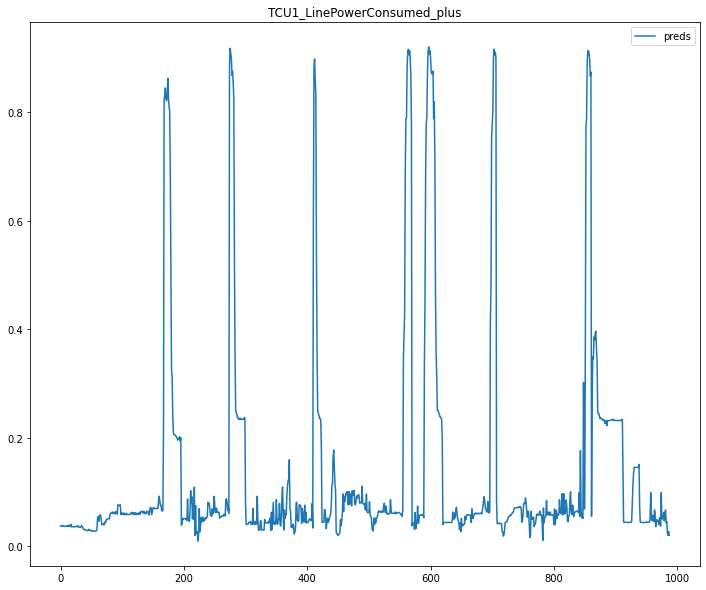

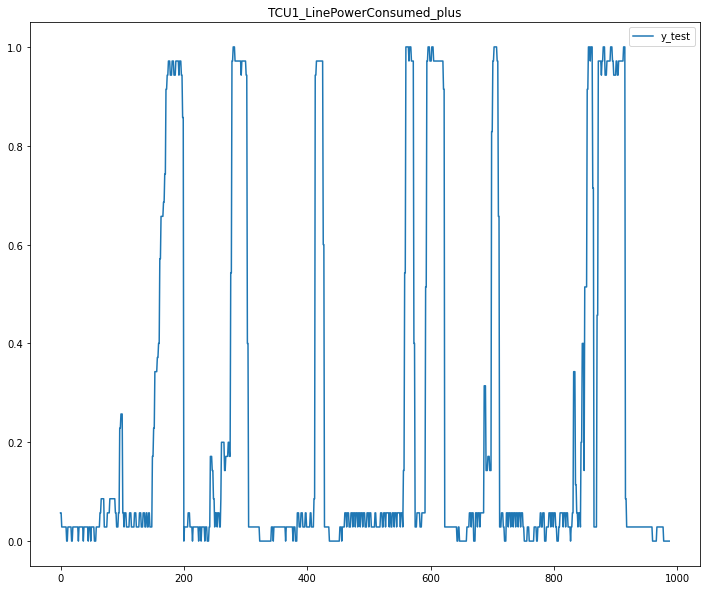

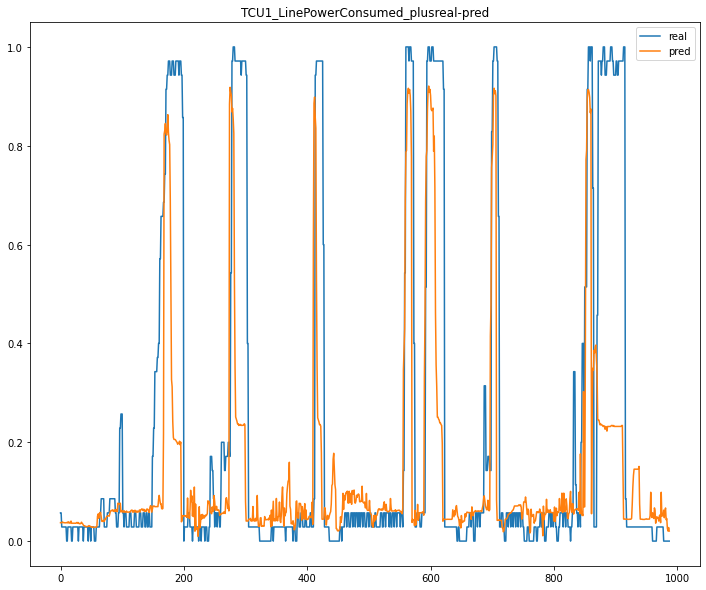

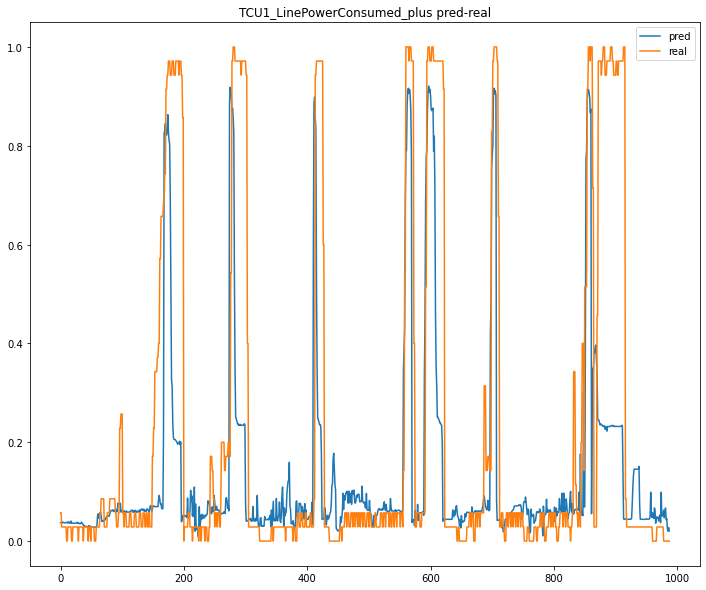

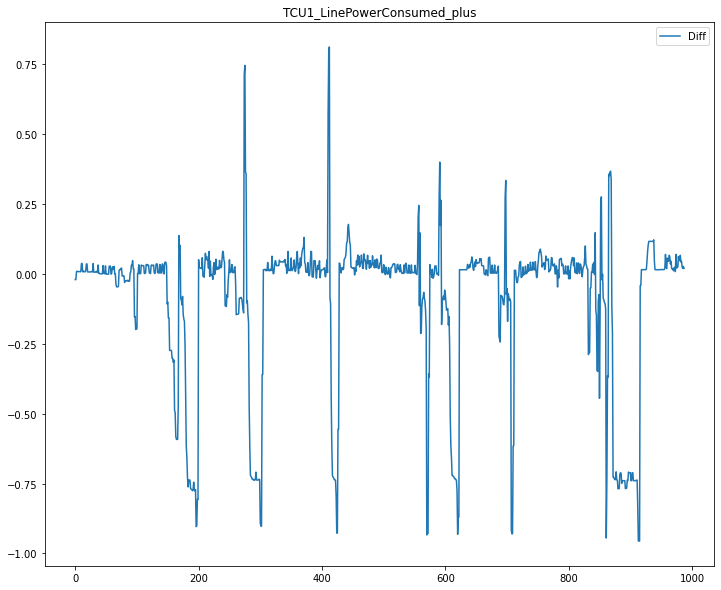

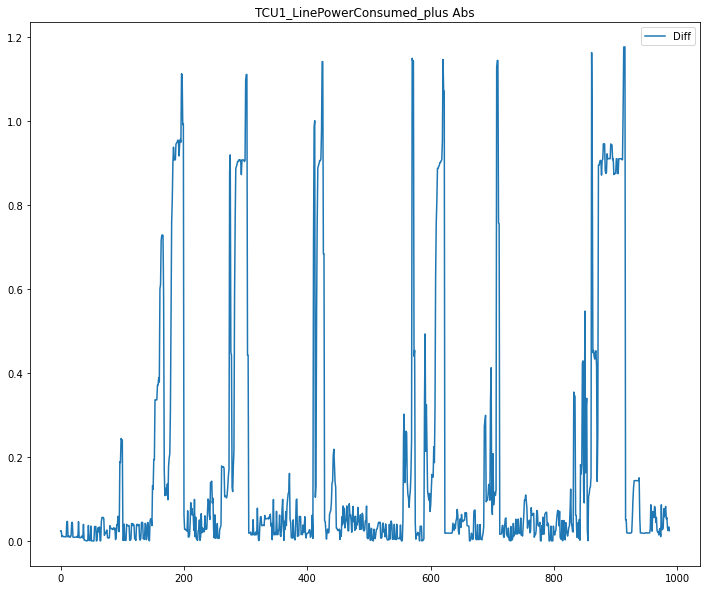

Fold : 1/3
building tree 1 of 500building tree 2 of 500

building tree 3 of 500
building tree 4 of 500
building tree 5 of 500
building tree 6 of 500building tree 7 of 500

building tree 8 of 500
building tree 9 of 500
building tree 10 of 500
building tree 11 of 500
building tree 12 of 500building tree 13 of 500

building tree 14 of 500
building tree 15 of 500
building tree 16 of 500building tree 17 of 500

building tree 18 of 500
building tree 19 of 500
building tree 20 of 500
building tree 21 of 500
building tree 22 of 500
building tree 23 of 500building tree 24 of 500

building tree 25 of 500
building tree 26 of 500
building tree 27 of 500
building tree 28 of 500
building tree 29 of 500
building tree 30 of 500
building tree 31 of 500
building tree 32 of 500
building tree 33 of 500
building tree 34 of 500
building tree 35 of 500
building tree 36 of 500
building tree 37 of 500
building tree 38 of 500
building tree 39 of 500
building tree 40 of 500building tree 41 of 500

building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 48 of 500
building tree 49 of 500
building tree 50 of 500
building tree 51 of 500
building tree 52 of 500
building tree 53 of 500
building tree 54 of 500
building tree 55 of 500
building tree 56 of 500building tree 57 of 500
building tree 58 of 500

building tree 59 of 500
building tree 60 of 500
building tree 61 of 500
building tree 62 of 500
building tree 63 of 500
building tree 64 of 500
building tree 65 of 500building tree 66 of 500

building tree 67 of 500building tree 68 of 500

building tree 69 of 500
building tree 70 of 500
building tree 71 of 500building tree 72 of 500
building tree 73 of 500

building tree 74 of 500
building tree 75 of 500
building tree 76 of 500building tree 77 of 500

building tree 78 of 500
building tree 79 of 500
building tree 80 of 500building tree 81 of 500

building tree 82 of 500
building tree 83 of 500
building tree 84 of 500
building tree 85 of 500
building tree 86 of 500building tree 87 of 500
building tree 88 of 500
building tree 89 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s



building tree 178 of 500
building tree 179 of 500building tree 180 of 500
building tree 181 of 500
building tree 182 of 500

building tree 183 of 500
building tree 184 of 500
building tree 185 of 500
building tree 186 of 500building tree 187 of 500

building tree 188 of 500
building tree 189 of 500
building tree 190 of 500
building tree 191 of 500
building tree 192 of 500
building tree 193 of 500
building tree 194 of 500
building tree 195 of 500
building tree 196 of 500
building tree 197 of 500
building tree 198 of 500
building tree 199 of 500building tree 200 of 500

building tree 201 of 500
building tree 202 of 500
building tree 203 of 500
building tree 204 of 500
building tree 205 of 500
building tree 206 of 500
building tree 207 of 500
building tree 208 of 500
building tree 209 of 500building tree 210 of 500

building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500
building tree 215 of 500building tree 216 of 500

building tree 217 of 500

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s



building tree 478 of 500
building tree 479 of 500
building tree 480 of 500
building tree 481 of 500
building tree 482 of 500
building tree 483 of 500
building tree 484 of 500
building tree 485 of 500
building tree 486 of 500
building tree 487 of 500
building tree 488 of 500
building tree 489 of 500
building tree 490 of 500building tree 491 of 500

building tree 492 of 500
building tree 493 of 500
building tree 494 of 500
building tree 495 of 500
building tree 496 of 500
building tree 497 of 500
building tree 498 of 500
building tree 499 of 500
building tree 500 of 500
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6148612647.93%, std: 21446373388.54%


[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks  

CV Mean:  -3.2451361796372185
STD:  5.344447023955542




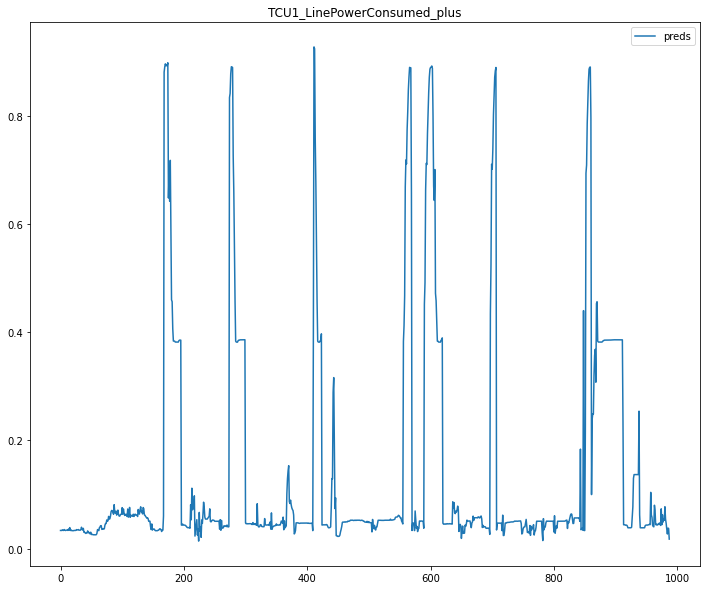

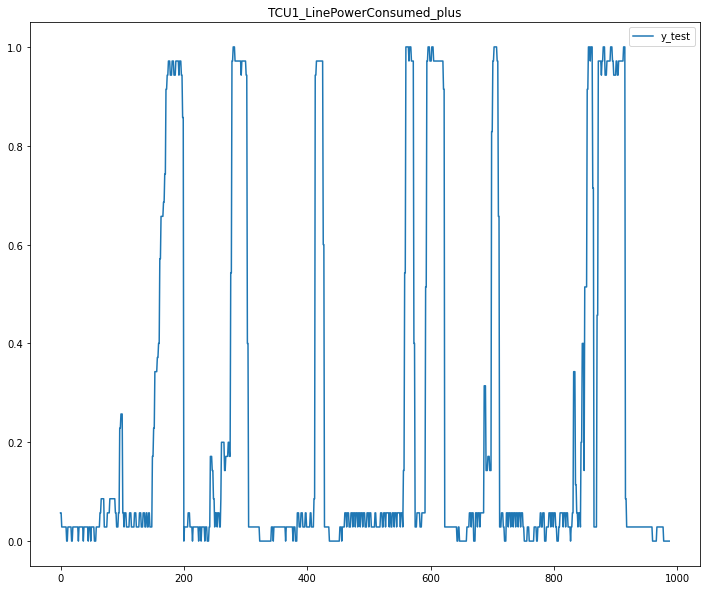

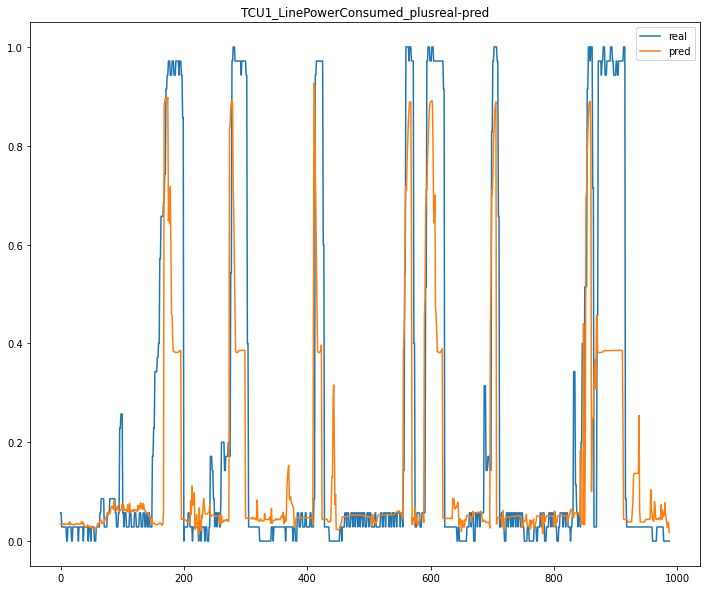

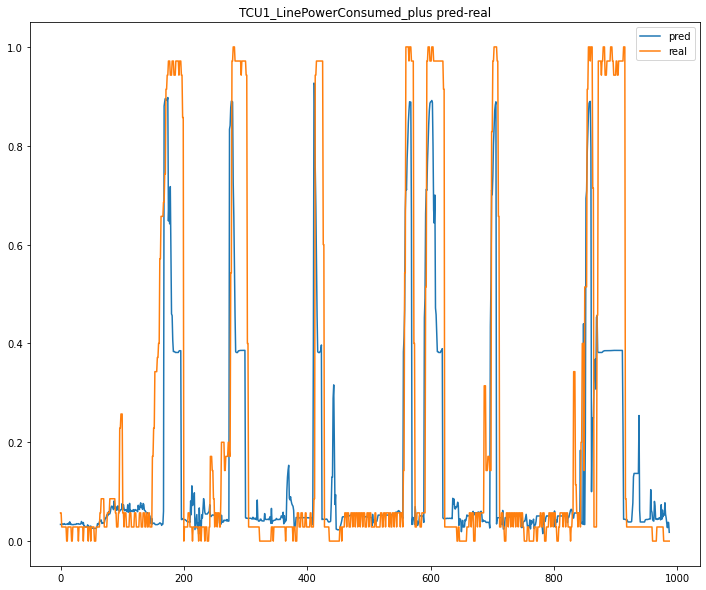

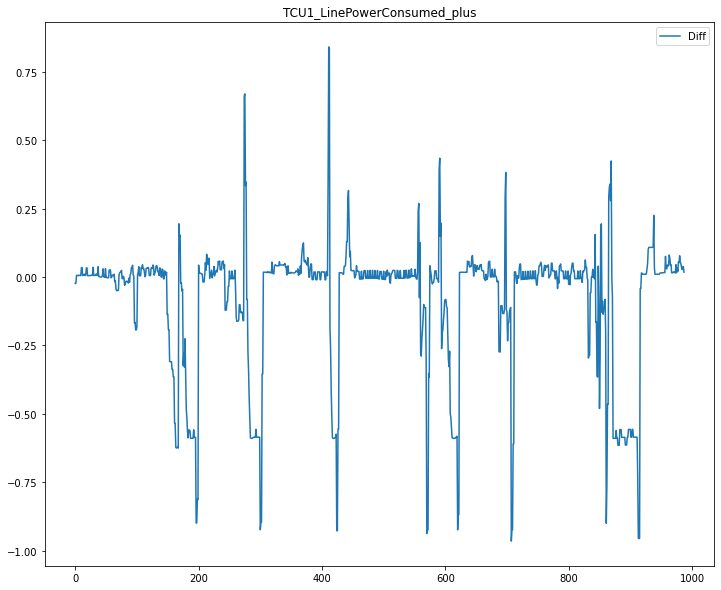

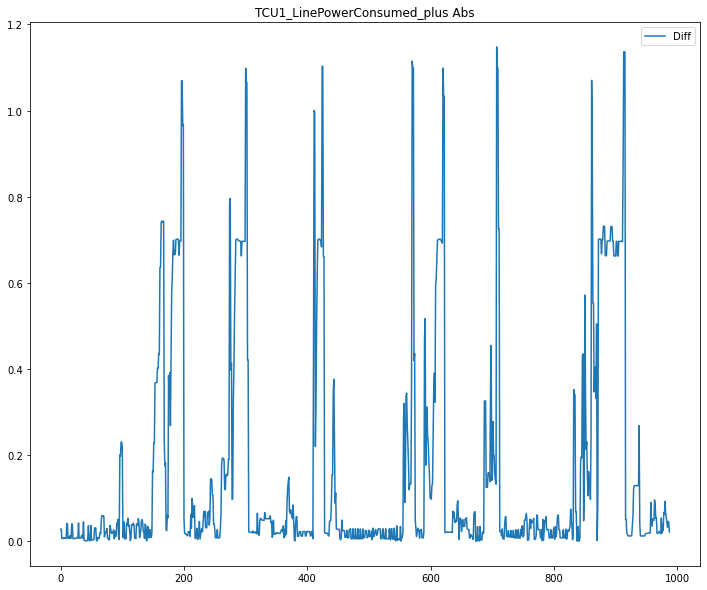

Fold : 2/3
building tree 1 of 500building tree 2 of 500
building tree 3 of 500

building tree 4 of 500
building tree 5 of 500
building tree 6 of 500
building tree 7 of 500building tree 8 of 500

building tree 9 of 500
building tree 10 of 500
building tree 11 of 500
building tree 12 of 500building tree 13 of 500

building tree 14 of 500
building tree 15 of 500building tree 16 of 500
building tree 17 of 500

building tree 18 of 500building tree 19 of 500

building tree 20 of 500building tree 21 of 500

building tree 22 of 500
building tree 23 of 500building tree 24 of 500

building tree 25 of 500
building tree 26 of 500
building tree 27 of 500
building tree 28 of 500building tree 29 of 500building tree 30 of 500


building tree 31 of 500
building tree 32 of 500
building tree 33 of 500
building tree 34 of 500


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s


building tree 35 of 500
building tree 36 of 500
building tree 37 of 500
building tree 38 of 500
building tree 39 of 500
building tree 40 of 500
building tree 41 of 500
building tree 42 of 500
building tree 43 of 500
building tree 44 of 500building tree 45 of 500

building tree 46 of 500
building tree 47 of 500
building tree 48 of 500
building tree 49 of 500
building tree 50 of 500
building tree 51 of 500
building tree 52 of 500
building tree 53 of 500
building tree 54 of 500
building tree 55 of 500
building tree 56 of 500
building tree 57 of 500building tree 58 of 500

building tree 59 of 500
building tree 60 of 500
building tree 61 of 500
building tree 62 of 500
building tree 63 of 500building tree 64 of 500

building tree 65 of 500
building tree 66 of 500
building tree 67 of 500
building tree 68 of 500
building tree 69 of 500
building tree 70 of 500
building tree 71 of 500
building tree 72 of 500
building tree 73 of 500
building tree 74 of 500building tree 75 of 500building tree 76 o

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 192 of 500
building tree 193 of 500
building tree 194 of 500
building tree 195 of 500building tree 196 of 500

building tree 197 of 500
building tree 198 of 500
building tree 199 of 500building tree 200 of 500

building tree 201 of 500
building tree 202 of 500
building tree 203 of 500
building tree 204 of 500
building tree 205 of 500
building tree 206 of 500building tree 207 of 500

building tree 208 of 500
building tree 209 of 500building tree 210 of 500

building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500building tree 215 of 500

building tree 216 of 500
building tree 217 of 500
building tree 218 of 500
building tree 219 of 500
building tree 220 of 500building tree 221 of 500

building tree 222 of 500
building tree 223 of 500
building tree 224 of 500
building tree 225 of 500
building tree 226 of 500
building tree 227 of 500
building tree 228 of 500
building tree 229 of 500building tree 230 of 500

building tree 231 of 500b

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s



building tree 491 of 500
building tree 492 of 500
building tree 493 of 500
building tree 494 of 500building tree 495 of 500
building tree 496 of 500

building tree 497 of 500
building tree 498 of 500
building tree 499 of 500building tree 500 of 500

TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5363717548.78%, std: 17229899687.57%


[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 

CV Mean:  -2.6893766644794654
STD:  4.18892594686216




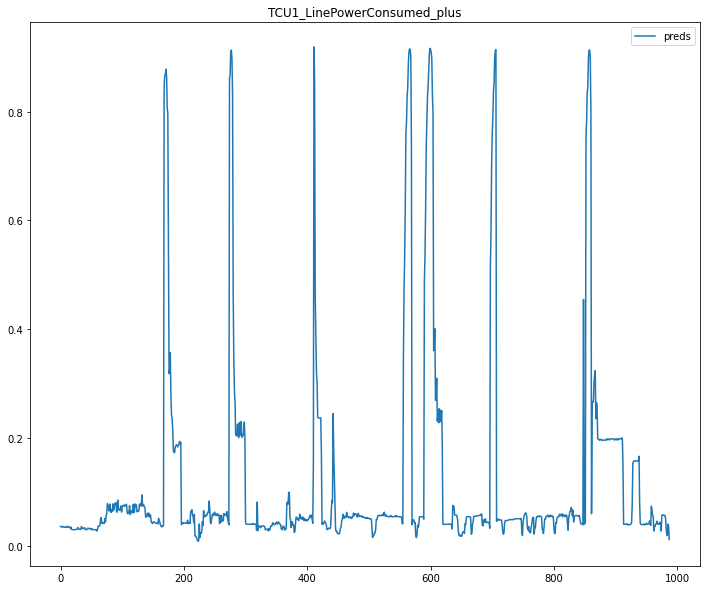

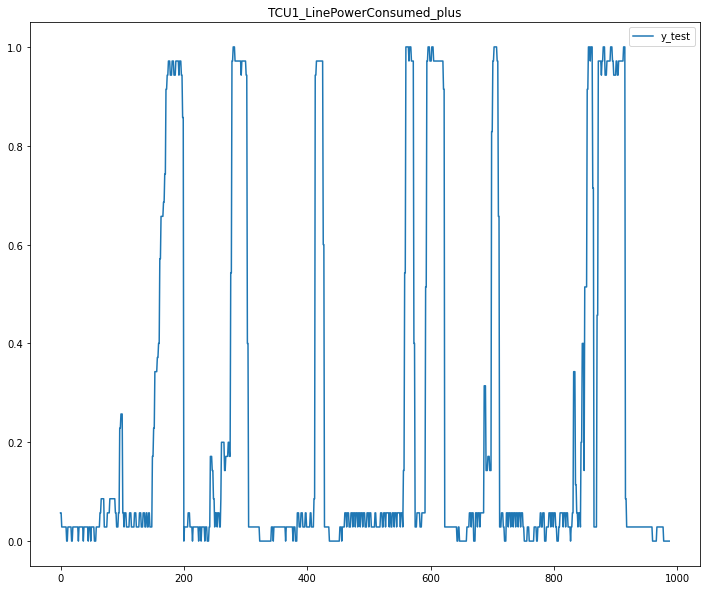

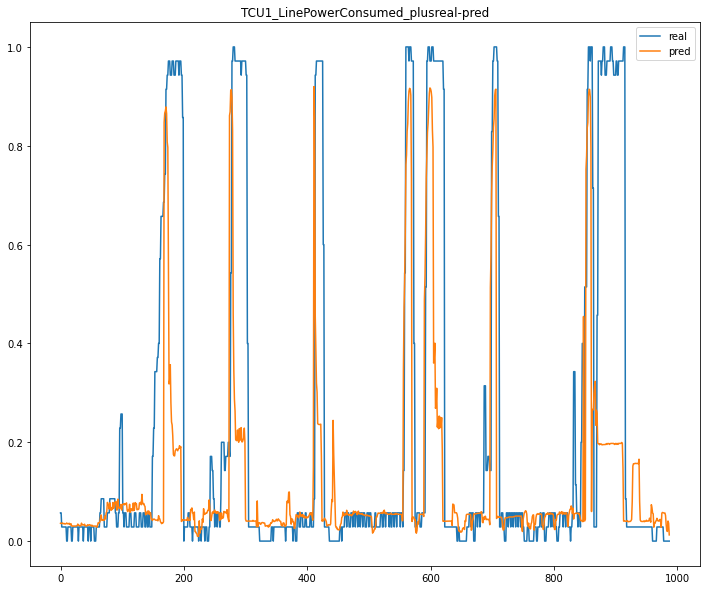

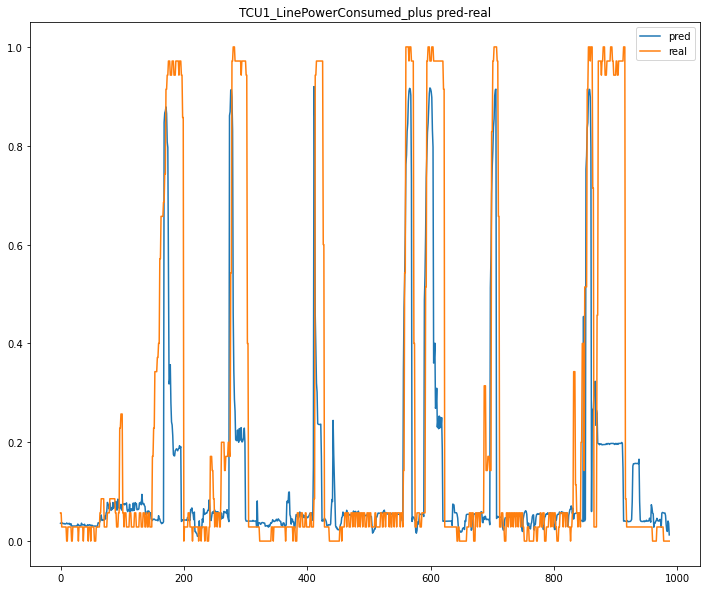

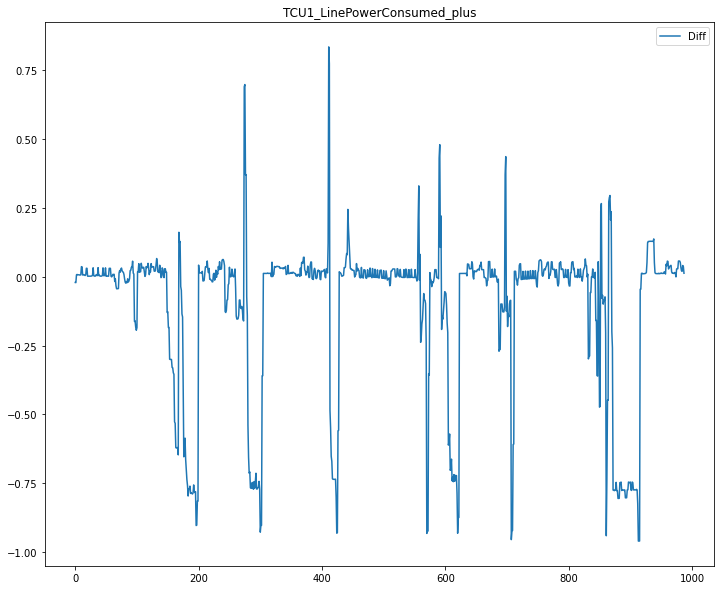

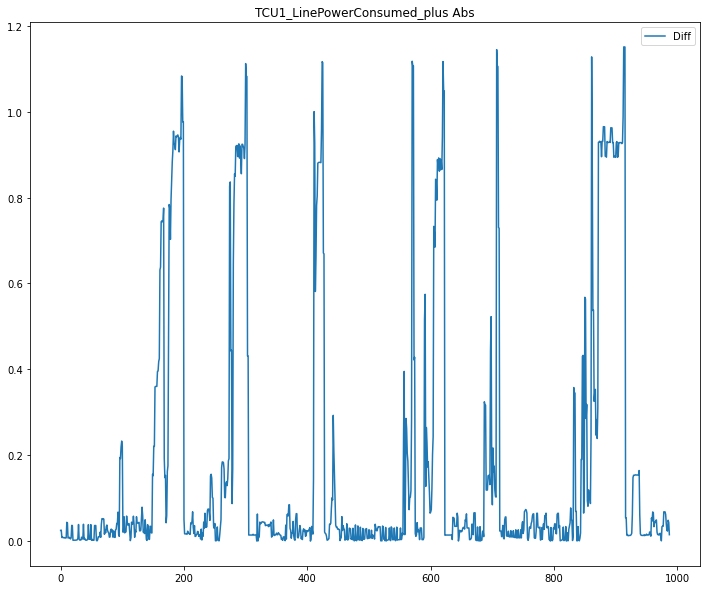

4 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 100, 'min_samples_split': 20}
Fold : 0/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100

building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100building tree 14 of 100
building tree 15 of 100

building tree 16 of 100
building tree 17 of 100
building tree 18 of 100building tree 19 of 100

building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100building tree 36 of 100
building tree 37 of 100

building tree 38 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 10074397572.30%, std: 32773558981.46%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Pa

CV Mean:  -5.613350318969724
STD:  10.114426029931714




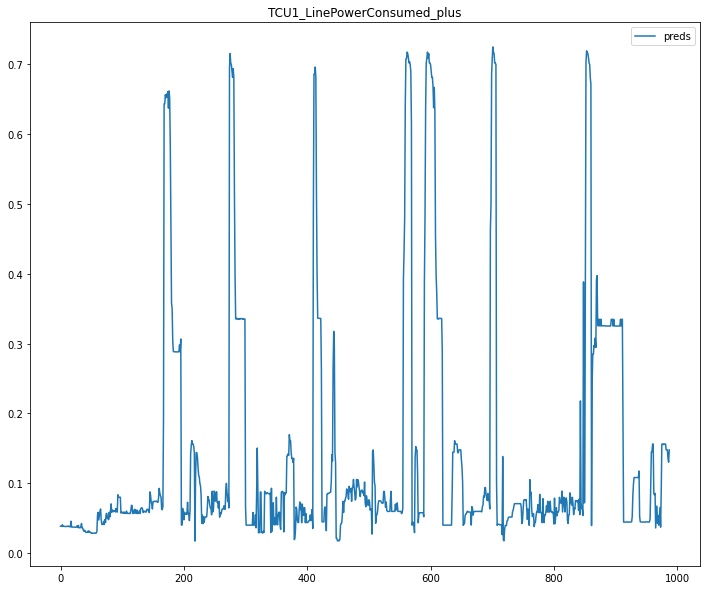

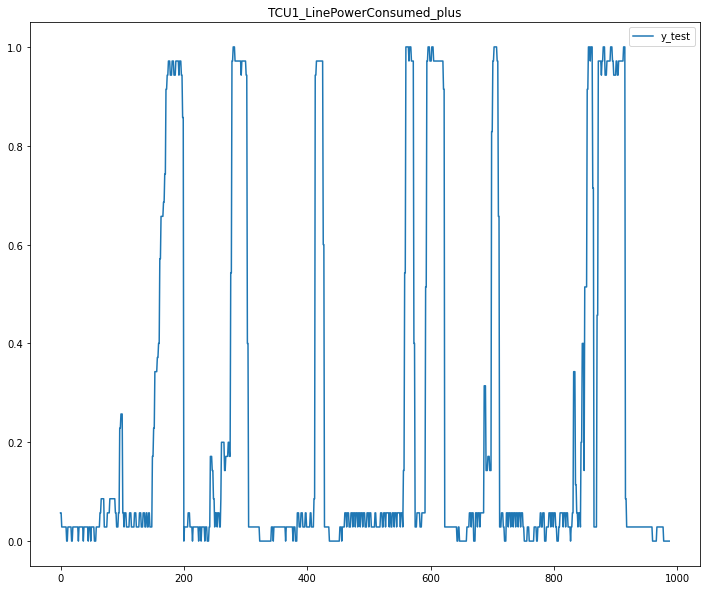

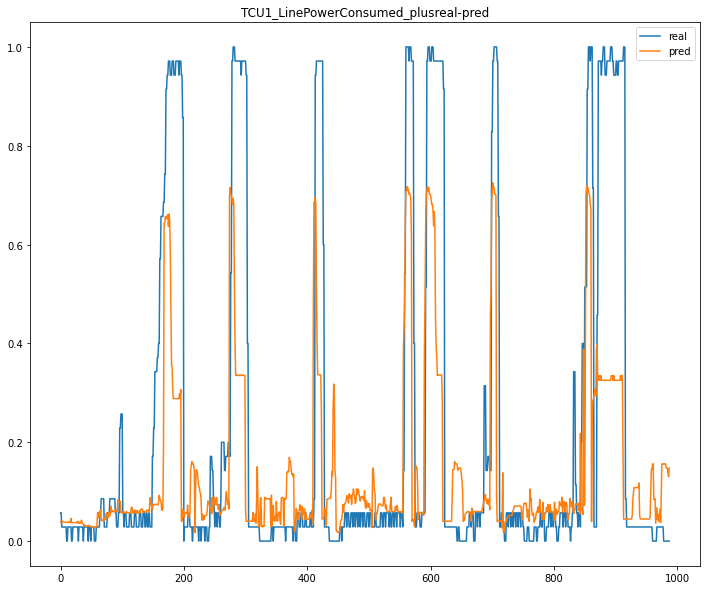

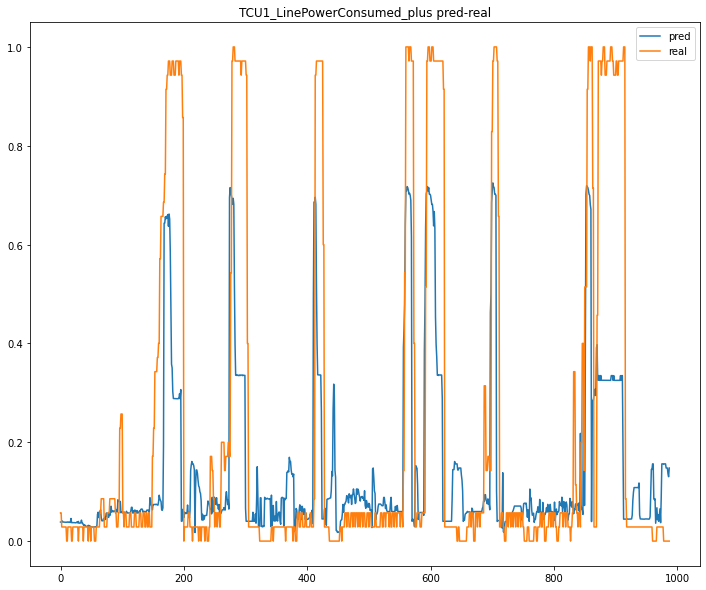

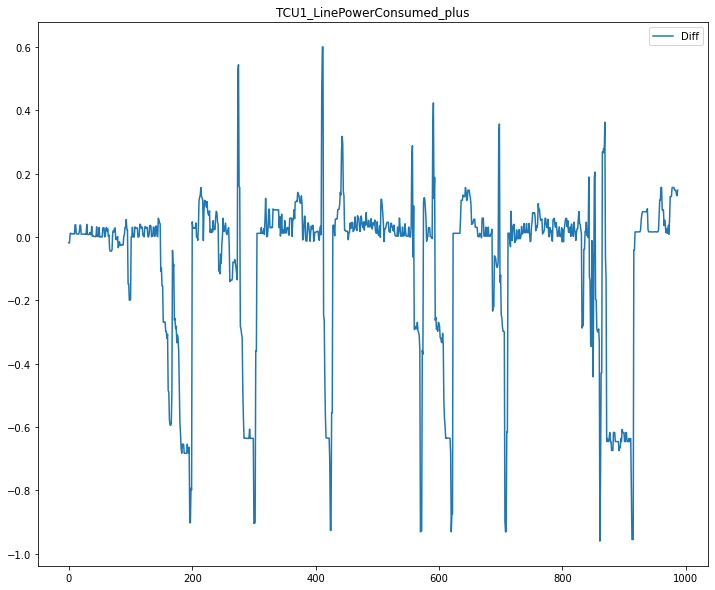

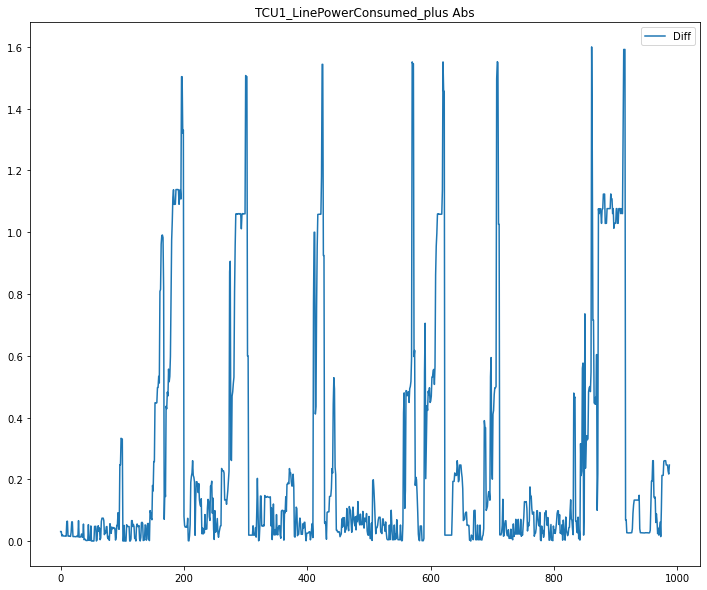

Fold : 1/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100

building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100building tree 8 of 100

building tree 9 of 100
building tree 10 of 100building tree 11 of 100

building tree 12 of 100
building tree 13 of 100
building tree 14 of 100building tree 15 of 100
building tree 16 of 100
building tree 17 of 100

building tree 18 of 100building tree 19 of 100

building tree 20 of 100building tree 21 of 100

building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100building tree 29 of 100

building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100building tree 35 of 100

building tree 36 of 100
building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 10671671381.89%, std: 36424359887.90%


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=

CV Mean:  -3.043260203976477
STD:  4.179232581491544




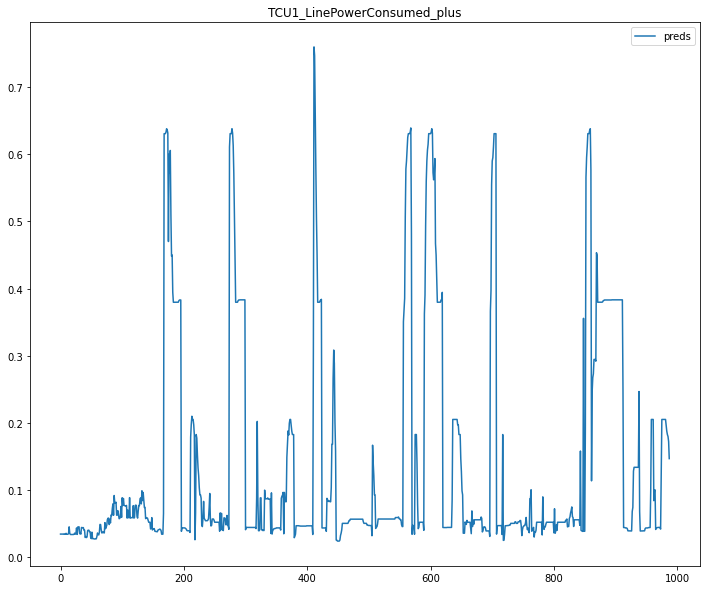

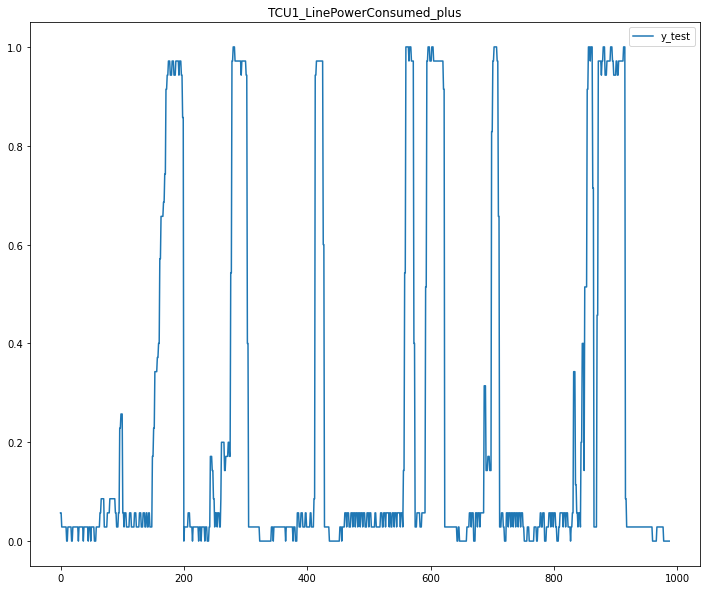

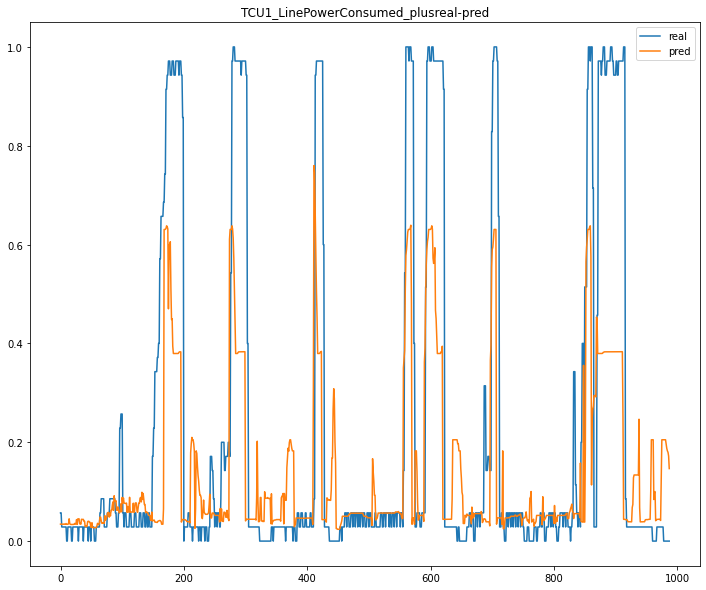

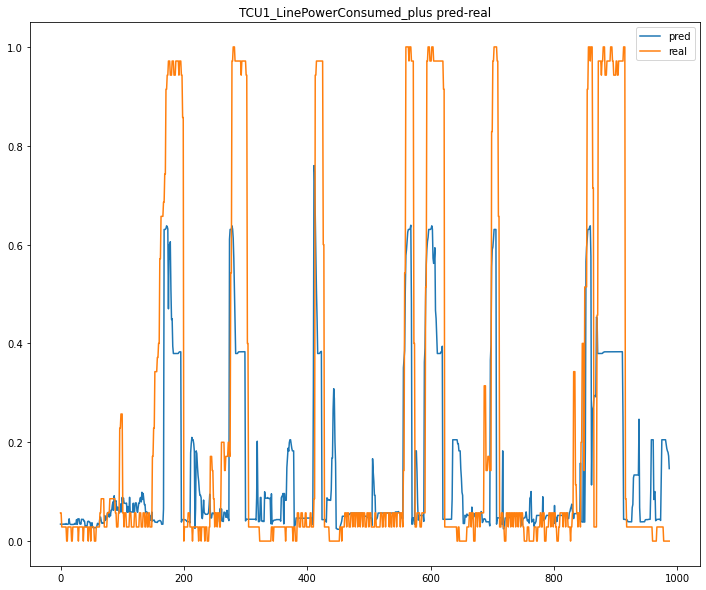

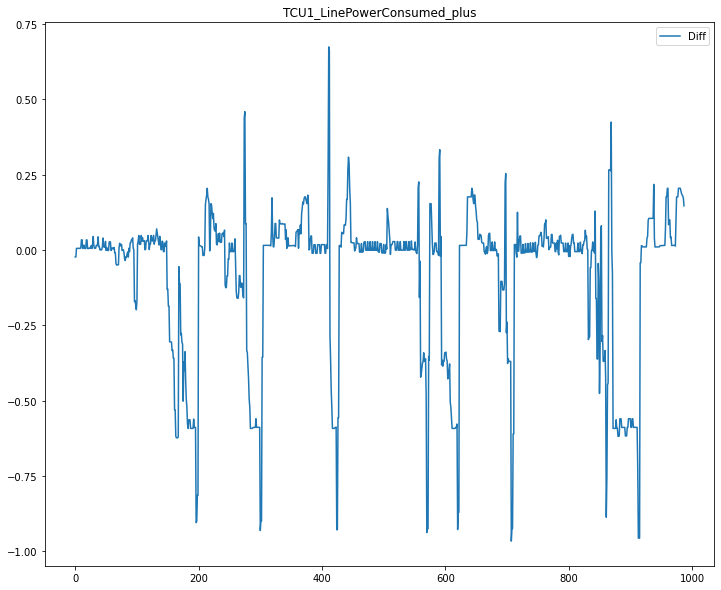

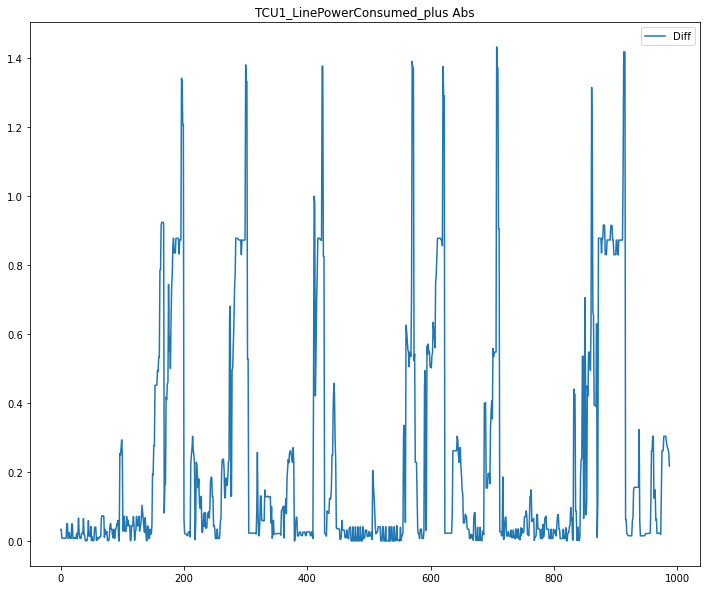

Fold : 2/3
building tree 1 of 100building tree 2 of 100

building tree 3 of 100
building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100building tree 8 of 100

building tree 9 of 100building tree 10 of 100building tree 11 of 100


building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100building tree 18 of 100
building tree 19 of 100

building tree 20 of 100
building tree 21 of 100
building tree 22 of 100building tree 23 of 100

building tree 24 of 100
building tree 25 of 100
building tree 26 of 100building tree 27 of 100
building tree 28 of 100

building tree 29 of 100
building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100building tree 36 of 100

building tree 37 of 100
building tree 38 of 100
building tree 39 of 100building tree 40 of 100

building tree 41 of 100building tree 4

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6030534114.16%, std: 20478418920.52%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]:

CV Mean:  -5.578090327401528
STD:  9.0818037145155




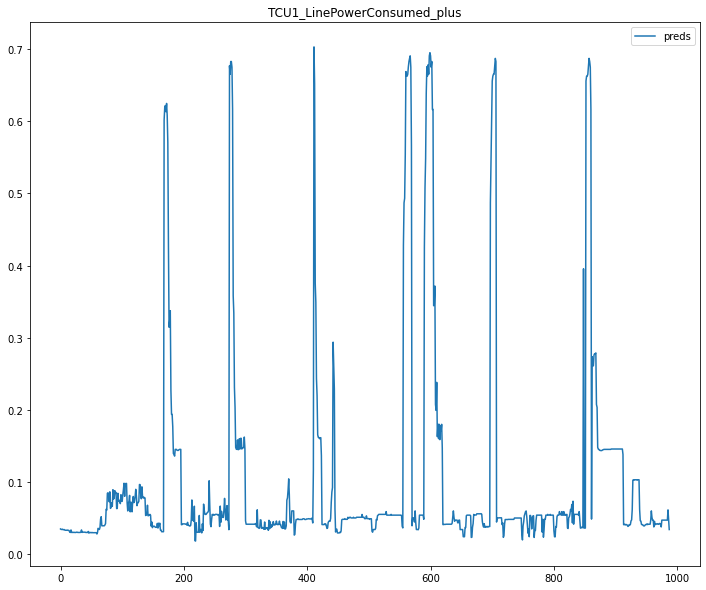

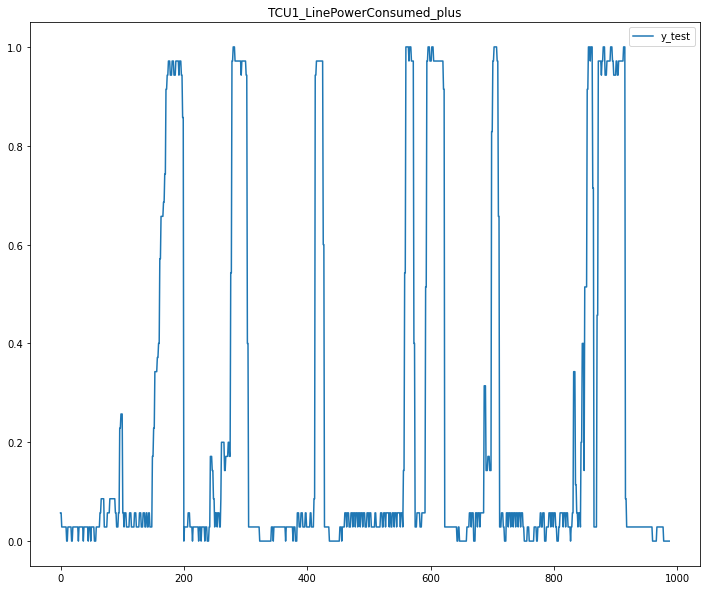

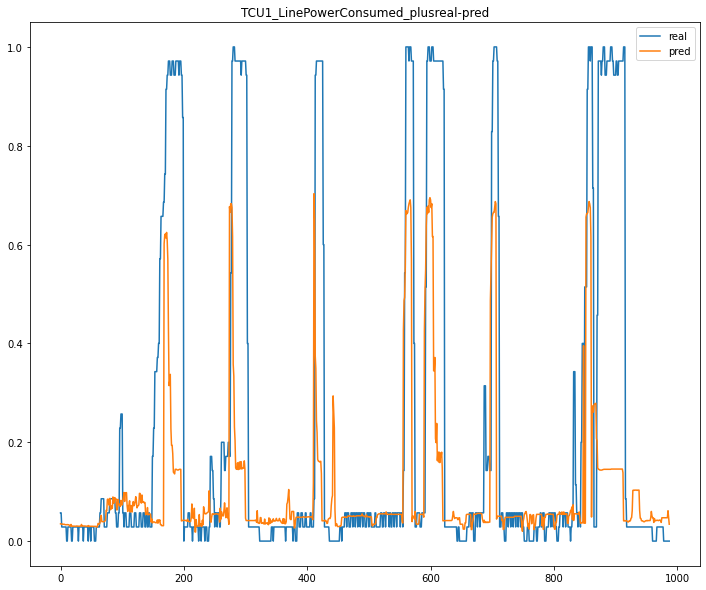

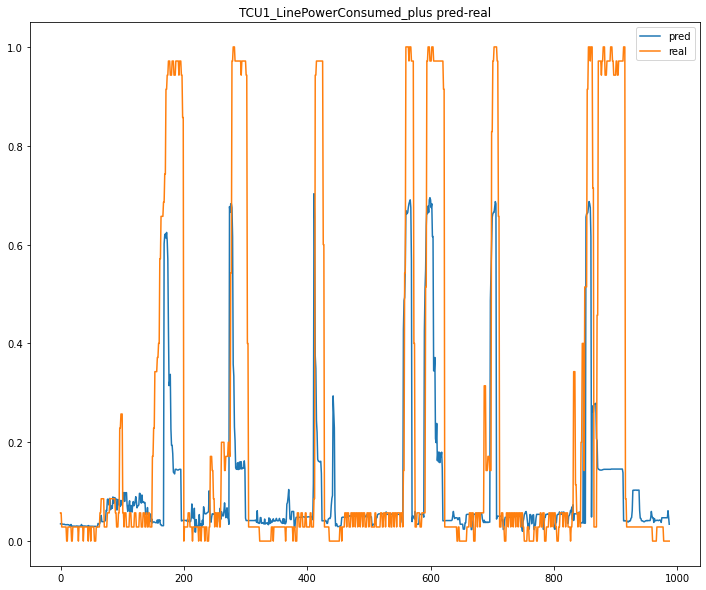

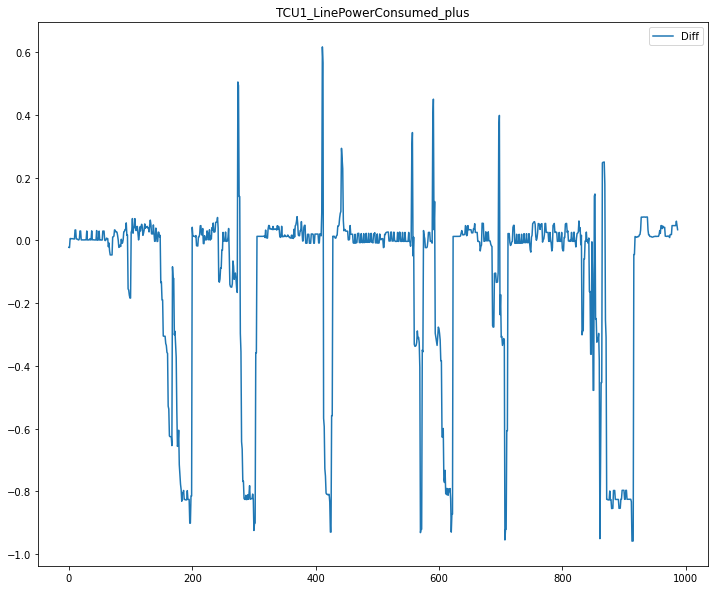

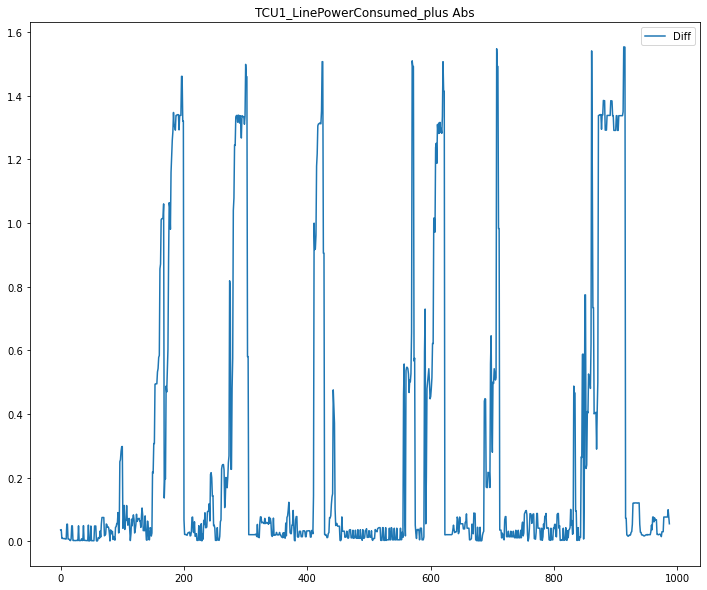

5 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 500, 'min_samples_split': 10}
Fold : 0/3
building tree 1 of 500building tree 2 of 500
building tree 3 of 500
building tree 4 of 500

building tree 5 of 500
building tree 6 of 500
building tree 7 of 500
building tree 8 of 500
building tree 9 of 500
building tree 10 of 500
building tree 11 of 500
building tree 12 of 500building tree 13 of 500
building tree 14 of 500

building tree 15 of 500
building tree 16 of 500building tree 17 of 500building tree 18 of 500


building tree 19 of 500
building tree 20 of 500
building tree 21 of 500
building tree 22 of 500
building tree 23 of 500
building tree 24 of 500
building tree 25 of 500


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 26 of 500
building tree 27 of 500
building tree 28 of 500
building tree 29 of 500
building tree 30 of 500
building tree 31 of 500
building tree 32 of 500
building tree 33 of 500building tree 34 of 500

building tree 35 of 500
building tree 36 of 500building tree 37 of 500

building tree 38 of 500
building tree 39 of 500building tree 40 of 500

building tree 41 of 500
building tree 42 of 500
building tree 43 of 500
building tree 44 of 500building tree 45 of 500
building tree 46 of 500

building tree 47 of 500
building tree 48 of 500
building tree 49 of 500building tree 50 of 500

building tree 51 of 500
building tree 52 of 500building tree 53 of 500

building tree 54 of 500
building tree 55 of 500
building tree 56 of 500
building tree 57 of 500
building tree 58 of 500building tree 59 of 500
building tree 60 of 500

building tree 61 of 500
building tree 62 of 500
building tree 63 of 500
building tree 64 of 500
building tree 65 of 500
building tree 66 of 500
building tree 67

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.


building tree 487 of 500
building tree 488 of 500
building tree 489 of 500
building tree 490 of 500
building tree 491 of 500
building tree 492 of 500building tree 493 of 500

building tree 494 of 500
building tree 495 of 500
building tree 496 of 500
building tree 497 of 500
building tree 498 of 500
building tree 499 of 500
building tree 500 of 500
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 8482422889.05%, std: 28598107463.77%


[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finis

CV Mean:  -5.362221223101501
STD:  9.979188413749677




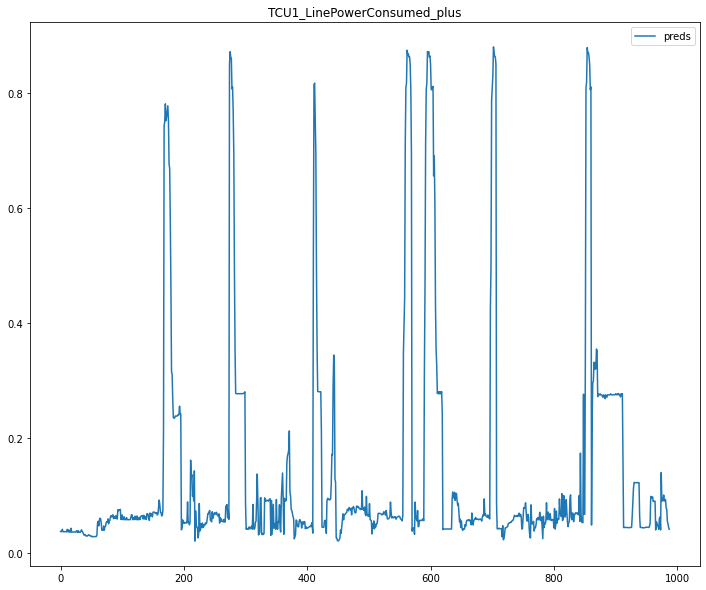

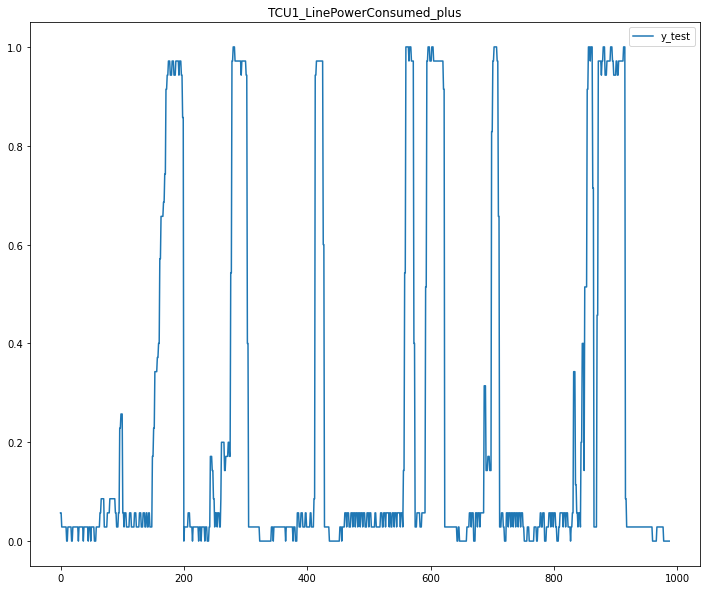

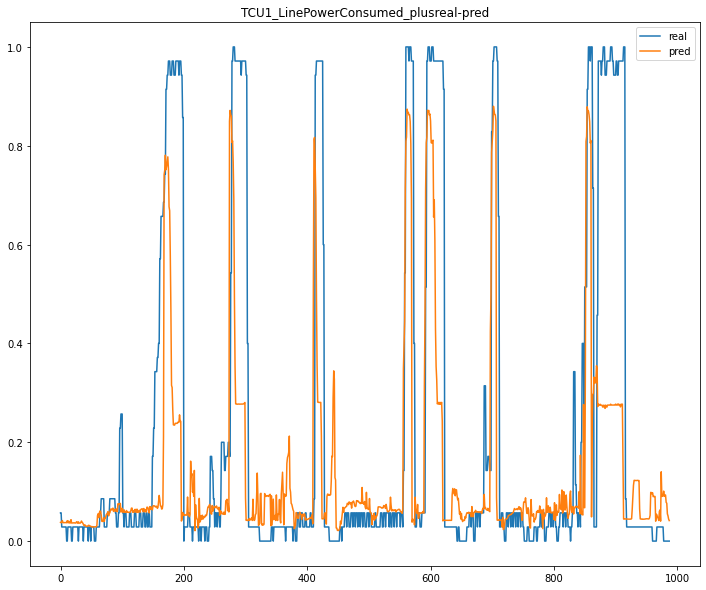

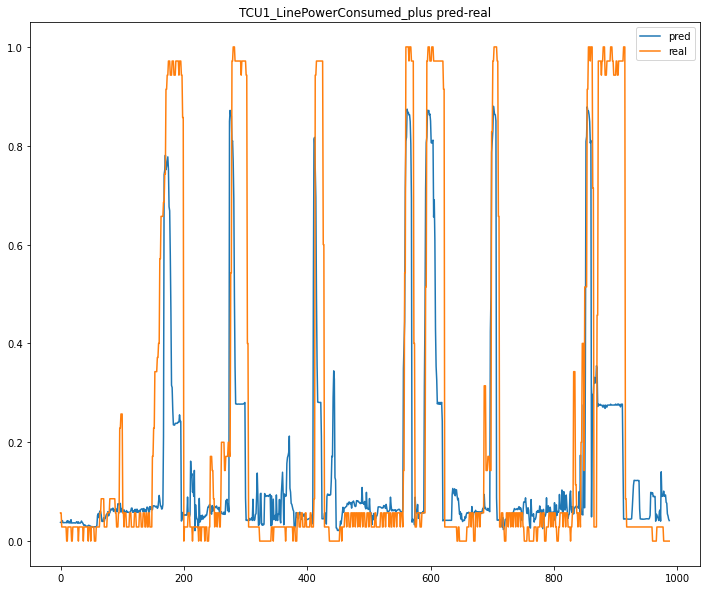

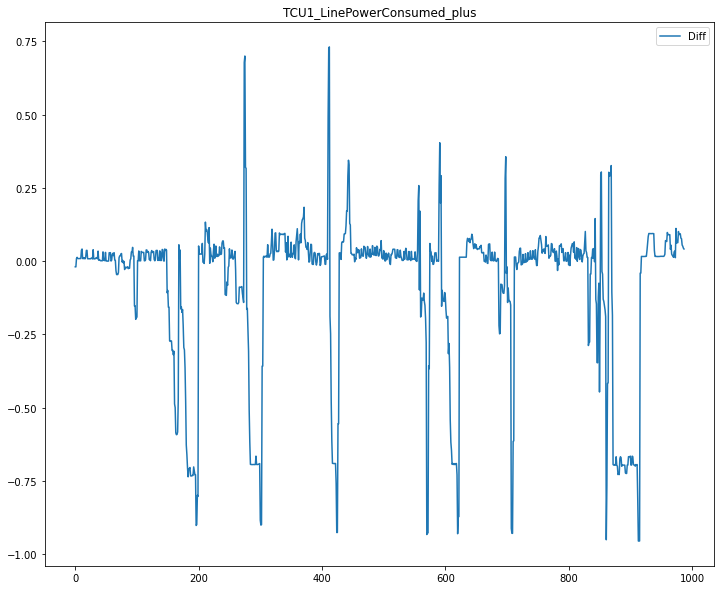

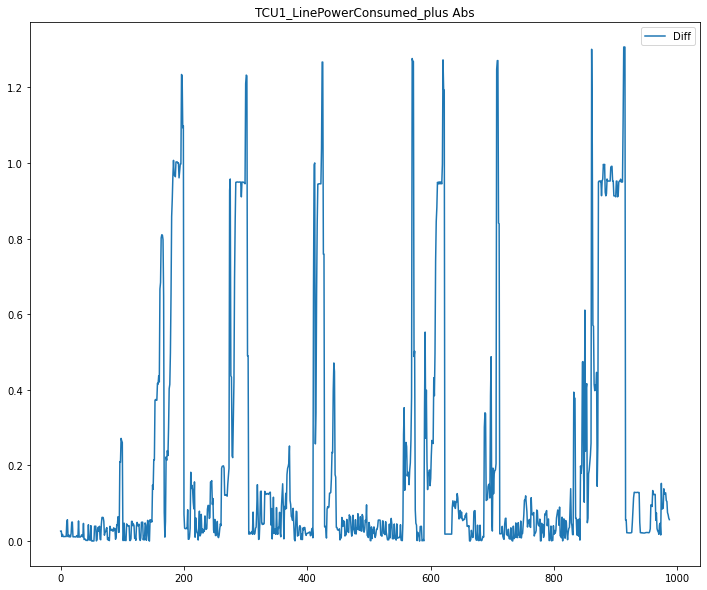

Fold : 1/3
building tree 1 of 500building tree 2 of 500
building tree 3 of 500
building tree 4 of 500
building tree 5 of 500

building tree 6 of 500building tree 7 of 500

building tree 8 of 500
building tree 9 of 500
building tree 10 of 500
building tree 11 of 500
building tree 12 of 500
building tree 13 of 500
building tree 14 of 500building tree 15 of 500

building tree 16 of 500
building tree 17 of 500
building tree 18 of 500
building tree 19 of 500
building tree 20 of 500
building tree 21 of 500building tree 22 of 500

building tree 23 of 500
building tree 24 of 500
building tree 25 of 500
building tree 26 of 500
building tree 27 of 500building tree 28 of 500

building tree 29 of 500building tree 30 of 500

building tree 31 of 500
building tree 32 of 500
building tree 33 of 500building tree 34 of 500

building tree 35 of 500
building tree 36 of 500building tree 37 of 500

building tree 38 of 500
building tree 39 of 500
building tree 40 of 500
building tree 41 of 500
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 43 of 500building tree 44 of 500

building tree 45 of 500
building tree 46 of 500
building tree 47 of 500
building tree 48 of 500
building tree 49 of 500building tree 50 of 500

building tree 51 of 500
building tree 52 of 500
building tree 53 of 500
building tree 54 of 500
building tree 55 of 500
building tree 56 of 500building tree 57 of 500

building tree 58 of 500
building tree 59 of 500
building tree 60 of 500building tree 61 of 500

building tree 62 of 500building tree 63 of 500

building tree 64 of 500
building tree 65 of 500
building tree 66 of 500
building tree 67 of 500
building tree 68 of 500
building tree 69 of 500building tree 70 of 500

building tree 71 of 500
building tree 72 of 500
building tree 73 of 500
building tree 74 of 500
building tree 75 of 500
building tree 76 of 500
building tree 77 of 500building tree 78 of 500

building tree 79 of 500
building tree 80 of 500
building tree 81 of 500
building tree 82 of 500
building tree 83 of 500
building tree 84

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s



building tree 187 of 500
building tree 188 of 500
building tree 189 of 500
building tree 190 of 500
building tree 191 of 500
building tree 192 of 500building tree 193 of 500

building tree 194 of 500
building tree 195 of 500
building tree 196 of 500
building tree 197 of 500
building tree 198 of 500
building tree 199 of 500building tree 200 of 500

building tree 201 of 500
building tree 202 of 500building tree 203 of 500

building tree 204 of 500building tree 205 of 500

building tree 206 of 500
building tree 207 of 500
building tree 208 of 500
building tree 209 of 500
building tree 210 of 500
building tree 211 of 500
building tree 212 of 500building tree 213 of 500

building tree 214 of 500
building tree 215 of 500
building tree 216 of 500
building tree 217 of 500building tree 218 of 500

building tree 219 of 500
building tree 220 of 500
building tree 221 of 500building tree 222 of 500
building tree 223 of 500

building tree 224 of 500building tree 225 of 500

building tree 226 of 500

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s





building tree 499 of 500
building tree 500 of 500
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 7623897875.28%, std: 25105592750.00%


[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with

CV Mean:  -3.682970295499478
STD:  6.371276028867702




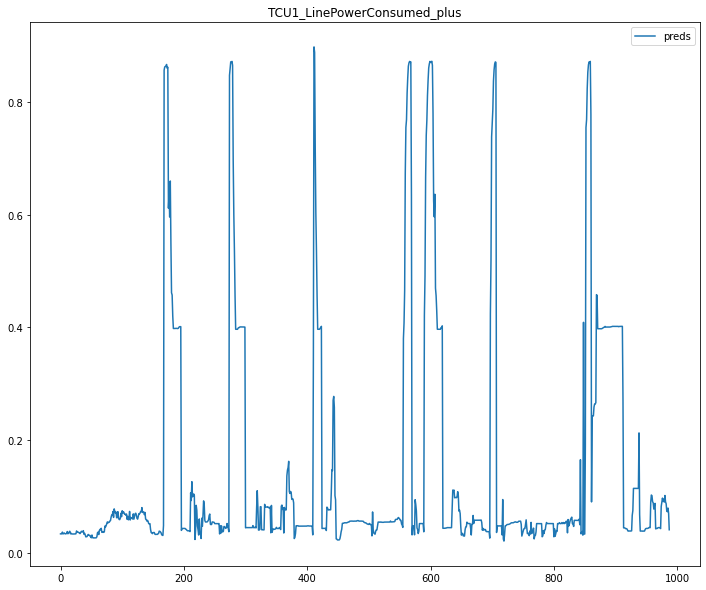

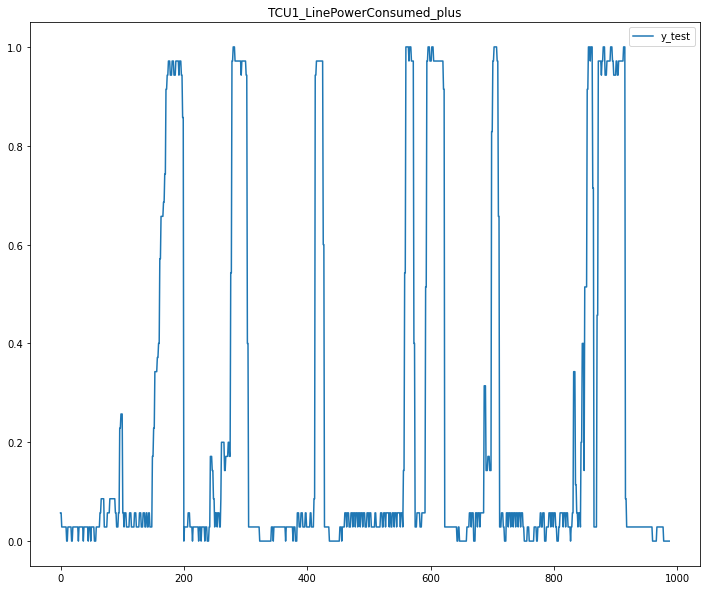

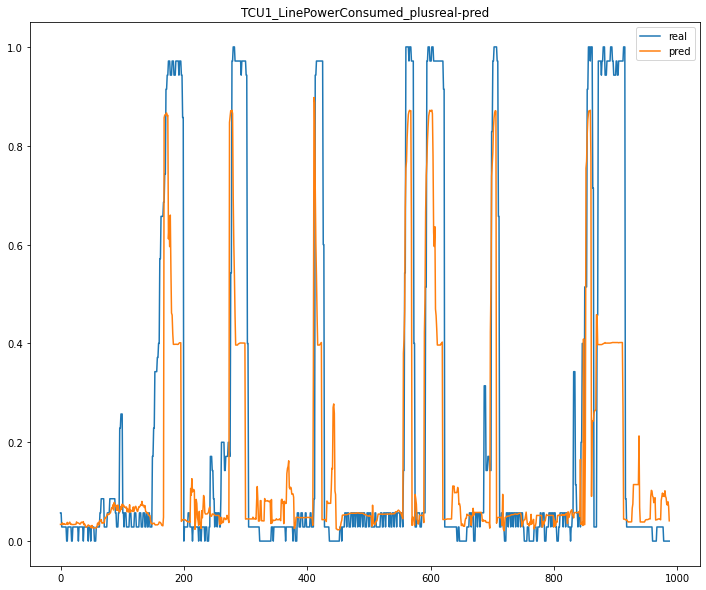

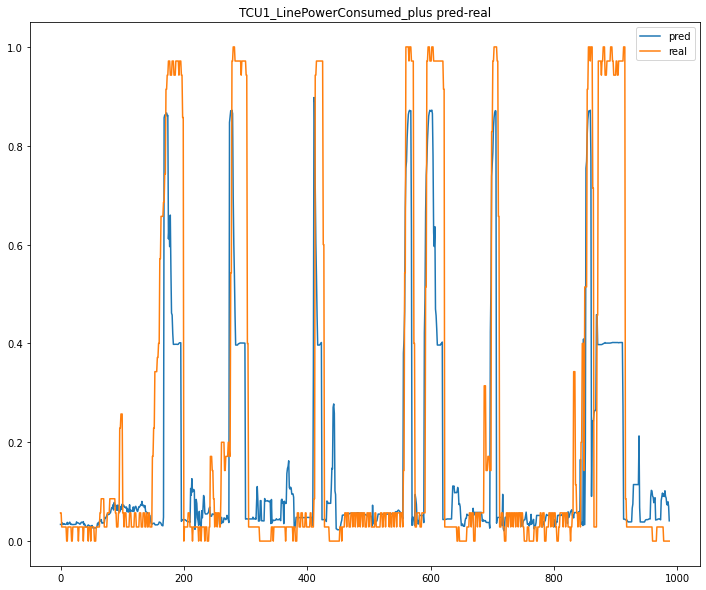

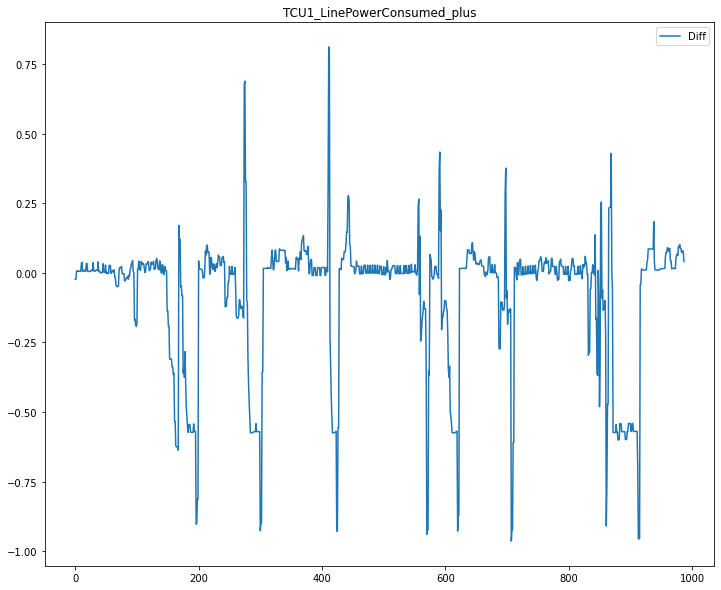

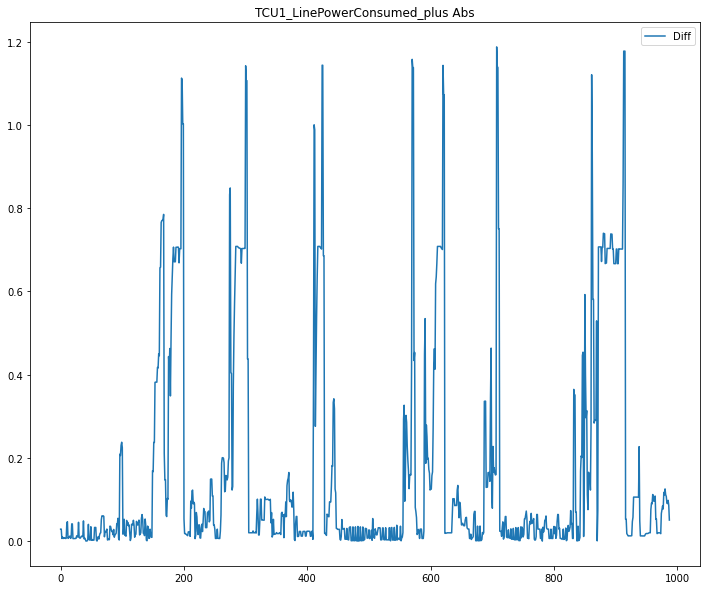

Fold : 2/3
building tree 1 of 500building tree 2 of 500

building tree 3 of 500
building tree 4 of 500
building tree 5 of 500
building tree 6 of 500
building tree 7 of 500
building tree 8 of 500
building tree 9 of 500
building tree 10 of 500building tree 11 of 500

building tree 12 of 500building tree 13 of 500

building tree 14 of 500
building tree 15 of 500
building tree 16 of 500
building tree 17 of 500
building tree 18 of 500
building tree 19 of 500
building tree 20 of 500
building tree 21 of 500
building tree 22 of 500building tree 23 of 500

building tree 24 of 500
building tree 25 of 500
building tree 26 of 500building tree 27 of 500

building tree 28 of 500
building tree 29 of 500
building tree 30 of 500
building tree 31 of 500
building tree 32 of 500
building tree 33 of 500
building tree 34 of 500
building tree 35 of 500
building tree 36 of 500building tree 37 of 500

building tree 38 of 500
building tree 39 of 500building tree 40 of 500

building tree 41 of 500
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 48 of 500
building tree 49 of 500
building tree 50 of 500
building tree 51 of 500
building tree 52 of 500
building tree 53 of 500building tree 54 of 500

building tree 55 of 500
building tree 56 of 500
building tree 57 of 500
building tree 58 of 500
building tree 59 of 500building tree 60 of 500

building tree 61 of 500
building tree 62 of 500
building tree 63 of 500
building tree 64 of 500
building tree 65 of 500
building tree 66 of 500
building tree 67 of 500
building tree 68 of 500
building tree 69 of 500
building tree 70 of 500
building tree 71 of 500
building tree 72 of 500building tree 73 of 500

building tree 74 of 500building tree 75 of 500

building tree 76 of 500
building tree 77 of 500
building tree 78 of 500
building tree 79 of 500
building tree 80 of 500
building tree 81 of 500building tree 82 of 500

building tree 83 of 500
building tree 84 of 500
building tree 85 of 500
building tree 86 of 500
building tree 87 of 500
building tree 88 of 500building tree 89 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 209 of 500
building tree 210 of 500
building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500
building tree 215 of 500
building tree 216 of 500building tree 217 of 500

building tree 218 of 500
building tree 219 of 500
building tree 220 of 500building tree 221 of 500

building tree 222 of 500
building tree 223 of 500
building tree 224 of 500
building tree 225 of 500building tree 226 of 500

building tree 227 of 500building tree 228 of 500
building tree 229 of 500

building tree 230 of 500building tree 231 of 500

building tree 232 of 500
building tree 233 of 500building tree 234 of 500

building tree 235 of 500
building tree 236 of 500
building tree 237 of 500
building tree 238 of 500
building tree 239 of 500
building tree 240 of 500
building tree 241 of 500
building tree 242 of 500
building tree 243 of 500
building tree 244 of 500
building tree 245 of 500
building tree 246 of 500
building tree 247 of 500
building tree 248 of 500


[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished


building tree 363 of 500
building tree 364 of 500
building tree 365 of 500
building tree 366 of 500
building tree 367 of 500
building tree 368 of 500
building tree 369 of 500
building tree 370 of 500
building tree 371 of 500
building tree 372 of 500
building tree 373 of 500
building tree 374 of 500
building tree 375 of 500building tree 376 of 500

building tree 377 of 500
building tree 378 of 500
building tree 379 of 500
building tree 380 of 500
building tree 381 of 500building tree 382 of 500

building tree 383 of 500
building tree 384 of 500building tree 385 of 500
building tree 386 of 500

building tree 387 of 500
building tree 388 of 500
building tree 389 of 500
building tree 390 of 500
building tree 391 of 500
building tree 392 of 500
building tree 393 of 500
building tree 394 of 500
building tree 395 of 500
building tree 396 of 500
building tree 397 of 500
building tree 398 of 500
building tree 399 of 500
building tree 400 of 500building tree 401 of 500

building tree 402 of 500


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5798692299.14%, std: 19402311073.03%


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s f

CV Mean:  -5.002589830286396
STD:  8.902686234853975




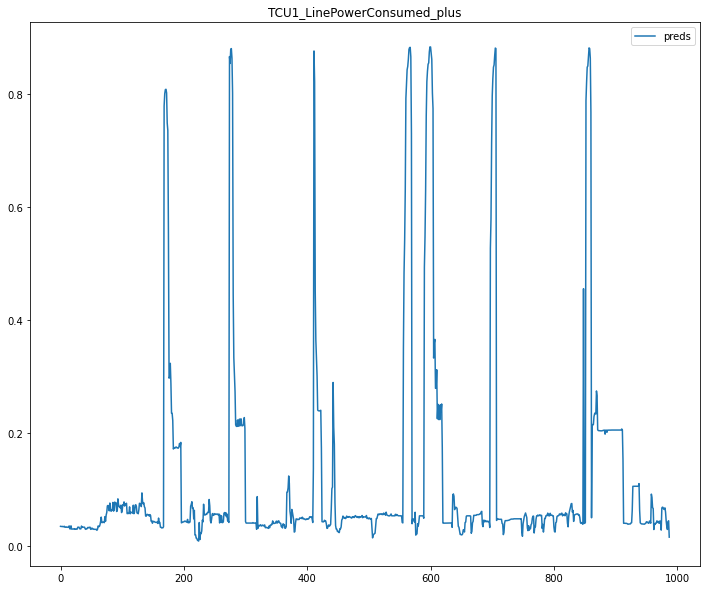

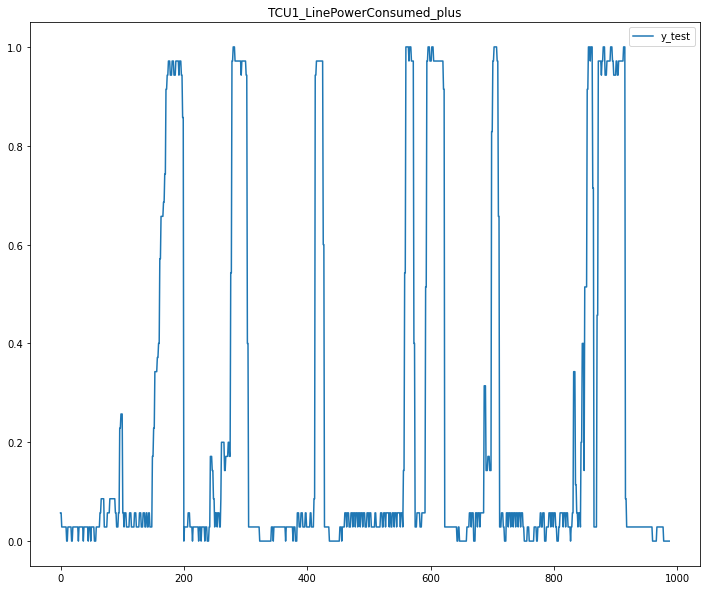

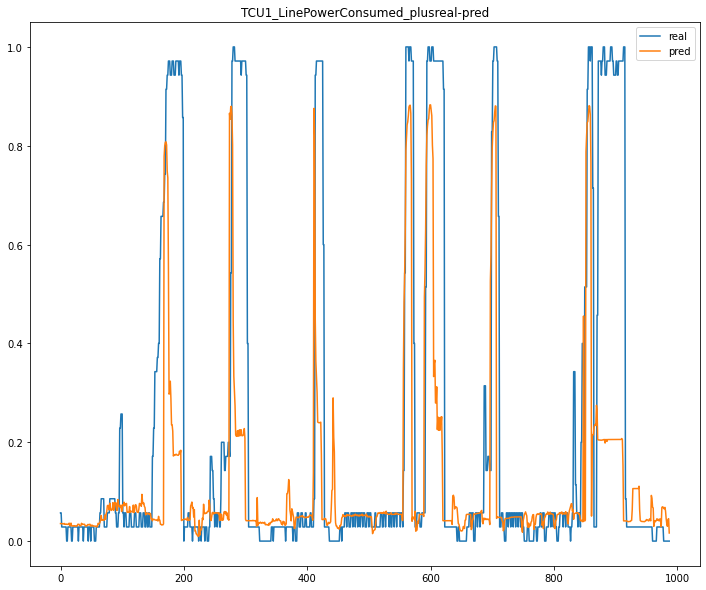

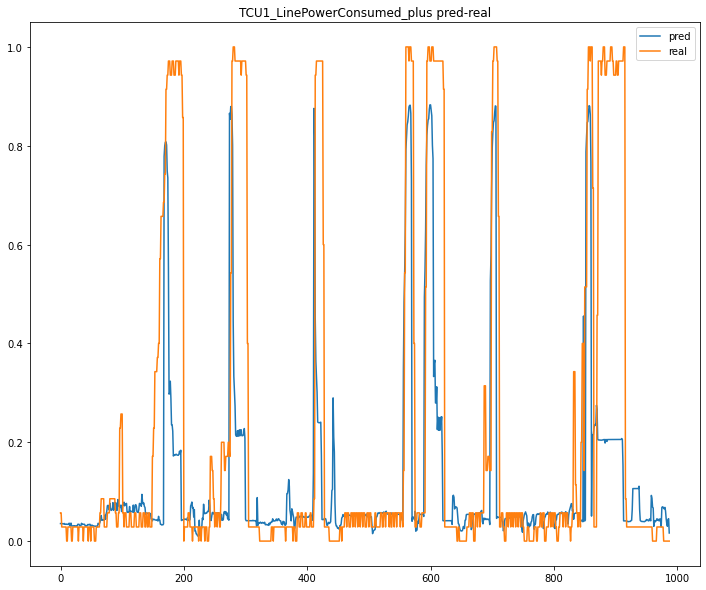

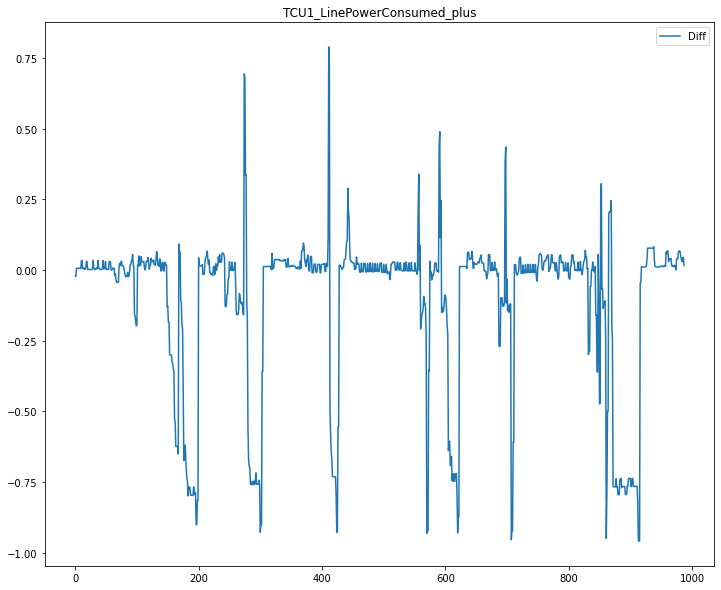

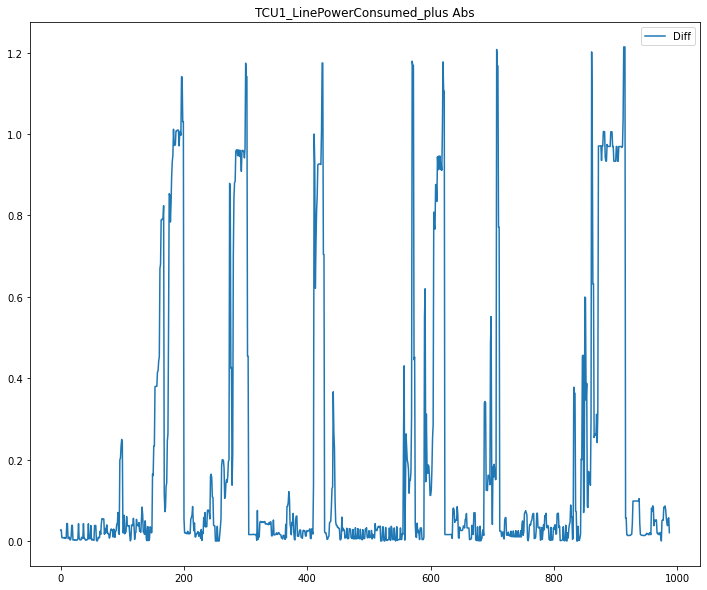

6 / 10
{'max_depth': 5, 'min_samples_leaf': 10, 'n_estimators': 100, 'min_samples_split': 2}
Fold : 0/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100building tree 4 of 100


building tree 5 of 100building tree 6 of 100
building tree 7 of 100

building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100building tree 13 of 100

building tree 14 of 100
building tree 15 of 100building tree 16 of 100

building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100building tree 24 of 100
building tree 25 of 100

building tree 26 of 100building tree 27 of 100

building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100
building tree 38 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


building tree 98 of 100
building tree 99 of 100
building tree 100 of 100
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 9071165496.32%, std: 30290912114.51%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]:

CV Mean:  -1.2600988278803682
STD:  2.4869244411373677




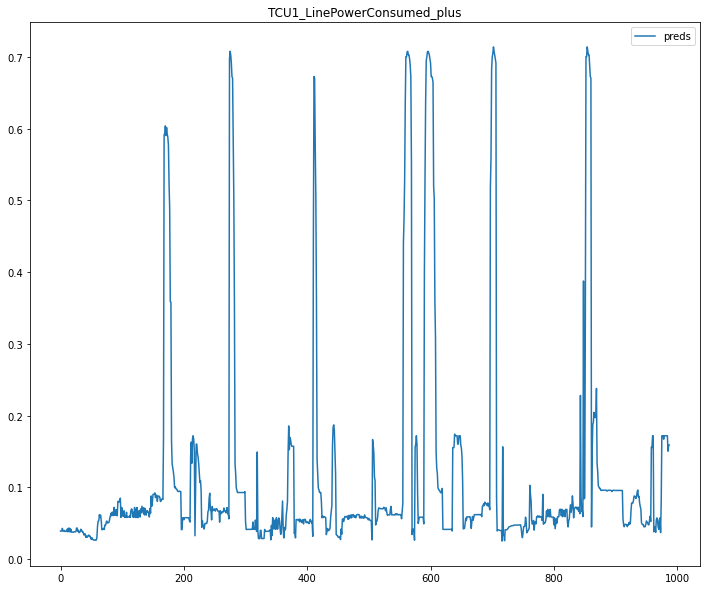

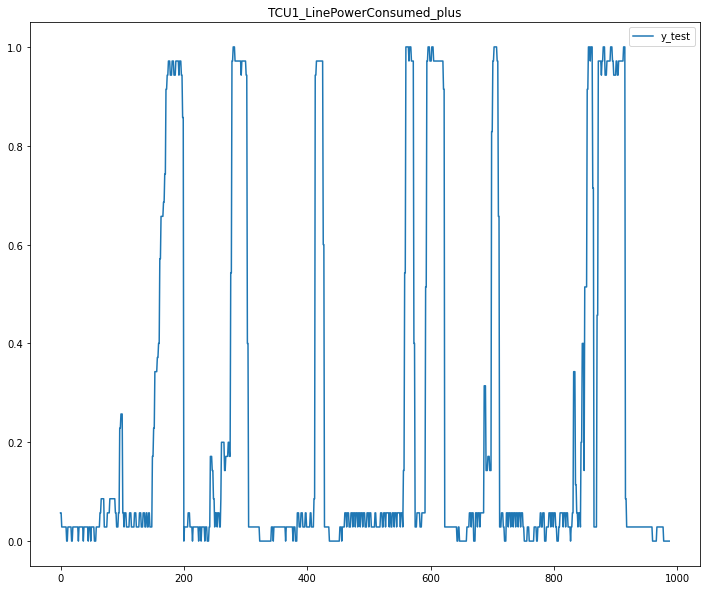

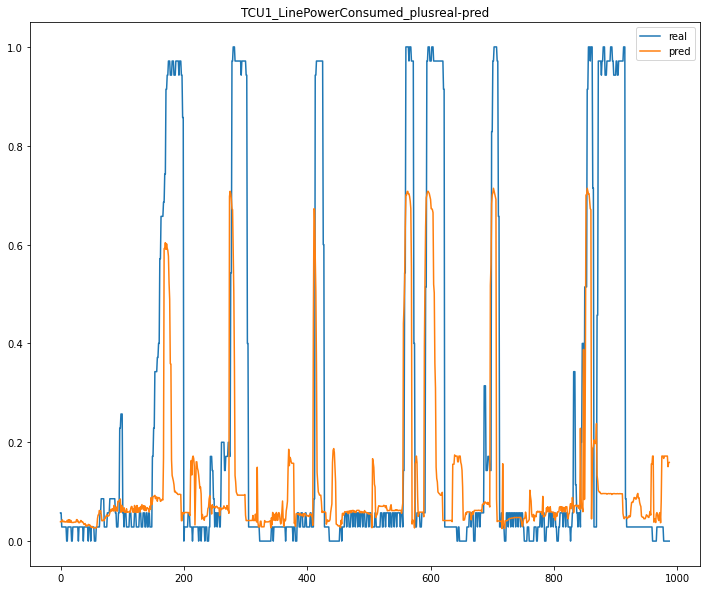

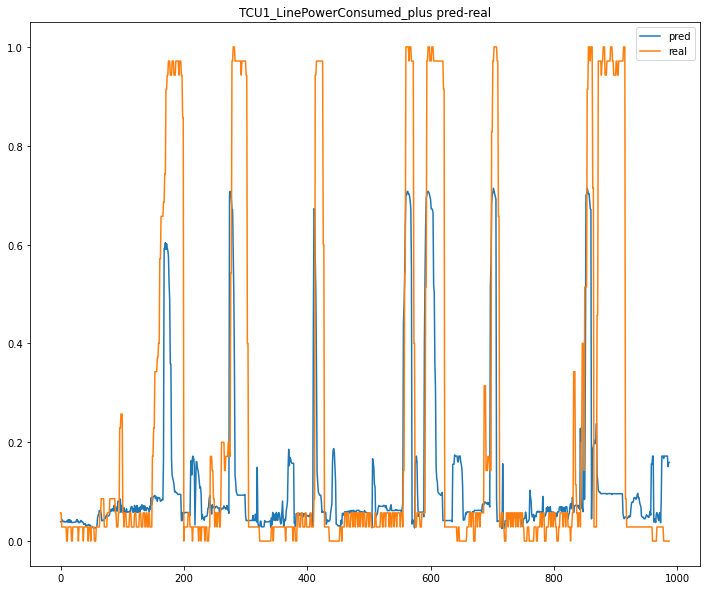

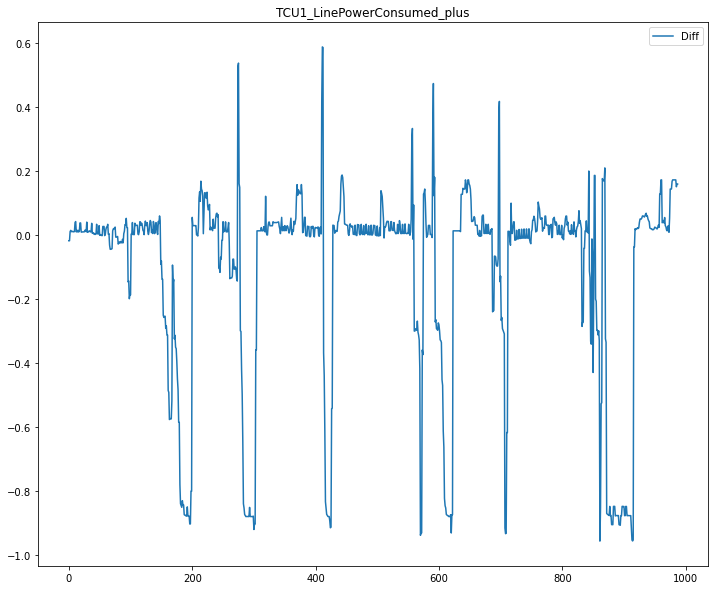

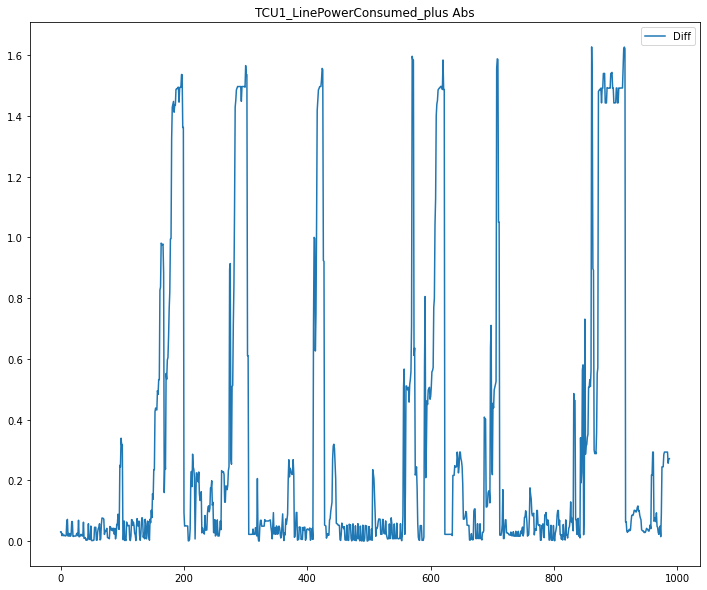

Fold : 1/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100

building tree 4 of 100
building tree 5 of 100
building tree 6 of 100
building tree 7 of 100
building tree 8 of 100
building tree 9 of 100building tree 10 of 100

building tree 11 of 100building tree 12 of 100
building tree 13 of 100

building tree 14 of 100building tree 15 of 100

building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100building tree 20 of 100

building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100building tree 34 of 100

building tree 35 of 100building tree 36 of 100

building tree 37 of 100
building tree 38 of 100building tree 39 of 100building tree 40 of 100


building tree 41 of 100building tree 4

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


building tree 86 of 100
building tree 87 of 100
building tree 88 of 100
building tree 89 of 100building tree 90 of 100building tree 91 of 100


building tree 92 of 100
building tree 93 of 100
building tree 94 of 100
building tree 95 of 100
building tree 96 of 100building tree 97 of 100
building tree 98 of 100building tree 99 of 100

building tree 100 of 100

TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 12029946650.82%, std: 48099692727.74%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finishe

CV Mean:  -0.5781637584270742
STD:  0.9192242274966279




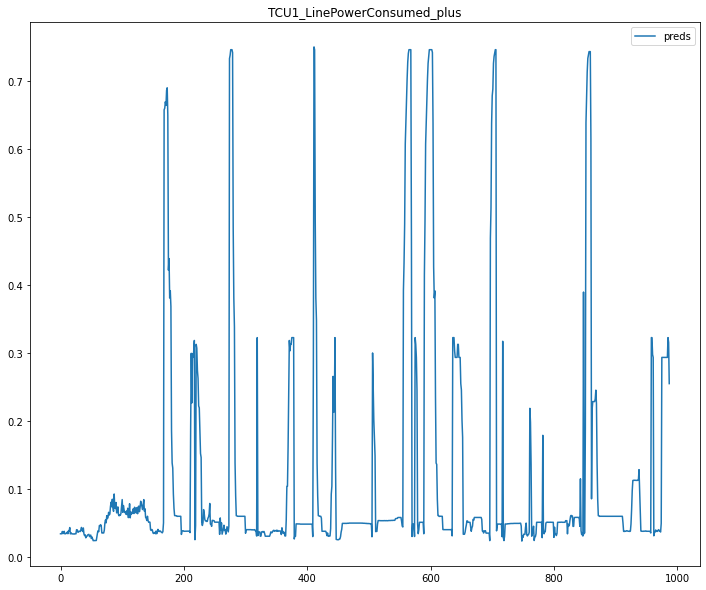

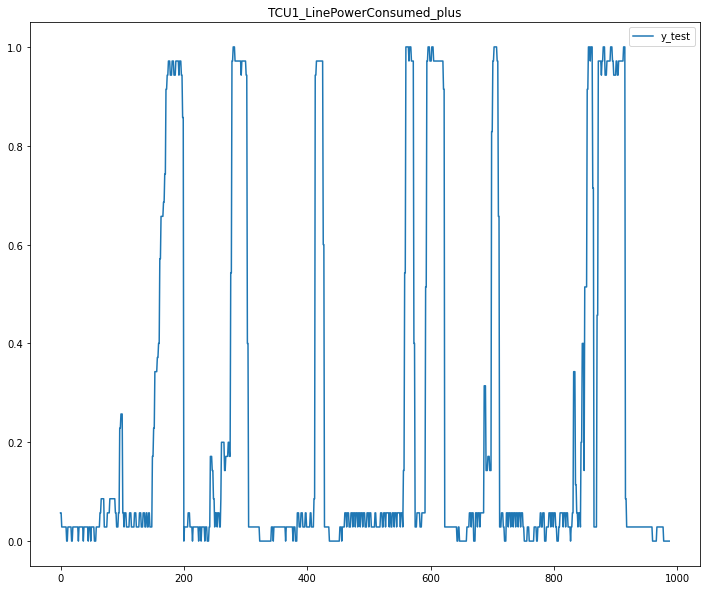

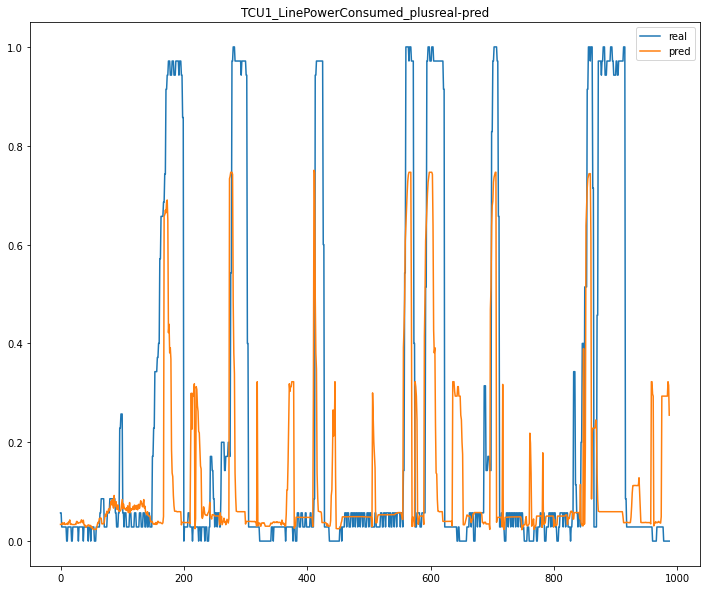

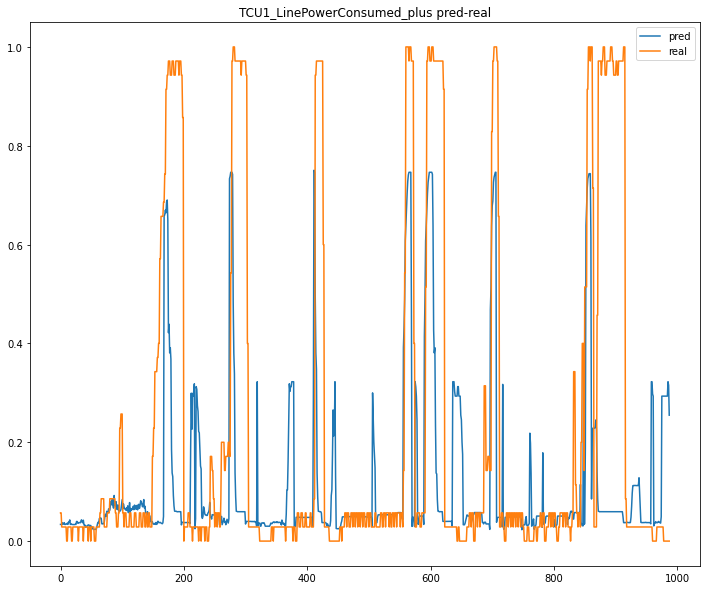

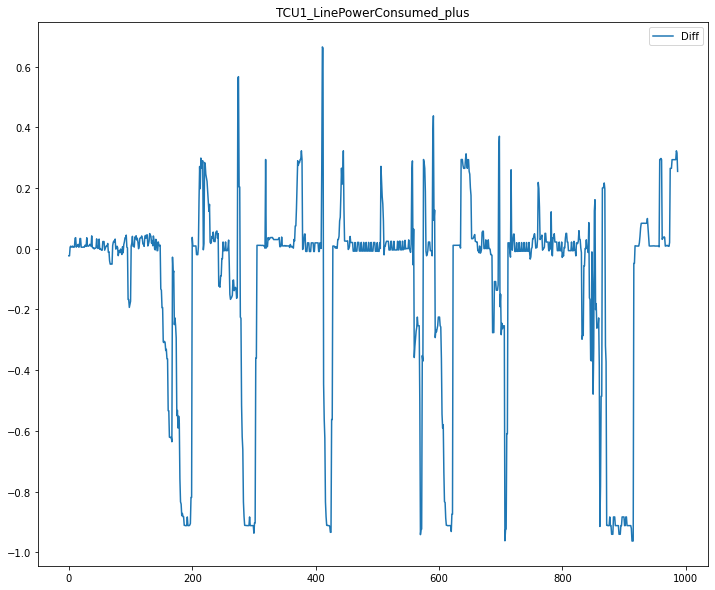

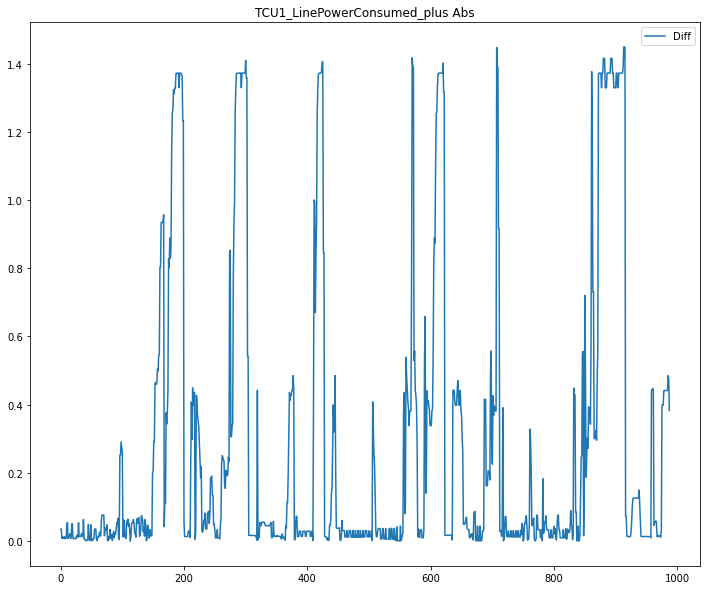

Fold : 2/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100
building tree 4 of 100

building tree 5 of 100
building tree 6 of 100building tree 7 of 100
building tree 8 of 100

building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100building tree 13 of 100

building tree 14 of 100building tree 15 of 100
building tree 16 of 100

building tree 17 of 100building tree 18 of 100
building tree 19 of 100

building tree 20 of 100building tree 21 of 100

building tree 22 of 100building tree 23 of 100
building tree 24 of 100

building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100
building tree 30 of 100building tree 31 of 100
building tree 32 of 100building tree 33 of 100


building tree 34 of 100
building tree 35 of 100
building tree 36 of 100
building tree 37 of 100building tree 38 of 100

building tree 39 of 100
building tree 40 of 100
building tree 41 of 100building tree 4

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6948990900.99%, std: 22153903513.21%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Pa

CV Mean:  -1.3702921256474243
STD:  1.9674404215948018




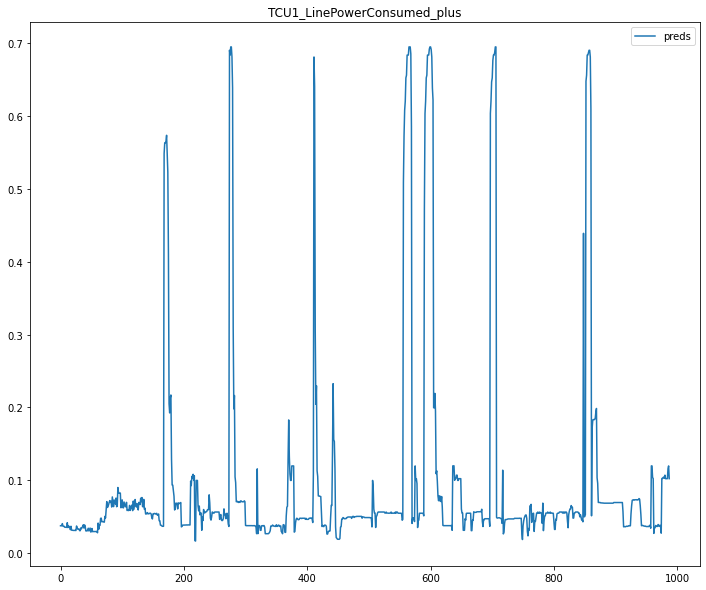

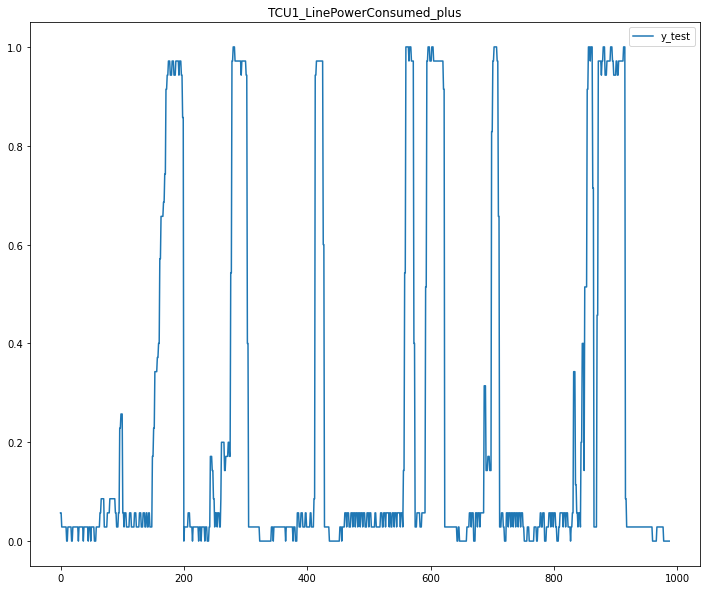

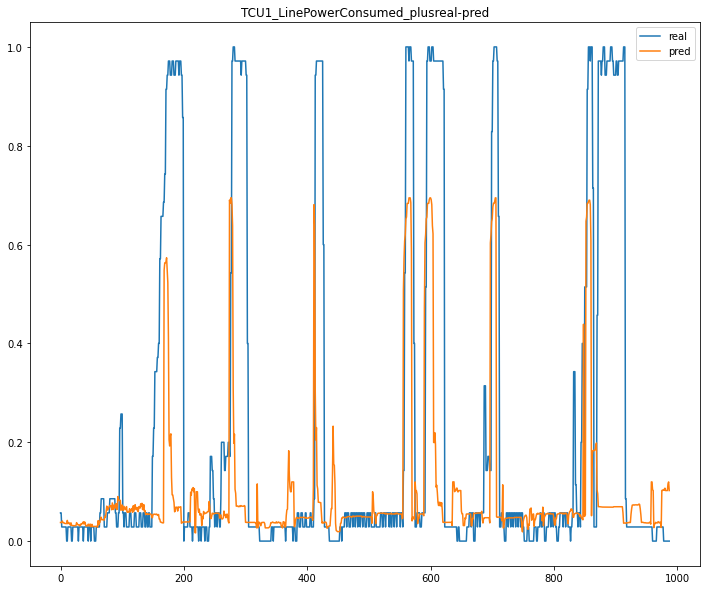

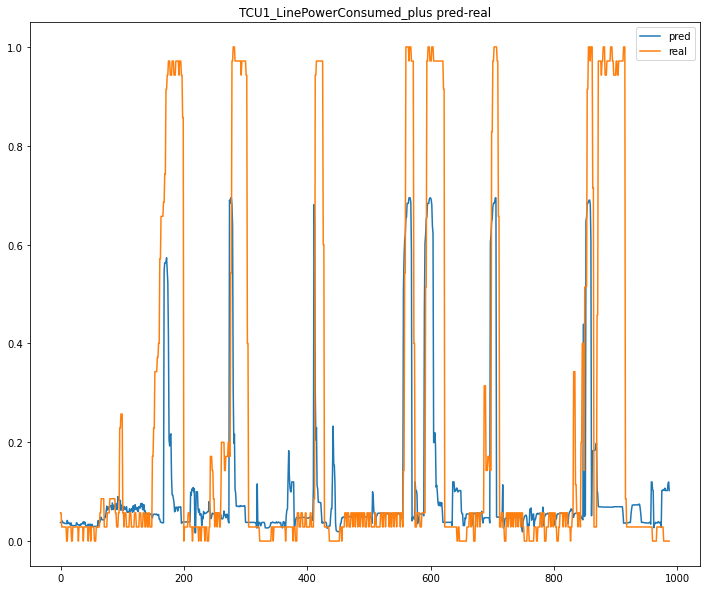

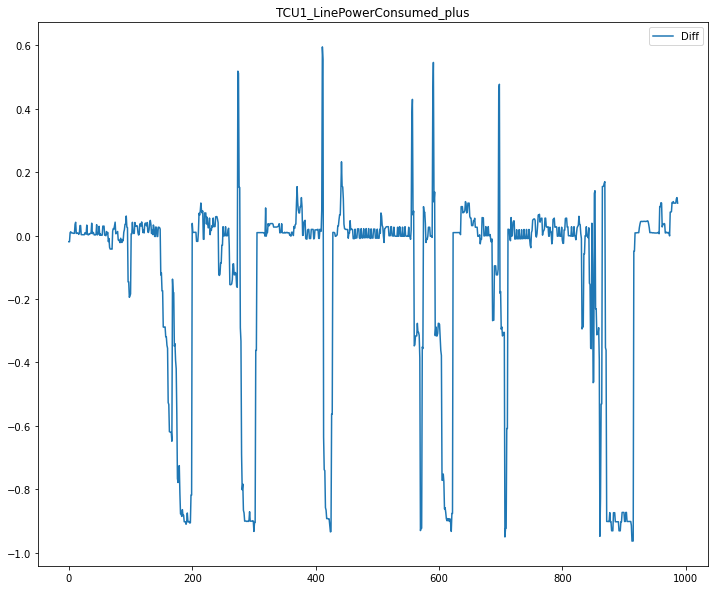

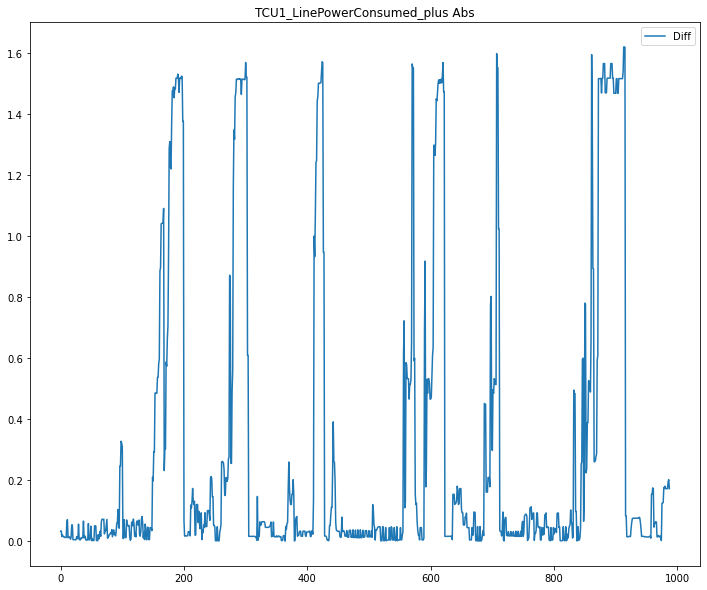

7 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 500, 'min_samples_split': 20}
Fold : 0/3
building tree 1 of 500building tree 2 of 500
building tree 3 of 500
building tree 4 of 500
building tree 5 of 500
building tree 6 of 500
building tree 7 of 500
building tree 8 of 500

building tree 9 of 500
building tree 10 of 500building tree 11 of 500
building tree 12 of 500

building tree 13 of 500
building tree 14 of 500
building tree 15 of 500
building tree 16 of 500
building tree 17 of 500
building tree 18 of 500
building tree 19 of 500building tree 20 of 500
building tree 21 of 500

building tree 22 of 500
building tree 23 of 500
building tree 24 of 500
building tree 25 of 500
building tree 26 of 500
building tree 27 of 500
building tree 28 of 500building tree 29 of 500

building tree 30 of 500
building tree 31 of 500
building tree 32 of 500building tree 33 of 500


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 34 of 500

building tree 35 of 500
building tree 36 of 500
building tree 37 of 500
building tree 38 of 500
building tree 39 of 500building tree 40 of 500building tree 41 of 500


building tree 42 of 500building tree 43 of 500

building tree 44 of 500
building tree 45 of 500building tree 46 of 500building tree 47 of 500


building tree 48 of 500building tree 49 of 500

building tree 50 of 500
building tree 51 of 500
building tree 52 of 500
building tree 53 of 500building tree 54 of 500

building tree 55 of 500building tree 56 of 500

building tree 57 of 500building tree 58 of 500

building tree 59 of 500
building tree 60 of 500
building tree 61 of 500
building tree 62 of 500
building tree 63 of 500
building tree 64 of 500
building tree 65 of 500building tree 66 of 500

building tree 67 of 500
building tree 68 of 500
building tree 69 of 500
building tree 70 of 500building tree 71 of 500

building tree 72 of 500
building tree 73 of 500
building tree 74 of 500
building tree 7

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s



building tree 189 of 500
building tree 190 of 500
building tree 191 of 500building tree 192 of 500building tree 193 of 500


building tree 194 of 500
building tree 195 of 500
building tree 196 of 500
building tree 197 of 500
building tree 198 of 500
building tree 199 of 500
building tree 200 of 500
building tree 201 of 500
building tree 202 of 500
building tree 203 of 500
building tree 204 of 500
building tree 205 of 500building tree 206 of 500building tree 207 of 500building tree 208 of 500
building tree 209 of 500



building tree 210 of 500
building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500
building tree 215 of 500building tree 216 of 500
building tree 217 of 500building tree 218 of 500


building tree 219 of 500
building tree 220 of 500
building tree 221 of 500
building tree 222 of 500
building tree 223 of 500
building tree 224 of 500
building tree 225 of 500
building tree 226 of 500
building tree 227 of 500building tree 228 of 500


[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 9880895530.70%, std: 32772169337.77%


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s f

CV Mean:  -5.408677349060355
STD:  9.655672030347072




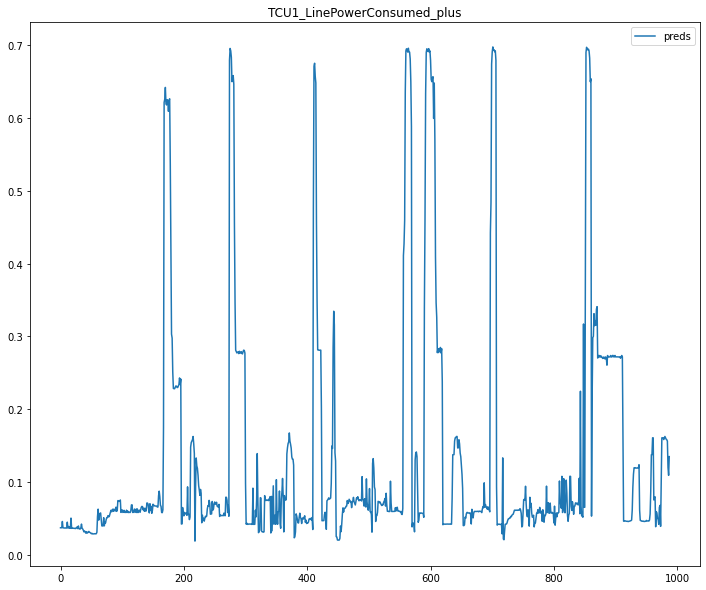

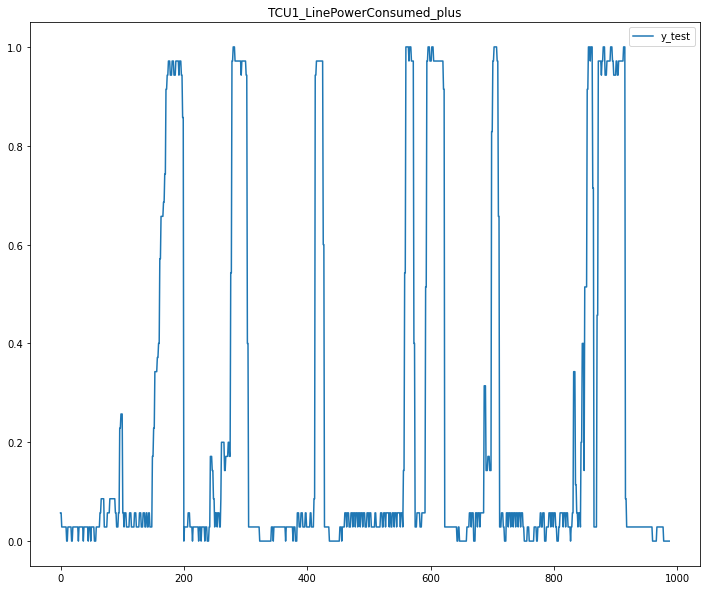

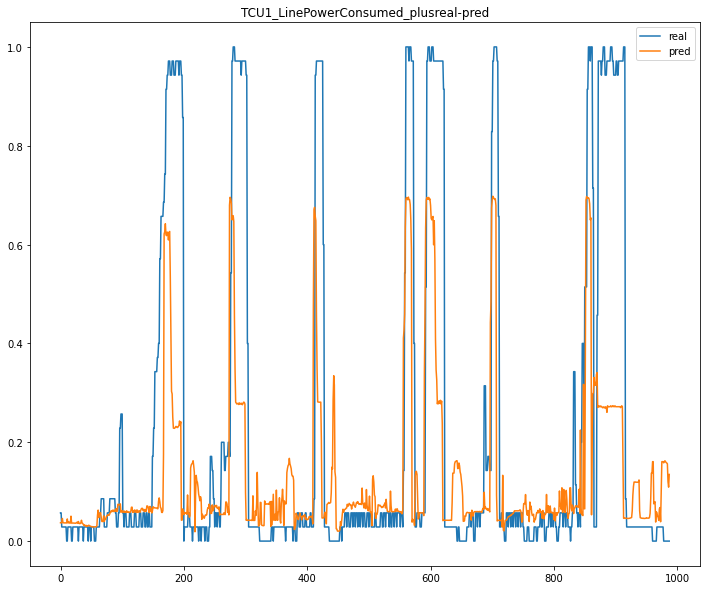

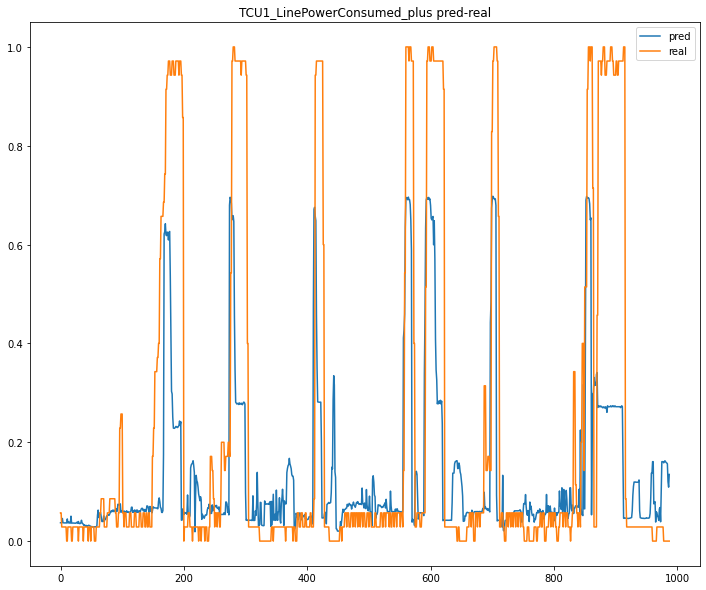

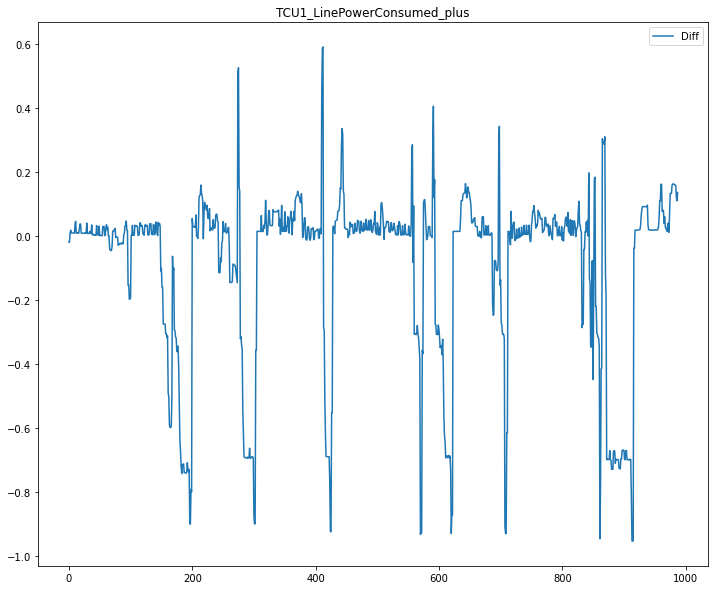

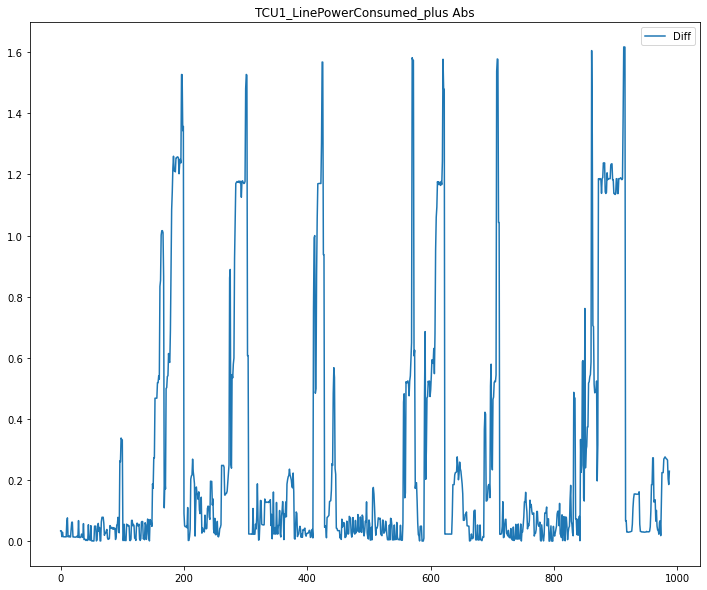

Fold : 1/3
building tree 1 of 500
building tree 2 of 500building tree 3 of 500
building tree 4 of 500

building tree 5 of 500building tree 6 of 500

building tree 7 of 500
building tree 8 of 500
building tree 9 of 500
building tree 10 of 500building tree 11 of 500
building tree 12 of 500

building tree 13 of 500
building tree 14 of 500
building tree 15 of 500
building tree 16 of 500
building tree 17 of 500
building tree 18 of 500building tree 19 of 500building tree 20 of 500


building tree 21 of 500
building tree 22 of 500building tree 23 of 500

building tree 24 of 500
building tree 25 of 500
building tree 26 of 500building tree 27 of 500

building tree 28 of 500building tree 29 of 500

building tree 30 of 500
building tree 31 of 500
building tree 32 of 500
building tree 33 of 500
building tree 34 of 500
building tree 35 of 500
building tree 36 of 500
building tree 37 of 500
building tree 38 of 500
building tree 39 of 500
building tree 40 of 500
building tree 41 of 500
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s


building tree 44 of 500
building tree 45 of 500
building tree 46 of 500
building tree 47 of 500
building tree 48 of 500
building tree 49 of 500
building tree 50 of 500
building tree 51 of 500building tree 52 of 500

building tree 53 of 500building tree 54 of 500
building tree 55 of 500building tree 56 of 500


building tree 57 of 500
building tree 58 of 500
building tree 59 of 500
building tree 60 of 500
building tree 61 of 500building tree 62 of 500
building tree 63 of 500

building tree 64 of 500
building tree 65 of 500
building tree 66 of 500
building tree 67 of 500
building tree 68 of 500building tree 69 of 500

building tree 70 of 500
building tree 71 of 500
building tree 72 of 500
building tree 73 of 500
building tree 74 of 500
building tree 75 of 500
building tree 76 of 500
building tree 77 of 500
building tree 78 of 500building tree 79 of 500

building tree 80 of 500
building tree 81 of 500
building tree 82 of 500
building tree 83 of 500
building tree 84 of 500
building tree 85

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 208 of 500
building tree 209 of 500
building tree 210 of 500
building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500
building tree 215 of 500
building tree 216 of 500
building tree 217 of 500building tree 218 of 500

building tree 219 of 500building tree 220 of 500

building tree 221 of 500
building tree 222 of 500
building tree 223 of 500
building tree 224 of 500building tree 225 of 500
building tree 226 of 500

building tree 227 of 500building tree 228 of 500

building tree 229 of 500
building tree 230 of 500building tree 231 of 500
building tree 232 of 500

building tree 233 of 500
building tree 234 of 500
building tree 235 of 500
building tree 236 of 500
building tree 237 of 500
building tree 238 of 500
building tree 239 of 500building tree 240 of 500

building tree 241 of 500building tree 242 of 500

building tree 243 of 500
building tree 244 of 500
building tree 245 of 500
building tree 246 of 500
building tree 247 of 500


[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s


building tree 358 of 500
building tree 359 of 500
building tree 360 of 500
building tree 361 of 500
building tree 362 of 500
building tree 363 of 500
building tree 364 of 500
building tree 365 of 500
building tree 366 of 500
building tree 367 of 500
building tree 368 of 500
building tree 369 of 500
building tree 370 of 500building tree 371 of 500
building tree 372 of 500

building tree 373 of 500building tree 374 of 500

building tree 375 of 500
building tree 376 of 500
building tree 377 of 500building tree 378 of 500

building tree 379 of 500building tree 380 of 500
building tree 381 of 500

building tree 382 of 500
building tree 383 of 500
building tree 384 of 500
building tree 385 of 500
building tree 386 of 500
building tree 387 of 500building tree 388 of 500

building tree 389 of 500
building tree 390 of 500building tree 391 of 500

building tree 392 of 500
building tree 393 of 500building tree 394 of 500

building tree 395 of 500
building tree 396 of 500
building tree 397 of 500b

[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 9453811440.21%, std: 31824852767.68%


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s f

CV Mean:  -3.7463903530046885
STD:  5.560314164397116




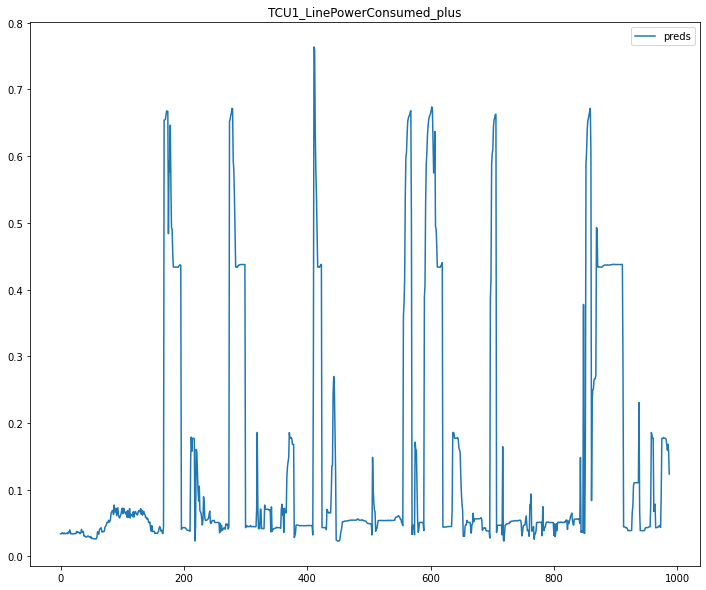

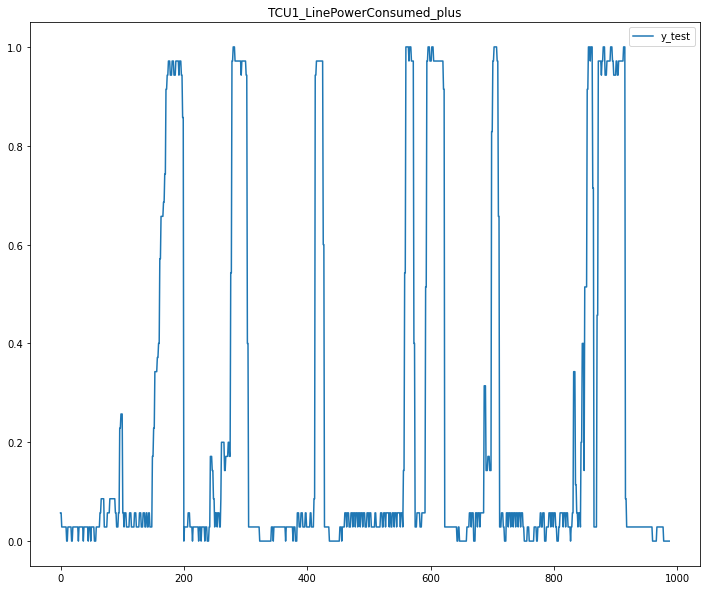

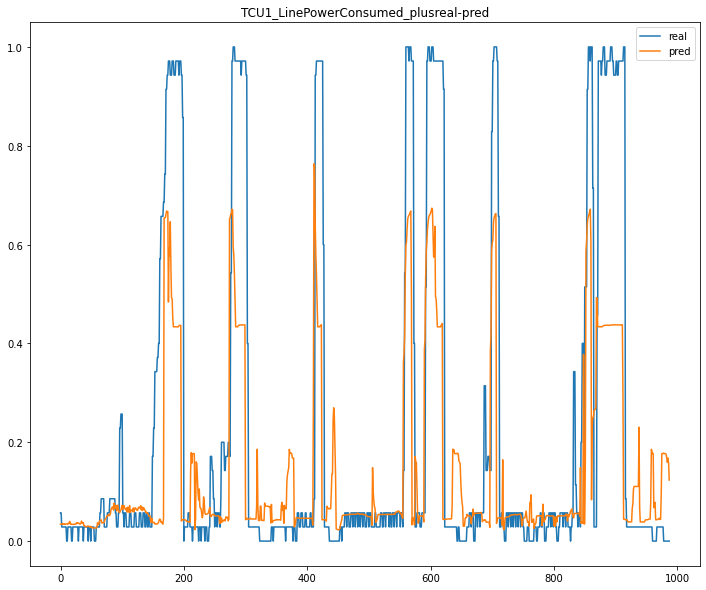

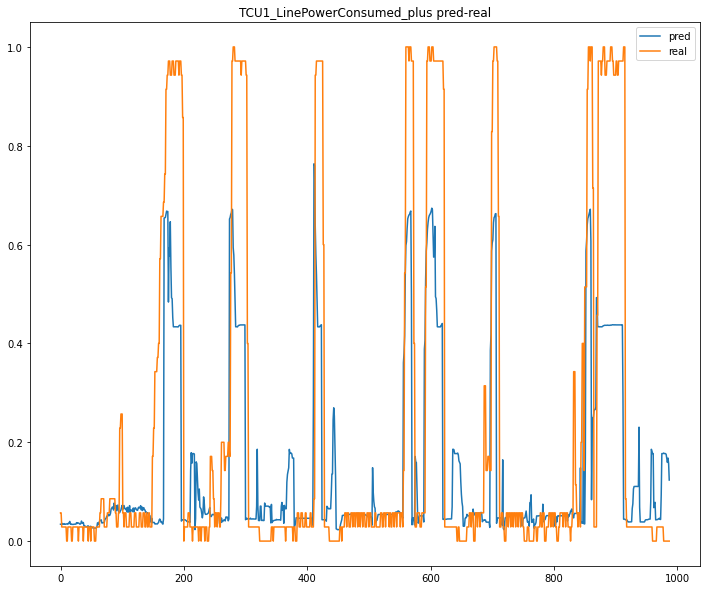

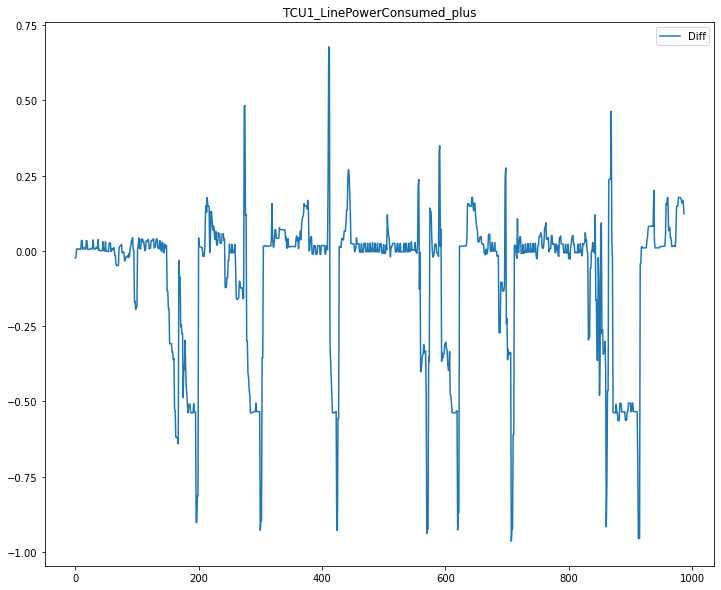

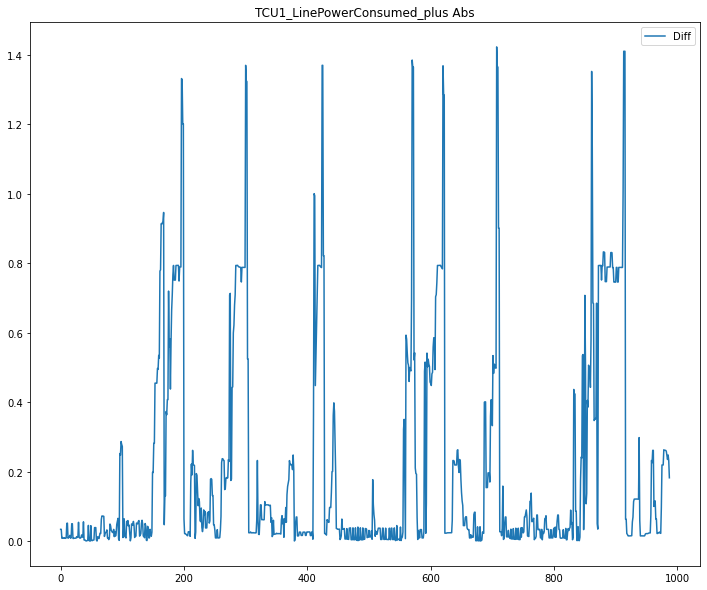

Fold : 2/3
building tree 1 of 500building tree 2 of 500

building tree 3 of 500
building tree 4 of 500
building tree 5 of 500
building tree 6 of 500
building tree 7 of 500
building tree 8 of 500
building tree 9 of 500
building tree 10 of 500
building tree 11 of 500
building tree 12 of 500building tree 13 of 500

building tree 14 of 500
building tree 15 of 500
building tree 16 of 500
building tree 17 of 500
building tree 18 of 500building tree 19 of 500
building tree 20 of 500

building tree 21 of 500
building tree 22 of 500
building tree 23 of 500
building tree 24 of 500
building tree 25 of 500
building tree 26 of 500building tree 27 of 500

building tree 28 of 500
building tree 29 of 500building tree 30 of 500

building tree 31 of 500
building tree 32 of 500
building tree 33 of 500building tree 34 of 500

building tree 35 of 500building tree 36 of 500



[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 37 of 500
building tree 38 of 500
building tree 39 of 500
building tree 40 of 500
building tree 41 of 500building tree 42 of 500

building tree 43 of 500
building tree 44 of 500
building tree 45 of 500
building tree 46 of 500building tree 47 of 500

building tree 48 of 500
building tree 49 of 500
building tree 50 of 500
building tree 51 of 500
building tree 52 of 500building tree 53 of 500
building tree 54 of 500

building tree 55 of 500
building tree 56 of 500
building tree 57 of 500
building tree 58 of 500building tree 59 of 500building tree 60 of 500


building tree 61 of 500building tree 62 of 500

building tree 63 of 500
building tree 64 of 500
building tree 65 of 500building tree 66 of 500

building tree 67 of 500
building tree 68 of 500
building tree 69 of 500
building tree 70 of 500
building tree 71 of 500
building tree 72 of 500building tree 73 of 500

building tree 74 of 500
building tree 75 of 500
building tree 76 of 500
building tree 77 of 500
building tree 78

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 177 of 500
building tree 178 of 500
building tree 179 of 500
building tree 180 of 500building tree 181 of 500

building tree 182 of 500
building tree 183 of 500
building tree 184 of 500
building tree 185 of 500
building tree 186 of 500building tree 187 of 500

building tree 188 of 500
building tree 189 of 500
building tree 190 of 500
building tree 191 of 500
building tree 192 of 500
building tree 193 of 500
building tree 194 of 500
building tree 195 of 500
building tree 196 of 500
building tree 197 of 500
building tree 198 of 500building tree 199 of 500building tree 200 of 500


building tree 201 of 500building tree 202 of 500

building tree 203 of 500
building tree 204 of 500building tree 205 of 500

building tree 206 of 500
building tree 207 of 500
building tree 208 of 500building tree 209 of 500

building tree 210 of 500
building tree 211 of 500
building tree 212 of 500
building tree 213 of 500
building tree 214 of 500
building tree 215 of 500
building tree 216 of 500


[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s


building tree 496 of 500building tree 497 of 500

building tree 498 of 500
building tree 499 of 500
building tree 500 of 500
TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 6593568686.99%, std: 21511698499.91%


[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 500 out of 500 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 500 out of 500 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with

CV Mean:  -5.643994092702367
STD:  9.09998494609201




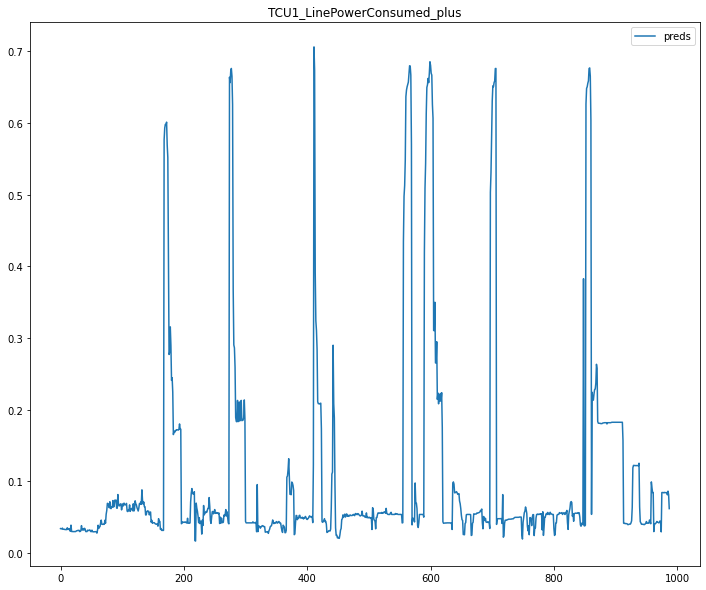

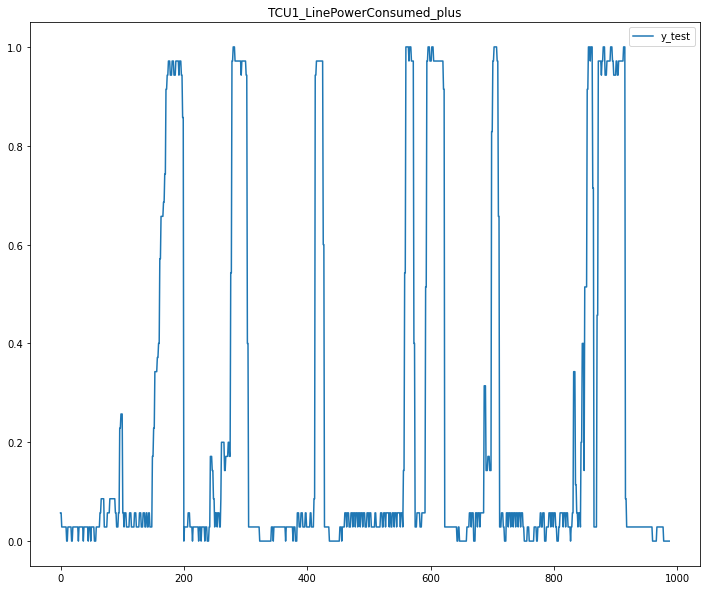

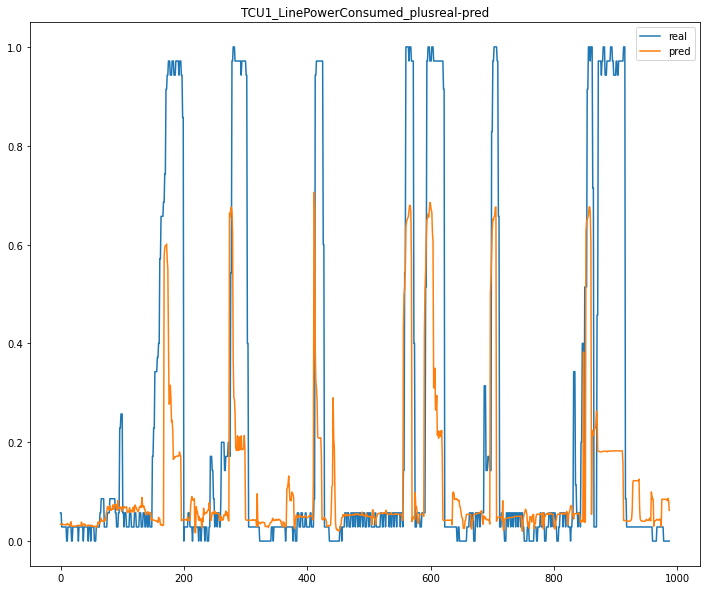

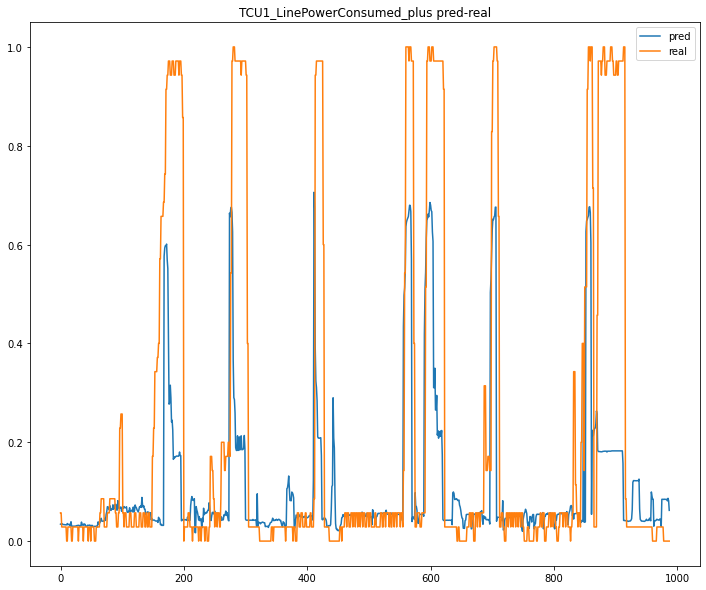

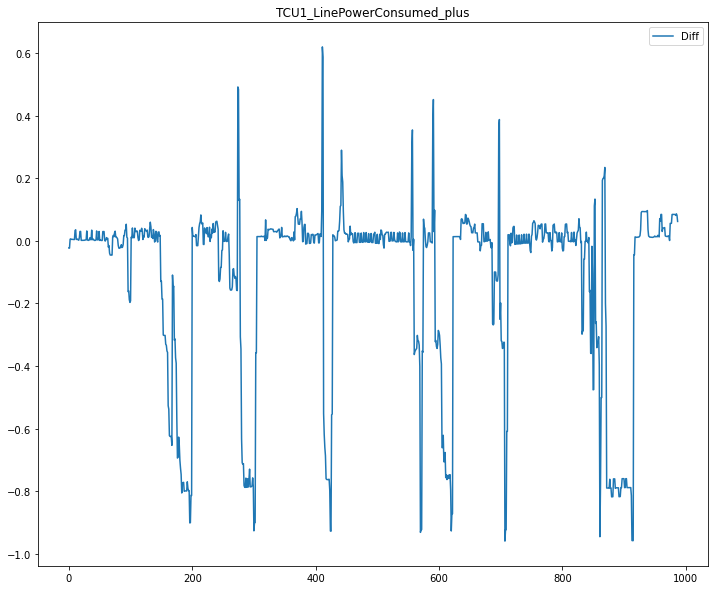

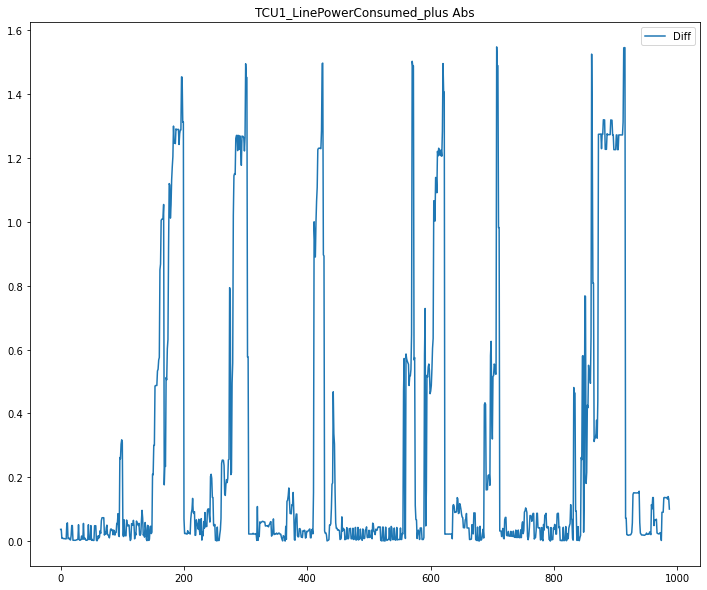

8 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 1000, 'min_samples_split': 10}
Fold : 0/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s


building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000

building tree 4 of 1000
building tree 5 of 1000
building tree 6 of 1000
building tree 7 of 1000building tree 8 of 1000

building tree 9 of 1000
building tree 10 of 1000building tree 11 of 1000

building tree 12 of 1000
building tree 13 of 1000building tree 14 of 1000

building tree 15 of 1000
building tree 16 of 1000building tree 17 of 1000

building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000
building tree 21 of 1000
building tree 22 of 1000
building tree 23 of 1000
building tree 24 of 1000
building tree 25 of 1000
building tree 26 of 1000
building tree 27 of 1000
building tree 28 of 1000
building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000
building tree 32 of 1000
building tree 33 of 1000
building tree 34 of 1000building tree 35 of 1000

building tree 36 of 1000
building tree 37 of 1000building tree 38 of 1000

building tree 39 of 1000building tree 40 of 1000
building t

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 155 of 1000
building tree 156 of 1000
building tree 157 of 1000
building tree 158 of 1000
building tree 159 of 1000
building tree 160 of 1000
building tree 161 of 1000
building tree 162 of 1000
building tree 163 of 1000
building tree 164 of 1000
building tree 165 of 1000
building tree 166 of 1000building tree 167 of 1000building tree 168 of 1000


building tree 169 of 1000
building tree 170 of 1000
building tree 171 of 1000
building tree 172 of 1000
building tree 173 of 1000
building tree 174 of 1000building tree 175 of 1000
building tree 176 of 1000

building tree 177 of 1000
building tree 178 of 1000building tree 179 of 1000

building tree 180 of 1000
building tree 181 of 1000
building tree 182 of 1000
building tree 183 of 1000building tree 184 of 1000

building tree 185 of 1000
building tree 186 of 1000
building tree 187 of 1000
building tree 188 of 1000
building tree 189 of 1000
building tree 190 of 1000
building tree 191 of 1000
building tree 192 of 1000building tree

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s



building tree 468 of 1000
building tree 469 of 1000
building tree 470 of 1000building tree 471 of 1000

building tree 472 of 1000
building tree 473 of 1000
building tree 474 of 1000
building tree 475 of 1000
building tree 476 of 1000
building tree 477 of 1000
building tree 478 of 1000
building tree 479 of 1000
building tree 480 of 1000
building tree 481 of 1000
building tree 482 of 1000
building tree 483 of 1000
building tree 484 of 1000
building tree 485 of 1000
building tree 486 of 1000
building tree 487 of 1000
building tree 488 of 1000
building tree 489 of 1000
building tree 490 of 1000
building tree 491 of 1000
building tree 492 of 1000building tree 493 of 1000

building tree 494 of 1000
building tree 495 of 1000
building tree 496 of 1000
building tree 497 of 1000building tree 498 of 1000

building tree 499 of 1000
building tree 500 of 1000
building tree 501 of 1000
building tree 502 of 1000
building tree 503 of 1000
building tree 504 of 1000
building tree 505 of 1000
building tr

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s


building tree 787 of 1000
building tree 788 of 1000
building tree 789 of 1000
building tree 790 of 1000
building tree 791 of 1000building tree 792 of 1000

building tree 793 of 1000building tree 794 of 1000

building tree 795 of 1000
building tree 796 of 1000
building tree 797 of 1000building tree 798 of 1000

building tree 799 of 1000building tree 800 of 1000

building tree 801 of 1000
building tree 802 of 1000
building tree 803 of 1000
building tree 804 of 1000
building tree 805 of 1000
building tree 806 of 1000
building tree 807 of 1000building tree 808 of 1000

building tree 809 of 1000
building tree 810 of 1000
building tree 811 of 1000
building tree 812 of 1000
building tree 813 of 1000
building tree 814 of 1000building tree 815 of 1000

building tree 816 of 1000
building tree 817 of 1000
building tree 818 of 1000
building tree 819 of 1000
building tree 820 of 1000
building tree 821 of 1000
building tree 822 of 1000
building tree 823 of 1000
building tree 824 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 8035312202.36%, std: 27525590385.25%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -5.300262880749266
STD:  9.930102779501702




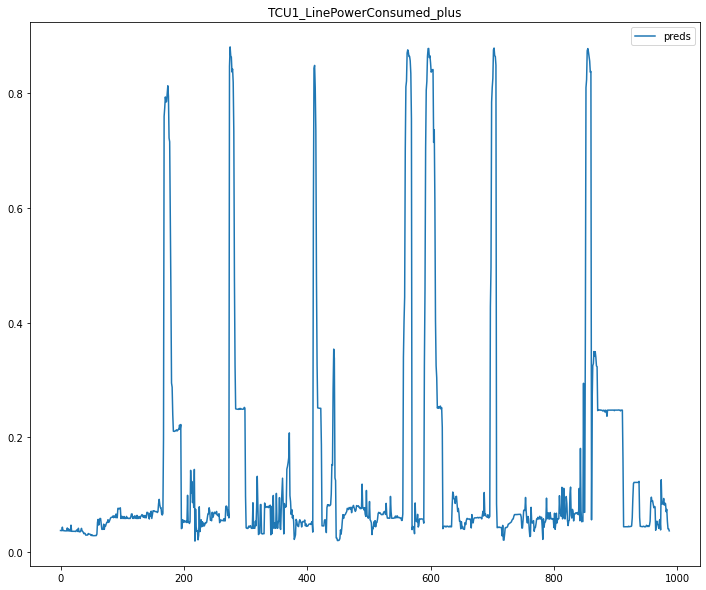

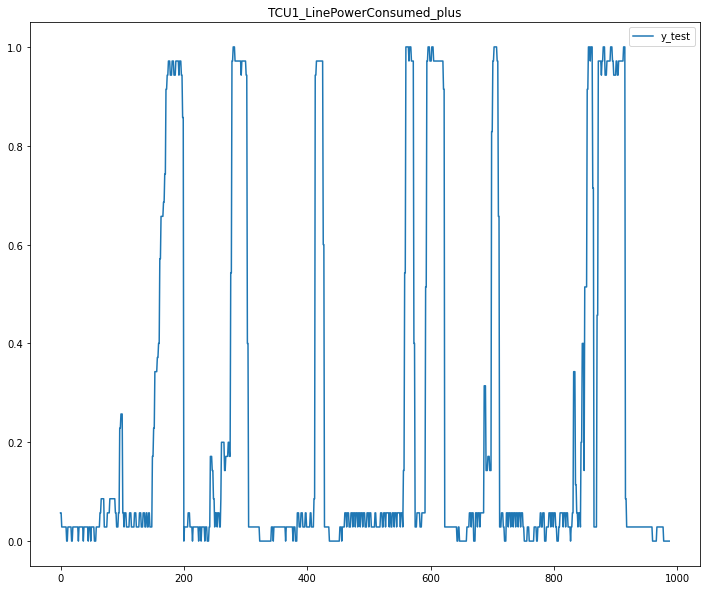

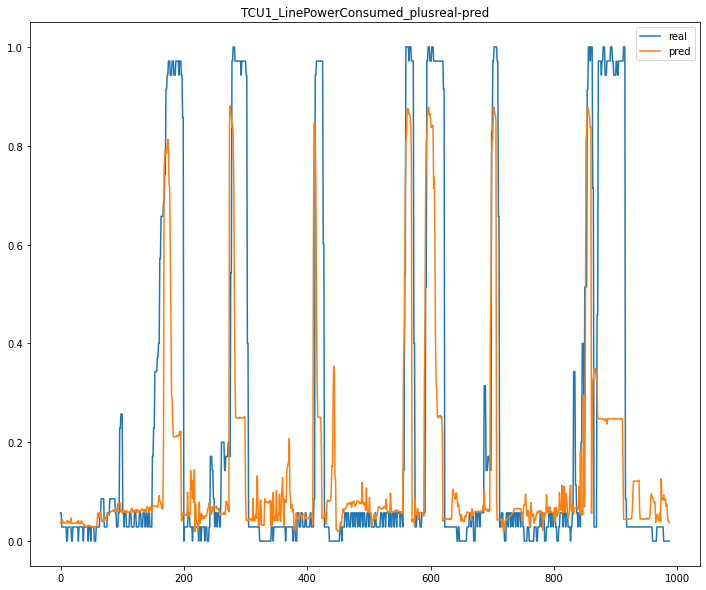

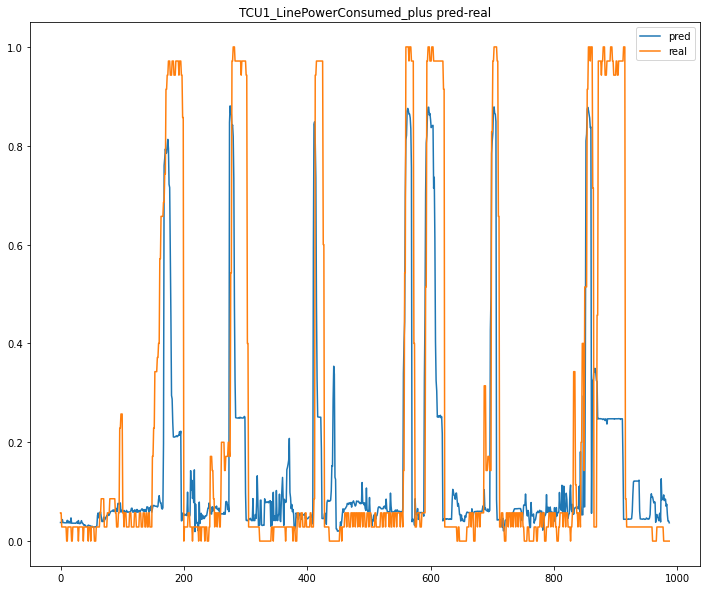

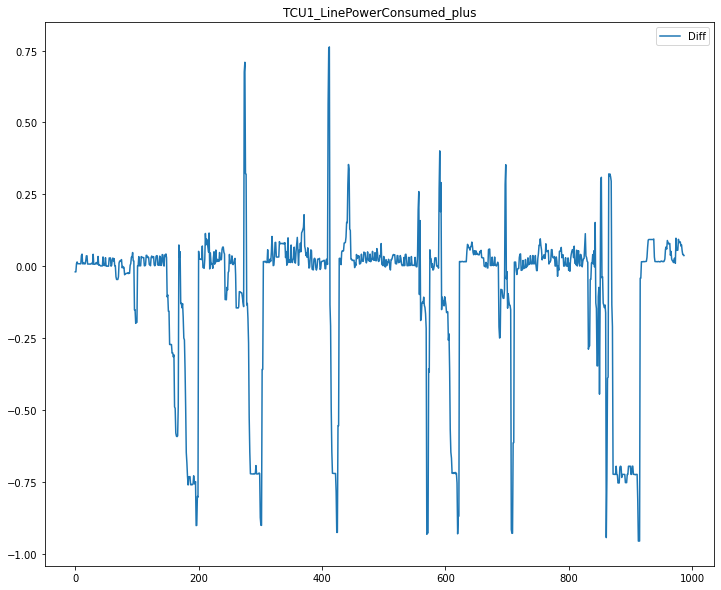

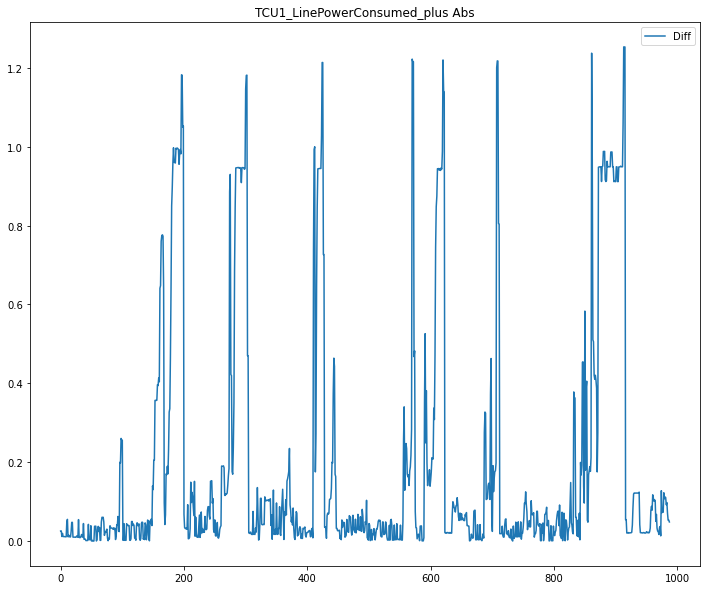

Fold : 1/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.2s


building tree 1 of 1000building tree 2 of 1000
building tree 3 of 1000

building tree 4 of 1000
building tree 5 of 1000
building tree 6 of 1000
building tree 7 of 1000
building tree 8 of 1000
building tree 9 of 1000
building tree 10 of 1000building tree 11 of 1000

building tree 12 of 1000
building tree 13 of 1000building tree 14 of 1000

building tree 15 of 1000
building tree 16 of 1000
building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000building tree 20 of 1000
building tree 21 of 1000

building tree 22 of 1000
building tree 23 of 1000
building tree 24 of 1000building tree 25 of 1000

building tree 26 of 1000
building tree 27 of 1000building tree 28 of 1000

building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000
building tree 32 of 1000building tree 33 of 1000

building tree 34 of 1000
building tree 35 of 1000
building tree 36 of 1000
building tree 37 of 1000building tree 38 of 1000

building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.5s


building tree 469 of 1000
building tree 470 of 1000
building tree 471 of 1000
building tree 472 of 1000
building tree 473 of 1000
building tree 474 of 1000
building tree 475 of 1000
building tree 476 of 1000building tree 477 of 1000

building tree 478 of 1000building tree 479 of 1000

building tree 480 of 1000building tree 481 of 1000

building tree 482 of 1000
building tree 483 of 1000
building tree 484 of 1000
building tree 485 of 1000
building tree 486 of 1000
building tree 487 of 1000
building tree 488 of 1000
building tree 489 of 1000
building tree 490 of 1000
building tree 491 of 1000
building tree 492 of 1000
building tree 493 of 1000
building tree 494 of 1000
building tree 495 of 1000
building tree 496 of 1000building tree 497 of 1000

building tree 498 of 1000
building tree 499 of 1000
building tree 500 of 1000
building tree 501 of 1000
building tree 502 of 1000
building tree 503 of 1000
building tree 504 of 1000
building tree 505 of 1000
building tree 506 of 1000
building tre

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    0.8s


building tree 789 of 1000building tree 790 of 1000


building tree 791 of 1000building tree 792 of 1000
building tree 793 of 1000
building tree 794 of 1000

building tree 795 of 1000building tree 796 of 1000

building tree 797 of 1000
building tree 798 of 1000
building tree 799 of 1000
building tree 800 of 1000
building tree 801 of 1000
building tree 802 of 1000building tree 803 of 1000

building tree 804 of 1000
building tree 805 of 1000
building tree 806 of 1000
building tree 807 of 1000
building tree 808 of 1000
building tree 809 of 1000
building tree 810 of 1000
building tree 811 of 1000
building tree 812 of 1000
building tree 813 of 1000building tree 814 of 1000

building tree 815 of 1000
building tree 816 of 1000
building tree 817 of 1000
building tree 818 of 1000
building tree 819 of 1000
building tree 820 of 1000
building tree 821 of 1000
building tree 822 of 1000building tree 823 of 1000

building tree 824 of 1000
building tree 825 of 1000
building tree 826 of 1000
building tr

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 7143965907.93%, std: 22999006644.61%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -3.576130176234365
STD:  6.2018979686434355




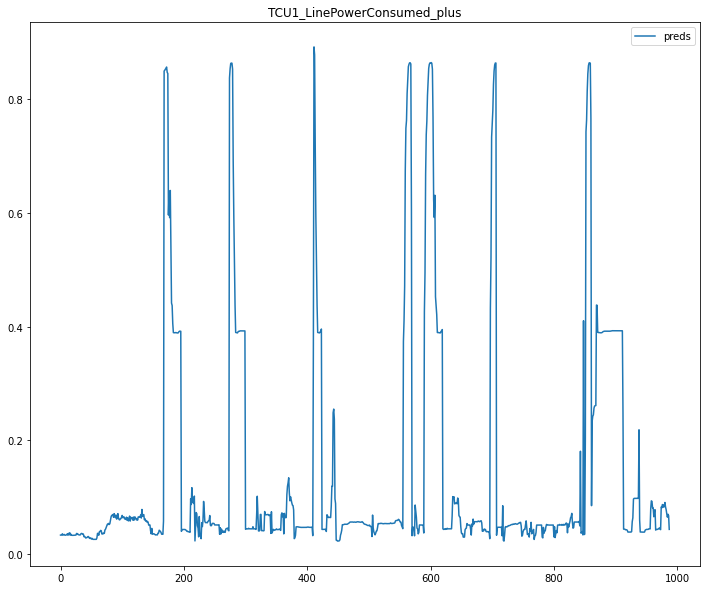

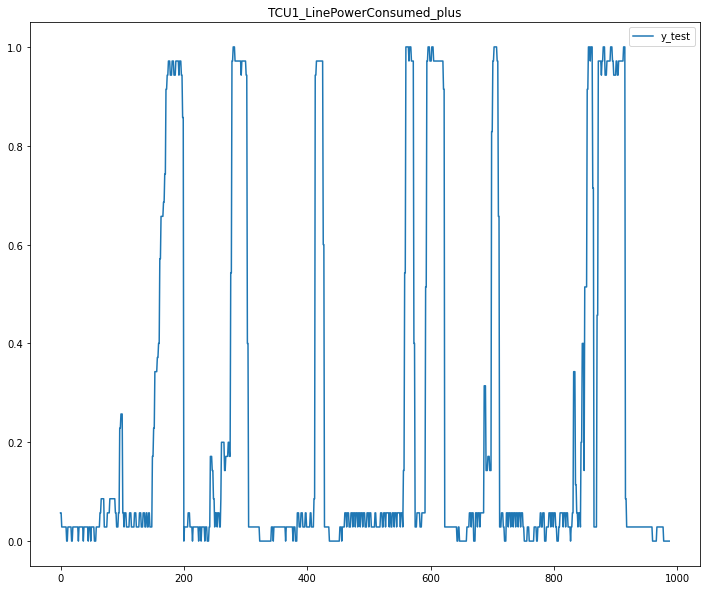

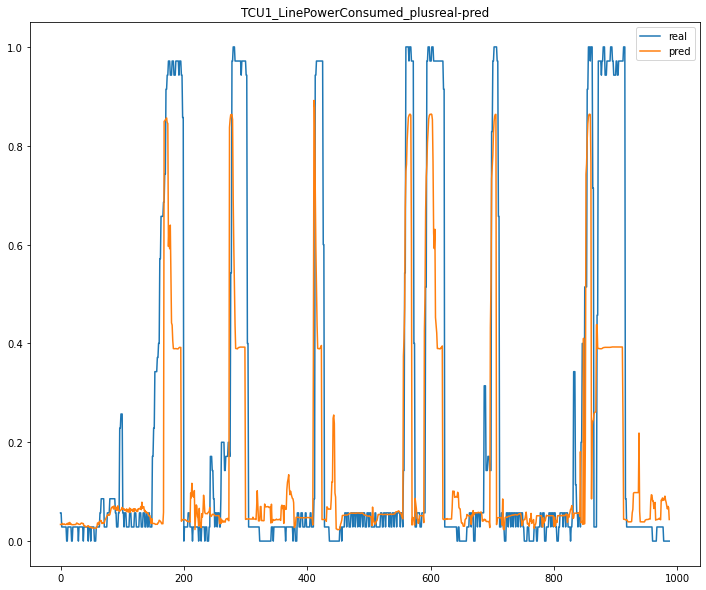

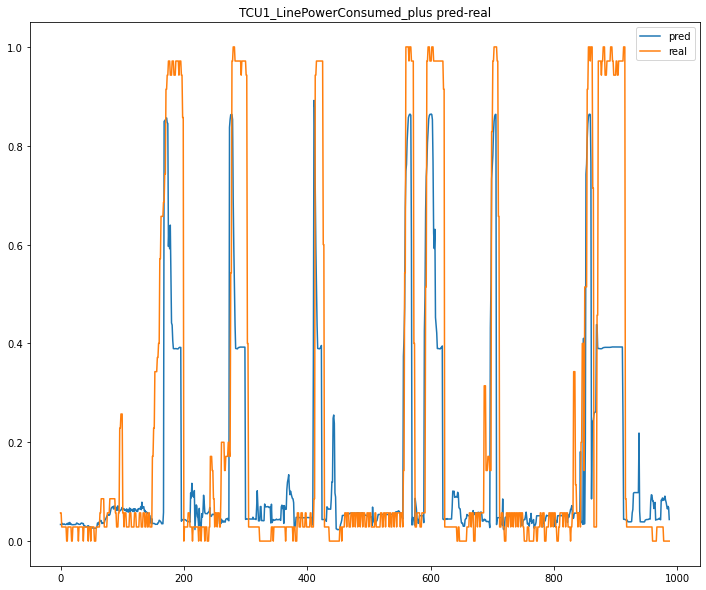

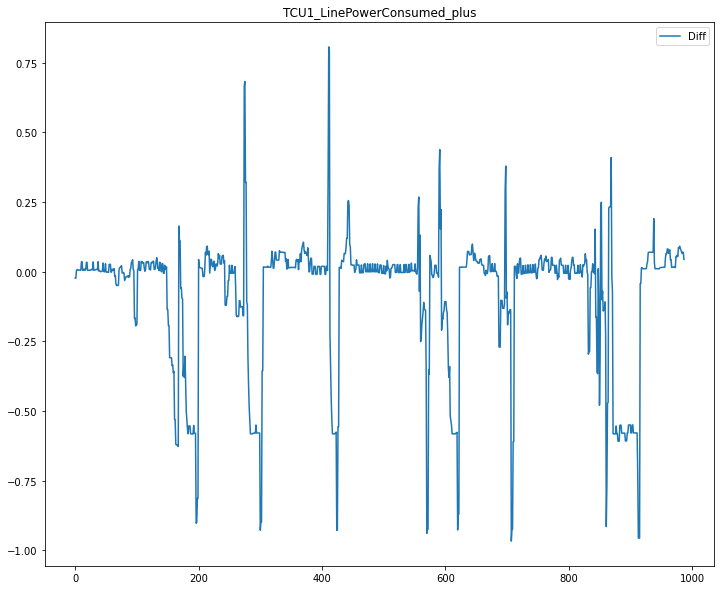

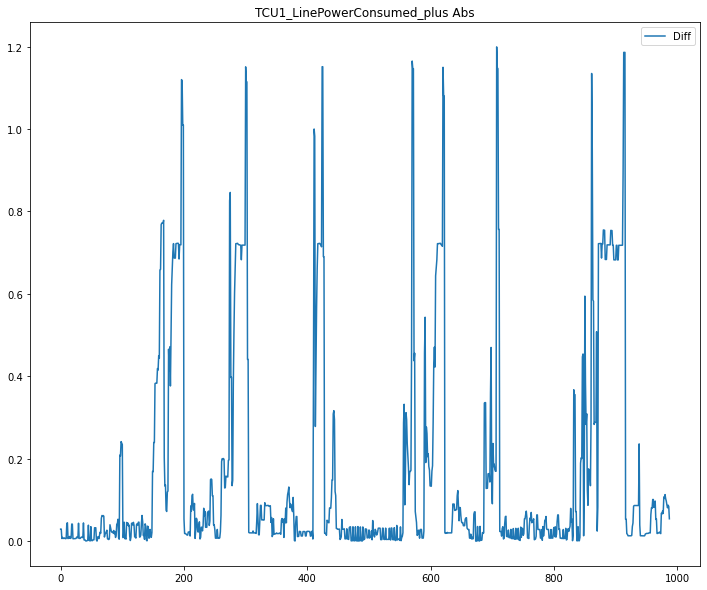

Fold : 2/3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s


building tree 1 of 1000building tree 2 of 1000building tree 3 of 1000

building tree 4 of 1000building tree 5 of 1000
building tree 6 of 1000


building tree 7 of 1000building tree 8 of 1000

building tree 9 of 1000
building tree 10 of 1000
building tree 11 of 1000
building tree 12 of 1000
building tree 13 of 1000
building tree 14 of 1000
building tree 15 of 1000
building tree 16 of 1000
building tree 17 of 1000
building tree 18 of 1000
building tree 19 of 1000
building tree 20 of 1000
building tree 21 of 1000
building tree 22 of 1000building tree 23 of 1000

building tree 24 of 1000
building tree 25 of 1000building tree 26 of 1000

building tree 27 of 1000
building tree 28 of 1000
building tree 29 of 1000
building tree 30 of 1000
building tree 31 of 1000building tree 32 of 1000

building tree 33 of 1000
building tree 34 of 1000
building tree 35 of 1000
building tree 36 of 1000building tree 37 of 1000
building tree 38 of 1000

building tree 39 of 1000
building tree 40 of 1000
building 

[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    0.3s


building tree 256 of 1000
building tree 257 of 1000
building tree 258 of 1000
building tree 259 of 1000
building tree 260 of 1000building tree 261 of 1000

building tree 262 of 1000
building tree 263 of 1000
building tree 264 of 1000
building tree 265 of 1000building tree 266 of 1000

building tree 267 of 1000
building tree 268 of 1000building tree 269 of 1000

building tree 270 of 1000
building tree 271 of 1000
building tree 272 of 1000
building tree 273 of 1000
building tree 274 of 1000building tree 275 of 1000

building tree 276 of 1000
building tree 277 of 1000building tree 278 of 1000building tree 279 of 1000building tree 280 of 1000



building tree 281 of 1000
building tree 282 of 1000
building tree 283 of 1000
building tree 284 of 1000
building tree 285 of 1000
building tree 286 of 1000
building tree 287 of 1000
building tree 288 of 1000
building tree 289 of 1000
building tree 290 of 1000
building tree 291 of 1000
building tree 292 of 1000building tree 293 of 1000

building tre

[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:    0.6s


building tree 381 of 1000

building tree 382 of 1000
building tree 383 of 1000
building tree 384 of 1000building tree 385 of 1000
building tree 386 of 1000

building tree 387 of 1000building tree 388 of 1000

building tree 389 of 1000
building tree 390 of 1000
building tree 391 of 1000
building tree 392 of 1000
building tree 393 of 1000building tree 394 of 1000
building tree 395 of 1000

building tree 396 of 1000
building tree 397 of 1000
building tree 398 of 1000
building tree 399 of 1000
building tree 400 of 1000
building tree 401 of 1000
building tree 402 of 1000
building tree 403 of 1000
building tree 404 of 1000
building tree 405 of 1000building tree 406 of 1000

building tree 407 of 1000building tree 408 of 1000
building tree 409 of 1000
building tree 410 of 1000

building tree 411 of 1000
building tree 412 of 1000
building tree 413 of 1000building tree 414 of 1000

building tree 415 of 1000
building tree 416 of 1000
building tree 417 of 1000
building tree 418 of 1000
building tr

[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:    1.2s


building tree 645 of 1000
building tree 646 of 1000building tree 647 of 1000

building tree 648 of 1000building tree 649 of 1000

building tree 650 of 1000
building tree 651 of 1000
building tree 652 of 1000
building tree 653 of 1000
building tree 654 of 1000
building tree 655 of 1000building tree 656 of 1000

building tree 657 of 1000
building tree 658 of 1000building tree 659 of 1000

building tree 660 of 1000
building tree 661 of 1000building tree 662 of 1000

building tree 663 of 1000
building tree 664 of 1000
building tree 665 of 1000
building tree 666 of 1000
building tree 667 of 1000
building tree 668 of 1000
building tree 669 of 1000
building tree 670 of 1000
building tree 671 of 1000
building tree 672 of 1000
building tree 673 of 1000
building tree 674 of 1000
building tree 675 of 1000
building tree 676 of 1000
building tree 677 of 1000
building tree 678 of 1000
building tree 679 of 1000
building tree 680 of 1000building tree 681 of 1000

building tree 682 of 1000building tree

[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.9s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.2s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5798158433.24%, std: 19539230705.50%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 146 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 349 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 632 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1000 out of 1000 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 926 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    0.7s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 

CV Mean:  -4.837388871833142
STD:  8.642784580151245




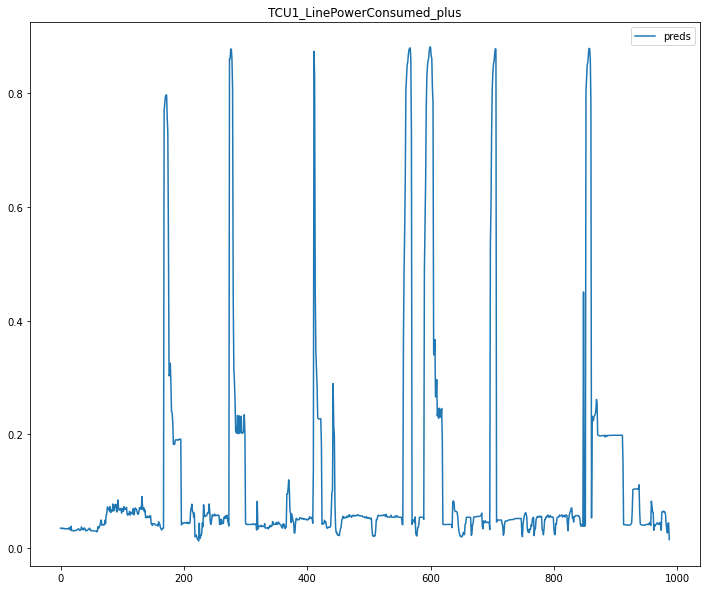

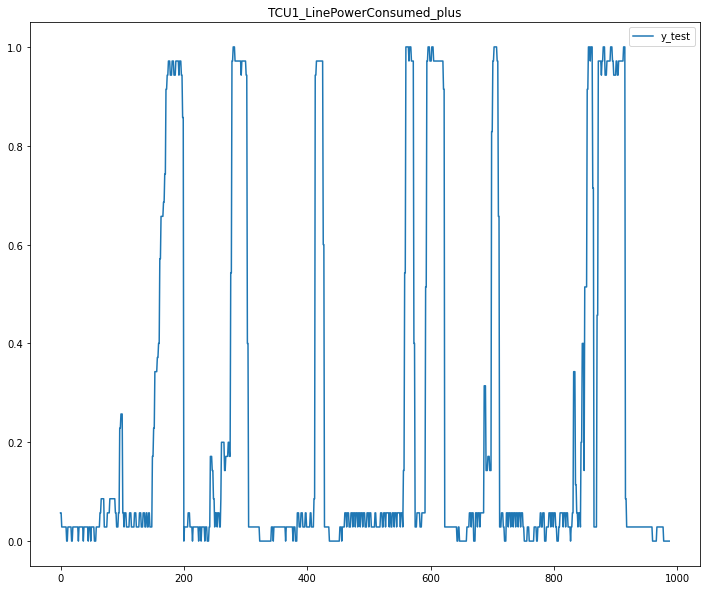

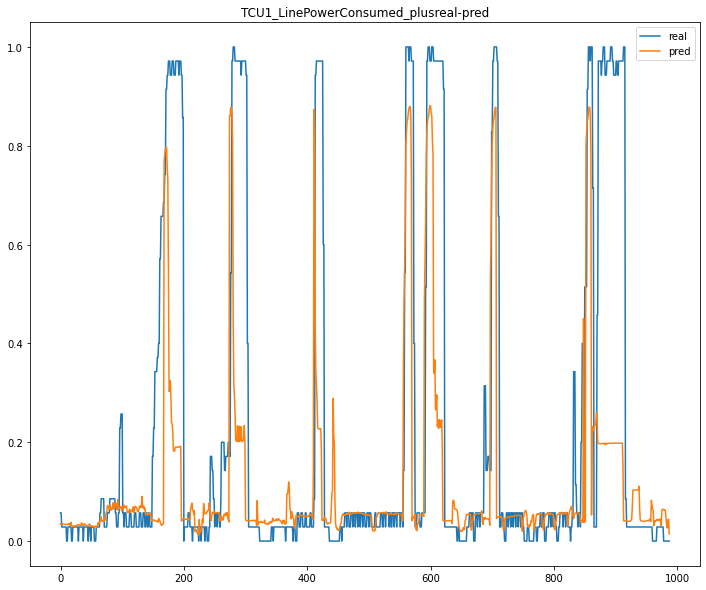

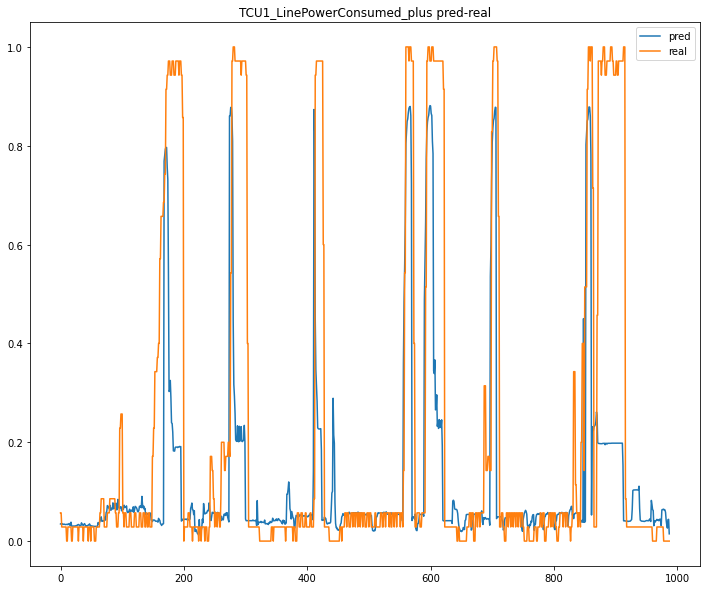

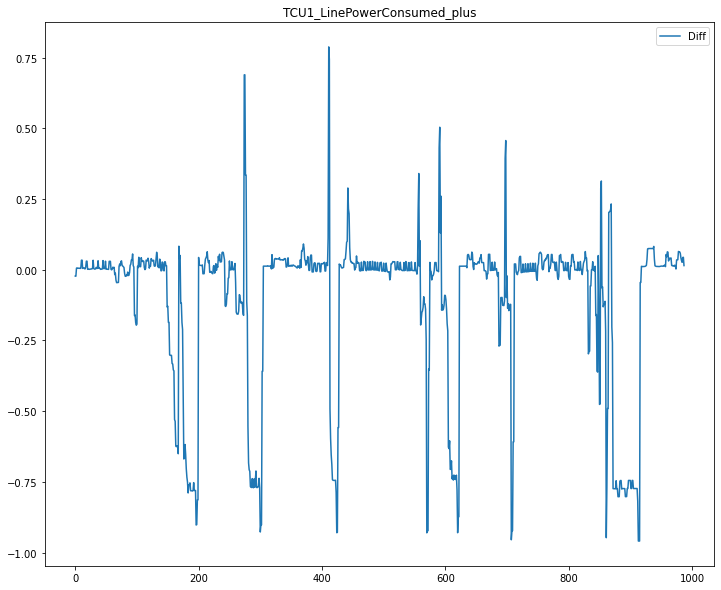

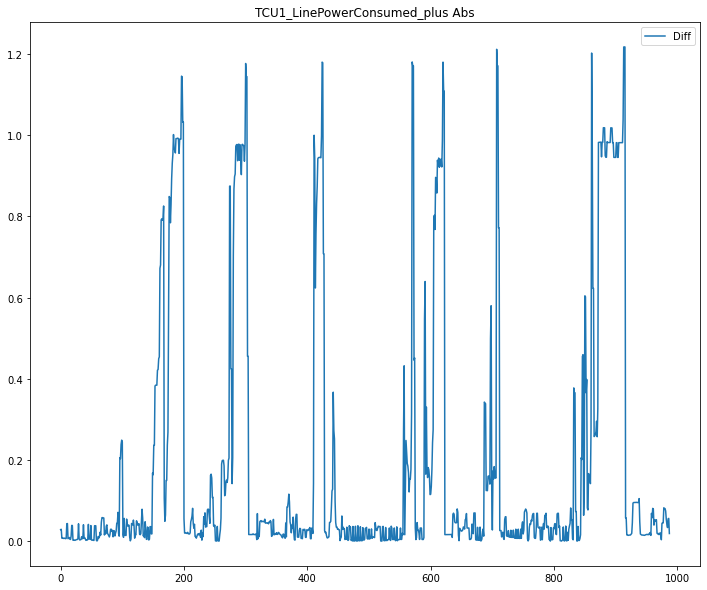

9 / 10
{'max_depth': 5, 'min_samples_leaf': 1, 'n_estimators': 100, 'min_samples_split': 2}
Fold : 0/3
building tree 1 of 100building tree 2 of 100

building tree 3 of 100building tree 4 of 100
building tree 5 of 100building tree 6 of 100

building tree 7 of 100
building tree 8 of 100

building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100building tree 13 of 100
building tree 14 of 100

building tree 15 of 100building tree 16 of 100

building tree 17 of 100
building tree 18 of 100
building tree 19 of 100building tree 20 of 100

building tree 21 of 100building tree 22 of 100

building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100
building tree 28 of 100
building tree 29 of 100building tree 30 of 100

building tree 31 of 100building tree 32 of 100building tree 33 of 100


building tree 34 of 100
building tree 35 of 100
building tree 36 of 100building tree 37 of 100

building tree 38 o

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5899436774.97%, std: 17898007961.22%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]:

CV Mean:  -1.8693260396984257
STD:  3.5562144986963427




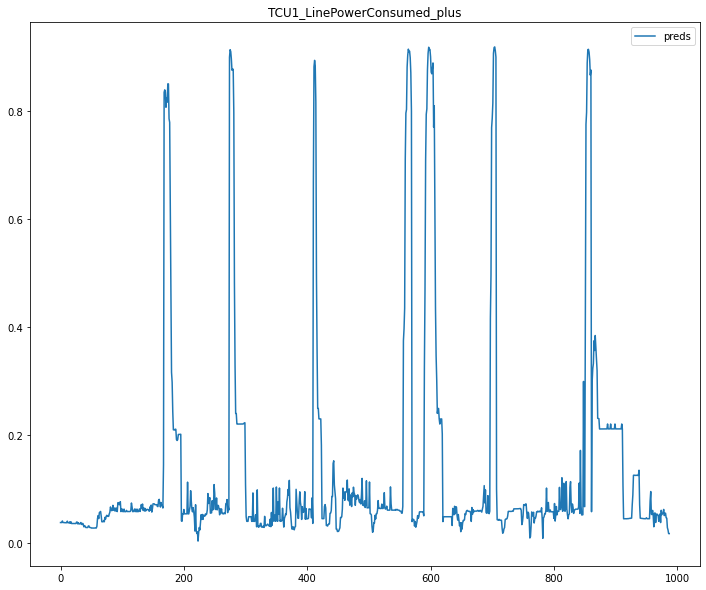

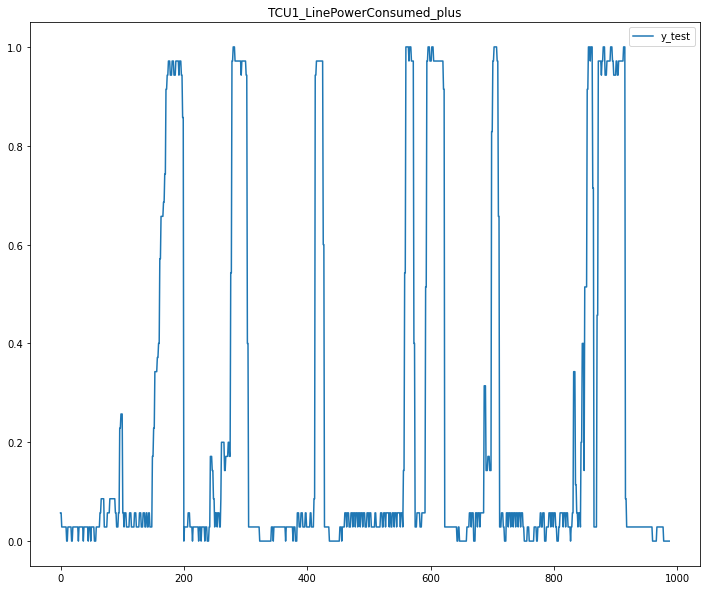

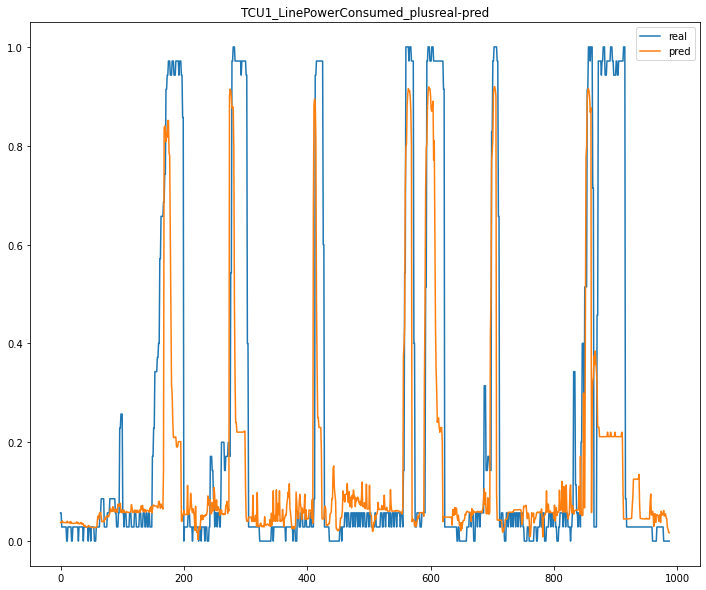

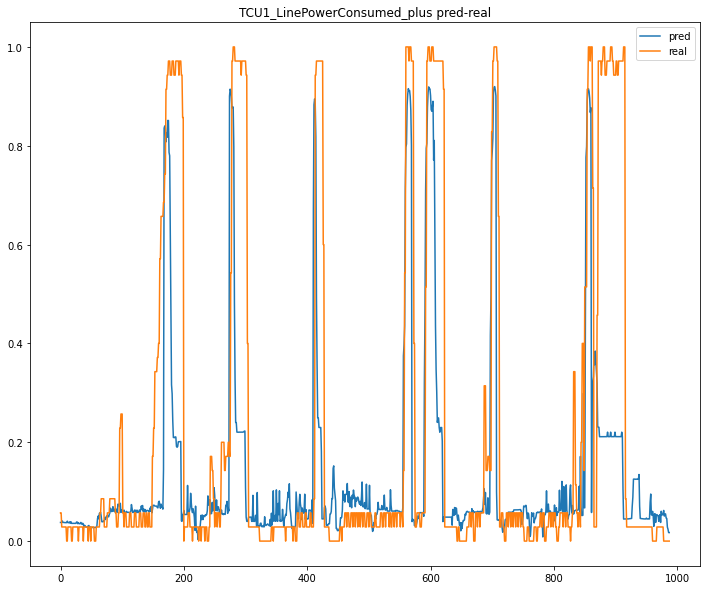

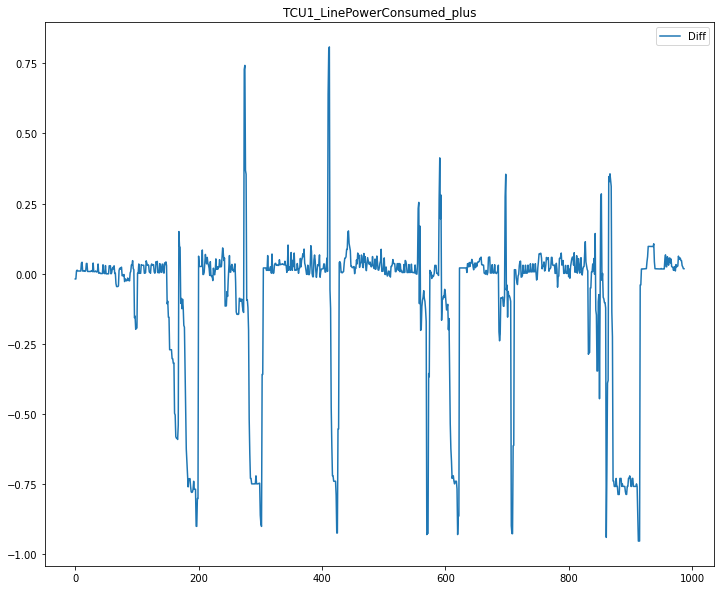

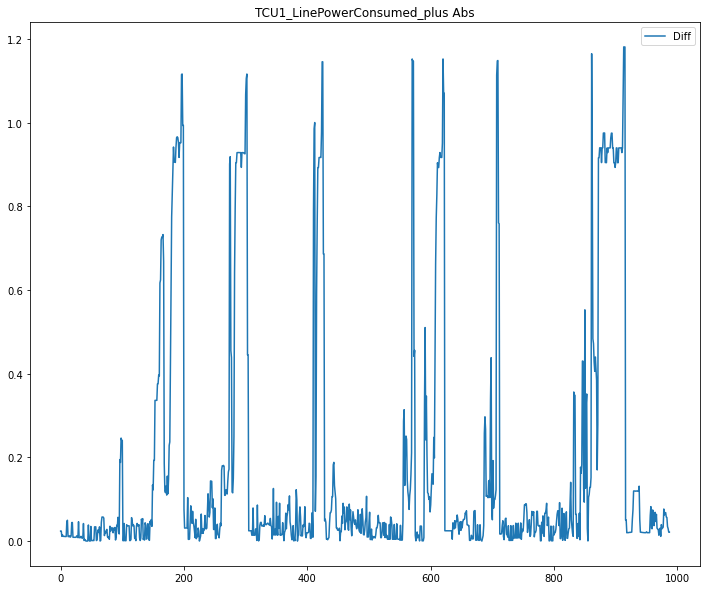

Fold : 1/3
building tree 1 of 100building tree 2 of 100

building tree 3 of 100building tree 4 of 100
building tree 5 of 100
building tree 6 of 100

building tree 7 of 100
building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100building tree 13 of 100

building tree 14 of 100building tree 15 of 100
building tree 16 of 100

building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100building tree 26 of 100

building tree 27 of 100building tree 28 of 100
building tree 29 of 100building tree 30 of 100
building tree 31 of 100

building tree 32 of 100

building tree 33 of 100
building tree 34 of 100
building tree 35 of 100building tree 36 of 100

building tree 37 of 100
building tree 38 of 100
building tree 39 of 100
building tree 40 of 100
building tree 41 of 100
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5455684118.12%, std: 17297540686.68%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Pa

CV Mean:  -3.1523632439356293
STD:  5.5295202825311165




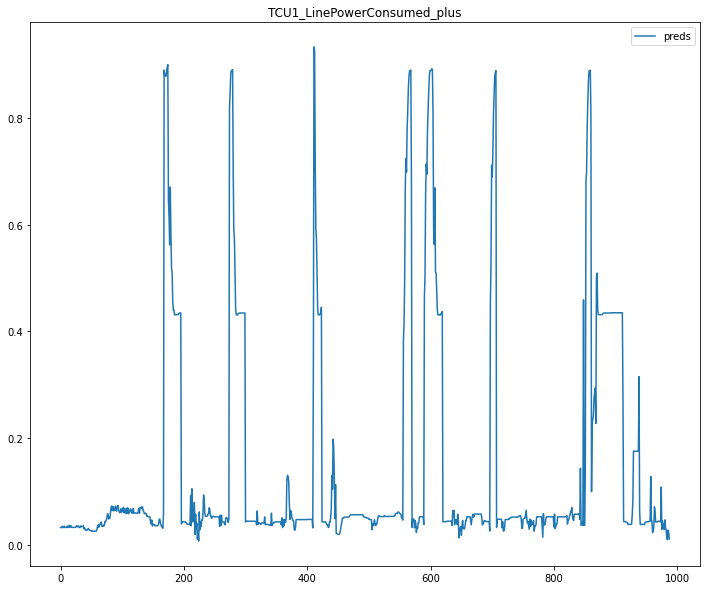

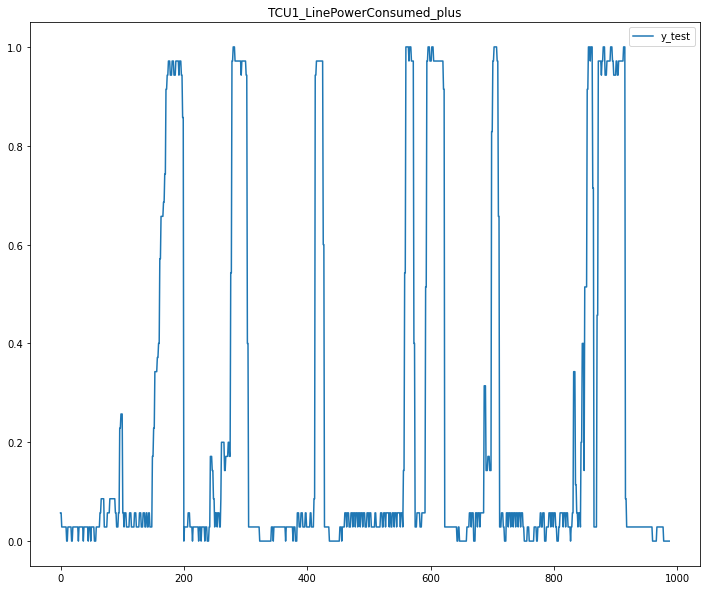

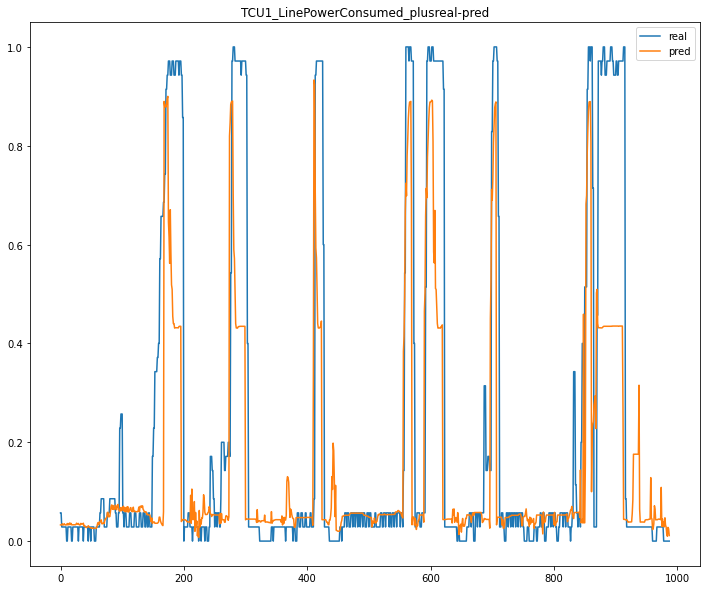

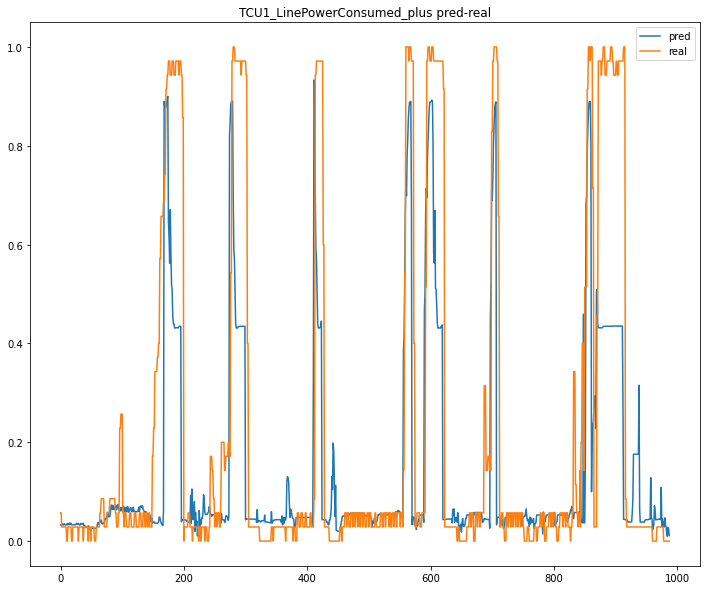

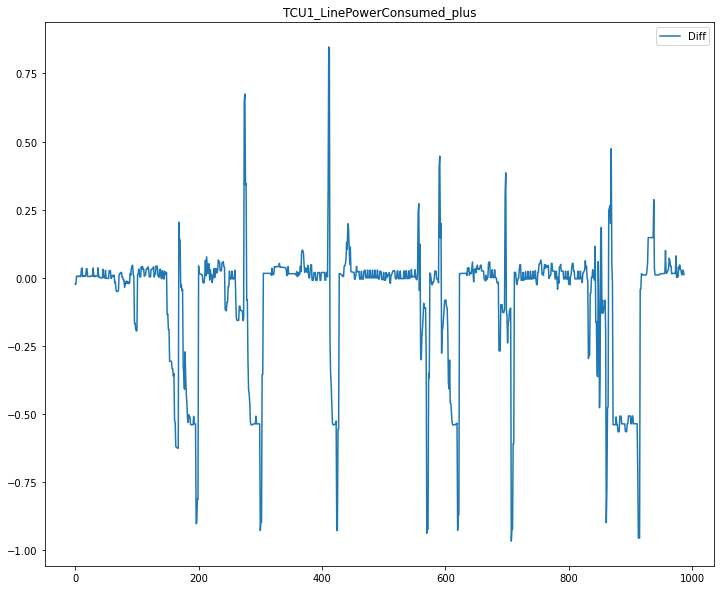

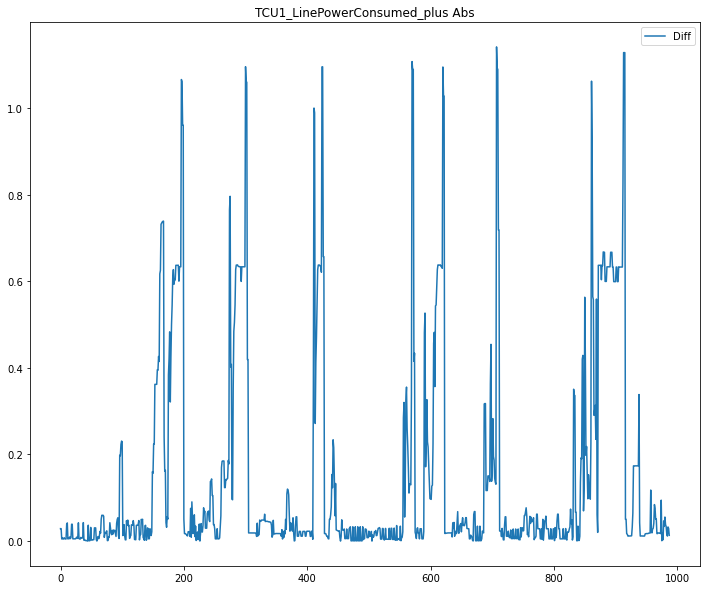

Fold : 2/3
building tree 1 of 100building tree 2 of 100
building tree 3 of 100building tree 4 of 100
building tree 5 of 100
building tree 6 of 100

building tree 7 of 100

building tree 8 of 100
building tree 9 of 100
building tree 10 of 100
building tree 11 of 100
building tree 12 of 100
building tree 13 of 100
building tree 14 of 100
building tree 15 of 100
building tree 16 of 100
building tree 17 of 100
building tree 18 of 100
building tree 19 of 100
building tree 20 of 100
building tree 21 of 100
building tree 22 of 100
building tree 23 of 100
building tree 24 of 100
building tree 25 of 100
building tree 26 of 100
building tree 27 of 100building tree 28 of 100building tree 29 of 100


building tree 30 of 100
building tree 31 of 100
building tree 32 of 100
building tree 33 of 100
building tree 34 of 100
building tree 35 of 100
building tree 36 of 100building tree 37 of 100

building tree 38 of 100
building tree 39 of 100building tree 40 of 100

building tree 41 of 100
building tree 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


TCU1_LinePowerConsumed_plus - avg: 0.22657131687736518, std: 0.3588752309265994
Absolut Percent Difference - mean: 5371937240.05%, std: 17318564223.62%


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  85 out of 100 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    0.1s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  25 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finishe

CV Mean:  -2.119528897810226
STD:  3.0406764506980632




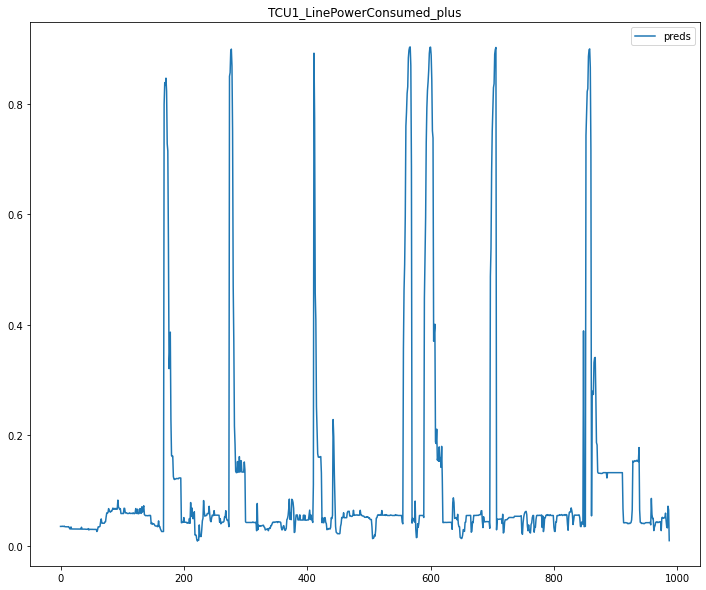

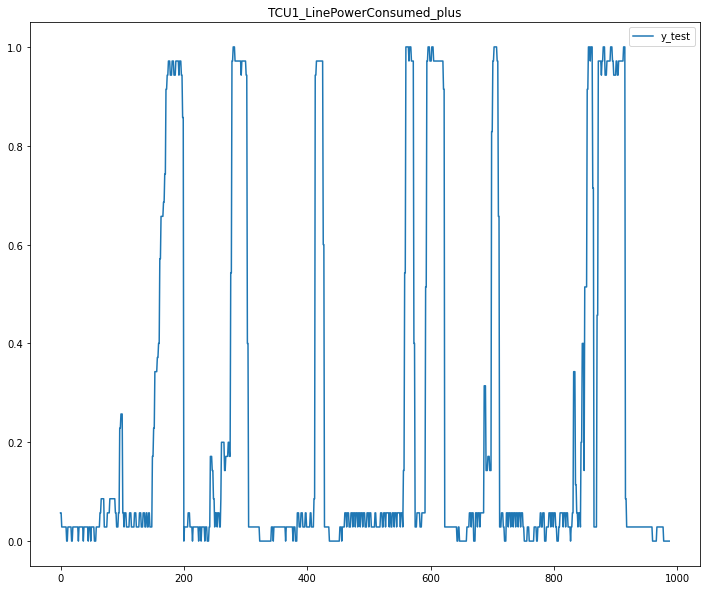

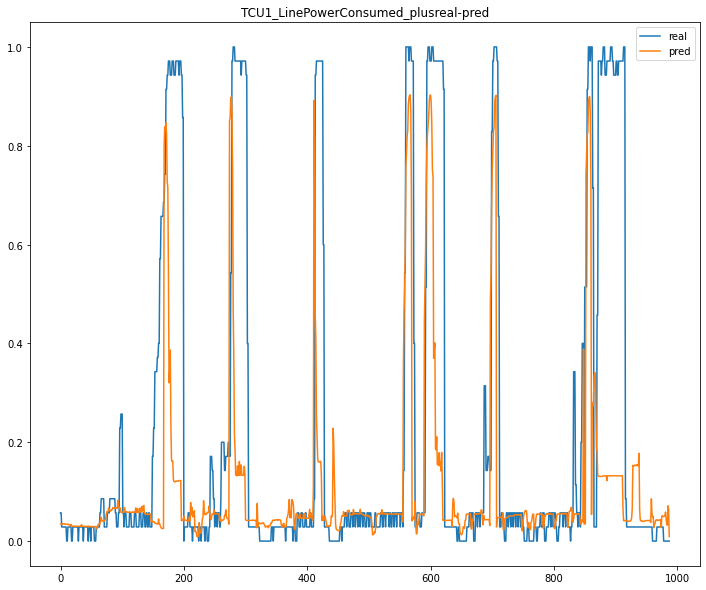

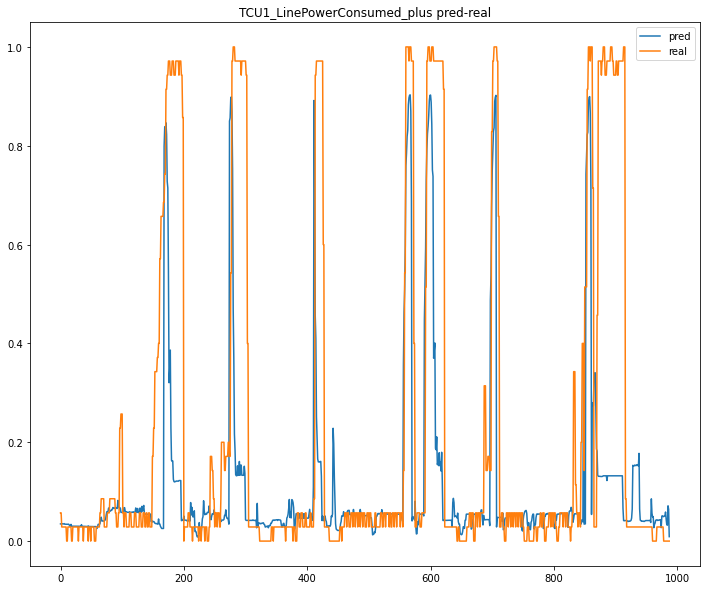

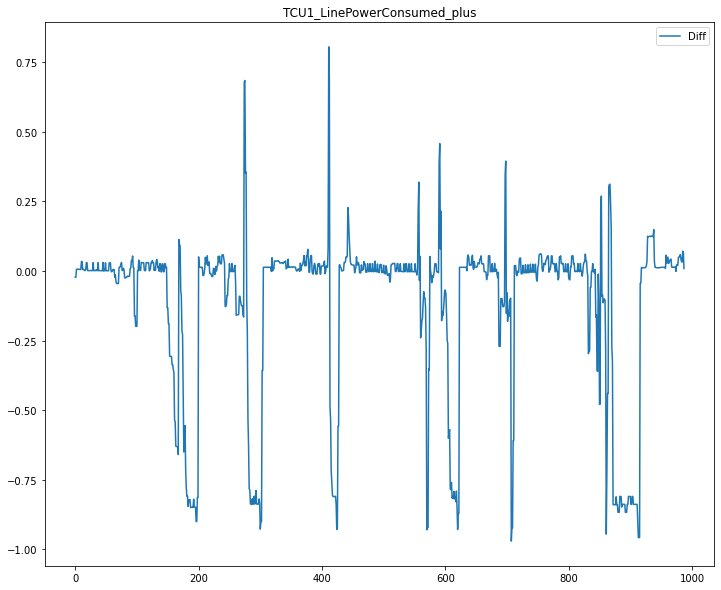

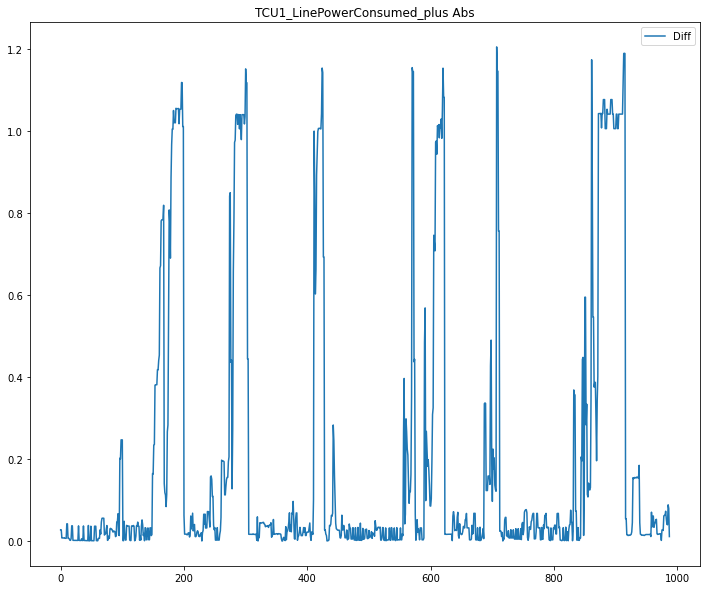

In [28]:
# from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import MeanAbsolutePercentageError
from sklearn.model_selection import TimeSeriesSplit, KFold, GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from keras.models import load_model

import numpy as np 

import random 

N_KFOLD=3
PLOT_PERCENT =None

result_list={}

params_dict = {'max_depth' : [5,15,30],
               'min_samples_leaf':[1,10,50,100],
               'min_samples_split':[2,10,20],
               'n_estimators':[100,500,1000]}
list_params = create_params_list_rfr(params_dict)[:10]
random.shuffle(list_params)

#tscv = TimeSeriesSplit(n_splits=model_conf['n_kfold'])
tscv = KFold(n_splits=N_KFOLD,shuffle=True,random_state=42)
cont =0
for target in variables_objetivo[:1]:
    print (f'{target}')

    for i,params in enumerate(list_params):
        print (i,"/",len(list_params))
        print (params)
        ignore_columns = list(set(conf_dict['ignore_columns'] + variables_objetivo +discard_columns + variables_objetivo_current)) 
        
        for kfold, (train_index, val_index) in enumerate(tscv.split(df['train'])):

            print (f'Fold : {kfold}/{N_KFOLD}')
#             if kfold > 0:
#                 continue

            X_train, y_train,features = models.prepare_dataset(df['train'], ignore_columns,target, kfold=train_index[:30000])
            X_val, y_val,_ = models.prepare_dataset(df['train'], ignore_columns,target, kfold=val_index[:30000])
            X_test, y_test,_ = models.prepare_dataset(df['test'][:10000], ignore_columns,target)



            rfr = RandomForestRegressor(min_samples_leaf=params['min_samples_leaf'],
                            max_depth=params['max_depth'],
                            min_samples_split=params['min_samples_split'],
                            n_estimators=params['n_estimators'],
                            verbose=2, 
                            n_jobs=-1,
                          )

#            grids = GridSearchCV(modelsvr,params,cv=3, n_jobs = -1, verbose = 2)

            rfr.fit(X_train, y_train)
            preds = rfr.predict(X_test)

            quick_analysis(preds, y_test)
            scores = get_cv_scores(rfr,X_train, y_train)
            
            train_info_dict = create_train_info_dict(store_model_path, params,target,'{}-{}'.format(str(cont),str(kfold)))
            train_info_dict['etl_version']=etl_step.ETL_VERSION
            train_info_dict['regresor']='rfr'
            train_info_dict['features']=features
            train_info_dict['score']=scores
            train_info_dict['params']=params

            create_plots(preds, y_test, target,train_info_dict,'{}-{}'.format(str(cont),str(kfold)) ,plot_percent=PLOT_PERCENT)


            joblib.dump(rfr, train_info_dict['model'])

            with open(train_info_dict['train_info'].format(scores),'wb') as f:
                pickle.dump( train_info_dict,f)
            result_list[target]=(scores,train_info_dict['train_info'].format(scores))
        cont+=1


In [29]:
result_filename = 'results_rfr_'+etl_step.ETL_VERSION+'_'+utils.get_timestamp()+'.pickle'

with open(result_filename,'wb') as f:
    pickle.dump( result_list,f)